<a href="https://colab.research.google.com/github/pr-shukla/MS-Thesis/blob/main/multi_coop_pursuer_evader.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import math
from tensorflow.keras.models import load_model

In [ ]:
#Dimension of State Space for single agent
dim_agent_state = 5

#hidden_nodes = 3

#Time Difference Between 2 Steps
dt = 0.4

#Number of Episodes
num_episodes = 10000

#Number of Steps

num_steps = 100

#buffer_range = 60

#Minimum turing radius of Pursuer
rho = 0.3

#velocity of pursuer
v = 1.0


#Velocity of Evader during training
ve = 0.6

#angle between initial velocity and reference
te = 3*np.pi/4

num_agents = 2

#Dimension of State Space
dim_state = dim_agent_state*num_agents

In [ ]:
class OUActionNoise:
    def __init__(self, mean, std_deviation, theta=0.15, dt=0.4, x_initial=None):
        self.theta = theta
        self.mean = mean
        self.std_dev = std_deviation
        self.dt = dt
        self.x_initial = x_initial
        self.reset()

    def __call__(self):
        # Formula taken from https://www.wikipedia.org/wiki/Ornstein-Uhlenbeck_process.
        x = (
            self.x_prev
            + self.theta * (self.mean - self.x_prev) * self.dt
            + self.std_dev * np.sqrt(self.dt) * np.random.normal(size=self.mean.shape)
        )
        # Store x into x_prev
        # Makes next noise dependent on current one
        self.x_prev = x
        return x

    def reset(self):
        if self.x_initial is not None:
            self.x_prev = self.x_initial
        else:
            self.x_prev = np.zeros_like(self.mean)

In [ ]:
class Buffer:
    def __init__(self, buffer_capacity=10000, batch_size=64):

        # Number of "experiences" to store at max
        self.buffer_capacity = buffer_capacity
        # Num of tuples to train on.
        self.batch_size = batch_size

        # Its tells us num of times record() was called.
        self.buffer_counter = 0

        # Instead of list of tuples as the exp.replay concept go
        # We use different np.arrays for each tuple element
        self.state_buffer = np.zeros((self.buffer_capacity, dim_state))
        self.action_buffer = np.zeros((self.buffer_capacity, num_agents))
        self.reward_buffer = np.zeros((self.buffer_capacity, num_agents))
        self.next_state_buffer = np.zeros((self.buffer_capacity, dim_state))

    # Takes (s,a,r,s') obervation tuple as input
    def record(self, obs_tuple):
        # Set index to zero if buffer_capacity is exceeded,
        # replacing old records
        index = self.buffer_counter % self.buffer_capacity

        self.state_buffer[index] = obs_tuple[0]
        self.action_buffer[index] = obs_tuple[1]
        self.reward_buffer[index] = obs_tuple[2]
        self.next_state_buffer[index] = obs_tuple[3]

        self.buffer_counter += 1

    # We compute the loss and update parameters
    def learn(self, ac_models, cr_models, target_ac, target_cr):
      for i in range(num_agents):
        # Get sampling range
        record_range = min(self.buffer_counter, self.buffer_capacity)
        # Randomly sample indices
        batch_indices = np.random.choice(record_range, self.batch_size)

        # Convert to tensors
        state_batch = tf.convert_to_tensor(self.state_buffer[batch_indices])
        action_batch = tf.convert_to_tensor(self.action_buffer[batch_indices])
        reward_batch = tf.convert_to_tensor(self.reward_buffer[batch_indices])
        reward_batch = tf.cast(reward_batch, dtype=tf.float32)
        next_state_batch = tf.convert_to_tensor(self.next_state_buffer[batch_indices])

        # Training and updating Actor & Critic networks.
        # See Pseudo Code.

        target_actions = np.zeros((self.batch_size, num_agents))
        for j in range(num_agents):
          target_actions[:,j] = tf.reshape(
              target_ac[j](next_state_batch[:,5*j:5*(j+1)]), [self.batch_size]
              )

        target_action_batch1 = target_actions[:,0]
        target_action_batch2 = target_actions[:,1]
        action_batch1 = action_batch[:,0]
        action_batch2 = action_batch[:,1]
    
        with tf.GradientTape() as tape:
            y = reward_batch[:,i] + gamma * target_cr[i]([
                                                          next_state_batch, target_action_batch1, target_action_batch2
                                                          ])
            
            critic_value = cr_models[i]([
                                         state_batch, action_batch1, action_batch2
                                         ])
            
            critic_loss = tf.math.reduce_mean(tf.math.square(y - critic_value))

        critic_grad = tape.gradient(critic_loss, cr_models[i].trainable_variables)
        #print(np.shape(critic_grad[0]),np.shape(critic_grad[1]))
        critic_optimizer.apply_gradients(
            zip(critic_grad, cr_models[i].trainable_variables)
        )

        actions = np.zeros((self.batch_size, num_agents))
        for j in range(num_agents):
          a = ac_models[j](state_batch[:,5*j:5*(j+1)])
          actions[:,j] = tf.reshape(a, [self.batch_size])

  

        #print(np.shape(ac_gradient[0]),np.shape(ac_gradient[1]))

        if i == 0:
          
          with tf.GradientTape(persistent=True) as tape:
              
              action_ = ac_models[i](np.array([state_batch[:,5*i:5*(i+1)][0]]))
              
              critic_value = cr_models[i]([np.array([state_batch[0]]), action_, np.array([actions[:,1][0]])])

          critic_grad = tape.gradient(critic_value, action_)
          actor_grad = tape.gradient(action_, ac_models[i].trainable_variables)

          
          new_actor_grad = [critic_grad[0][0]*element for element in actor_grad]

          for k in range(1,self.batch_size):
              with tf.GradientTape(persistent=True) as tape:
                  
                  action_ = ac_models[i](np.array([state_batch[:,5*i:5*(i+1)][k]]))
                  
                  critic_value = cr_models[i]([np.array([state_batch[k]]), action_, np.array([actions[:,1][k]])])

              critic_grad = tape.gradient(critic_value, action_)
              actor_grad = tape.gradient(action_, ac_models[i].trainable_variables)

              for l in range(len(new_actor_grad)):
                new_actor_grad[l] = new_actor_grad[l] + critic_grad[0][0]*actor_grad[l]


          new_actor_grad = [-1*element/self.batch_size for element in new_actor_grad]
          actor_optimizer.apply_gradients(zip(new_actor_grad, ac_models[i].trainable_variables))
          
          
          

        else:
          with tf.GradientTape(persistent=True) as tape:
              
              action_ = ac_models[i](np.array([state_batch[:,5*i:5*(i+1)][0]]))
              
              critic_value = cr_models[i]([np.array([state_batch[0]]), np.array([actions[:,0][0]]),action_])

          critic_grad = tape.gradient(critic_value, action_)
          actor_grad = tape.gradient(action_, ac_models[i].trainable_variables)

          
          new_actor_grad = [critic_grad[0][0]*element for element in actor_grad]

          for k in range(1,self.batch_size):
              with tf.GradientTape(persistent=True) as tape:
                  
                  action_ = ac_models[i](np.array([state_batch[:,5*i:5*(i+1)][k]]))
                  
                  critic_value = cr_models[i]([np.array([state_batch[k]]), np.array([actions[:,0][k]]),action_])

              critic_grad = tape.gradient(critic_value, action_)
              actor_grad = tape.gradient(action_, ac_models[i].trainable_variables)

              for l in range(len(new_actor_grad)):
                new_actor_grad[l] = new_actor_grad[l] + critic_grad[0][0]*actor_grad[l]


          new_actor_grad = [-1*element/self.batch_size for element in new_actor_grad]
          actor_optimizer.apply_gradients(zip(new_actor_grad, ac_models[i].trainable_variables))

          
        
        


# This update target parameters slowly
# Based on rate `tau`, which is much less than one.
def update_target(tau, ac_models, cr_models, target_ac, target_cr):
  for i in range(num_agents):
    new_weights = []
    target_variables = target_cr[i].weights
    for j, variable in enumerate(cr_models[i].weights):
        new_weights.append(variable * tau + target_variables[j] * (1 - tau))

    target_cr[i].set_weights(new_weights)

    new_weights = []
    target_variables = target_ac[i].weights
    for j, variable in enumerate(ac_models[i].weights):
        new_weights.append(variable * tau + target_variables[j] * (1 - tau))

    target_ac[i].set_weights(new_weights)

In [ ]:

def get_actor():
    # Initialize weights between -3e-3 and 3-e3
    last_init = tf.random_uniform_initializer(minval=-0.00003, maxval=0.00003)

    inputs = layers.Input(shape=(5,))
    out = layers.Dense(256, activation="selu", kernel_initializer="lecun_normal")(inputs)
    out = layers.Dropout(rate=0.5)(out)
    out = layers.BatchNormalization()(out)
    out = layers.Dense(256, activation="selu", kernel_initializer="lecun_normal")(out)
    out = layers.Dropout(rate=0.5)(out)
    out = layers.BatchNormalization()(out)
    
    outputs = layers.Dense(1, activation="tanh", kernel_initializer=last_init)(out)

    # Our upper bound is 2.0 for Pendulum.
    outputs = outputs 
    model = tf.keras.Model(inputs, outputs)
    return model





def get_critic():
    last_init = tf.random_uniform_initializer(minval=-0.003, maxval=0.003)
    
    # State as input
    state_input = layers.Input(shape=(dim_state))
    state_out = layers.Dense(16, activation="selu", kernel_initializer="lecun_normal")(state_input)
    state_out = layers.BatchNormalization()(state_out)
    state_out = layers.Dense(32, activation="selu", kernel_initializer="lecun_normal")(state_out)
    state_out = layers.BatchNormalization()(state_out)

    # Action as input
    action_input1 = layers.Input(shape=(1))
    action_input2 = layers.Input(shape=(1))
    action_input = layers.Concatenate()([action_input1, action_input2])
    action_out = layers.Dense(32, activation="selu", kernel_initializer="lecun_normal")(action_input)
    action_out = layers.BatchNormalization()(action_out)

    # Both are passed through seperate layer before concatenating
    concat = layers.Concatenate()([state_out, action_out])

    out = layers.Dense(512, activation="selu", kernel_initializer="lecun_normal")(concat)
    out = layers.Dropout(rate=0.5)(out)
    out = layers.BatchNormalization()(out)
    out = layers.Dense(512, activation="selu", kernel_initializer="lecun_normal")(out)
    out = layers.Dropout(rate=0.5)(out)
    out = layers.BatchNormalization()(out)
    
    outputs = layers.Dense(1)(out)


    # Outputs single value for give state-action
    model = tf.keras.Model([state_input, action_input1, action_input2], outputs)

    return model

In [ ]:
def policy(state, noise_object, model):
    
    sampled_actions = tf.squeeze(model(state))
    noise = noise_object()

    # Adding noise to action
    sampled_actions = sampled_actions.numpy() + noise

    # We make sure action is within bounds
    legal_action = np.clip(sampled_actions, -1.0, 1.0)

    return [np.squeeze(legal_action)]



In [ ]:
std_dev = 0.2
ou_noise = OUActionNoise(mean=np.zeros(1), std_deviation=float(std_dev) * np.ones(1))

ac_models = []
cr_models = []
target_ac = []
target_cr = []

for i in range(num_agents):
  ac_models.append(get_actor()) 
  cr_models.append(get_critic())

  target_ac.append(get_actor())
  target_cr.append(get_critic())

  # Making the weights equal initially
  target_ac[i].set_weights(ac_models[i].get_weights())
  target_cr[i].set_weights(cr_models[i].get_weights())


# Learning rate for actor-critic models
#critic_lr = 1e-3
#actor_lr = 5e-4
critic_lr = 1e-4
actor_lr = 5e-5


critic_optimizer = tf.keras.optimizers.Adam(critic_lr)
actor_optimizer = tf.keras.optimizers.Adam(actor_lr)

# Discount factor for future rewards
gamma = 0.95
# Used to update target networks
tau = 0.005

buffer = Buffer(10000, 1)

In [ ]:
#Function for generating sigmoid output of Input Function
def sigmoid(x):
    val = 1/(1+np.exp(-x))
    return val

#Calculating Distance between Pursuer and Evader
def L(rx1, ry1, rx2, ry2):
    d = np.sqrt((rx2-rx1)**2 + (ry2-ry1)**2)
    return d


#Calculating angle between velocity and reference axis
def thetap(state):
    v = 1.0
    angle = math.acos(state[2]/v)*((state[3]+0.001)/abs(state[3]+0.001))-np.pi*((state[3]+0.0001)/(abs(state[3])+0.0001)-1)
    return angle

def alph(state):
    l = L(state)
    angle = math.acos((state[4]-state[0])/l)*(state[5]-state[1]+0.0001)/abs(state[5]-state[1]+0.0001)-(np.pi)*(((state[5]-state[1]+0.0001)/abs(0.0001+state[5]-state[1]))-1)
    return angle

#Reward Calculator
def reward(state):
  rewards = []
  for i in range(num_agents):
    '''
    ag_state = []
    for j in state[i*4:(i+1)*4]:
      ag_state.append(j)
    for j in ev_state:
      ag_state.append(j)
    '''

    r1 = 10*np.exp(-3*state[0+i*5])
    r2 = 10*np.exp(-1*state[1+i*5])
    r3 = 5*np.arctan(1*state[2+i*5])
    r4 = 10*np.exp(-3*state[3+i*5])
    r5 = 10*np.exp(-1*state[0+i*5]*state[3+i*5])
    r =  r1 +r2 + r3 + r4 #+ r2  #+ r3 
    
    rewards.append(r)

  return rewards

#Calculator of Angle between velocity and line joining Evader and Pursuer
def phi(rx1, ry1, vx1, vy1, rx2, ry2):
    d = L(rx1, ry1, rx2, ry2)
    rx2_rx1 = rx2 - rx1
    ry2_ry1 = ry2 - ry1
    angle = math.acos(round((rx2_rx1*vx1+ ry2_ry1*vy1)/d, 4))
    return angle


In [ ]:
import random
class environment:
  def __init__(self):
    self.p1_rx = random.uniform(0.0, -1.0)
    self.p1_ry = random.uniform(0.0, -1.0)
    self.p2_rx = random.uniform(10.0, 11.0)
    self.p2_ry = random.uniform(10.0, 11.0)
    self.p1_vx = 1.0
    self.p1_vy = 0.0
    self.p2_vx = 1.0
    self.p2_vy = 0.0
    self.e_rx = 5.0
    self.e_ry = 5.0
    self.e_vx = ve*np.cos(te)
    self.e_vy = ve*np.sin(te)
    '''
    self.state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.e_rx,
                  self.e_ry]
    self.state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.e_rx,
                  self.e_ry]
    self.state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.p2_rx,
                   self.p1_ry]
    self.state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.p1_rx,
                   self.p1_ry]
    '''

  def initial_state(self):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                   self.p1_ry]
    state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                   self.p1_ry]
    return state_p1_e, state_p2_e
    

  def initial_obs(self):
    #state_p1_e, state_p2_e = self.initial_state()

    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, 0.0, d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, 0.0, d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs

  def state_step(self, actions):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    theta_v_p1 = thetap(state_p1_e)
    theta_v_p2 = thetap(state_p2_e)

    

    del_rx_p1 = self.p1_vx * dt
    del_ry_p1 = self.p1_vy * dt
    del_rx_p2 = self.p2_vx * dt
    del_ry_p2 = self.p2_vy * dt
    del_rx_e  = self.e_vx  * dt
    del_ry_e  = self.e_vy  * dt

    del_theta_v_p1 = (1.0/rho)*actions[0]*dt
    del_theta_v_p2 = (1.0/rho)*actions[1]*dt

    theta_v_p1 = theta_v_p1 + del_theta_v_p1
    theta_v_p2 = theta_v_p2 + del_theta_v_p2

    self.p1_rx = self.p1_rx + del_rx_p1
    self.p1_ry = self.p1_ry + del_ry_p1
    self.p1_vx = 1.0 * np.cos(theta_v_p1)
    self.p1_vy = 1.0 * np.sin(theta_v_p1)

    self.p2_rx = self.p2_rx + del_rx_p2
    self.p2_ry = self.p2_ry + del_ry_p2
    self.p2_vx = 1.0 * np.cos(theta_v_p2)
    self.p2_vy = 1.0 * np.sin(theta_v_p2)

    self.e_rx = self.e_rx + del_rx_e
    self.e_ry = self.e_ry + del_ry_e

    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]

    return state_p1_e, state_p2_e

  def step(self, actions):

    old_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    old_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    state_p1_e, state_p2_e = self.state_step(actions)

    '''
    obs_p1 = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt)]
    obs_p2 = [d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]

    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt),
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]
    '''
    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    new_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    new_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt), d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt), d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs
  

Episode * 1 * Avg Reward is ==> 2200.6952837481526 : Ag1 Reward ==> 1136.18738318952 : Ag2 Reward ==> 1064.5079005586335 


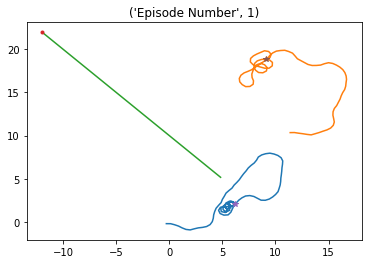

Episode * 2 * Avg Reward is ==> 2197.798506661587 : Ag1 Reward ==> 1117.827646788253 : Ag2 Reward ==> 1077.0740827867685 


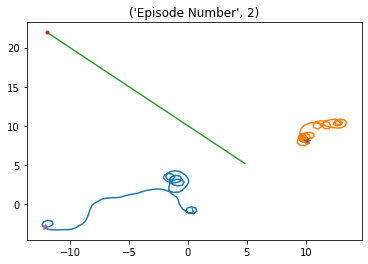

Episode * 3 * Avg Reward is ==> 2354.252746331132 : Ag1 Reward ==> 1412.6067267056658 : Ag2 Reward ==> 1254.5544989645546 


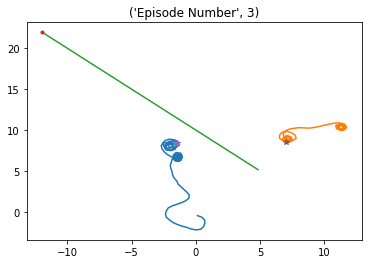

Episode * 4 * Avg Reward is ==> 2318.4022995894557 : Ag1 Reward ==> 1106.17867814628 : Ag2 Reward ==> 1104.6722812181463 


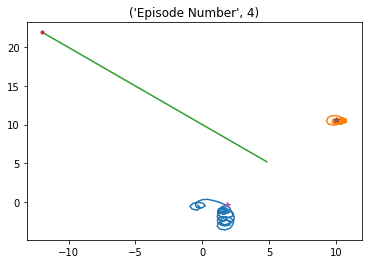

Episode * 5 * Avg Reward is ==> 2290.083438011377 : Ag1 Reward ==> 1099.4614781227278 : Ag2 Reward ==> 1077.346513576334 


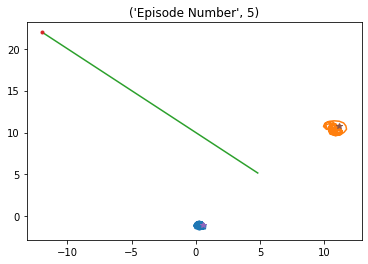

Episode * 6 * Avg Reward is ==> 2278.6040574532367 : Ag1 Reward ==> 1096.4121439182136 : Ag2 Reward ==> 1124.7950107443216 


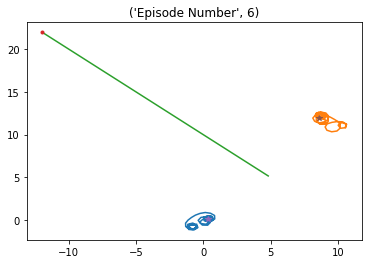

Episode * 7 * Avg Reward is ==> 2258.499325983836 : Ag1 Reward ==> 1053.9143913558219 : Ag2 Reward ==> 1083.9565458116085 


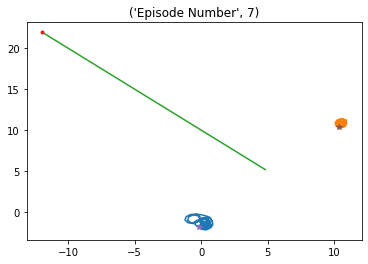

Episode * 8 * Avg Reward is ==> 2245.85086427727 : Ag1 Reward ==> 1078.8343947986657 : Ag2 Reward ==> 1078.4772375326459 


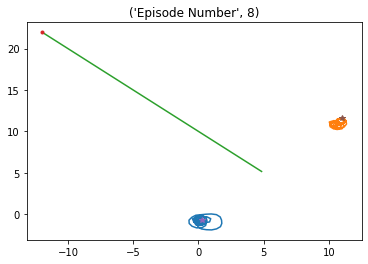

Episode * 9 * Avg Reward is ==> 2239.647889954029 : Ag1 Reward ==> 1094.856734797619 : Ag2 Reward ==> 1095.1673605704825 


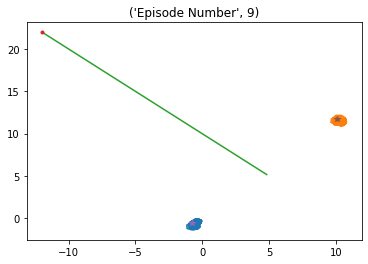

Episode * 10 * Avg Reward is ==> 2237.198688766985 : Ag1 Reward ==> 1106.347970867727 : Ag2 Reward ==> 1108.807907215859 


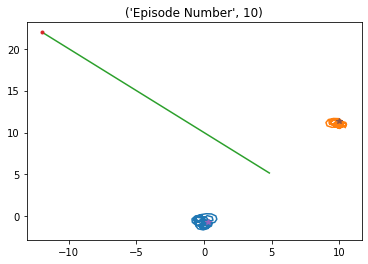

Episode * 11 * Avg Reward is ==> 2240.4126847674484 : Ag1 Reward ==> 1125.8760545990206 : Ag2 Reward ==> 1146.6765901730605 


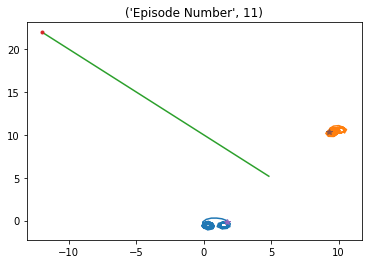

Episode * 12 * Avg Reward is ==> 2238.657773666045 : Ag1 Reward ==> 1101.0898607613572 : Ag2 Reward ==> 1118.2638907892551 


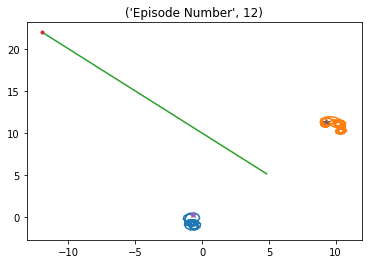

Episode * 13 * Avg Reward is ==> 2233.352538822305 : Ag1 Reward ==> 1079.2296562175852 : Ag2 Reward ==> 1090.4600644798402 


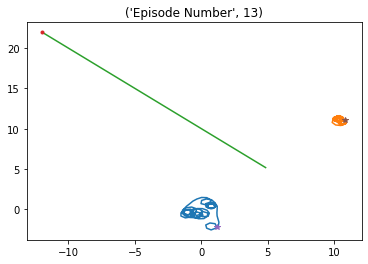

Episode * 14 * Avg Reward is ==> 2229.3376704297348 : Ag1 Reward ==> 1084.1132787242402 : Ag2 Reward ==> 1093.0311026020843 


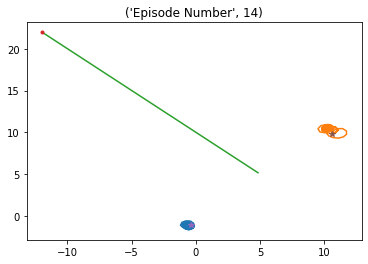

Episode * 15 * Avg Reward is ==> 2220.6480126811853 : Ag1 Reward ==> 1048.2095012761633 : Ag2 Reward ==> 1050.7833029253245 


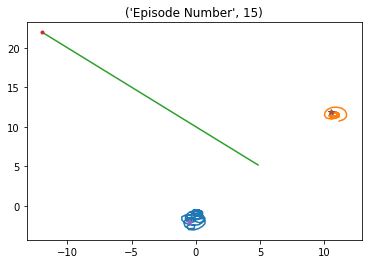

Episode * 16 * Avg Reward is ==> 2225.9516360308144 : Ag1 Reward ==> 1136.1569162209516 : Ag2 Reward ==> 1169.3490700542995 


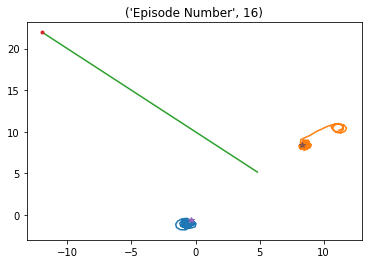

Episode * 17 * Avg Reward is ==> 2222.0064172279926 : Ag1 Reward ==> 1082.2444442779972 : Ag2 Reward ==> 1076.6384721048455 


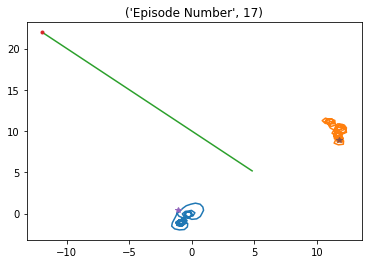

Episode * 18 * Avg Reward is ==> 2206.2374181405066 : Ag1 Reward ==> 1022.8006049378077 : Ag2 Reward ==> 915.3638287154401 


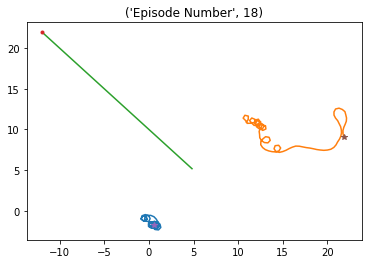

Episode * 19 * Avg Reward is ==> 2194.3387134956406 : Ag1 Reward ==> 1066.6861945759317 : Ag2 Reward ==> 913.4758353121207 


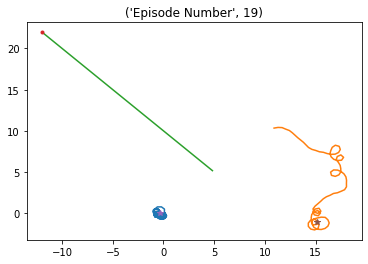

Episode * 20 * Avg Reward is ==> 2206.694929413714 : Ag1 Reward ==> 1166.4473137562031 : Ag2 Reward ==> 1275.0157181009045 


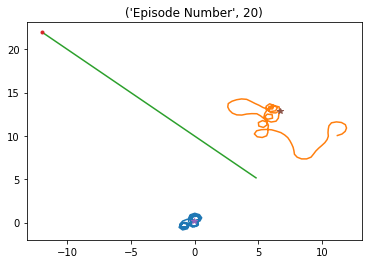

Episode * 21 * Avg Reward is ==> 2203.1429603831507 : Ag1 Reward ==> 1076.4968697112934 : Ag2 Reward ==> 1055.6067100605926 


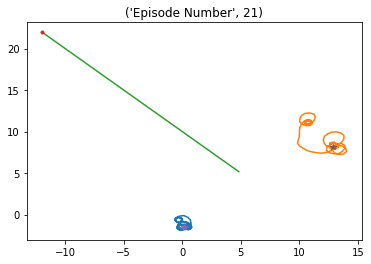

Episode * 22 * Avg Reward is ==> 2200.267717224613 : Ag1 Reward ==> 1069.063816885822 : Ag2 Reward ==> 1070.8237940095046 


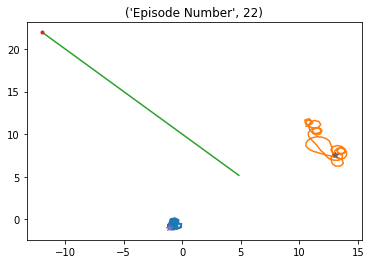

Episode * 23 * Avg Reward is ==> 2199.951236999813 : Ag1 Reward ==> 1067.9467917660998 : Ag2 Reward ==> 1125.0418802881077 


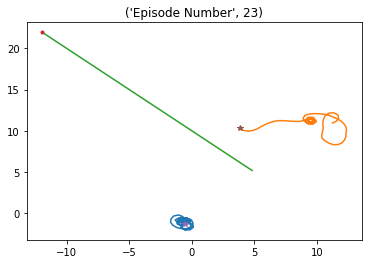

Episode * 24 * Avg Reward is ==> 2202.376962261122 : Ag1 Reward ==> 1123.9479399084846 : Ag2 Reward ==> 1134.2207033627408 


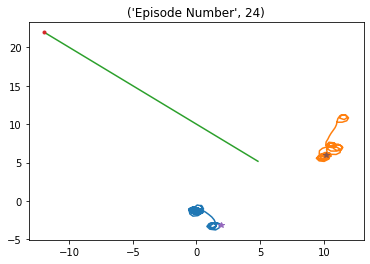

Episode * 25 * Avg Reward is ==> 2200.513595144571 : Ag1 Reward ==> 1136.2742893440168 : Ag2 Reward ==> 1019.5184950033266 


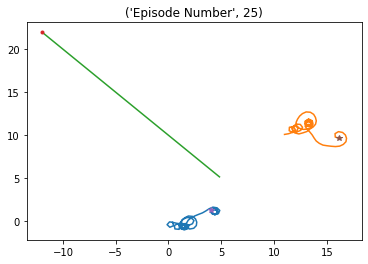

Episode * 26 * Avg Reward is ==> 2203.6406861379915 : Ag1 Reward ==> 1181.2974928744804 : Ag2 Reward ==> 1100.5204680990253 


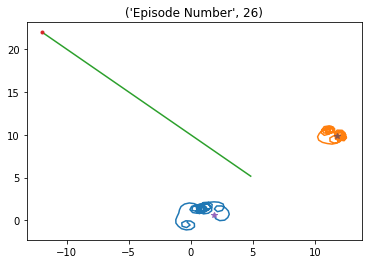

Episode * 27 * Avg Reward is ==> 2204.750453227016 : Ag1 Reward ==> 1145.426861548636 : Ag2 Reward ==> 1088.1775359930277 


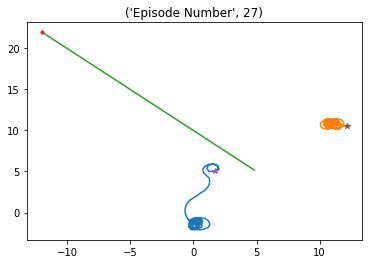

Episode * 28 * Avg Reward is ==> 2198.467662512307 : Ag1 Reward ==> 1068.1990370474898 : Ag2 Reward ==> 960.6332761676674 


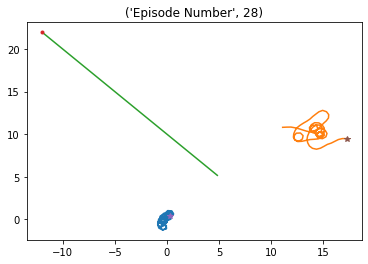

Episode * 29 * Avg Reward is ==> 2197.360002091193 : Ag1 Reward ==> 1135.914980722554 : Ag2 Reward ==> 1030.430529577458 


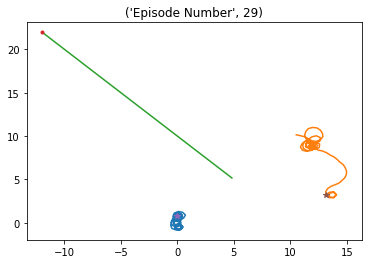

Episode * 30 * Avg Reward is ==> 2191.2084536668963 : Ag1 Reward ==> 1054.8082176208134 : Ag2 Reward ==> 958.0053317414676 


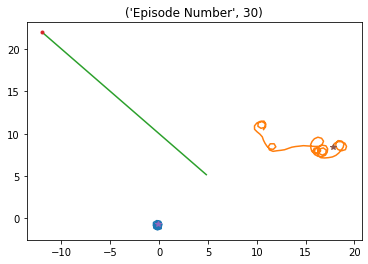

Episode * 31 * Avg Reward is ==> 2190.253201320242 : Ag1 Reward ==> 1072.0742767678314 : Ag2 Reward ==> 1089.5213541527885 


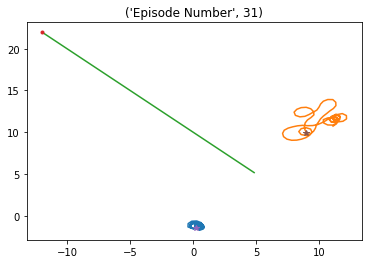

Episode * 32 * Avg Reward is ==> 2184.72301675383 : Ag1 Reward ==> 1095.9552012145323 : Ag2 Reward ==> 917.332093980533 


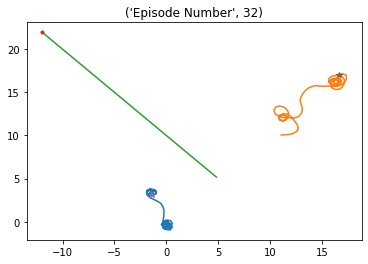

Episode * 33 * Avg Reward is ==> 2180.2669233384386 : Ag1 Reward ==> 993.0563007669709 : Ag2 Reward ==> 1044.615633278938 


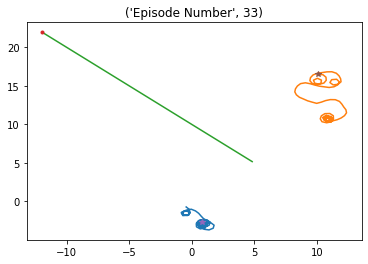

Episode * 34 * Avg Reward is ==> 2180.54954407812 : Ag1 Reward ==> 1136.2658060575077 : Ag2 Reward ==> 1053.6102224301046 


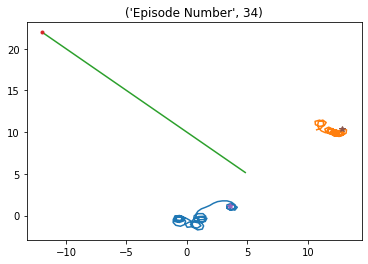

Episode * 35 * Avg Reward is ==> 2179.4063819366747 : Ag1 Reward ==> 1029.2884561285691 : Ag2 Reward ==> 1111.250412998958 


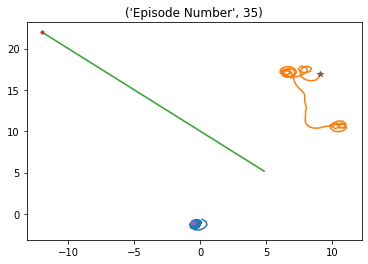

Episode * 36 * Avg Reward is ==> 2178.823508175141 : Ag1 Reward ==> 1136.95850483012 : Ag2 Reward ==> 1021.4644216913322 


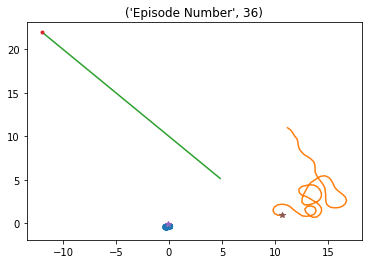

Episode * 37 * Avg Reward is ==> 2186.596419565731 : Ag1 Reward ==> 1185.8473308716766 : Ag2 Reward ==> 1280.5738987553068 


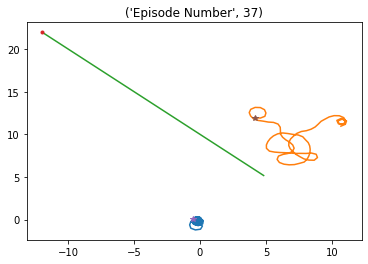

Episode * 38 * Avg Reward is ==> 2197.9871571075523 : Ag1 Reward ==> 1330.3154210036307 : Ag2 Reward ==> 1289.1290251512921 


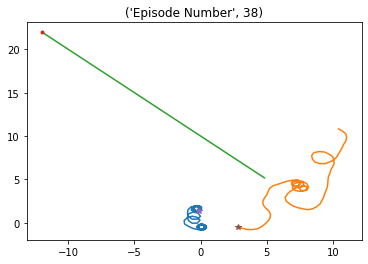

Episode * 39 * Avg Reward is ==> 2195.4784947251183 : Ag1 Reward ==> 1095.5934226432812 : Ag2 Reward ==> 1004.5559015493602 


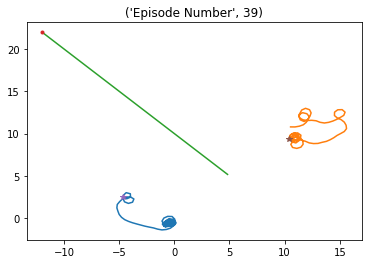

Episode * 40 * Avg Reward is ==> 2197.7928724305884 : Ag1 Reward ==> 1174.2556563496648 : Ag2 Reward ==> 1113.7979465942467 


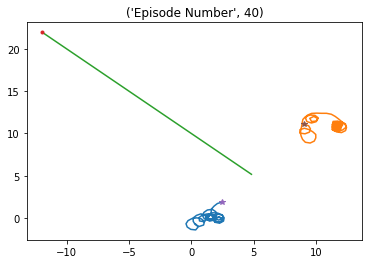

Episode * 41 * Avg Reward is ==> 2200.4773157331497 : Ag1 Reward ==> 1164.69470525238 : Ag2 Reward ==> 1143.3783105982275 


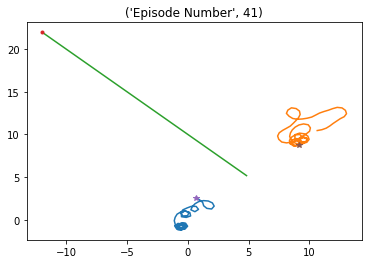

Episode * 42 * Avg Reward is ==> 2205.605487605913 : Ag1 Reward ==> 1257.538903583595 : Ag2 Reward ==> 1142.489700901957 


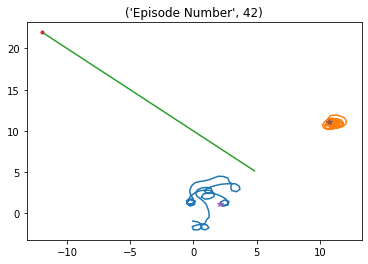

Episode * 43 * Avg Reward is ==> 2189.7861133784395 : Ag1 Reward ==> 957.5203795939491 : Ag2 Reward ==> 1076.8658769773253 


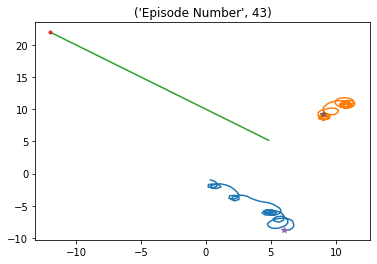

Episode * 44 * Avg Reward is ==> 2193.7286879399303 : Ag1 Reward ==> 1184.6432582103284 : Ag2 Reward ==> 1183.9106836137482 


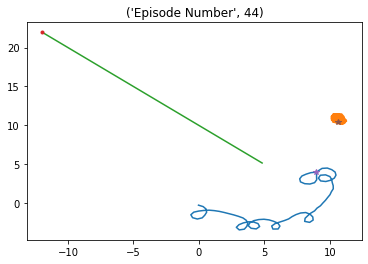

Episode * 45 * Avg Reward is ==> 2202.817279196007 : Ag1 Reward ==> 1160.130874850544 : Ag2 Reward ==> 1380.2207670915575 


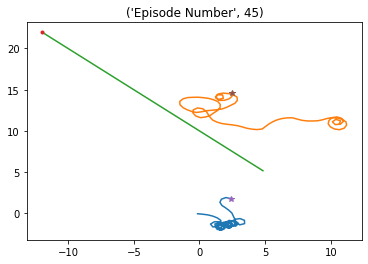

Episode * 46 * Avg Reward is ==> 2205.3025330224627 : Ag1 Reward ==> 1115.564703251414 : Ag2 Reward ==> 1205.0526044693634 


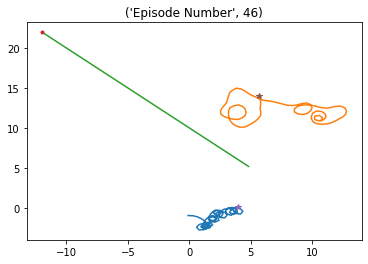

Episode * 47 * Avg Reward is ==> 2202.307599656477 : Ag1 Reward ==> 1137.2891301924763 : Ag2 Reward ==> 880.7844723355366 


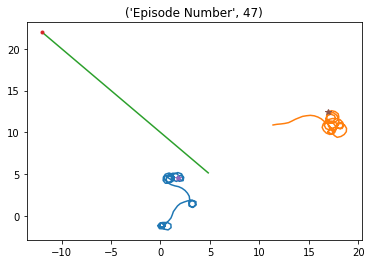

Episode * 48 * Avg Reward is ==> 2203.2986181580154 : Ag1 Reward ==> 1079.5805341761309 : Ag2 Reward ==> 1117.3718382167096 


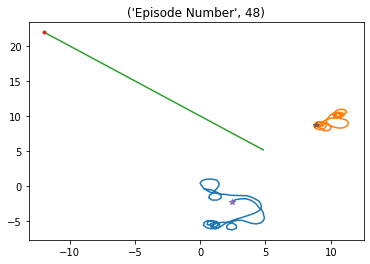

Episode * 49 * Avg Reward is ==> 2201.855057190533 : Ag1 Reward ==> 1061.8783862105624 : Ag2 Reward ==> 1070.4032704582391 


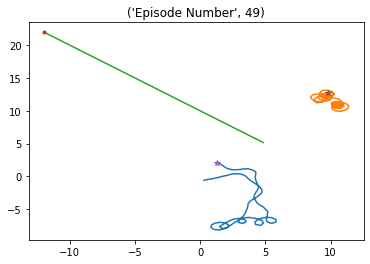

Episode * 50 * Avg Reward is ==> 2214.6885496608656 : Ag1 Reward ==> 1381.5488924094507 : Ag2 Reward ==> 1346.9466844874476 


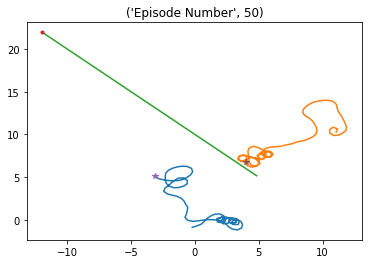

Episode * 51 * Avg Reward is ==> 2220.2646133094304 : Ag1 Reward ==> 1296.831839996235 : Ag2 Reward ==> 1198.7633507184448 


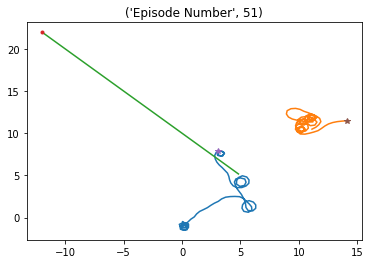

Episode * 52 * Avg Reward is ==> 2216.8595892295352 : Ag1 Reward ==> 1051.6624742165802 : Ag2 Reward ==> 1031.4903141382206 


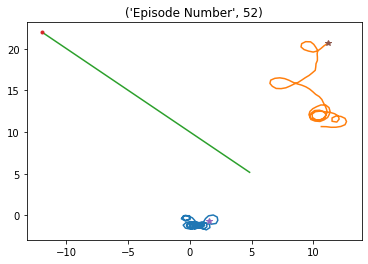

Episode * 53 * Avg Reward is ==> 2213.9678731923204 : Ag1 Reward ==> 1030.8904486574206 : Ag2 Reward ==> 1023.1306305514129 


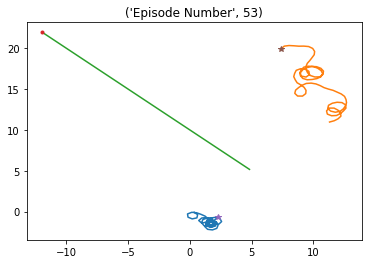

Episode * 54 * Avg Reward is ==> 2202.407023622928 : Ag1 Reward ==> 956.0075262883108 : Ag2 Reward ==> 758.7028722623078 


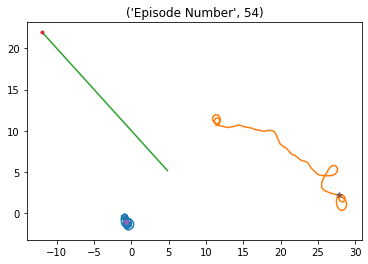

Episode * 55 * Avg Reward is ==> 2204.9900646562446 : Ag1 Reward ==> 1075.3046165507226 : Ag2 Reward ==> 1127.0098289834589 


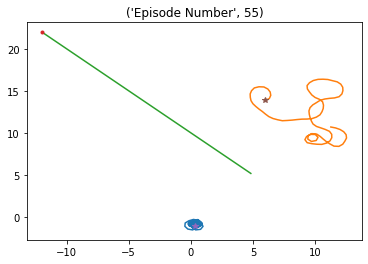

Episode * 56 * Avg Reward is ==> 2207.507525202748 : Ag1 Reward ==> 1142.9863984785393 : Ag2 Reward ==> 1263.2180096568482 


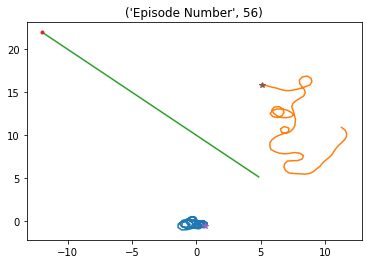

Episode * 57 * Avg Reward is ==> 2208.97245330478 : Ag1 Reward ==> 1094.5330417145342 : Ag2 Reward ==> 1122.9469987495906 


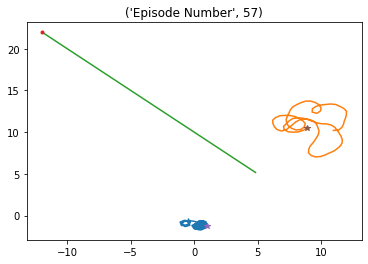

Episode * 58 * Avg Reward is ==> 2215.273478660619 : Ag1 Reward ==> 1126.618269617116 : Ag2 Reward ==> 1063.5871782696688 


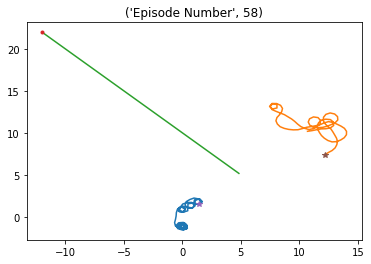

Episode * 59 * Avg Reward is ==> 2227.387392286661 : Ag1 Reward ==> 1254.8873484615954 : Ag2 Reward ==> 1209.8312264681285 


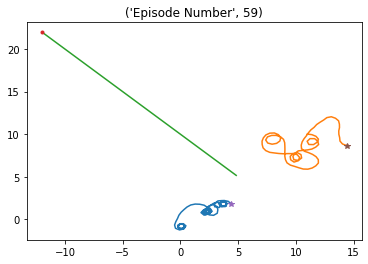

Episode * 60 * Avg Reward is ==> 2223.6478334271837 : Ag1 Reward ==> 1215.1785395197035 : Ag2 Reward ==> 1076.7021379583116 


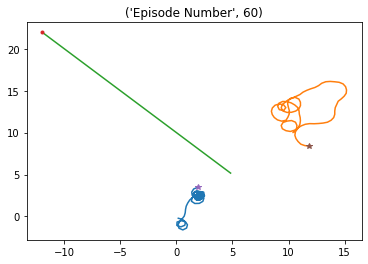

Episode * 61 * Avg Reward is ==> 2221.7176413308666 : Ag1 Reward ==> 1087.567565211488 : Ag2 Reward ==> 967.3283307077108 


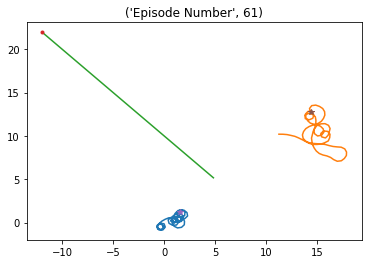

Episode * 62 * Avg Reward is ==> 2216.920684659514 : Ag1 Reward ==> 1008.0613847685277 : Ag2 Reward ==> 939.9479592727043 


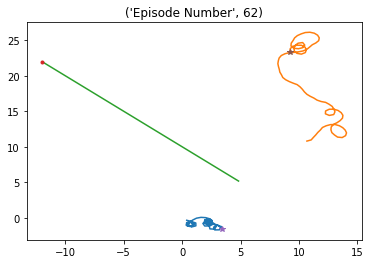

Episode * 63 * Avg Reward is ==> 2224.3917637385503 : Ag1 Reward ==> 1188.1336729776651 : Ag2 Reward ==> 1303.6981622379972 


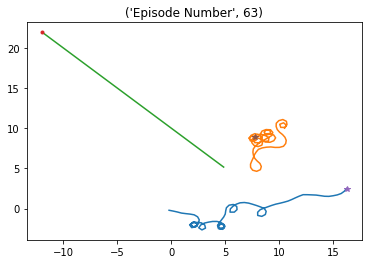

Episode * 64 * Avg Reward is ==> 2223.9198802777382 : Ag1 Reward ==> 1128.0441558618834 : Ag2 Reward ==> 1111.2491489768727 


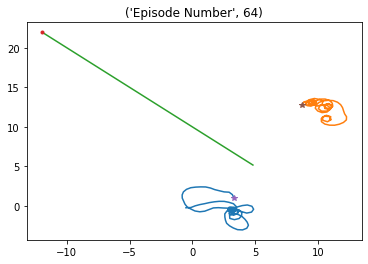

Episode * 65 * Avg Reward is ==> 2222.7262939549764 : Ag1 Reward ==> 1012.5024209607493 : Ag2 Reward ==> 1095.546910476099 


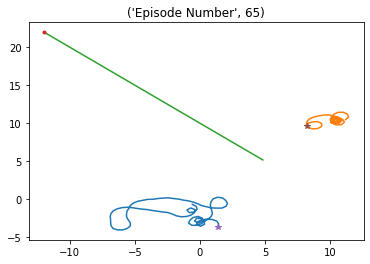

Episode * 66 * Avg Reward is ==> 2225.7009711710753 : Ag1 Reward ==> 1197.4215150220582 : Ag2 Reward ==> 1203.3835345954158 


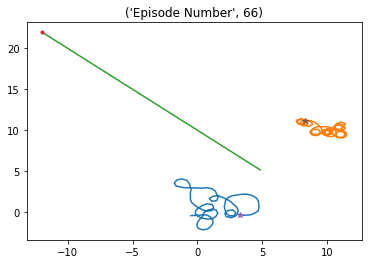

Episode * 67 * Avg Reward is ==> 2230.956334551431 : Ag1 Reward ==> 1228.0128953653964 : Ag2 Reward ==> 1215.8060373904882 


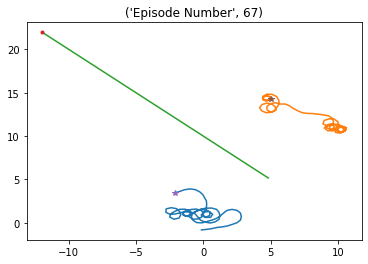

Episode * 68 * Avg Reward is ==> 2243.590358433967 : Ag1 Reward ==> 1293.1367839030336 : Ag2 Reward ==> 1241.0564846135571 


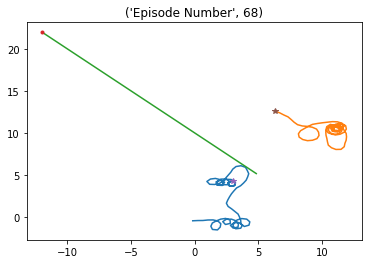

Episode * 69 * Avg Reward is ==> 2239.8072546233807 : Ag1 Reward ==> 970.7672580067212 : Ag2 Reward ==> 1044.254099869831 


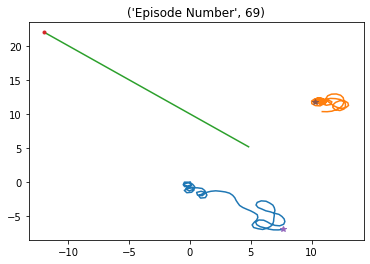

Episode * 70 * Avg Reward is ==> 2260.4599397969355 : Ag1 Reward ==> 1452.6367526616405 : Ag2 Reward ==> 1386.2842036428412 


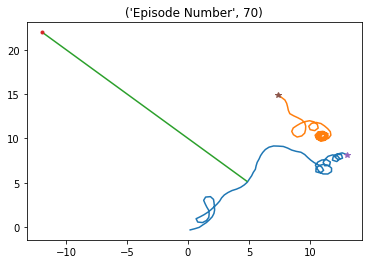

Episode * 71 * Avg Reward is ==> 2267.757669786922 : Ag1 Reward ==> 1222.6242976404008 : Ag2 Reward ==> 1230.880532879686 


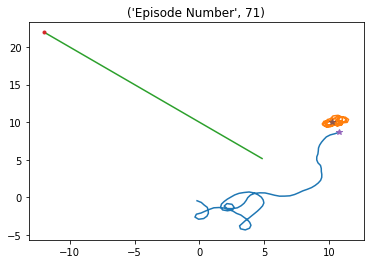

Episode * 72 * Avg Reward is ==> 2276.1687307687776 : Ag1 Reward ==> 1166.9541545540553 : Ag2 Reward ==> 1182.7755799152217 


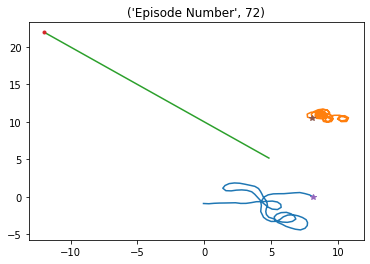

Episode * 73 * Avg Reward is ==> 2281.9794571977254 : Ag1 Reward ==> 1092.6972382545337 : Ag2 Reward ==> 1177.403752949287 


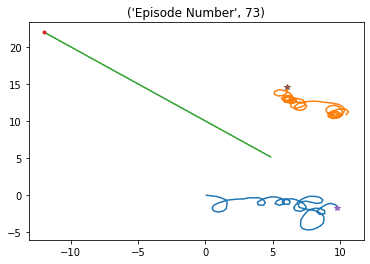

Episode * 74 * Avg Reward is ==> 2283.4367564480463 : Ag1 Reward ==> 1138.5762263869938 : Ag2 Reward ==> 1109.5917721134415 


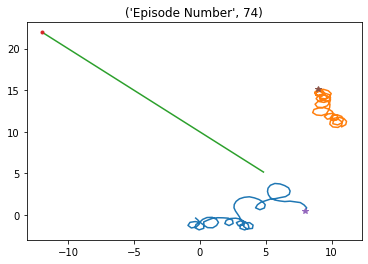

Episode * 75 * Avg Reward is ==> 2294.245068515056 : Ag1 Reward ==> 1303.0778603060105 : Ag2 Reward ==> 1269.7934915019257 


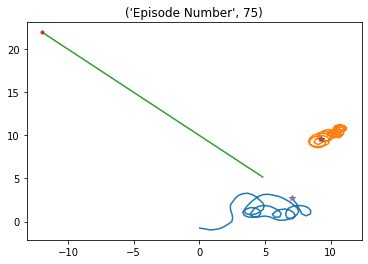

Episode * 76 * Avg Reward is ==> 2313.223979986005 : Ag1 Reward ==> 1594.8940558844206 : Ag2 Reward ==> 1322.6853294749774 


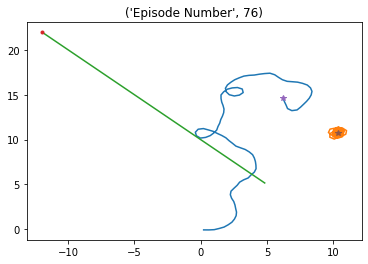

Episode * 77 * Avg Reward is ==> 2307.6474857860303 : Ag1 Reward ==> 1087.7961957797565 : Ag2 Reward ==> 1155.5652658482447 


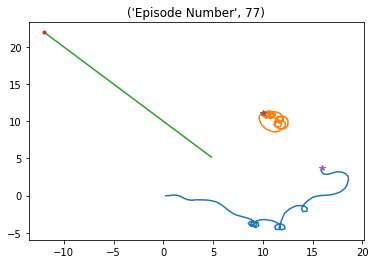

Episode * 78 * Avg Reward is ==> 2293.0587926689095 : Ag1 Reward ==> 984.4900832613811 : Ag2 Reward ==> 1051.4066382087174 


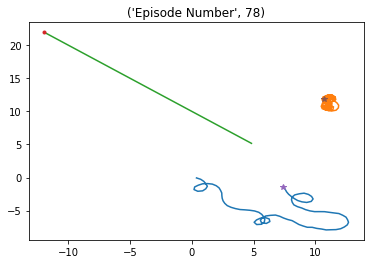

Episode * 79 * Avg Reward is ==> 2306.984399971361 : Ag1 Reward ==> 1317.437604032239 : Ag2 Reward ==> 1339.7360122584744 


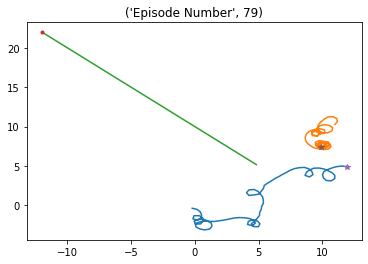

Episode * 80 * Avg Reward is ==> 2312.415845785262 : Ag1 Reward ==> 1259.7358436561087 : Ag2 Reward ==> 1245.575591843816 


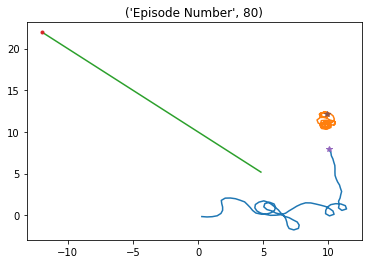

Episode * 81 * Avg Reward is ==> 2319.2444210665844 : Ag1 Reward ==> 1367.9484385963156 : Ag2 Reward ==> 1213.2675885071976 


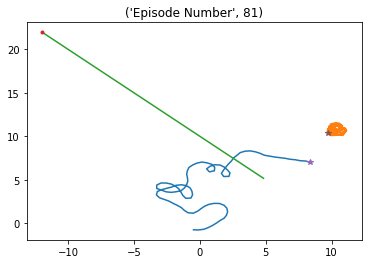

Episode * 82 * Avg Reward is ==> 2316.458035668004 : Ag1 Reward ==> 1126.2416574276383 : Ag2 Reward ==> 1162.3315311147026 


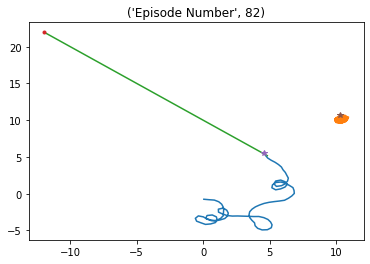

Episode * 83 * Avg Reward is ==> 2330.1323538439965 : Ag1 Reward ==> 1320.5026586246202 : Ag2 Reward ==> 1260.8563249863673 


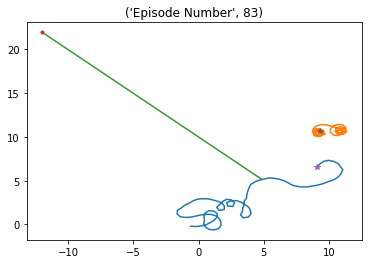

Episode * 84 * Avg Reward is ==> 2331.4713212572215 : Ag1 Reward ==> 1270.2410680895878 : Ag2 Reward ==> 1151.8715702634781 


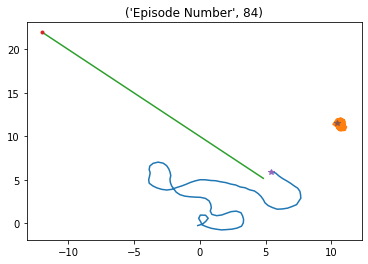

Episode * 85 * Avg Reward is ==> 2338.93114471691 : Ag1 Reward ==> 1433.0128067165172 : Ag2 Reward ==> 1405.731773613105 


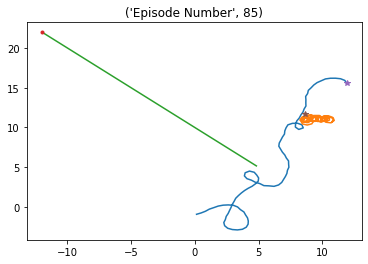

Episode * 86 * Avg Reward is ==> 2353.9730314374738 : Ag1 Reward ==> 1503.9956634733132 : Ag2 Reward ==> 1418.297113070027 


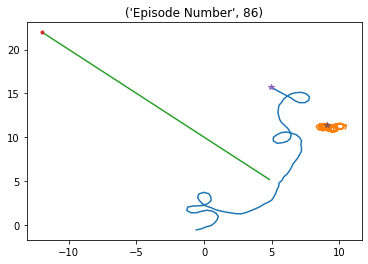

Episode * 87 * Avg Reward is ==> 2378.5487816423865 : Ag1 Reward ==> 1525.2297893788623 : Ag2 Reward ==> 1475.8738213456704 


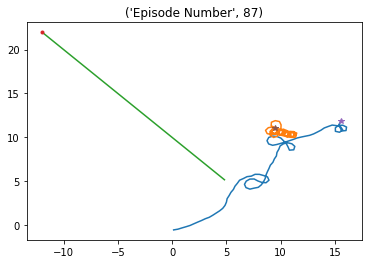

Episode * 88 * Avg Reward is ==> 2385.5598616600173 : Ag1 Reward ==> 1218.7759089388453 : Ag2 Reward ==> 1258.6196641592217 


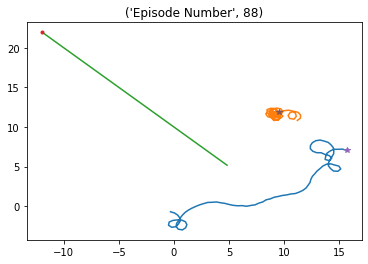

Episode * 89 * Avg Reward is ==> 2399.9700267049147 : Ag1 Reward ==> 1380.5874587773794 : Ag2 Reward ==> 1328.1007996873313 


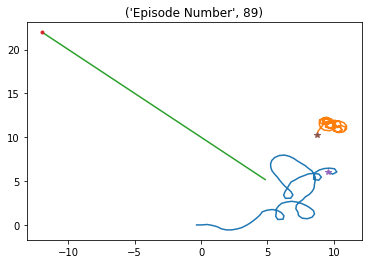

Episode * 90 * Avg Reward is ==> 2387.036550667438 : Ag1 Reward ==> 1127.5833016768577 : Ag2 Reward ==> 1083.5732337209497 


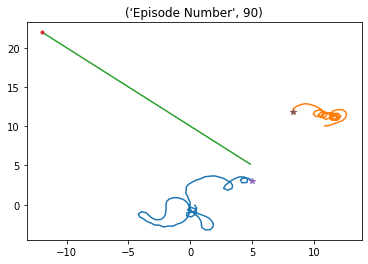

Episode * 91 * Avg Reward is ==> 2383.0984200779917 : Ag1 Reward ==> 1180.866330537147 : Ag2 Reward ==> 1157.2036365996876 


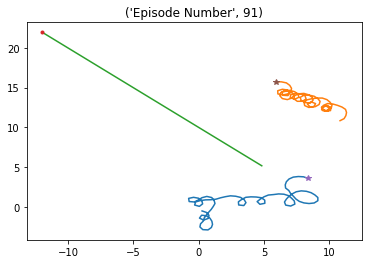

Episode * 92 * Avg Reward is ==> 2398.225840958034 : Ag1 Reward ==> 1454.5004276368256 : Ag2 Reward ==> 1233.7491959196614 


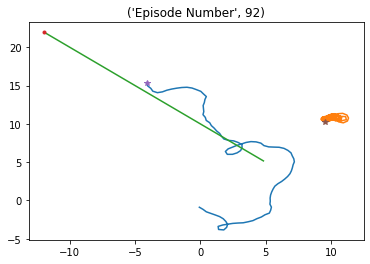

Episode * 93 * Avg Reward is ==> 2418.131914645258 : Ag1 Reward ==> 1496.012624457936 : Ag2 Reward ==> 1354.2514022398661 


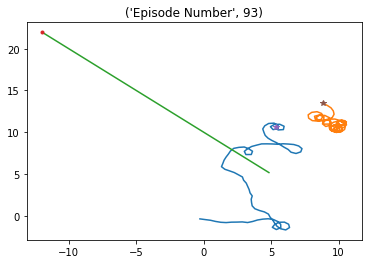

Episode * 94 * Avg Reward is ==> 2429.856636548381 : Ag1 Reward ==> 1131.5121944164855 : Ag2 Reward ==> 1052.1870802590522 


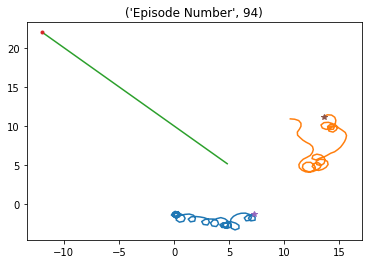

Episode * 95 * Avg Reward is ==> 2440.764615204638 : Ag1 Reward ==> 1334.0220097171161 : Ag2 Reward ==> 1304.6115820673447 


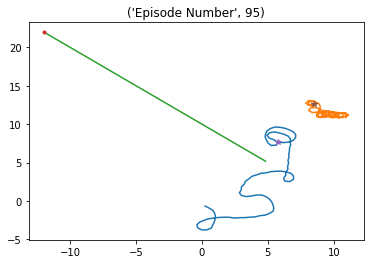

Episode * 96 * Avg Reward is ==> 2454.5594512015814 : Ag1 Reward ==> 1543.4333424338008 : Ag2 Reward ==> 1414.5645055793311 


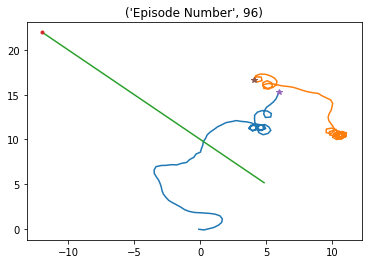

Episode * 97 * Avg Reward is ==> 2471.6497406638564 : Ag1 Reward ==> 1489.0529375053206 : Ag2 Reward ==> 1412.0386814497801 


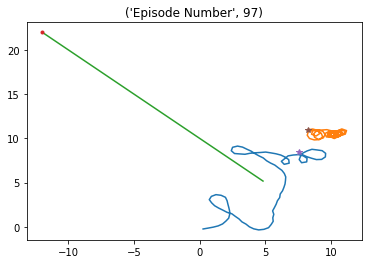

Episode * 98 * Avg Reward is ==> 2476.0847134404353 : Ag1 Reward ==> 1137.269886296853 : Ag2 Reward ==> 1230.3344726531116 


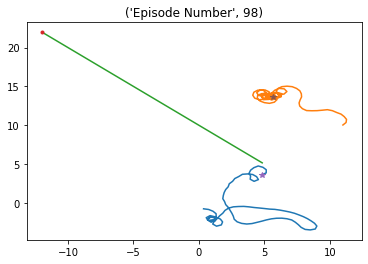

Episode * 99 * Avg Reward is ==> 2484.2845709103212 : Ag1 Reward ==> 1381.156068073296 : Ag2 Reward ==> 1411.5568056518587 


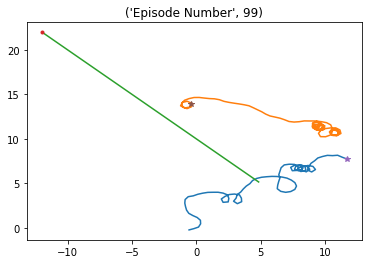

Episode * 100 * Avg Reward is ==> 2485.2982614645457 : Ag1 Reward ==> 1159.2528060941422 : Ag2 Reward ==> 1173.1754935528681 


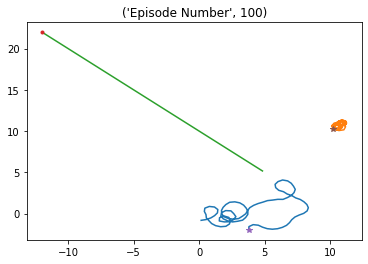

Episode * 101 * Avg Reward is ==> 2485.280663910939 : Ag1 Reward ==> 968.8073369934724 : Ag2 Reward ==> 1085.384656781446 


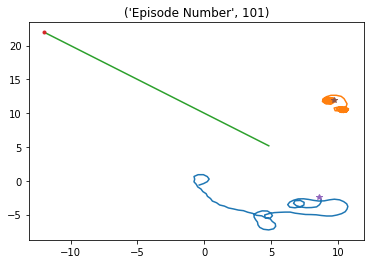

Episode * 102 * Avg Reward is ==> 2504.3674384509154 : Ag1 Reward ==> 1378.8114652197623 : Ag2 Reward ==> 1332.6688604205397 


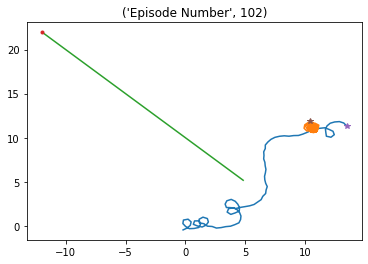

Episode * 103 * Avg Reward is ==> 2493.494894936213 : Ag1 Reward ==> 963.3555856975291 : Ag2 Reward ==> 1093.5745089300137 


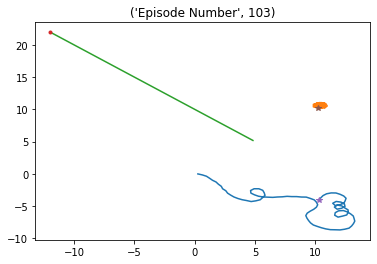

Episode * 104 * Avg Reward is ==> 2501.695016509557 : Ag1 Reward ==> 1281.6543871893318 : Ag2 Reward ==> 1285.6437805831886 


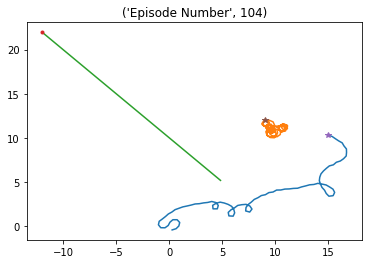

Episode * 105 * Avg Reward is ==> 2506.927425458159 : Ag1 Reward ==> 1158.8366040404098 : Ag2 Reward ==> 1158.5090853405202 


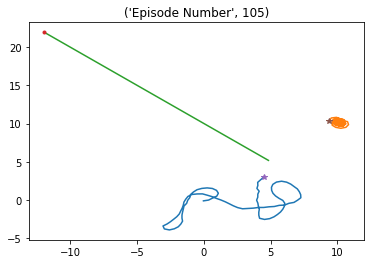

Episode * 106 * Avg Reward is ==> 2502.693139308108 : Ag1 Reward ==> 1082.278554293606 : Ag2 Reward ==> 1149.1550493218438 


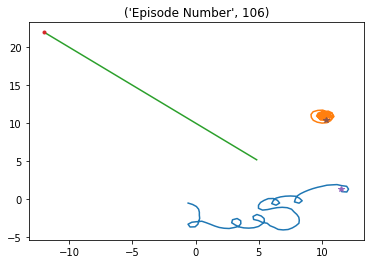

Episode * 107 * Avg Reward is ==> 2497.7591691959724 : Ag1 Reward ==> 1140.803851081269 : Ag2 Reward ==> 1105.6562771891788 


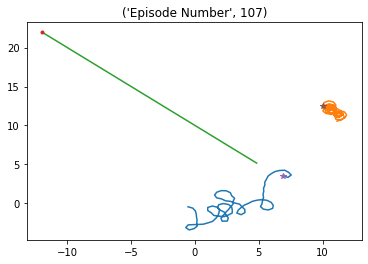

Episode * 108 * Avg Reward is ==> 2491.941713174856 : Ag1 Reward ==> 1113.6443822603273 : Ag2 Reward ==> 1187.8506454115975 


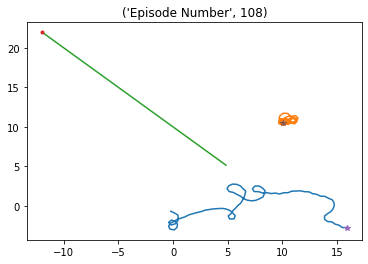

Episode * 109 * Avg Reward is ==> 2494.5192456116965 : Ag1 Reward ==> 1001.0536335449775 : Ag2 Reward ==> 1117.0690218052011 


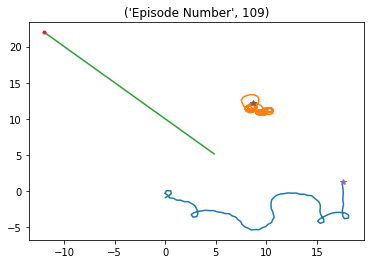

Episode * 110 * Avg Reward is ==> 2480.8967152493874 : Ag1 Reward ==> 1150.4429230404255 : Ag2 Reward ==> 1143.576818771704 


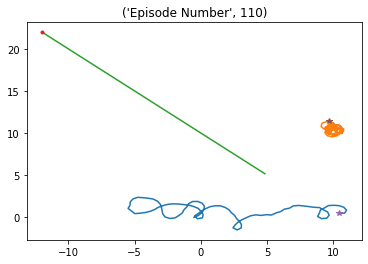

Episode * 111 * Avg Reward is ==> 2472.8613378580912 : Ag1 Reward ==> 1025.9286713677575 : Ag2 Reward ==> 1106.1610635004783 


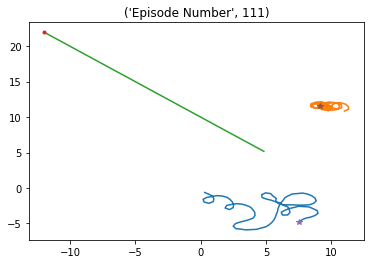

Episode * 112 * Avg Reward is ==> 2466.1498815623972 : Ag1 Reward ==> 984.4206910878811 : Ag2 Reward ==> 1096.8507915536434 


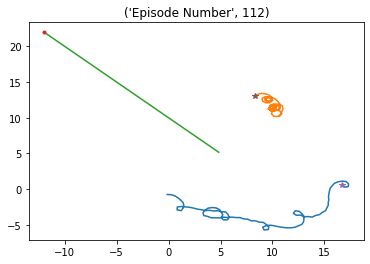

Episode * 113 * Avg Reward is ==> 2459.414582861272 : Ag1 Reward ==> 928.4224556487884 : Ag2 Reward ==> 1072.2665875100051 


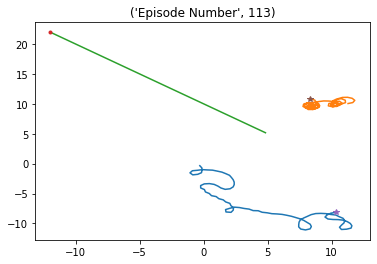

Episode * 114 * Avg Reward is ==> 2454.9921705028164 : Ag1 Reward ==> 1005.4290838450374 : Ag2 Reward ==> 1065.8424203171958 


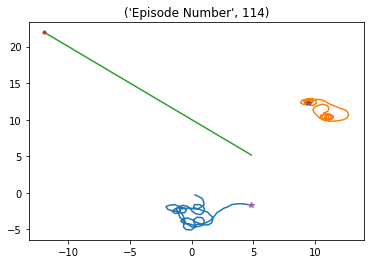

Episode * 115 * Avg Reward is ==> 2446.867868410499 : Ag1 Reward ==> 1059.2161878797444 : Ag2 Reward ==> 1188.683080235495 


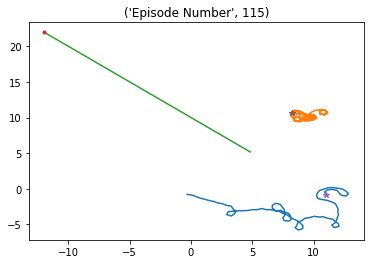

Episode * 116 * Avg Reward is ==> 2434.5535385255725 : Ag1 Reward ==> 1232.2467304805693 : Ag2 Reward ==> 1192.7594594817758 


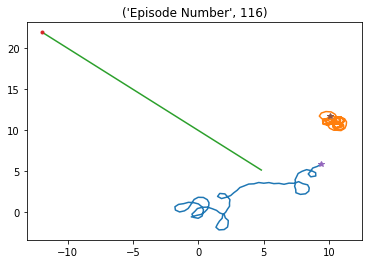

Episode * 117 * Avg Reward is ==> 2442.281739452901 : Ag1 Reward ==> 1249.7196221027784 : Ag2 Reward ==> 1302.76987661836 


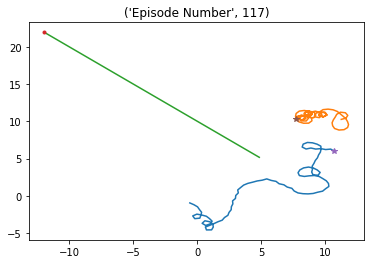

Episode * 118 * Avg Reward is ==> 2453.2729351017197 : Ag1 Reward ==> 1214.782016595646 : Ag2 Reward ==> 1260.7625308271947 


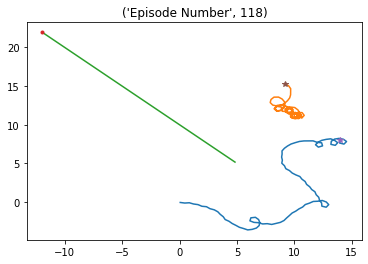

Episode * 119 * Avg Reward is ==> 2454.971428887316 : Ag1 Reward ==> 1406.5314125683478 : Ag2 Reward ==> 1318.5819551462098 


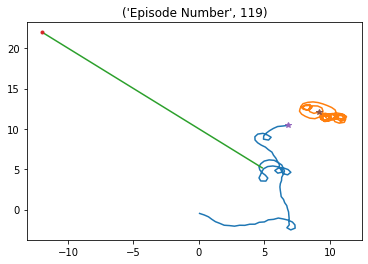

Episode * 120 * Avg Reward is ==> 2455.188786727279 : Ag1 Reward ==> 1222.1620046625071 : Ag2 Reward ==> 1291.8437444359267 


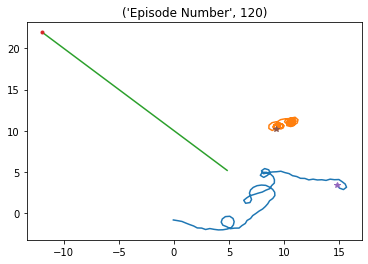

Episode * 121 * Avg Reward is ==> 2452.791376515221 : Ag1 Reward ==> 1224.6597178416348 : Ag2 Reward ==> 1260.659900779558 


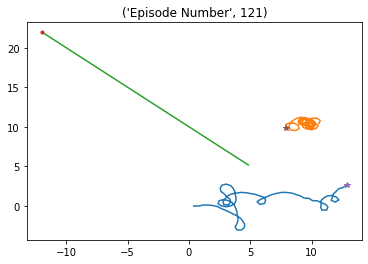

Episode * 122 * Avg Reward is ==> 2461.519647042416 : Ag1 Reward ==> 1308.9831118520722 : Ag2 Reward ==> 1328.7208977780742 


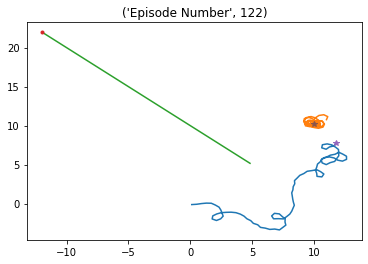

Episode * 123 * Avg Reward is ==> 2466.015131106778 : Ag1 Reward ==> 1330.4668221637244 : Ag2 Reward ==> 1430.7115240217445 


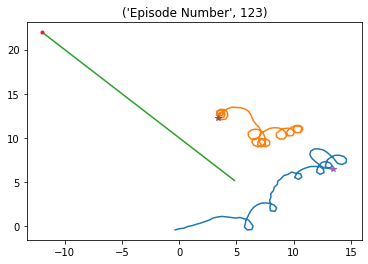

Episode * 124 * Avg Reward is ==> 2463.428796508198 : Ag1 Reward ==> 1143.8139017415147 : Ag2 Reward ==> 1174.845352668353 


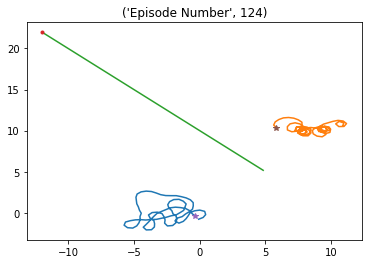

Episode * 125 * Avg Reward is ==> 2452.6629229784553 : Ag1 Reward ==> 1199.2367467075912 : Ag2 Reward ==> 1208.8728924323161 


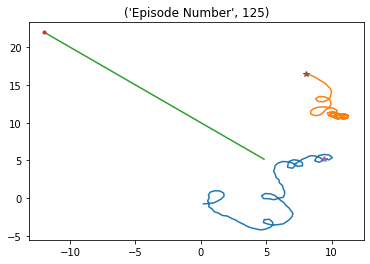

Episode * 126 * Avg Reward is ==> 2433.9773521029806 : Ag1 Reward ==> 973.8541006930776 : Ag2 Reward ==> 1201.0158408312827 


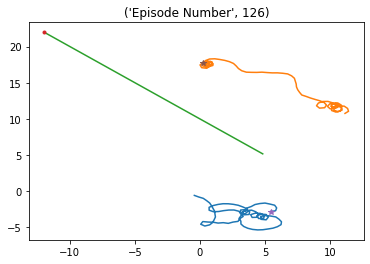

Episode * 127 * Avg Reward is ==> 2429.160936406291 : Ag1 Reward ==> 1402.8916719329825 : Ag2 Reward ==> 1405.555310923961 


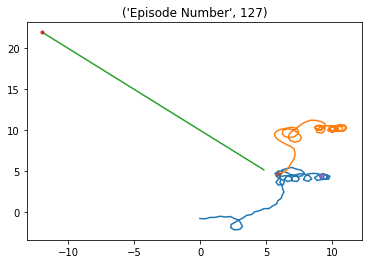

Episode * 128 * Avg Reward is ==> 2421.6948643370306 : Ag1 Reward ==> 1136.0279108421555 : Ag2 Reward ==> 1042.7247794854884 


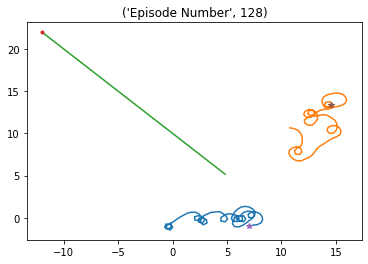

Episode * 129 * Avg Reward is ==> 2408.5794672921966 : Ag1 Reward ==> 1076.0417527886057 : Ag2 Reward ==> 1108.0306238827482 


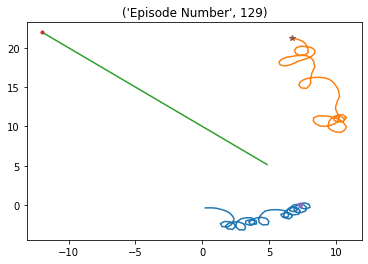

Episode * 130 * Avg Reward is ==> 2421.150094649958 : Ag1 Reward ==> 1331.2134829183449 : Ag2 Reward ==> 1382.7681467899179 


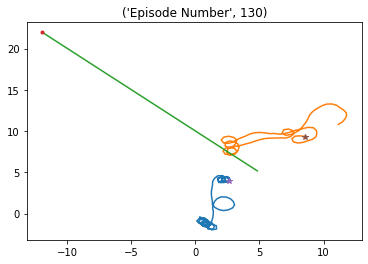

Episode * 131 * Avg Reward is ==> 2409.826928358113 : Ag1 Reward ==> 1036.3184306725852 : Ag2 Reward ==> 848.8248847904557 


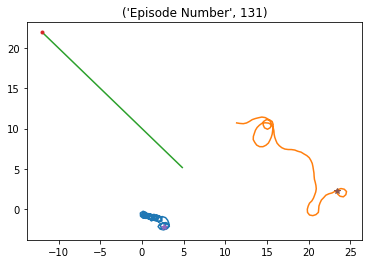

Episode * 132 * Avg Reward is ==> 2399.8907401607444 : Ag1 Reward ==> 1132.4261212474369 : Ag2 Reward ==> 1158.3759744142951 


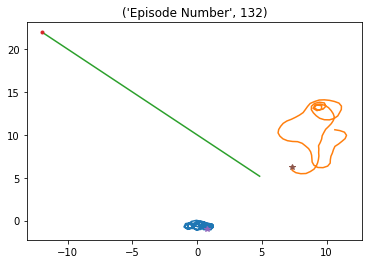

Episode * 133 * Avg Reward is ==> 2381.626603258837 : Ag1 Reward ==> 1122.7310659126026 : Ag2 Reward ==> 996.9674847089135 


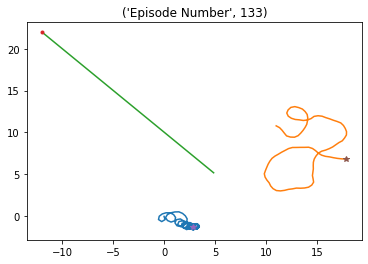

Episode * 134 * Avg Reward is ==> 2372.7875029374563 : Ag1 Reward ==> 978.6229779597068 : Ag2 Reward ==> 851.5122838606057 


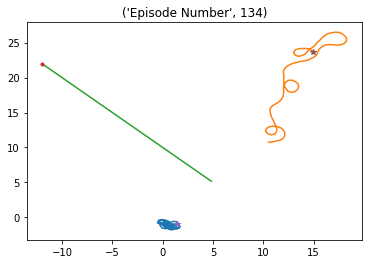

Episode * 135 * Avg Reward is ==> 2356.601837338252 : Ag1 Reward ==> 1047.2101248182184 : Ag2 Reward ==> 943.9968429980588 


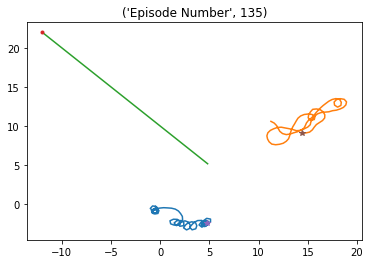

Episode * 136 * Avg Reward is ==> 2334.223233749107 : Ag1 Reward ==> 1065.8715878849075 : Ag2 Reward ==> 996.982116562435 


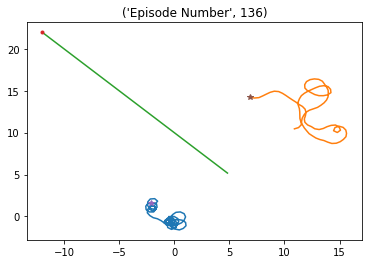

Episode * 137 * Avg Reward is ==> 2323.1193254338973 : Ag1 Reward ==> 1217.5724438522047 : Ag2 Reward ==> 1239.3628424945025 


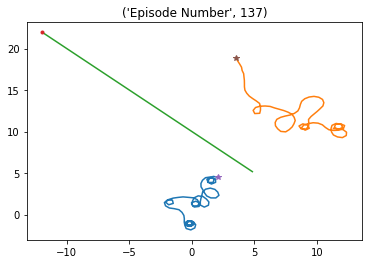

Episode * 138 * Avg Reward is ==> 2311.3606878065243 : Ag1 Reward ==> 992.358151042968 : Ag2 Reward ==> 904.9007028120747 


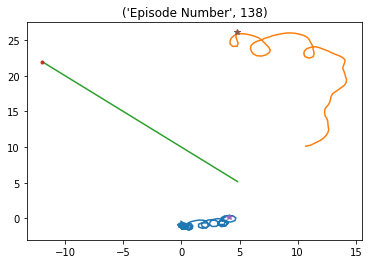

Episode * 139 * Avg Reward is ==> 2292.679185203023 : Ag1 Reward ==> 1116.0868092852231 : Ag2 Reward ==> 929.365960299852 


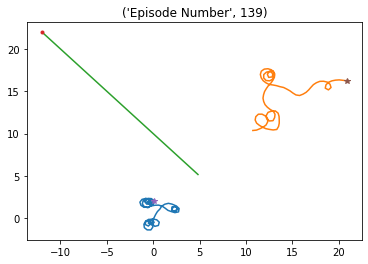

Episode * 140 * Avg Reward is ==> 2297.131270615491 : Ag1 Reward ==> 1106.1579583357945 : Ag2 Reward ==> 1404.353757809958 


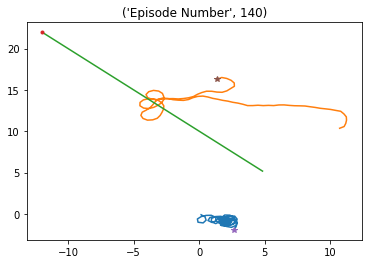

Episode * 141 * Avg Reward is ==> 2301.92931346475 : Ag1 Reward ==> 1183.3587906965254 : Ag2 Reward ==> 1062.7549170487605 


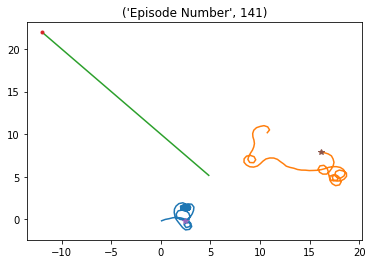

Episode * 142 * Avg Reward is ==> 2290.945493170622 : Ag1 Reward ==> 1056.1110360879566 : Ag2 Reward ==> 1216.0164777872278 


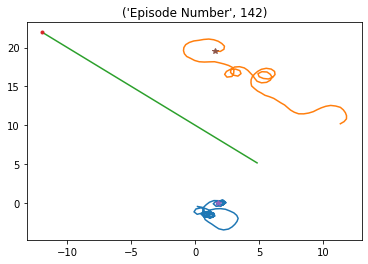

Episode * 143 * Avg Reward is ==> 2291.6372349099056 : Ag1 Reward ==> 1058.197100833735 : Ag2 Reward ==> 1026.40266336515 


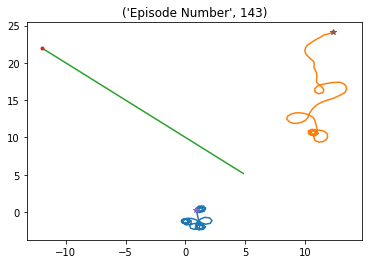

Episode * 144 * Avg Reward is ==> 2284.0010218217953 : Ag1 Reward ==> 1160.9969047100471 : Ag2 Reward ==> 1100.8527395380647 


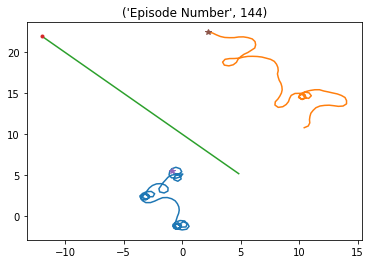

Episode * 145 * Avg Reward is ==> 2275.0335236427645 : Ag1 Reward ==> 1043.714349049051 : Ag2 Reward ==> 914.93141317064 


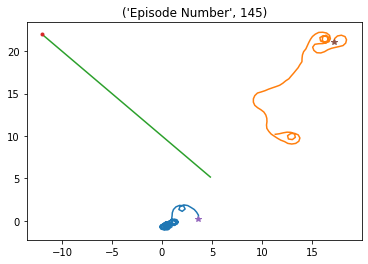

Episode * 146 * Avg Reward is ==> 2285.328277831348 : Ag1 Reward ==> 1118.9329626144647 : Ag2 Reward ==> 1524.2908085443337 


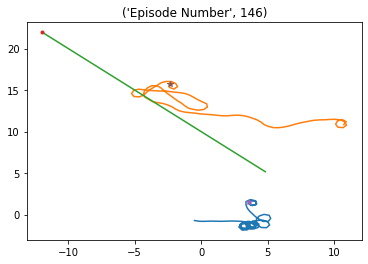

Episode * 147 * Avg Reward is ==> 2287.2533955198764 : Ag1 Reward ==> 1157.0295041711295 : Ag2 Reward ==> 1166.4353316404365 


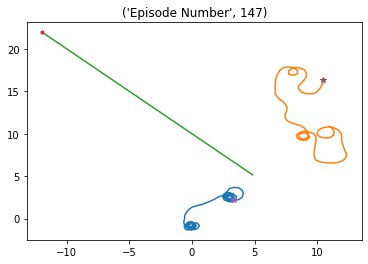

Episode * 148 * Avg Reward is ==> 2275.4498177759137 : Ag1 Reward ==> 1021.2176895466222 : Ag2 Reward ==> 808.1342283668037 


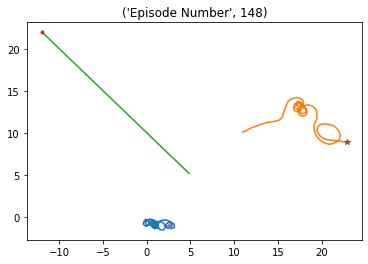

Episode * 149 * Avg Reward is ==> 2269.0084413347968 : Ag1 Reward ==> 981.7092283619398 : Ag2 Reward ==> 878.7583693435607 


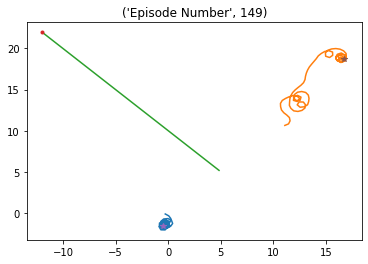

Episode * 150 * Avg Reward is ==> 2268.1931600971498 : Ag1 Reward ==> 1162.3150680874217 : Ag2 Reward ==> 1099.0934242188357 


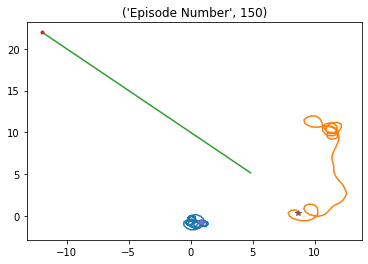

Episode * 151 * Avg Reward is ==> 2269.753037583128 : Ag1 Reward ==> 1126.2027126899113 : Ag2 Reward ==> 1068.2821216174343 


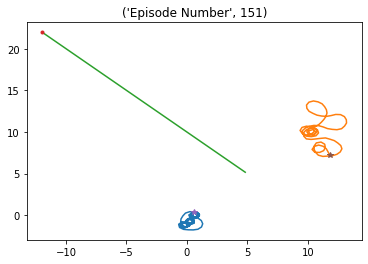

Episode * 152 * Avg Reward is ==> 2280.0217336349124 : Ag1 Reward ==> 1250.20691047402 : Ag2 Reward ==> 1241.812414238879 


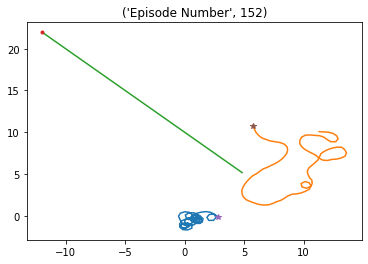

Episode * 153 * Avg Reward is ==> 2293.780421831331 : Ag1 Reward ==> 1207.2609317203728 : Ag2 Reward ==> 1343.77563929516 


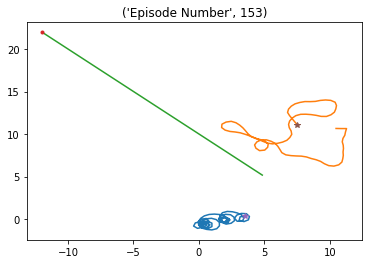

Episode * 154 * Avg Reward is ==> 2298.633224158208 : Ag1 Reward ==> 1149.3626646672421 : Ag2 Reward ==> 1116.0209325700891 


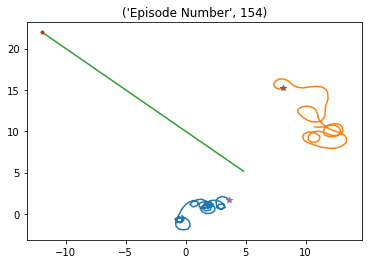

Episode * 155 * Avg Reward is ==> 2293.4945805156517 : Ag1 Reward ==> 1036.4208587119383 : Ag2 Reward ==> 1005.9326637010398 


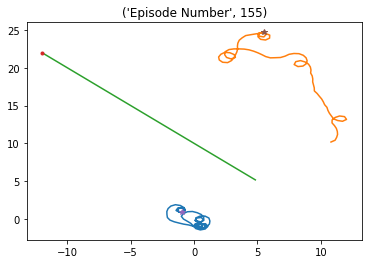

Episode * 156 * Avg Reward is ==> 2286.482084792312 : Ag1 Reward ==> 1039.910564571472 : Ag2 Reward ==> 1104.595796457296 


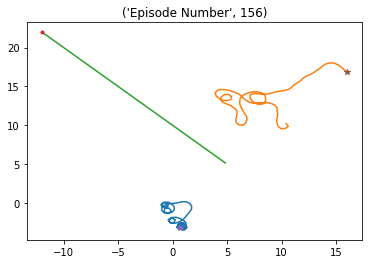

Episode * 157 * Avg Reward is ==> 2289.8482108587755 : Ag1 Reward ==> 1226.541024436254 : Ag2 Reward ==> 1460.5935169434283 


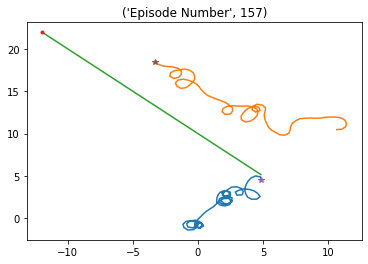

Episode * 158 * Avg Reward is ==> 2283.822023759146 : Ag1 Reward ==> 1126.0230852784132 : Ag2 Reward ==> 1108.4739781592455 


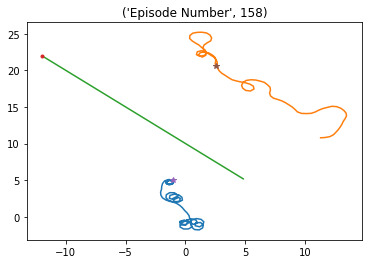

Episode * 159 * Avg Reward is ==> 2269.2638172362595 : Ag1 Reward ==> 1126.231077766129 : Ag2 Reward ==> 1016.5540290329609 


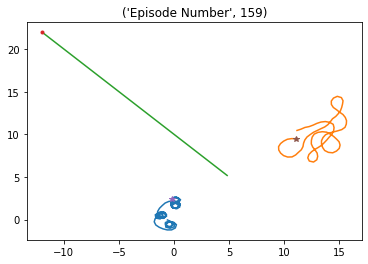

Episode * 160 * Avg Reward is ==> 2253.8715119232966 : Ag1 Reward ==> 1029.9592239023766 : Ag2 Reward ==> 868.3543126775502 


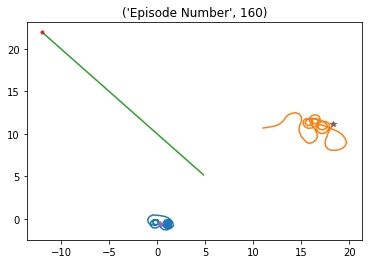

Episode * 161 * Avg Reward is ==> 2242.523047745083 : Ag1 Reward ==> 1096.7687589596042 : Ag2 Reward ==> 934.6122925330275 


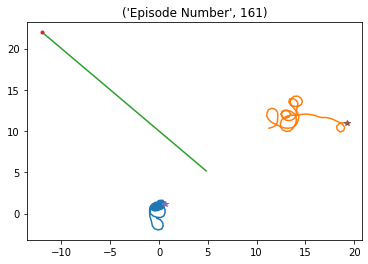

Episode * 162 * Avg Reward is ==> 2228.162954054672 : Ag1 Reward ==> 1060.724355528729 : Ag2 Reward ==> 1002.5759064849897 


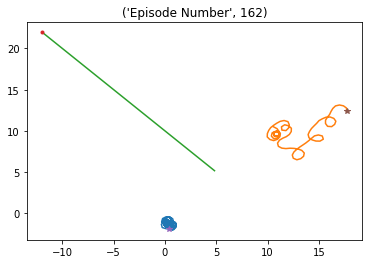

Episode * 163 * Avg Reward is ==> 2218.716828266232 : Ag1 Reward ==> 1231.1053575109759 : Ag2 Reward ==> 1152.2279571368915 


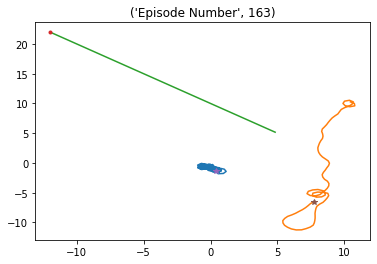

Episode * 164 * Avg Reward is ==> 2205.5660475818163 : Ag1 Reward ==> 993.132642360835 : Ag2 Reward ==> 799.4953846724152 


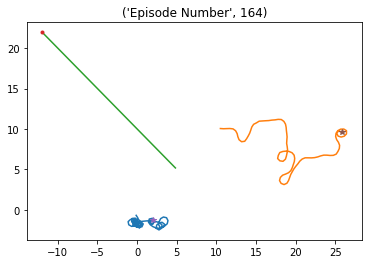

Episode * 165 * Avg Reward is ==> 2203.9858777484005 : Ag1 Reward ==> 1170.1324026332286 : Ag2 Reward ==> 1174.7704431700313 


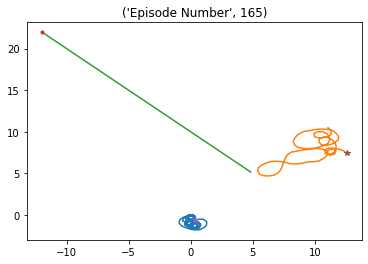

Episode * 166 * Avg Reward is ==> 2202.2811120284414 : Ag1 Reward ==> 1078.5541433531032 : Ag2 Reward ==> 1028.1251693728955 


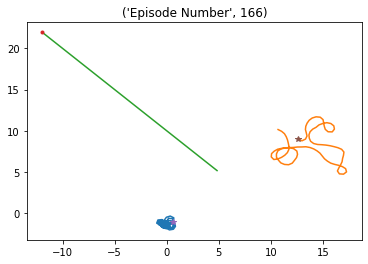

Episode * 167 * Avg Reward is ==> 2184.8829780166584 : Ag1 Reward ==> 1093.3686982641268 : Ag2 Reward ==> 1019.152924121497 


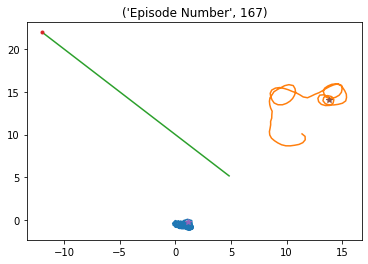

Episode * 168 * Avg Reward is ==> 2179.1093830789346 : Ag1 Reward ==> 1035.4741042641847 : Ag2 Reward ==> 912.3347885544949 


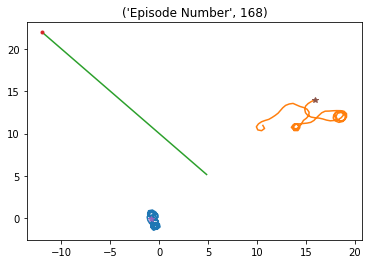

Episode * 169 * Avg Reward is ==> 2173.426108861676 : Ag1 Reward ==> 1050.6447444674998 : Ag2 Reward ==> 906.0966635135071 


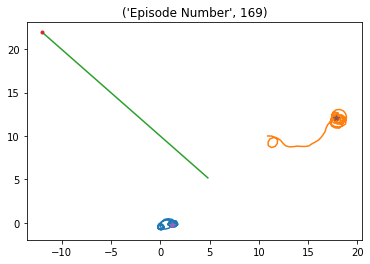

Episode * 170 * Avg Reward is ==> 2162.260284532752 : Ag1 Reward ==> 1164.8826690015214 : Ag2 Reward ==> 1102.4659875497816 


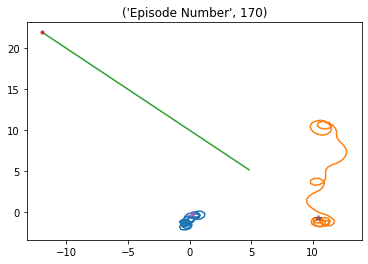

Episode * 171 * Avg Reward is ==> 2167.9807880380285 : Ag1 Reward ==> 1113.227926884677 : Ag2 Reward ==> 1000.735528789448 


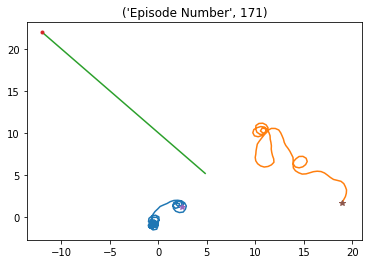

Episode * 172 * Avg Reward is ==> 2162.6725917258177 : Ag1 Reward ==> 1061.2997398831267 : Ag2 Reward ==> 1017.1745032901509 


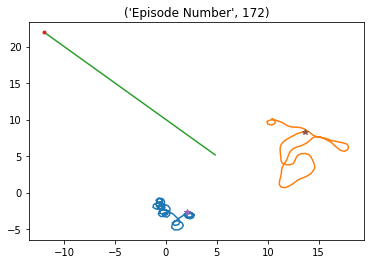

Episode * 173 * Avg Reward is ==> 2176.22154298083 : Ag1 Reward ==> 1372.446016363848 : Ag2 Reward ==> 1289.2105844581667 


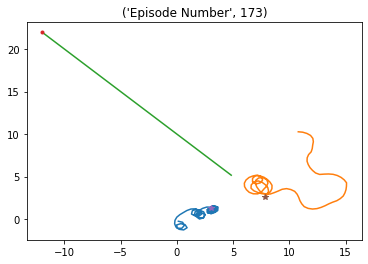

Episode * 174 * Avg Reward is ==> 2183.9995733176393 : Ag1 Reward ==> 1117.2644128363822 : Ag2 Reward ==> 1023.9920624563154 


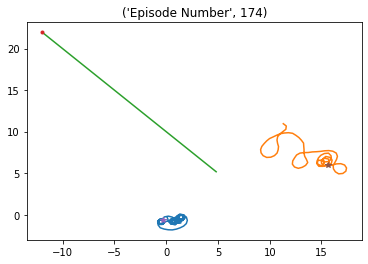

Episode * 175 * Avg Reward is ==> 2186.5857809999857 : Ag1 Reward ==> 1067.9302472545148 : Ag2 Reward ==> 1026.7250278556041 


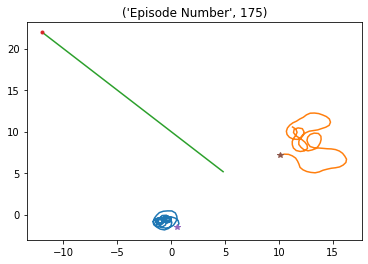

Episode * 176 * Avg Reward is ==> 2187.984093065936 : Ag1 Reward ==> 1087.5096494661818 : Ag2 Reward ==> 1031.2765376191835 


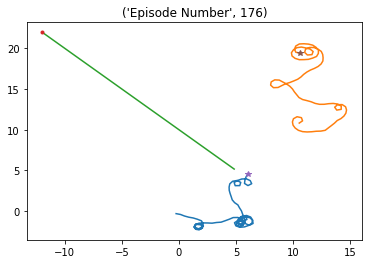

Episode * 177 * Avg Reward is ==> 2199.723937548709 : Ag1 Reward ==> 1454.8676986461858 : Ag2 Reward ==> 1471.661367011418 


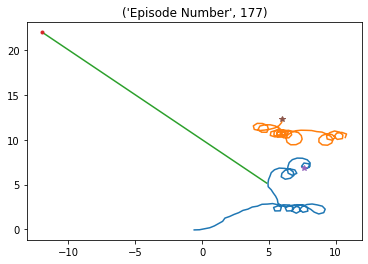

Episode * 178 * Avg Reward is ==> 2214.569946216722 : Ag1 Reward ==> 1178.936694103697 : Ag2 Reward ==> 1312.1625064718812 


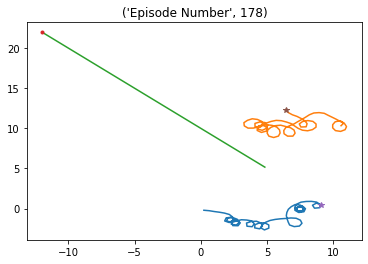

Episode * 179 * Avg Reward is ==> 2231.352364180041 : Ag1 Reward ==> 1252.0819935904349 : Ag2 Reward ==> 1464.66749452741 


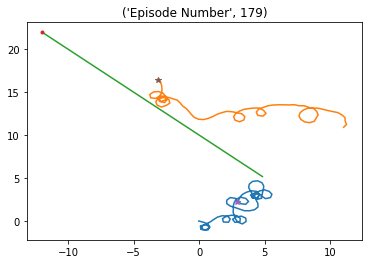

Episode * 180 * Avg Reward is ==> 2229.249087727222 : Ag1 Reward ==> 1191.1695702590807 : Ag2 Reward ==> 1235.2110877739003 


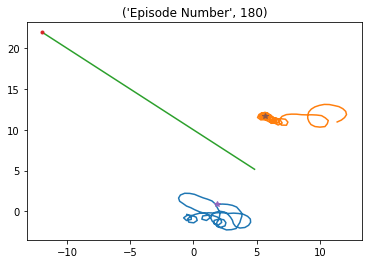

Episode * 181 * Avg Reward is ==> 2240.5175499566503 : Ag1 Reward ==> 1419.9803304264383 : Ag2 Reward ==> 1276.8718664959736 


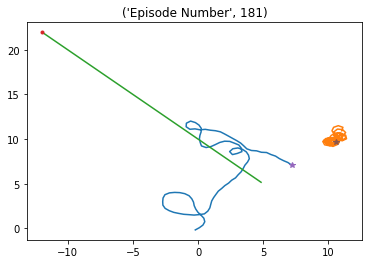

Episode * 182 * Avg Reward is ==> 2249.4206043432773 : Ag1 Reward ==> 1411.3849689032681 : Ag2 Reward ==> 1216.8647204369945 


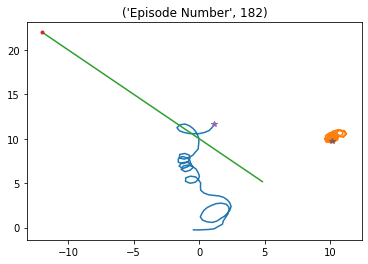

Episode * 183 * Avg Reward is ==> 2267.648072035322 : Ag1 Reward ==> 1416.4859934746753 : Ag2 Reward ==> 1397.2124784059988 


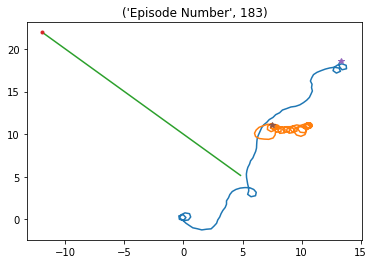

Episode * 184 * Avg Reward is ==> 2268.802336269246 : Ag1 Reward ==> 1122.329430456934 : Ag2 Reward ==> 1185.690783148141 


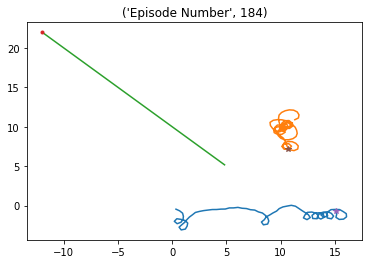

Episode * 185 * Avg Reward is ==> 2285.992145847021 : Ag1 Reward ==> 1385.8344152084233 : Ag2 Reward ==> 1260.4037301222786 


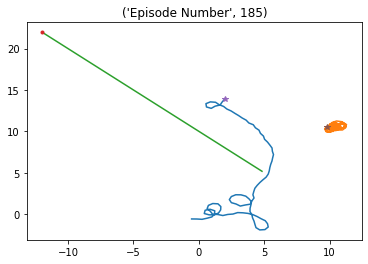

Episode * 186 * Avg Reward is ==> 2292.4722226731874 : Ag1 Reward ==> 1478.6047932774327 : Ag2 Reward ==> 1423.822050928017 


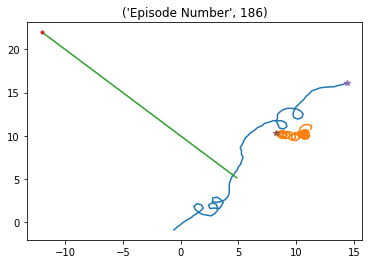

Episode * 187 * Avg Reward is ==> 2295.260091997149 : Ag1 Reward ==> 1205.4614830026699 : Ag2 Reward ==> 1229.518125767369 


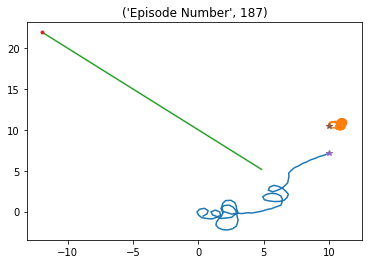

Episode * 188 * Avg Reward is ==> 2314.2449290461605 : Ag1 Reward ==> 1301.3265236279258 : Ag2 Reward ==> 1287.4188762459532 


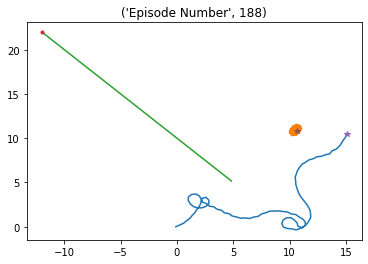

Episode * 189 * Avg Reward is ==> 2336.3405169260436 : Ag1 Reward ==> 1386.5157855138689 : Ag2 Reward ==> 1357.7753273869648 


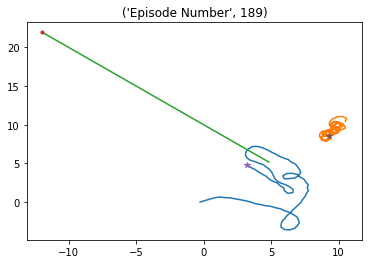

Episode * 190 * Avg Reward is ==> 2337.191267343901 : Ag1 Reward ==> 1196.1201138490674 : Ag2 Reward ==> 1099.3183951714825 


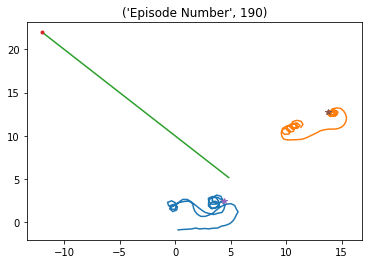

Episode * 191 * Avg Reward is ==> 2337.0200686070993 : Ag1 Reward ==> 1093.8717313234868 : Ag2 Reward ==> 1093.7651535117802 


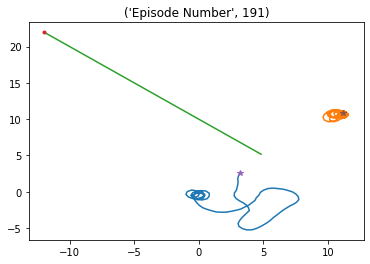

Episode * 192 * Avg Reward is ==> 2340.1580718794066 : Ag1 Reward ==> 1279.3286114363948 : Ag2 Reward ==> 1338.2108441687983 


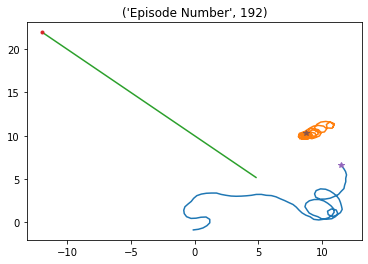

Episode * 193 * Avg Reward is ==> 2334.097899845698 : Ag1 Reward ==> 1087.3721543260199 : Ag2 Reward ==> 1221.2575353411817 


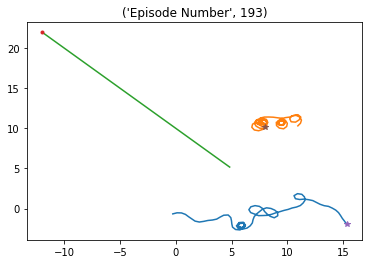

Episode * 194 * Avg Reward is ==> 2337.3200696828108 : Ag1 Reward ==> 1243.8553081942264 : Ag2 Reward ==> 1150.4150825275988 


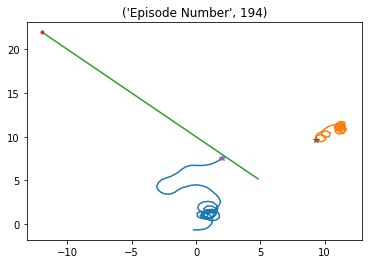

Episode * 195 * Avg Reward is ==> 2342.0660305684573 : Ag1 Reward ==> 1100.884730323597 : Ag2 Reward ==> 1131.307227515248 


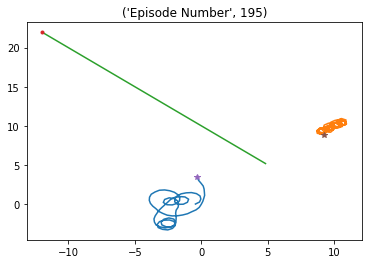

Episode * 196 * Avg Reward is ==> 2350.2463937820517 : Ag1 Reward ==> 1227.1572518727814 : Ag2 Reward ==> 1244.563637699768 


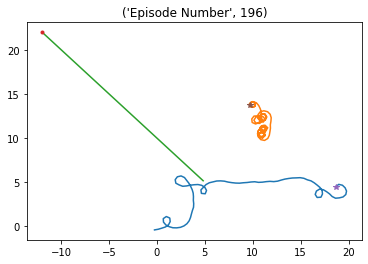

Episode * 197 * Avg Reward is ==> 2339.0162870779177 : Ag1 Reward ==> 1108.459578956918 : Ag2 Reward ==> 1129.4706942574069 


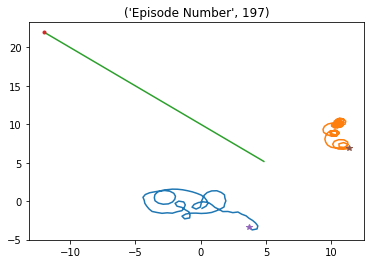

Episode * 198 * Avg Reward is ==> 2337.8054789461953 : Ag1 Reward ==> 919.6384177828094 : Ag2 Reward ==> 1266.4263203859425 


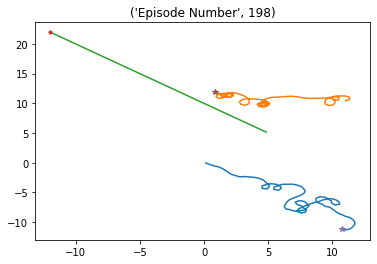

Episode * 199 * Avg Reward is ==> 2340.842181182023 : Ag1 Reward ==> 1169.4862984582917 : Ag2 Reward ==> 1094.7668977739065 


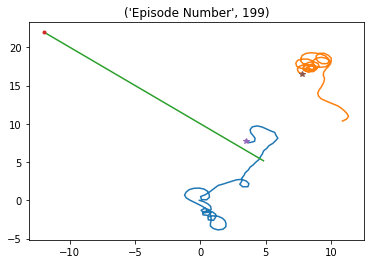

Episode * 200 * Avg Reward is ==> 2358.4989444420085 : Ag1 Reward ==> 1249.998193565953 : Ag2 Reward ==> 1354.5858734133944 


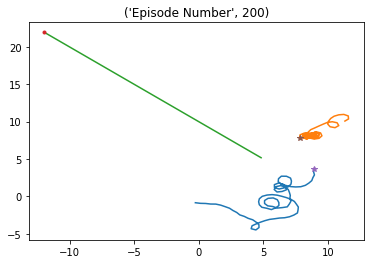

Episode * 201 * Avg Reward is ==> 2365.3540580499402 : Ag1 Reward ==> 1134.2640609068958 : Ag2 Reward ==> 1171.3215349030002 


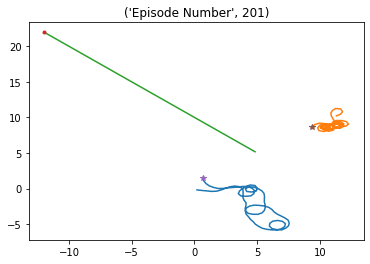

Episode * 202 * Avg Reward is ==> 2372.5382771117474 : Ag1 Reward ==> 1205.5251443650327 : Ag2 Reward ==> 1145.1438801209802 


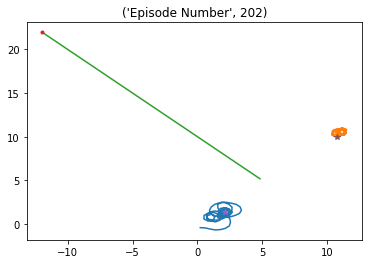

Episode * 203 * Avg Reward is ==> 2366.990475112502 : Ag1 Reward ==> 1004.020277637592 : Ag2 Reward ==> 1157.4009570404476 


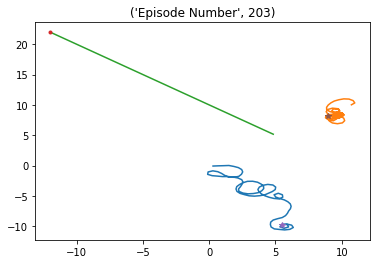

Episode * 204 * Avg Reward is ==> 2380.462841679888 : Ag1 Reward ==> 1181.5549449115224 : Ag2 Reward ==> 1149.9677448171824 


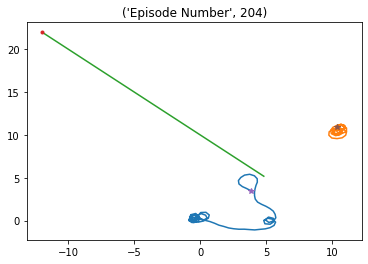

Episode * 205 * Avg Reward is ==> 2383.4552435935207 : Ag1 Reward ==> 1320.0002464411039 : Ag2 Reward ==> 1144.598675907457 


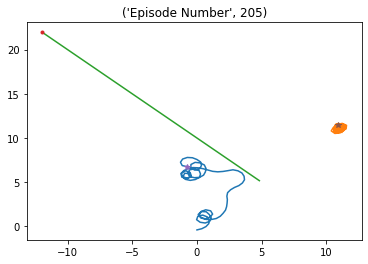

Episode * 206 * Avg Reward is ==> 2388.395411791613 : Ag1 Reward ==> 1102.8814769967548 : Ag2 Reward ==> 1201.4045636529452 


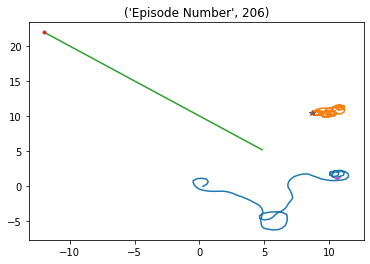

Episode * 207 * Avg Reward is ==> 2396.9778842620367 : Ag1 Reward ==> 1259.8581025434808 : Ag2 Reward ==> 1195.9624186590877 


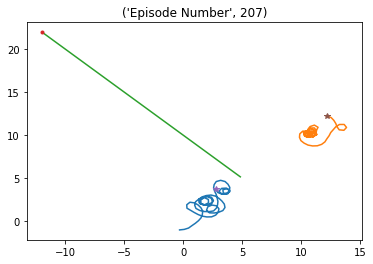

Episode * 208 * Avg Reward is ==> 2411.79362560862 : Ag1 Reward ==> 1294.589474811216 : Ag2 Reward ==> 1245.8490718708051 


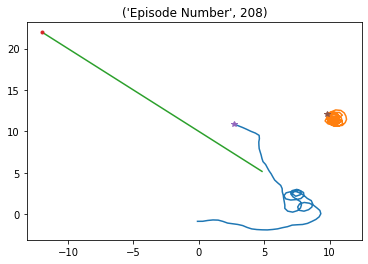

Episode * 209 * Avg Reward is ==> 2430.747517430499 : Ag1 Reward ==> 1450.9357629849285 : Ag2 Reward ==> 1263.961317871254 


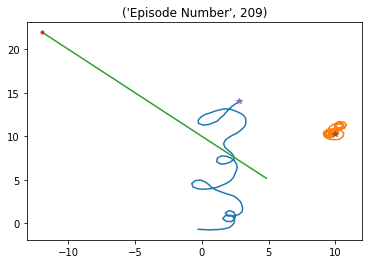

Episode * 210 * Avg Reward is ==> 2435.237495601768 : Ag1 Reward ==> 1182.8739244706783 : Ag2 Reward ==> 1264.0738589313682 


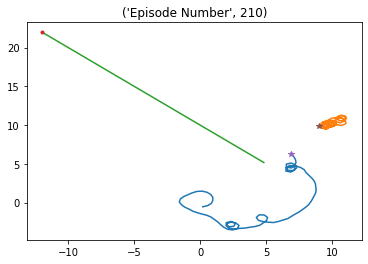

Episode * 211 * Avg Reward is ==> 2435.9469209140343 : Ag1 Reward ==> 1104.5769072254743 : Ag2 Reward ==> 1037.7635609392955 


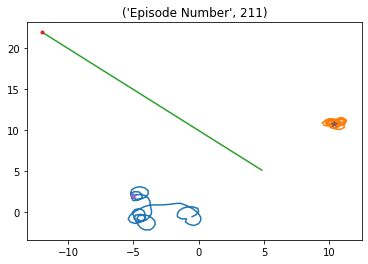

Episode * 212 * Avg Reward is ==> 2436.8729614422928 : Ag1 Reward ==> 1076.1780894561007 : Ag2 Reward ==> 1039.337774847504 


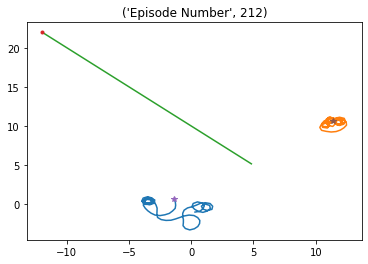

Episode * 213 * Avg Reward is ==> 2434.226150469367 : Ag1 Reward ==> 1321.5760053040194 : Ag2 Reward ==> 1234.20815660099 


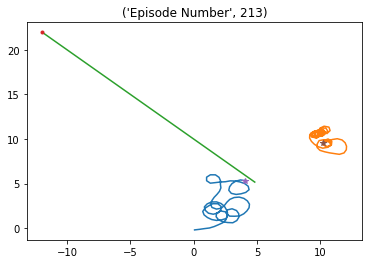

Episode * 214 * Avg Reward is ==> 2448.821403679869 : Ag1 Reward ==> 1366.8983628753112 : Ag2 Reward ==> 1358.168240837456 


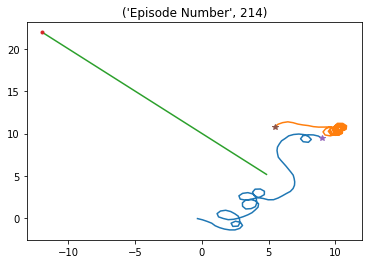

Episode * 215 * Avg Reward is ==> 2452.9998545172207 : Ag1 Reward ==> 1055.5325913489137 : Ag2 Reward ==> 1206.2607172552703 


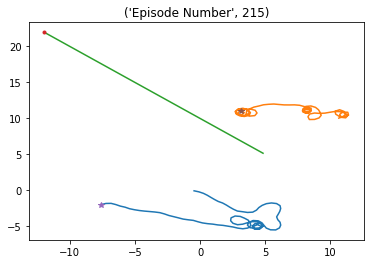

Episode * 216 * Avg Reward is ==> 2457.4301729624704 : Ag1 Reward ==> 1184.798128072656 : Ag2 Reward ==> 1111.2007968227115 


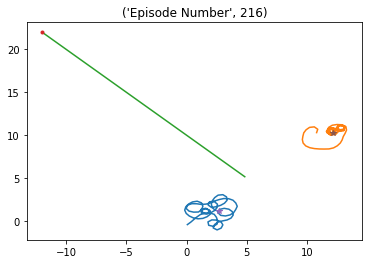

Episode * 217 * Avg Reward is ==> 2442.8613927129763 : Ag1 Reward ==> 1212.5680115319994 : Ag2 Reward ==> 1131.209844145837 


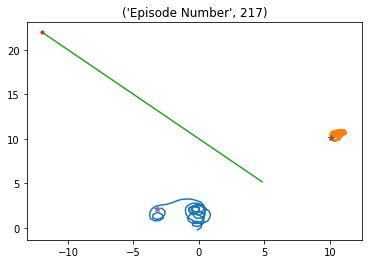

Episode * 218 * Avg Reward is ==> 2435.5168942596374 : Ag1 Reward ==> 1112.1968223491322 : Ag2 Reward ==> 1085.1224400928895 


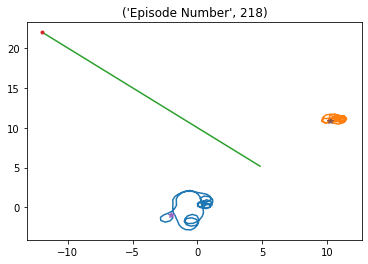

Episode * 219 * Avg Reward is ==> 2425.635874931419 : Ag1 Reward ==> 1149.0468775955267 : Ag2 Reward ==> 1172.4618373935882 


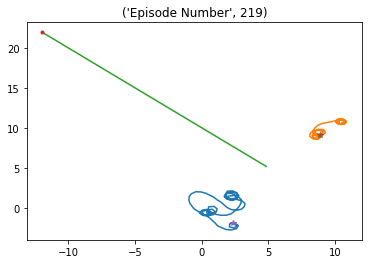

Episode * 220 * Avg Reward is ==> 2423.990769997611 : Ag1 Reward ==> 1177.1070063131729 : Ag2 Reward ==> 1183.46945436748 


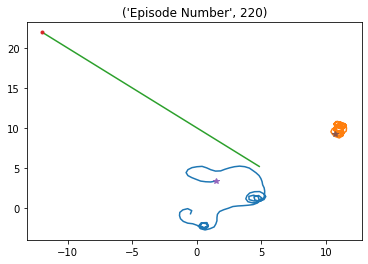

Episode * 221 * Avg Reward is ==> 2412.5558463896155 : Ag1 Reward ==> 1123.7679440438376 : Ag2 Reward ==> 1115.6873085587654 


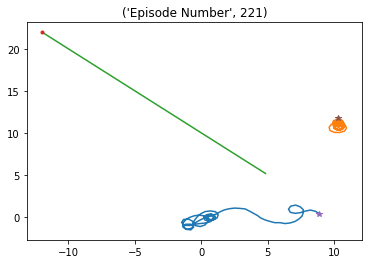

Episode * 222 * Avg Reward is ==> 2405.545259608293 : Ag1 Reward ==> 1166.2623525440324 : Ag2 Reward ==> 1181.5638655433097 


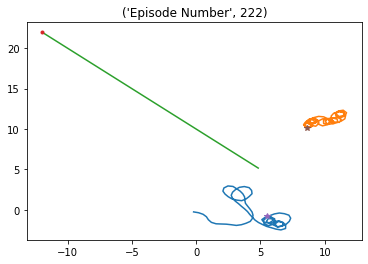

Episode * 223 * Avg Reward is ==> 2393.4759495487706 : Ag1 Reward ==> 1178.1409693547268 : Ag2 Reward ==> 1152.7851001450565 


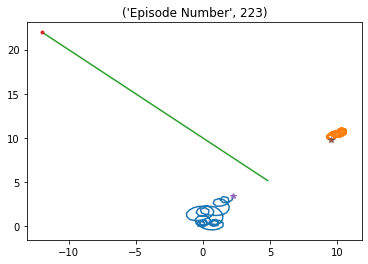

Episode * 224 * Avg Reward is ==> 2399.1606316924617 : Ag1 Reward ==> 1249.7457139092544 : Ag2 Reward ==> 1285.6617854434605 


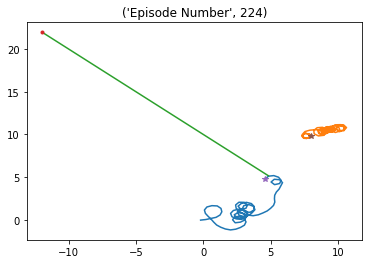

Episode * 225 * Avg Reward is ==> 2395.301616084067 : Ag1 Reward ==> 1241.4870070014 : Ag2 Reward ==> 1250.3905139935357 


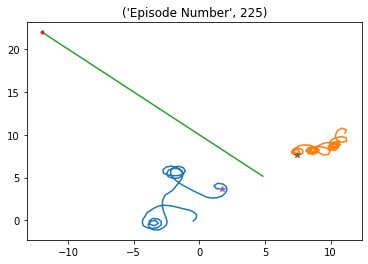

Episode * 226 * Avg Reward is ==> 2377.0673060676736 : Ag1 Reward ==> 1063.7573474468973 : Ag2 Reward ==> 1109.2970961028159 


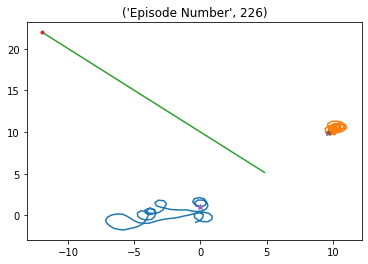

Episode * 227 * Avg Reward is ==> 2376.2485742299004 : Ag1 Reward ==> 1130.128004436224 : Ag2 Reward ==> 1272.1023308228885 


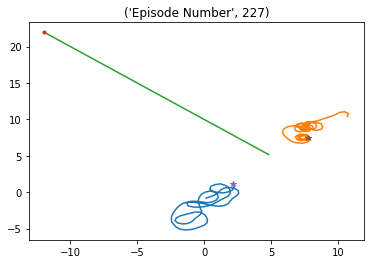

Episode * 228 * Avg Reward is ==> 2365.1721959563088 : Ag1 Reward ==> 1051.7654279262003 : Ag2 Reward ==> 1093.9248410040066 


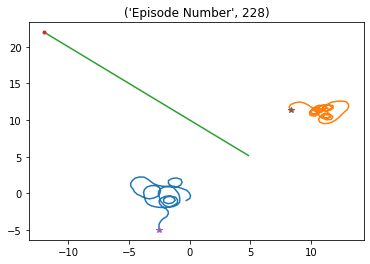

Episode * 229 * Avg Reward is ==> 2349.738561414786 : Ag1 Reward ==> 1026.3195782503844 : Ag2 Reward ==> 1100.6261529895312 


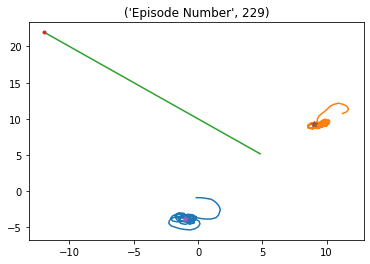

Episode * 230 * Avg Reward is ==> 2352.7822501959085 : Ag1 Reward ==> 1232.926933784456 : Ag2 Reward ==> 1184.2591264810003 


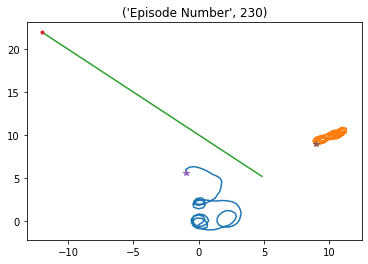

Episode * 231 * Avg Reward is ==> 2351.5469301159906 : Ag1 Reward ==> 1020.8746174148716 : Ag2 Reward ==> 1117.3494642236788 


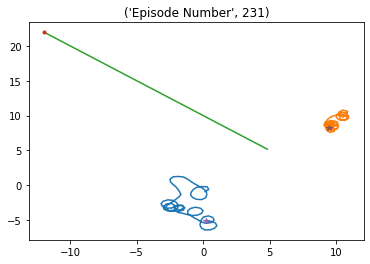

Episode * 232 * Avg Reward is ==> 2354.968792780004 : Ag1 Reward ==> 1438.9885136849864 : Ag2 Reward ==> 1315.4254484807389 


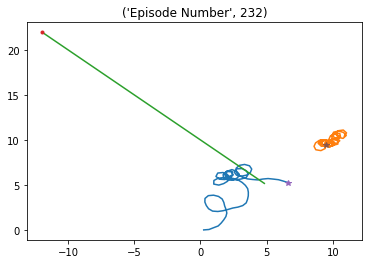

Episode * 233 * Avg Reward is ==> 2368.9950480706416 : Ag1 Reward ==> 1374.052520638875 : Ag2 Reward ==> 1495.6273806538254 


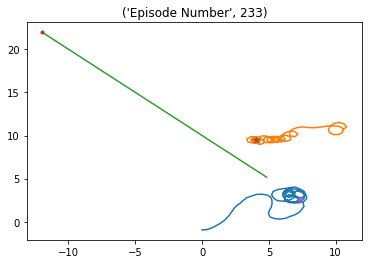

Episode * 234 * Avg Reward is ==> 2368.6807529277153 : Ag1 Reward ==> 1216.2947059250812 : Ag2 Reward ==> 1165.4038790797022 


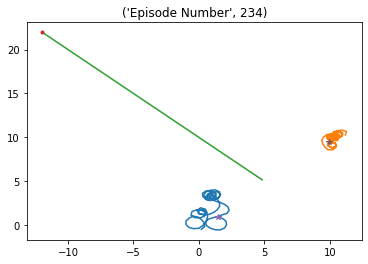

Episode * 235 * Avg Reward is ==> 2371.6374423778843 : Ag1 Reward ==> 1144.057214941709 : Ag2 Reward ==> 1206.4023209038808 


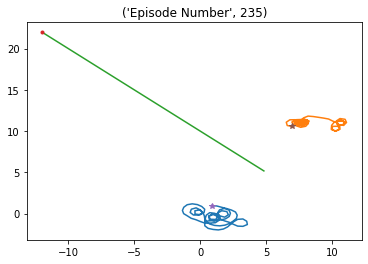

Episode * 236 * Avg Reward is ==> 2367.9077626784647 : Ag1 Reward ==> 1134.8415051025322 : Ag2 Reward ==> 1187.692196493245 


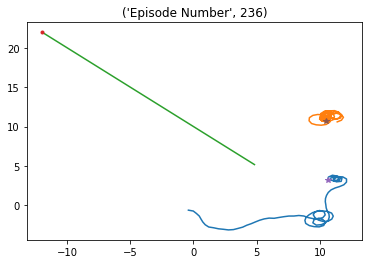

Episode * 237 * Avg Reward is ==> 2373.1720439875967 : Ag1 Reward ==> 1189.88180885636 : Ag2 Reward ==> 1258.619716723238 


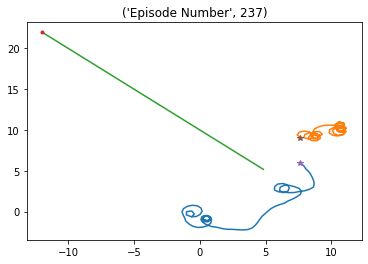

Episode * 238 * Avg Reward is ==> 2370.319294726242 : Ag1 Reward ==> 985.372842693319 : Ag2 Reward ==> 1086.5819250212367 


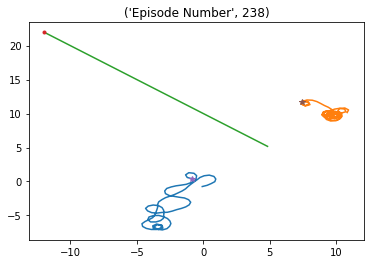

Episode * 239 * Avg Reward is ==> 2377.6535229031674 : Ag1 Reward ==> 1285.0839205698305 : Ag2 Reward ==> 1272.538402739401 


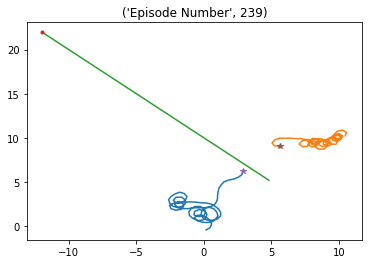

Episode * 240 * Avg Reward is ==> 2375.8187465789197 : Ag1 Reward ==> 1264.391820730404 : Ag2 Reward ==> 1266.8011932790314 


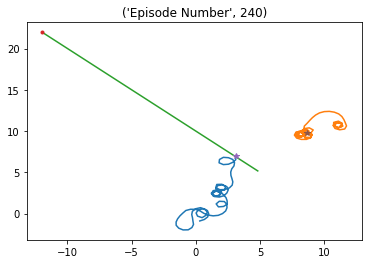

Episode * 241 * Avg Reward is ==> 2373.157578508941 : Ag1 Reward ==> 1050.006667713928 : Ag2 Reward ==> 1149.1322052968042 


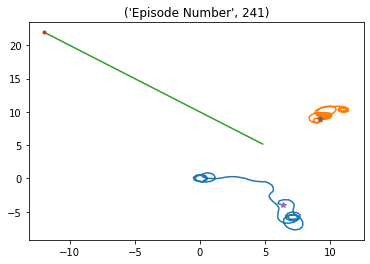

Episode * 242 * Avg Reward is ==> 2379.299904351211 : Ag1 Reward ==> 1213.1803996077617 : Ag2 Reward ==> 1383.1816585690744 


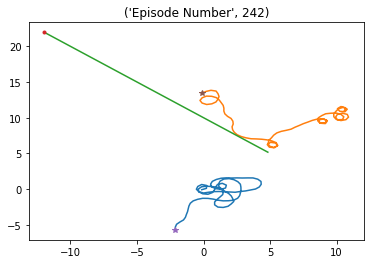

Episode * 243 * Avg Reward is ==> 2374.584452004376 : Ag1 Reward ==> 894.5419492596135 : Ag2 Reward ==> 1078.2611915450182 


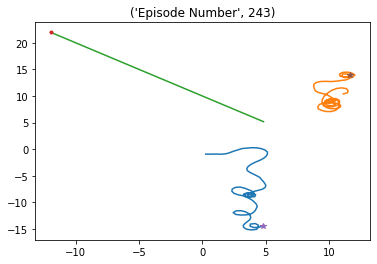

Episode * 244 * Avg Reward is ==> 2373.233805723909 : Ag1 Reward ==> 1211.8473907417267 : Ag2 Reward ==> 1065.6494477682988 


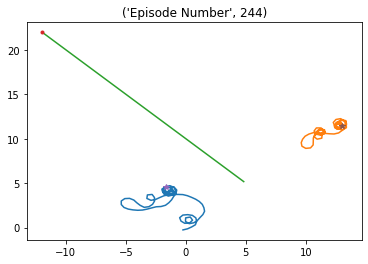

Episode * 245 * Avg Reward is ==> 2373.432626575113 : Ag1 Reward ==> 1238.3662066740658 : Ag2 Reward ==> 1234.1855497226436 


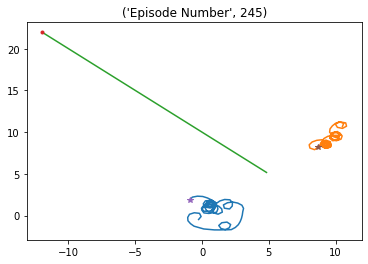

Episode * 246 * Avg Reward is ==> 2375.038882576613 : Ag1 Reward ==> 1216.452008903078 : Ag2 Reward ==> 1152.0842718066367 


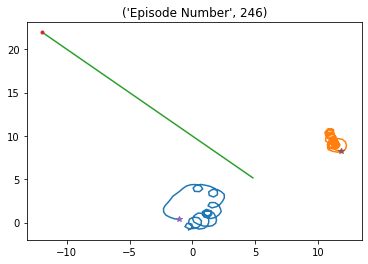

Episode * 247 * Avg Reward is ==> 2372.5142238849376 : Ag1 Reward ==> 1148.3346311503853 : Ag2 Reward ==> 1206.4995423851517 


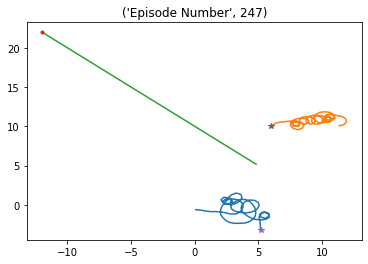

Episode * 248 * Avg Reward is ==> 2366.0737066550114 : Ag1 Reward ==> 1131.401430231001 : Ag2 Reward ==> 1151.4164272539917 


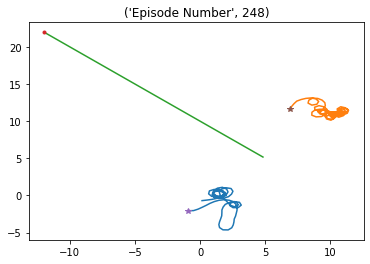

Episode * 249 * Avg Reward is ==> 2353.4744690571997 : Ag1 Reward ==> 966.3328270311409 : Ag2 Reward ==> 1244.5947499125618 


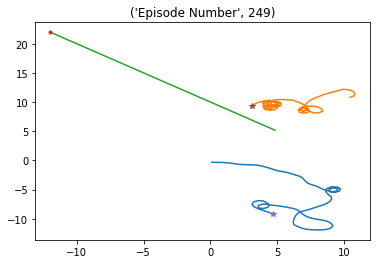

Episode * 250 * Avg Reward is ==> 2349.488188429761 : Ag1 Reward ==> 961.0777775601554 : Ag2 Reward ==> 1326.4187807443552 


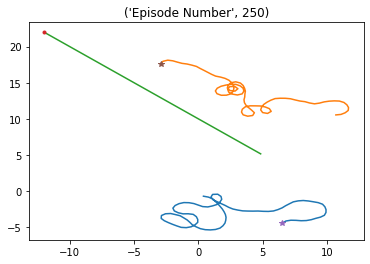

Episode * 251 * Avg Reward is ==> 2363.7884702938272 : Ag1 Reward ==> 1355.4989418808543 : Ag2 Reward ==> 1358.8528008465591 


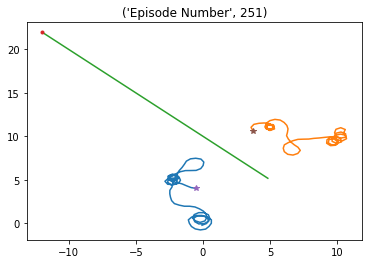

Episode * 252 * Avg Reward is ==> 2376.310578296356 : Ag1 Reward ==> 1336.2810870889477 : Ag2 Reward ==> 1280.1190973157973 


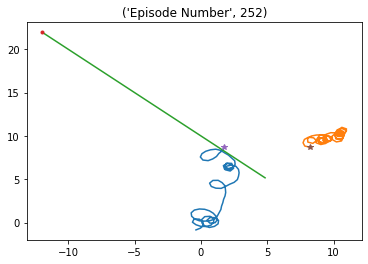

Episode * 253 * Avg Reward is ==> 2378.33300451233 : Ag1 Reward ==> 1332.2572263932627 : Ag2 Reward ==> 1304.4239841507022 


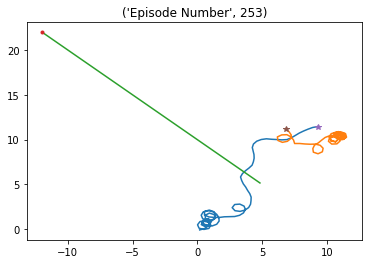

Episode * 254 * Avg Reward is ==> 2372.8724891744923 : Ag1 Reward ==> 1279.912777835802 : Ag2 Reward ==> 1226.733212363476 


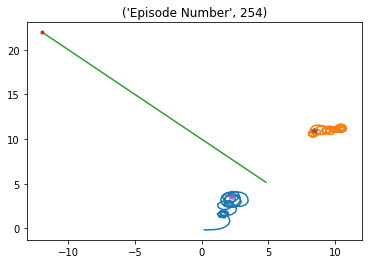

Episode * 255 * Avg Reward is ==> 2368.9975570482934 : Ag1 Reward ==> 990.4380035849022 : Ag2 Reward ==> 1116.3580199713101 


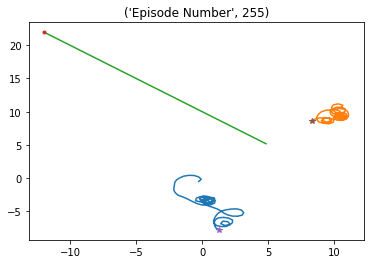

Episode * 256 * Avg Reward is ==> 2389.826607907077 : Ag1 Reward ==> 1554.5271934084299 : Ag2 Reward ==> 1574.633765838263 


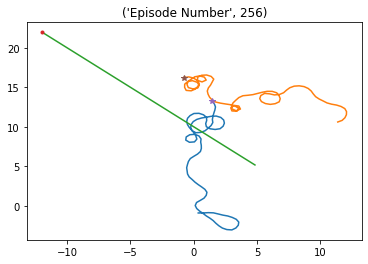

Episode * 257 * Avg Reward is ==> 2403.528699484981 : Ag1 Reward ==> 1497.9010202411837 : Ag2 Reward ==> 1393.960498552841 


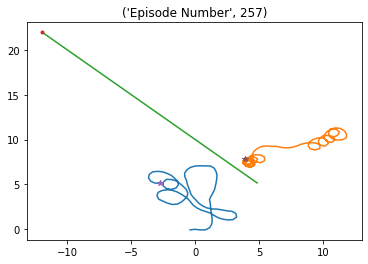

Episode * 258 * Avg Reward is ==> 2405.370312085839 : Ag1 Reward ==> 1105.9867470678803 : Ag2 Reward ==> 1164.997019408456 


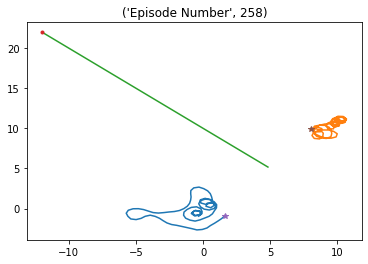

Episode * 259 * Avg Reward is ==> 2431.084050711133 : Ag1 Reward ==> 1672.195741675599 : Ag2 Reward ==> 1677.8625183252789 


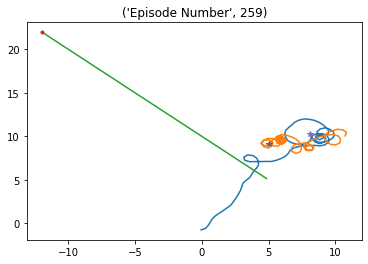

Episode * 260 * Avg Reward is ==> 2434.53855650073 : Ag1 Reward ==> 1179.4070304471759 : Ag2 Reward ==> 1319.3496618173535 


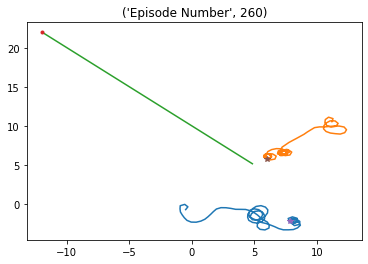

Episode * 261 * Avg Reward is ==> 2442.0191470840614 : Ag1 Reward ==> 1341.0869291522738 : Ag2 Reward ==> 1197.591946783599 


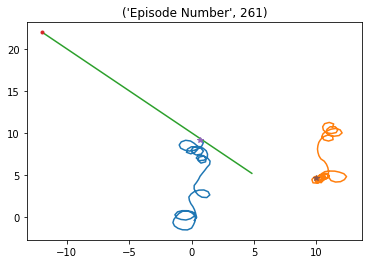

Episode * 262 * Avg Reward is ==> 2450.980736737959 : Ag1 Reward ==> 1440.293625627622 : Ag2 Reward ==> 1265.9961786156157 


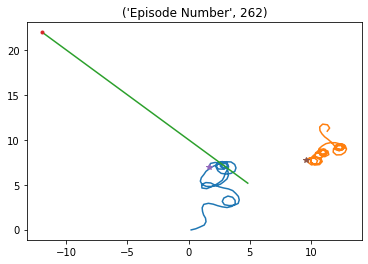

Episode * 263 * Avg Reward is ==> 2467.5982413440292 : Ag1 Reward ==> 1535.4822673584235 : Ag2 Reward ==> 1460.1439863841676 


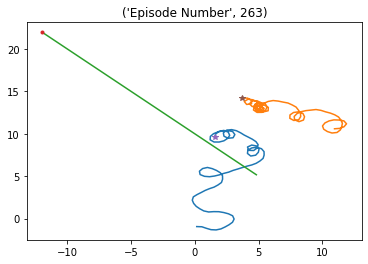

Episode * 264 * Avg Reward is ==> 2470.584056952134 : Ag1 Reward ==> 1223.3595177885281 : Ag2 Reward ==> 1431.4806058883587 


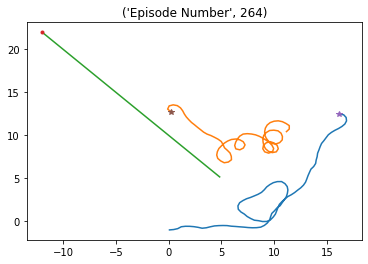

Episode * 265 * Avg Reward is ==> 2463.078955369573 : Ag1 Reward ==> 1011.4000079520885 : Ag2 Reward ==> 1180.2734497404206 


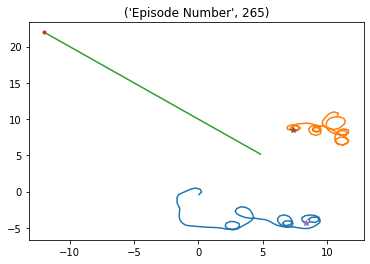

Episode * 266 * Avg Reward is ==> 2462.8432132807957 : Ag1 Reward ==> 1023.6236195563299 : Ag2 Reward ==> 1140.0011404422921 


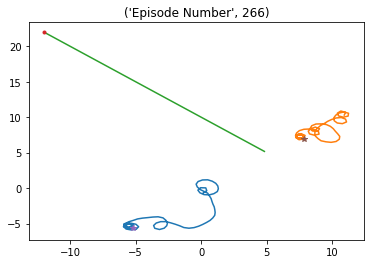

Episode * 267 * Avg Reward is ==> 2464.869024124501 : Ag1 Reward ==> 1240.7831941759202 : Ag2 Reward ==> 1242.4795748313918 


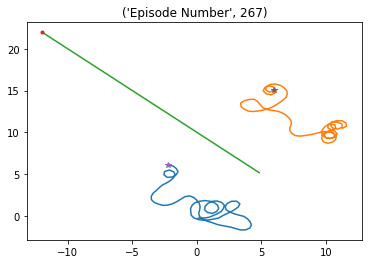

Episode * 268 * Avg Reward is ==> 2476.3915511535315 : Ag1 Reward ==> 1285.6471234705189 : Ag2 Reward ==> 1320.944226620917 


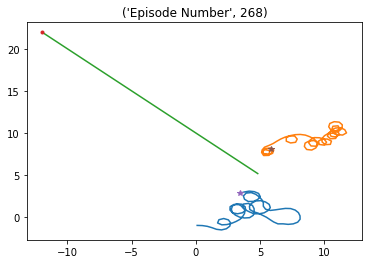

Episode * 269 * Avg Reward is ==> 2494.0343315024033 : Ag1 Reward ==> 1434.5573330042707 : Ag2 Reward ==> 1398.0996121905182 


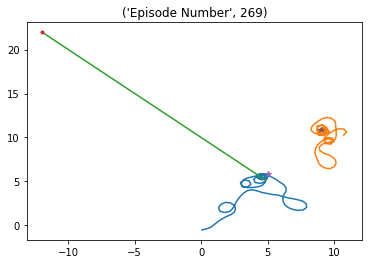

Episode * 270 * Avg Reward is ==> 2497.642784913979 : Ag1 Reward ==> 1227.5629853436371 : Ag2 Reward ==> 1333.9612113848434 


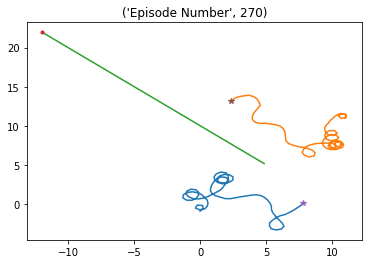

Episode * 271 * Avg Reward is ==> 2508.2955462217346 : Ag1 Reward ==> 1215.757223269292 : Ag2 Reward ==> 1348.5773106794759 


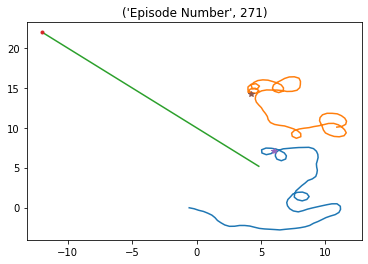

Episode * 272 * Avg Reward is ==> 2501.0370819001214 : Ag1 Reward ==> 1157.901825089081 : Ag2 Reward ==> 1306.1735642121412 


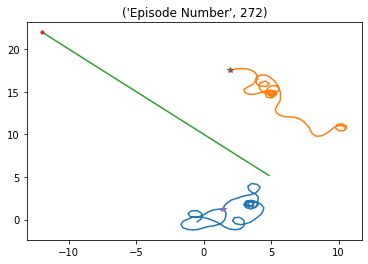

Episode * 273 * Avg Reward is ==> 2485.80367630829 : Ag1 Reward ==> 1141.5068091259873 : Ag2 Reward ==> 1118.8368684934394 


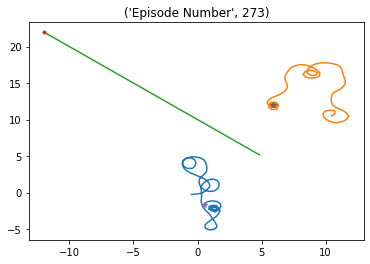

Episode * 274 * Avg Reward is ==> 2482.024651772276 : Ag1 Reward ==> 1132.9539990687108 : Ag2 Reward ==> 1097.58360449552 


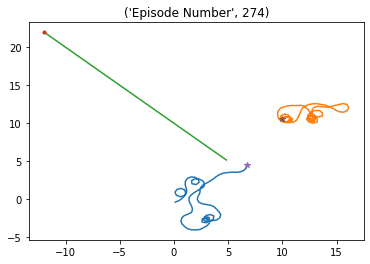

Episode * 275 * Avg Reward is ==> 2496.8067387029055 : Ag1 Reward ==> 1520.7388821577085 : Ag2 Reward ==> 1421.0041309130545 


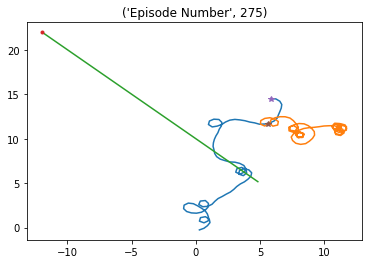

Episode * 276 * Avg Reward is ==> 2514.6667974670863 : Ag1 Reward ==> 1498.2994192008443 : Ag2 Reward ==> 1538.636632962174 


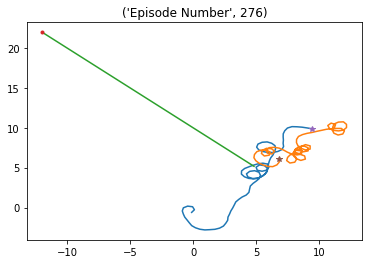

Episode * 277 * Avg Reward is ==> 2501.6492995843737 : Ag1 Reward ==> 737.667432246406 : Ag2 Reward ==> 1190.1341780246778 


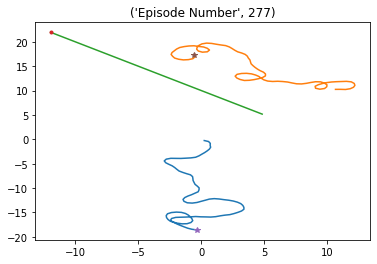

Episode * 278 * Avg Reward is ==> 2512.2472112179944 : Ag1 Reward ==> 1072.2118390340408 : Ag2 Reward ==> 1423.6593940253604 


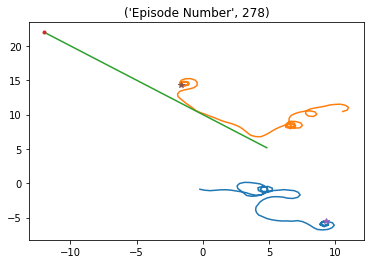

Episode * 279 * Avg Reward is ==> 2513.153478468782 : Ag1 Reward ==> 1269.1908500640516 : Ag2 Reward ==> 1324.6821632766753 


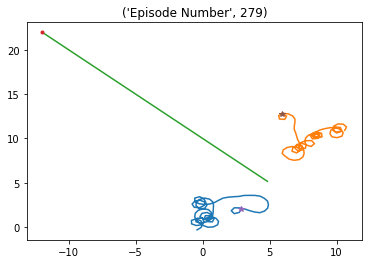

Episode * 280 * Avg Reward is ==> 2513.0168875762483 : Ag1 Reward ==> 1190.9743171673924 : Ag2 Reward ==> 1334.7550611407023 


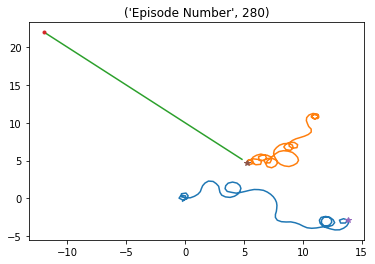

Episode * 281 * Avg Reward is ==> 2534.4694798088726 : Ag1 Reward ==> 1494.6587898136709 : Ag2 Reward ==> 1562.5837725020365 


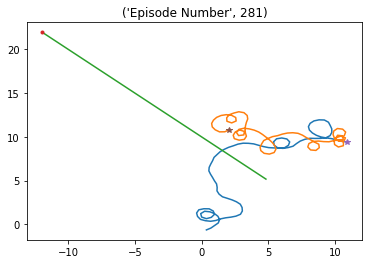

Episode * 282 * Avg Reward is ==> 2530.0980327574025 : Ag1 Reward ==> 1142.0742463637803 : Ag2 Reward ==> 1279.4299297542384 


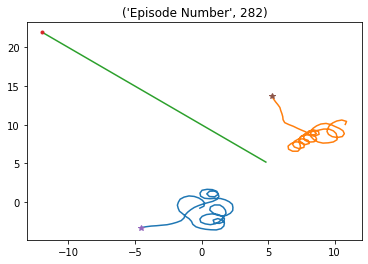

Episode * 283 * Avg Reward is ==> 2552.5319005578813 : Ag1 Reward ==> 1262.1881580580093 : Ag2 Reward ==> 1607.9696947657799 


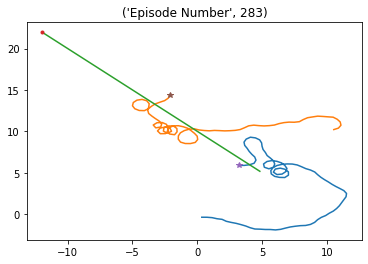

Episode * 284 * Avg Reward is ==> 2549.325064509908 : Ag1 Reward ==> 925.1736307465945 : Ag2 Reward ==> 1224.0497658444906 


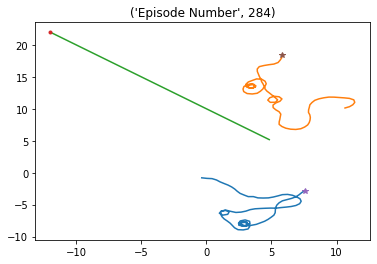

Episode * 285 * Avg Reward is ==> 2565.4531441901736 : Ag1 Reward ==> 1508.0159804756902 : Ag2 Reward ==> 1609.658963131654 


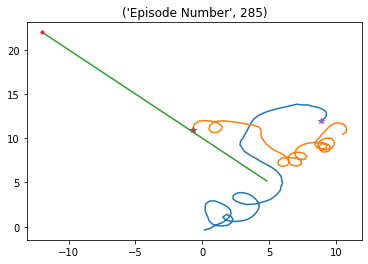

Episode * 286 * Avg Reward is ==> 2547.7472041931373 : Ag1 Reward ==> 913.0589838949412 : Ag2 Reward ==> 747.2396969333129 


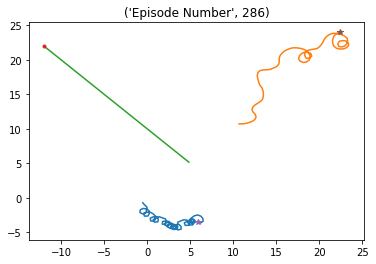

Episode * 287 * Avg Reward is ==> 2538.5373686869125 : Ag1 Reward ==> 1059.6373640647996 : Ag2 Reward ==> 926.8033892217519 


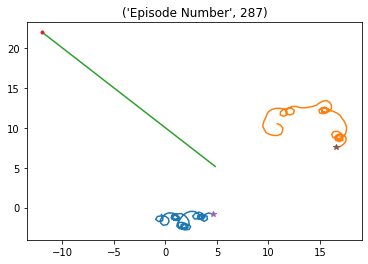

Episode * 288 * Avg Reward is ==> 2535.7901013376463 : Ag1 Reward ==> 1135.1820922598963 : Ag2 Reward ==> 1037.7450712544571 


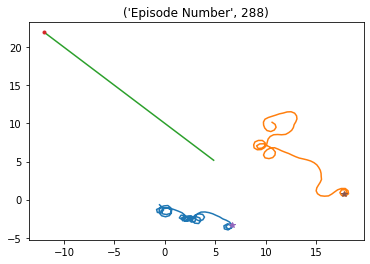

Episode * 289 * Avg Reward is ==> 2541.81573751916 : Ag1 Reward ==> 1253.1892291398165 : Ag2 Reward ==> 1198.763795064409 


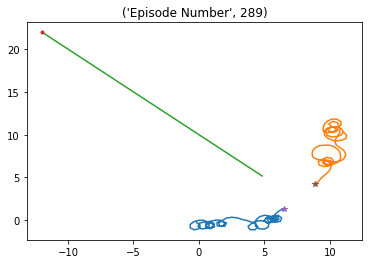

Episode * 290 * Avg Reward is ==> 2539.7538504149925 : Ag1 Reward ==> 1102.1176076286056 : Ag2 Reward ==> 1102.9034665092074 


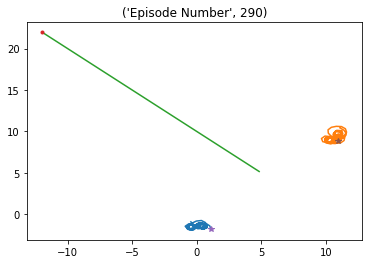

Episode * 291 * Avg Reward is ==> 2531.628798853079 : Ag1 Reward ==> 1249.6276369446557 : Ag2 Reward ==> 1139.7220433062218 


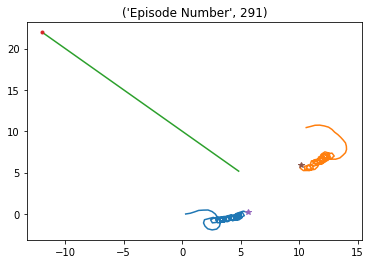

Episode * 292 * Avg Reward is ==> 2526.302248240144 : Ag1 Reward ==> 1200.6946665622518 : Ag2 Reward ==> 1202.6434933250982 


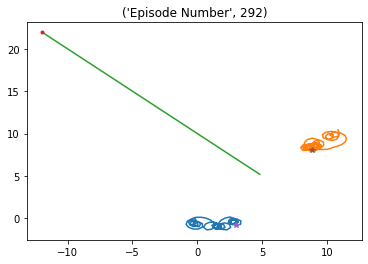

Episode * 293 * Avg Reward is ==> 2520.547503325421 : Ag1 Reward ==> 1211.477890971116 : Ag2 Reward ==> 1195.0135229839311 


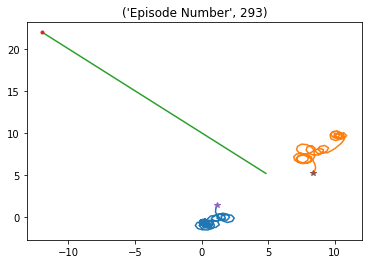

Episode * 294 * Avg Reward is ==> 2515.5836310455716 : Ag1 Reward ==> 1164.0164453674965 : Ag2 Reward ==> 1144.0746536378033 


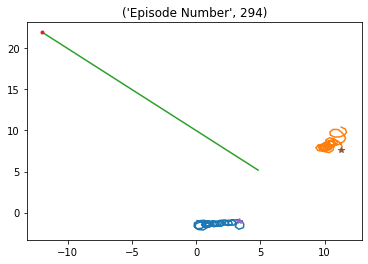

Episode * 295 * Avg Reward is ==> 2520.6887509093262 : Ag1 Reward ==> 1144.7249254274482 : Ag2 Reward ==> 1166.2758926789436 


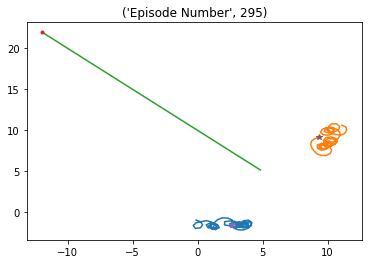

Episode * 296 * Avg Reward is ==> 2510.950018111237 : Ag1 Reward ==> 1393.715385071382 : Ag2 Reward ==> 1345.8962622517495 


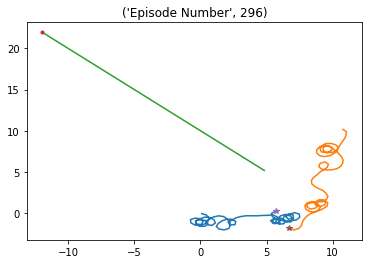

Episode * 297 * Avg Reward is ==> 2505.087266350753 : Ag1 Reward ==> 1362.400407282678 : Ag2 Reward ==> 1294.9510410919802 


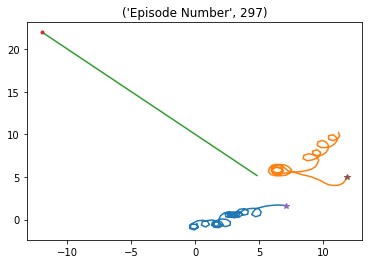

Episode * 298 * Avg Reward is ==> 2498.476302435462 : Ag1 Reward ==> 1107.6755537282913 : Ag2 Reward ==> 898.8696561363998 


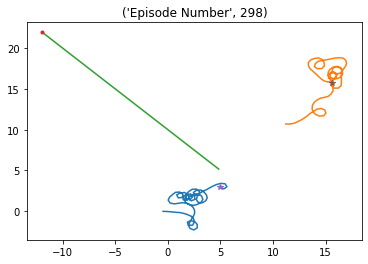

Episode * 299 * Avg Reward is ==> 2467.456164942886 : Ag1 Reward ==> 1112.639876766554 : Ag2 Reward ==> 996.6128835312934 


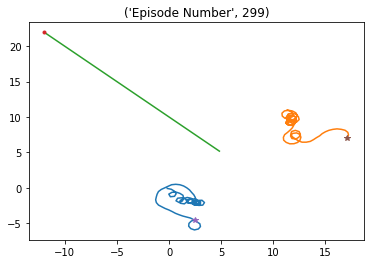

Episode * 300 * Avg Reward is ==> 2459.9566526973504 : Ag1 Reward ==> 1165.4116660429186 : Ag2 Reward ==> 1033.3645364001811 


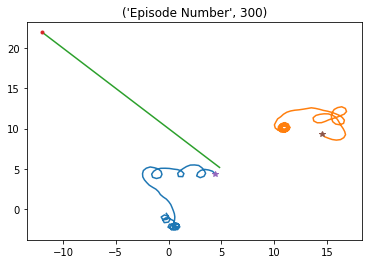

Episode * 301 * Avg Reward is ==> 2452.5264714901223 : Ag1 Reward ==> 1166.3315543255628 : Ag2 Reward ==> 1075.1400733211833 


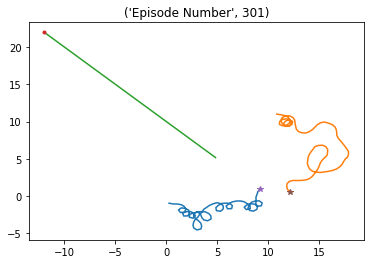

Episode * 302 * Avg Reward is ==> 2445.2184893191616 : Ag1 Reward ==> 1258.0143081656058 : Ag2 Reward ==> 1155.9562092392143 


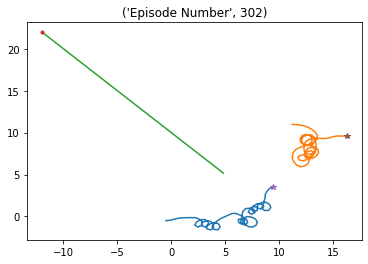

Episode * 303 * Avg Reward is ==> 2432.7733069985243 : Ag1 Reward ==> 1315.2541670785006 : Ag2 Reward ==> 1182.5647938386003 


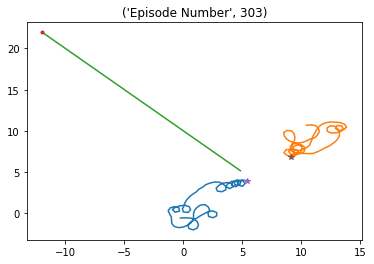

Episode * 304 * Avg Reward is ==> 2429.117940616713 : Ag1 Reward ==> 1290.093988119638 : Ag2 Reward ==> 1218.5314802847938 


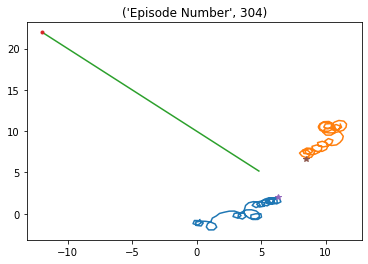

Episode * 305 * Avg Reward is ==> 2436.271623281951 : Ag1 Reward ==> 1248.2018183944692 : Ag2 Reward ==> 1229.6189459075604 


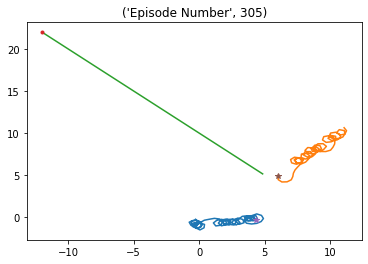

Episode * 306 * Avg Reward is ==> 2441.247941444423 : Ag1 Reward ==> 1181.3113690235814 : Ag2 Reward ==> 1181.3661174739227 


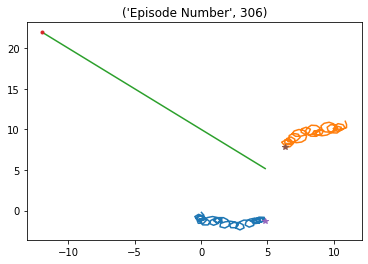

Episode * 307 * Avg Reward is ==> 2451.667212270224 : Ag1 Reward ==> 1477.468678023728 : Ag2 Reward ==> 1422.5649240156201 


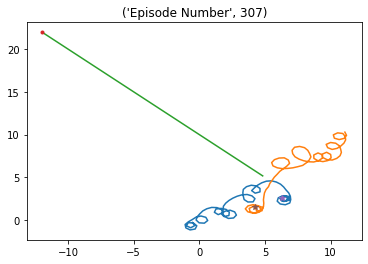

Episode * 308 * Avg Reward is ==> 2469.5504631012204 : Ag1 Reward ==> 1681.0748833651055 : Ag2 Reward ==> 1640.8464999661965 


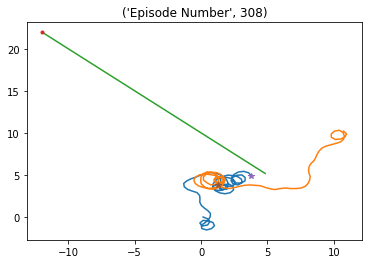

Episode * 309 * Avg Reward is ==> 2468.444573925044 : Ag1 Reward ==> 1418.0248157962424 : Ag2 Reward ==> 1370.3965623514823 


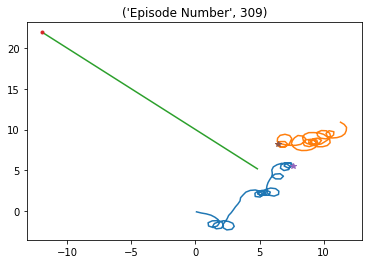

Episode * 310 * Avg Reward is ==> 2467.154135133374 : Ag1 Reward ==> 1261.0183384398026 : Ag2 Reward ==> 1248.8883066218948 


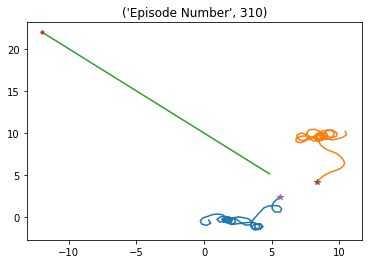

Episode * 311 * Avg Reward is ==> 2469.3270852638007 : Ag1 Reward ==> 1366.194358679632 : Ag2 Reward ==> 1285.05818048618 


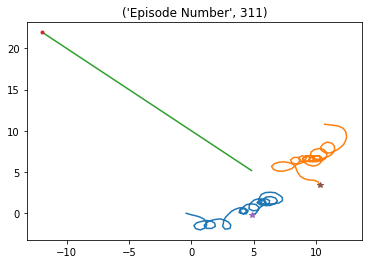

Episode * 312 * Avg Reward is ==> 2477.124172611575 : Ag1 Reward ==> 1414.0051515542293 : Ag2 Reward ==> 1361.9537316579742 


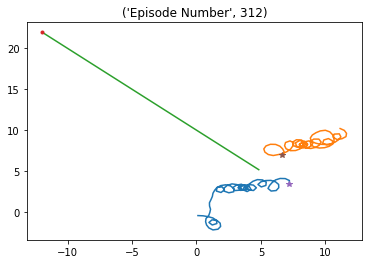

Episode * 313 * Avg Reward is ==> 2489.6913811635977 : Ag1 Reward ==> 1421.7695547044443 : Ag2 Reward ==> 1341.262464995892 


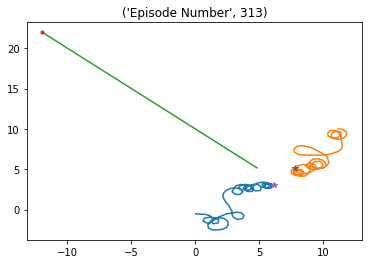

Episode * 314 * Avg Reward is ==> 2497.104981319747 : Ag1 Reward ==> 1257.896324133627 : Ag2 Reward ==> 1269.1852856765786 


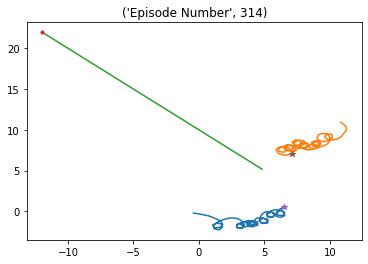

Episode * 315 * Avg Reward is ==> 2484.0311392577178 : Ag1 Reward ==> 1207.2006587988699 : Ag2 Reward ==> 1211.5886717907117 


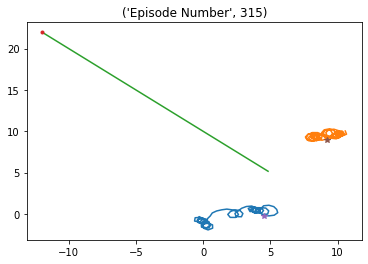

Episode * 316 * Avg Reward is ==> 2493.852431795484 : Ag1 Reward ==> 1747.0254945917347 : Ag2 Reward ==> 1682.7622590819287 


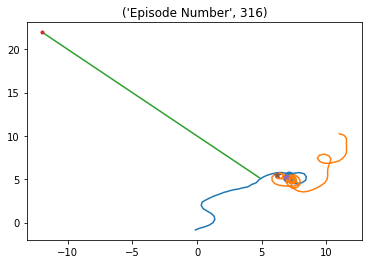

Episode * 317 * Avg Reward is ==> 2505.4801464929674 : Ag1 Reward ==> 1200.3254237910398 : Ag2 Reward ==> 1192.5847743793856 


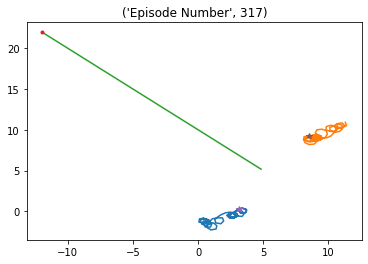

Episode * 318 * Avg Reward is ==> 2504.4102649104475 : Ag1 Reward ==> 1233.5904517378285 : Ag2 Reward ==> 1219.485518020772 


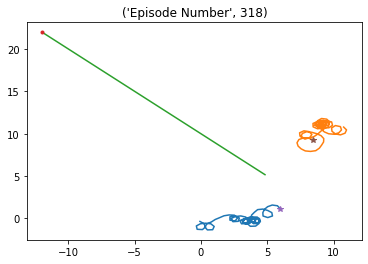

Episode * 319 * Avg Reward is ==> 2498.68698577749 : Ag1 Reward ==> 1199.060412499738 : Ag2 Reward ==> 1165.8814355227003 


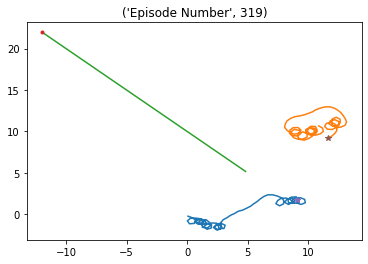

Episode * 320 * Avg Reward is ==> 2496.5326890287033 : Ag1 Reward ==> 1267.5511192145905 : Ag2 Reward ==> 1172.006389142031 


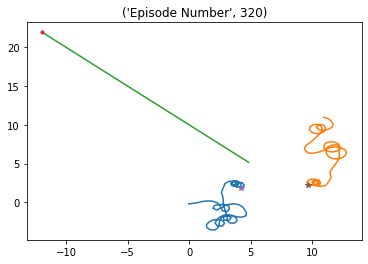

Episode * 321 * Avg Reward is ==> 2491.1701512676527 : Ag1 Reward ==> 1461.1012447897042 : Ag2 Reward ==> 1381.6398070839903 


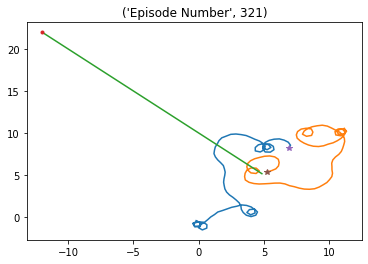

Episode * 322 * Avg Reward is ==> 2503.4419966565 : Ag1 Reward ==> 1507.1998638500759 : Ag2 Reward ==> 1405.1781278218225 


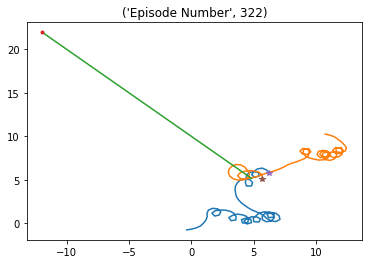

Episode * 323 * Avg Reward is ==> 2509.7985752830964 : Ag1 Reward ==> 1603.425063870068 : Ag2 Reward ==> 1520.9959340175924 


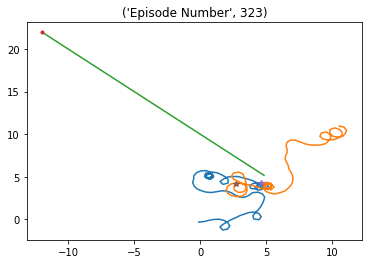

Episode * 324 * Avg Reward is ==> 2539.690140541471 : Ag1 Reward ==> 1691.7329518589552 : Ag2 Reward ==> 1653.1530550671177 


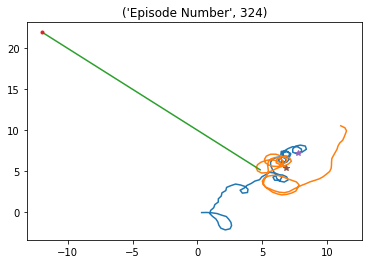

Episode * 325 * Avg Reward is ==> 2529.2575315422955 : Ag1 Reward ==> 1379.7642967152585 : Ag2 Reward ==> 1320.6062869250354 


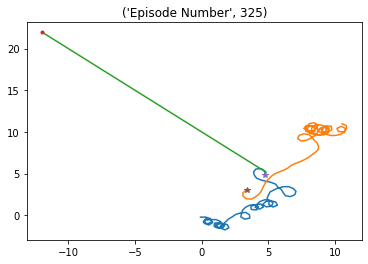

Episode * 326 * Avg Reward is ==> 2562.0138464745655 : Ag1 Reward ==> 1509.0697858132999 : Ag2 Reward ==> 1461.4814923057631 


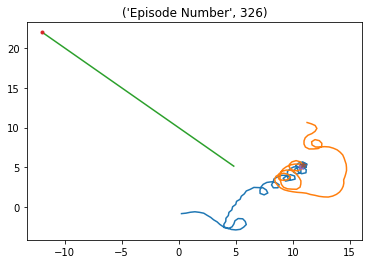

Episode * 327 * Avg Reward is ==> 2588.0903354086786 : Ag1 Reward ==> 1553.1751777828197 : Ag2 Reward ==> 1476.325132868266 


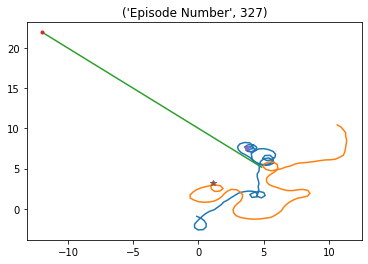

Episode * 328 * Avg Reward is ==> 2590.4814451241236 : Ag1 Reward ==> 1254.1930995434107 : Ag2 Reward ==> 1014.3784525887432 


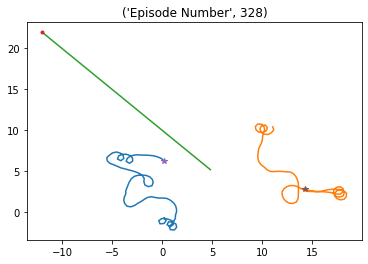

Episode * 329 * Avg Reward is ==> 2595.88057401704 : Ag1 Reward ==> 1330.0987435159368 : Ag2 Reward ==> 1337.819436404934 


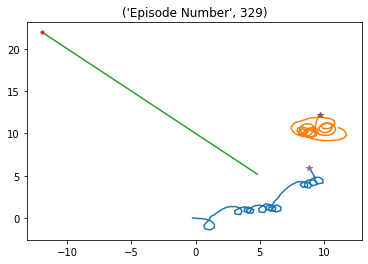

Episode * 330 * Avg Reward is ==> 2608.9966492009266 : Ag1 Reward ==> 1390.470492968193 : Ag2 Reward ==> 1339.193588525077 


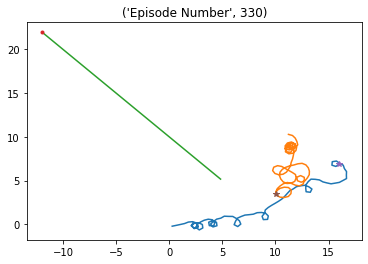

Episode * 331 * Avg Reward is ==> 2608.8497621725883 : Ag1 Reward ==> 1234.351761667248 : Ag2 Reward ==> 1149.122437450108 


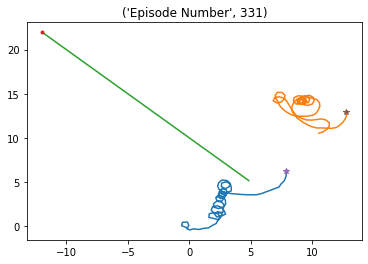

Episode * 332 * Avg Reward is ==> 2603.6769141098753 : Ag1 Reward ==> 1120.1317802558963 : Ag2 Reward ==> 1076.2924571229341 


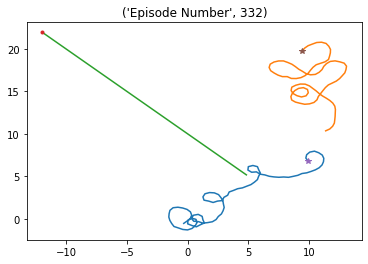

Episode * 333 * Avg Reward is ==> 2600.1002755037503 : Ag1 Reward ==> 1190.828030641693 : Ag2 Reward ==> 1072.5978390683515 


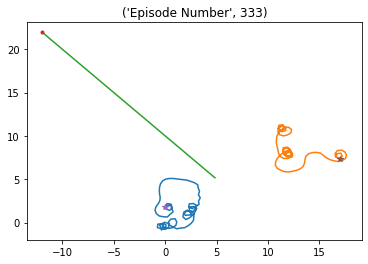

Episode * 334 * Avg Reward is ==> 2608.3104438390997 : Ag1 Reward ==> 1229.8924059988108 : Ag2 Reward ==> 1406.6054264204683 


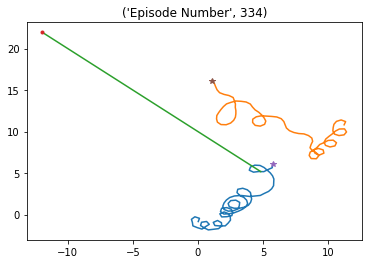

Episode * 335 * Avg Reward is ==> 2613.239119230194 : Ag1 Reward ==> 1337.033155059572 : Ag2 Reward ==> 1171.1146786905988 


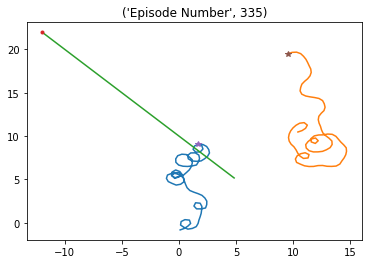

Episode * 336 * Avg Reward is ==> 2602.6756676962377 : Ag1 Reward ==> 1141.338103952266 : Ag2 Reward ==> 1175.7354820126022 


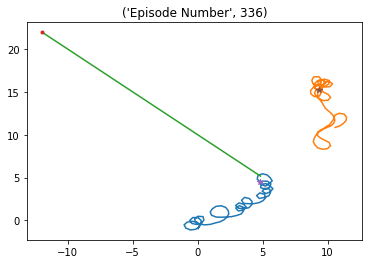

Episode * 337 * Avg Reward is ==> 2598.343036558619 : Ag1 Reward ==> 1228.924844877499 : Ag2 Reward ==> 1255.1213579924124 


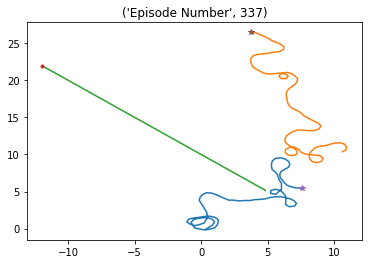

Episode * 338 * Avg Reward is ==> 2618.07335373439 : Ag1 Reward ==> 1362.1903313331388 : Ag2 Reward ==> 1433.5675655623804 


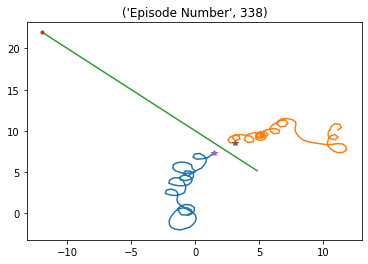

Episode * 339 * Avg Reward is ==> 2627.9175613368598 : Ag1 Reward ==> 1250.7715871175083 : Ag2 Reward ==> 1252.2494772791486 


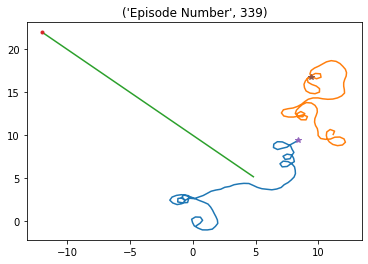

Episode * 340 * Avg Reward is ==> 2645.5804195025353 : Ag1 Reward ==> 1428.6211424427322 : Ag2 Reward ==> 1476.669386627374 


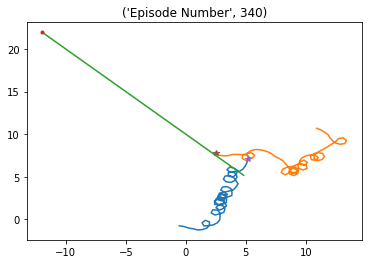

Episode * 341 * Avg Reward is ==> 2643.9278347690883 : Ag1 Reward ==> 1182.9963457361014 : Ag2 Reward ==> 992.3718925727761 


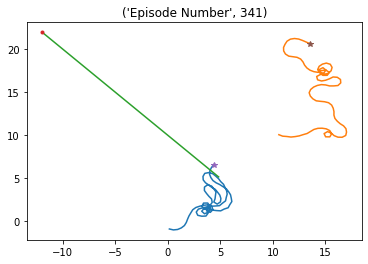

Episode * 342 * Avg Reward is ==> 2655.0380911608822 : Ag1 Reward ==> 1403.7289796232344 : Ag2 Reward ==> 1454.65179345335 


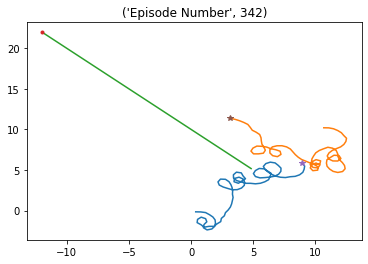

Episode * 343 * Avg Reward is ==> 2671.0581113012427 : Ag1 Reward ==> 1524.3662354754665 : Ag2 Reward ==> 1614.2535310560409 


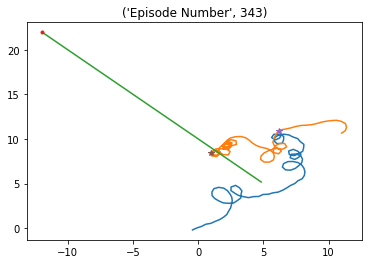

Episode * 344 * Avg Reward is ==> 2676.3485927640613 : Ag1 Reward ==> 1395.7193820575162 : Ag2 Reward ==> 1324.5253448596645 


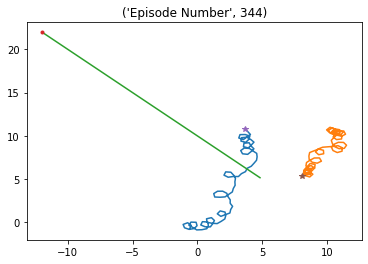

Episode * 345 * Avg Reward is ==> 2684.4602871850175 : Ag1 Reward ==> 1300.2449024030525 : Ag2 Reward ==> 1502.0436387372197 


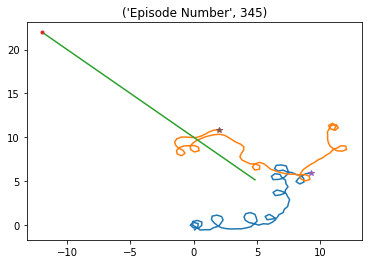

Episode * 346 * Avg Reward is ==> 2672.9523696914807 : Ag1 Reward ==> 945.1029571291191 : Ag2 Reward ==> 957.2578296269139 


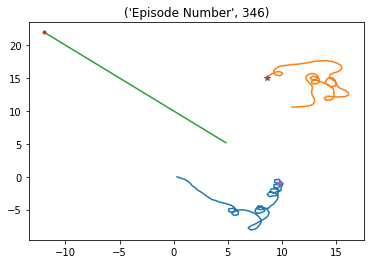

Episode * 347 * Avg Reward is ==> 2657.1346088184605 : Ag1 Reward ==> 1119.2710469634958 : Ag2 Reward ==> 1148.052120155037 


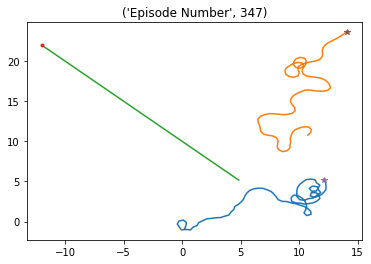

Episode * 348 * Avg Reward is ==> 2622.4992702464056 : Ag1 Reward ==> 959.9936739526956 : Ag2 Reward ==> 976.5141664964251 


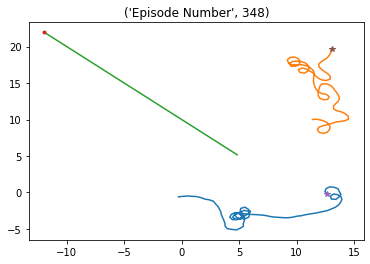

Episode * 349 * Avg Reward is ==> 2608.525587603957 : Ag1 Reward ==> 1259.031262233514 : Ag2 Reward ==> 970.442810216275 


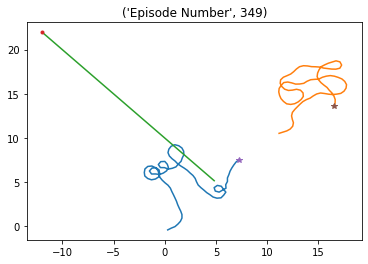

Episode * 350 * Avg Reward is ==> 2600.8082571172154 : Ag1 Reward ==> 1088.9607626591762 : Ag2 Reward ==> 1112.2526629328468 


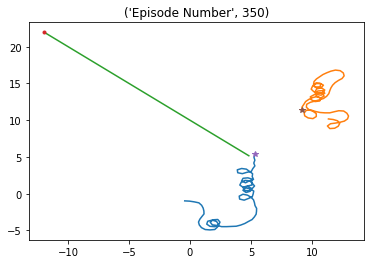

Episode * 351 * Avg Reward is ==> 2589.0992932792396 : Ag1 Reward ==> 1099.115292737932 : Ag2 Reward ==> 1083.7786929088463 


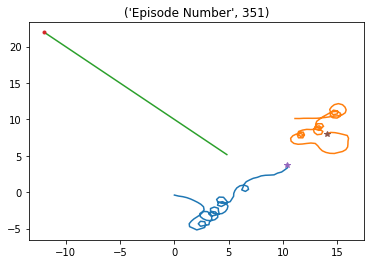

Episode * 352 * Avg Reward is ==> 2577.699674558244 : Ag1 Reward ==> 1054.7806049890623 : Ag2 Reward ==> 1265.1935293833212 


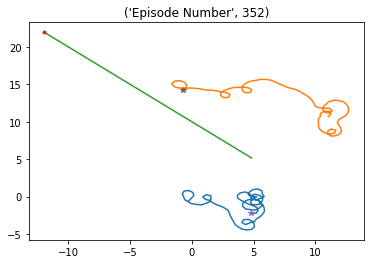

Episode * 353 * Avg Reward is ==> 2572.9576909218763 : Ag1 Reward ==> 1149.6703938766273 : Ag2 Reward ==> 1423.682280369012 


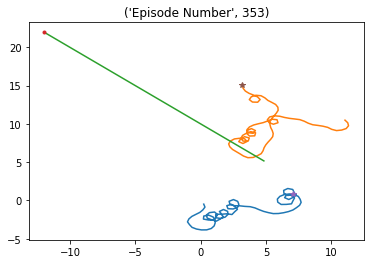

Episode * 354 * Avg Reward is ==> 2580.671571211312 : Ag1 Reward ==> 1282.4779155576184 : Ag2 Reward ==> 1553.1589058299785 


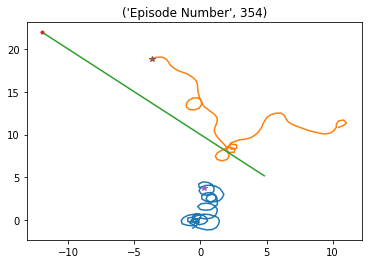

Episode * 355 * Avg Reward is ==> 2587.4629553199056 : Ag1 Reward ==> 1224.5314972388935 : Ag2 Reward ==> 1465.9131976944564 


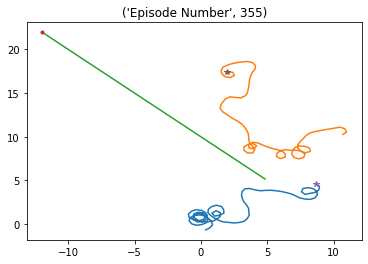

Episode * 356 * Avg Reward is ==> 2557.9115418003794 : Ag1 Reward ==> 1063.312294051442 : Ag2 Reward ==> 1184.4189188411565 


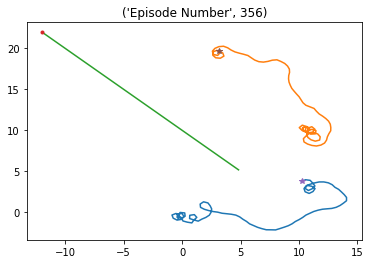

Episode * 357 * Avg Reward is ==> 2574.71358491618 : Ag1 Reward ==> 1492.9182305182658 : Ag2 Reward ==> 1572.0736922842163 


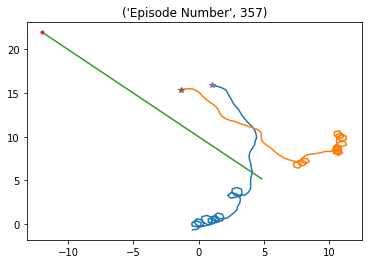

Episode * 358 * Avg Reward is ==> 2578.714667279572 : Ag1 Reward ==> 1137.3518098131958 : Ag2 Reward ==> 1475.7674544810645 


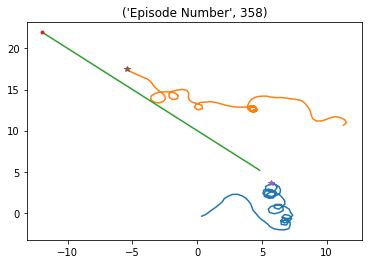

Episode * 359 * Avg Reward is ==> 2590.9162833912756 : Ag1 Reward ==> 1290.07839602564 : Ag2 Reward ==> 1562.9280964649647 


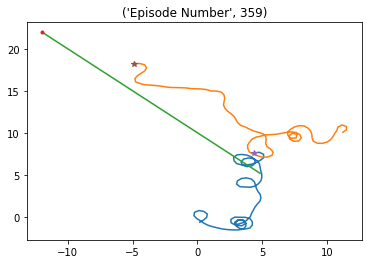

Episode * 360 * Avg Reward is ==> 2592.6096397650854 : Ag1 Reward ==> 1046.0639928976743 : Ag2 Reward ==> 1461.227770411325 


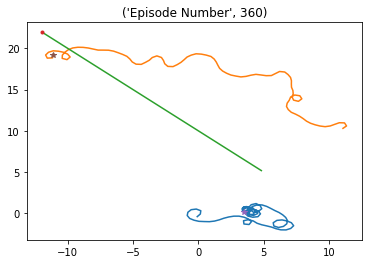

Episode * 361 * Avg Reward is ==> 2579.73322964377 : Ag1 Reward ==> 1082.9733309095345 : Ag2 Reward ==> 1244.7113161115392 


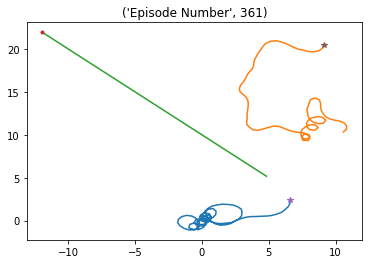

Episode * 362 * Avg Reward is ==> 2556.8364351936116 : Ag1 Reward ==> 1054.403224751785 : Ag2 Reward ==> 942.1029889137735 


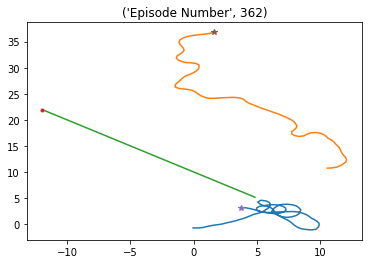

Episode * 363 * Avg Reward is ==> 2549.2938285446994 : Ag1 Reward ==> 1379.5482837898394 : Ag2 Reward ==> 1443.1684481413363 


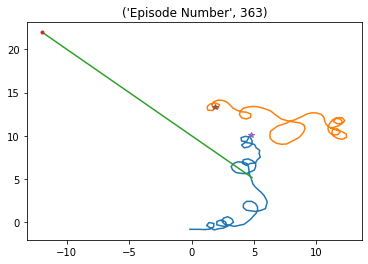

Episode * 364 * Avg Reward is ==> 2534.6227379835573 : Ag1 Reward ==> 1224.013555178307 : Ag2 Reward ==> 1534.0288293021003 


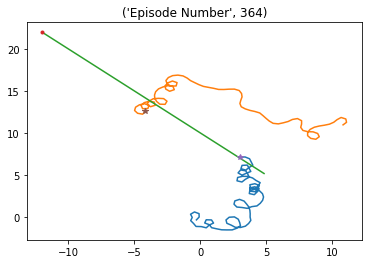

Episode * 365 * Avg Reward is ==> 2544.0486180121857 : Ag1 Reward ==> 1536.514363849375 : Ag2 Reward ==> 1540.891420936031 


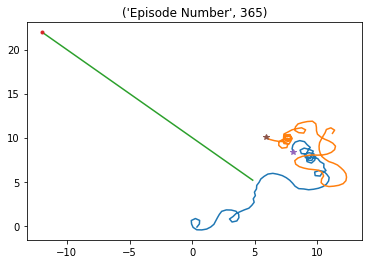

Episode * 366 * Avg Reward is ==> 2535.642753702905 : Ag1 Reward ==> 1303.2550970932487 : Ag2 Reward ==> 1331.0616086545801 


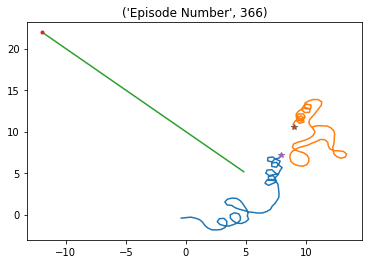

Episode * 367 * Avg Reward is ==> 2541.215583738928 : Ag1 Reward ==> 1596.8179814823711 : Ag2 Reward ==> 1655.595530609641 


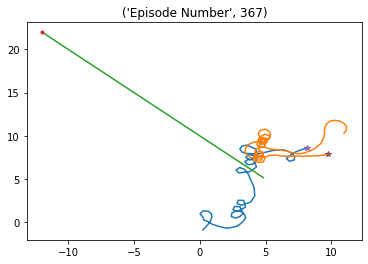

Episode * 368 * Avg Reward is ==> 2540.4603532576975 : Ag1 Reward ==> 1114.3823747758279 : Ag2 Reward ==> 1123.9799581071172 


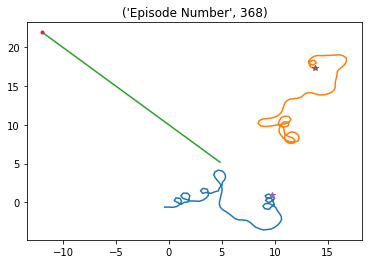

Episode * 369 * Avg Reward is ==> 2539.0298234569827 : Ag1 Reward ==> 1173.8965861201386 : Ag2 Reward ==> 1436.8004017721423 


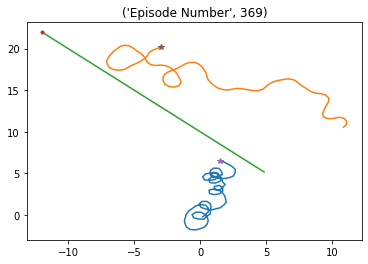

Episode * 370 * Avg Reward is ==> 2519.8786344314462 : Ag1 Reward ==> 1008.2629294597359 : Ag2 Reward ==> 955.3535910120642 


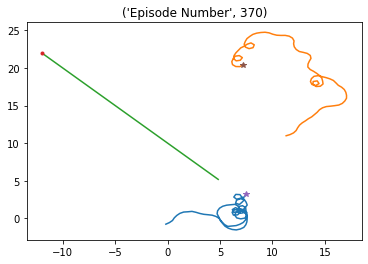

Episode * 371 * Avg Reward is ==> 2536.052718242721 : Ag1 Reward ==> 1533.0287032278454 : Ag2 Reward ==> 1497.4088483405017 


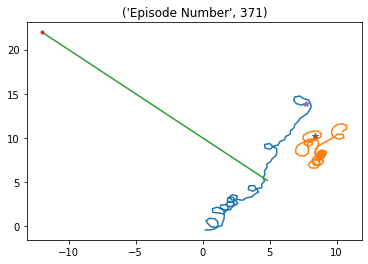

Episode * 372 * Avg Reward is ==> 2551.888036590266 : Ag1 Reward ==> 1244.348599999344 : Ag2 Reward ==> 1585.4883712812746 


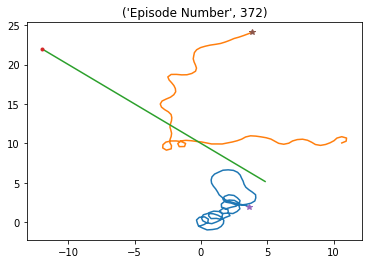

Episode * 373 * Avg Reward is ==> 2572.534343746732 : Ag1 Reward ==> 1673.6535098214001 : Ag2 Reward ==> 1415.624646147271 


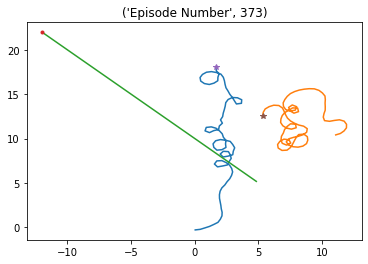

Episode * 374 * Avg Reward is ==> 2573.363066869132 : Ag1 Reward ==> 1251.2044957945989 : Ag2 Reward ==> 1418.4422615206938 


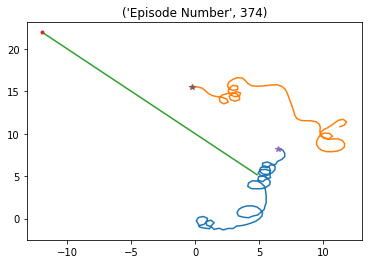

Episode * 375 * Avg Reward is ==> 2584.868494824036 : Ag1 Reward ==> 1408.5110091573472 : Ag2 Reward ==> 1559.853942788989 


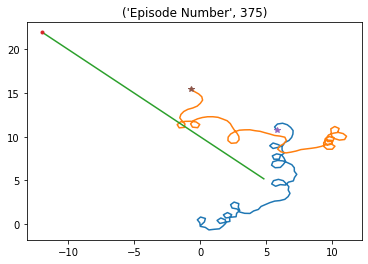

Episode * 376 * Avg Reward is ==> 2597.8813640605686 : Ag1 Reward ==> 1426.6221633078019 : Ag2 Reward ==> 1410.9661921183629 


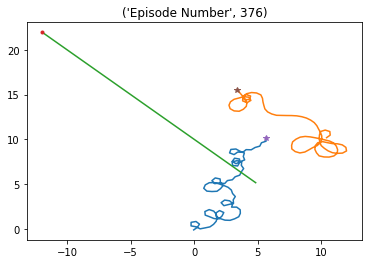

Episode * 377 * Avg Reward is ==> 2610.106730134131 : Ag1 Reward ==> 1456.806185857761 : Ag2 Reward ==> 1516.2546599546406 


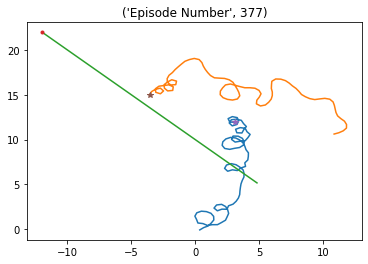

Episode * 378 * Avg Reward is ==> 2613.159647949206 : Ag1 Reward ==> 1408.9657643325934 : Ag2 Reward ==> 1508.9088451659422 


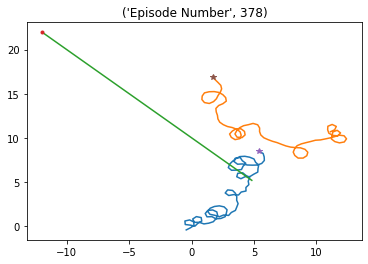

Episode * 379 * Avg Reward is ==> 2624.4853461405987 : Ag1 Reward ==> 1606.0396235565556 : Ag2 Reward ==> 1350.0093684958026 


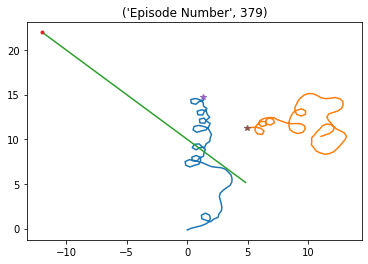

Episode * 380 * Avg Reward is ==> 2610.844511149438 : Ag1 Reward ==> 1243.843462957343 : Ag2 Reward ==> 1115.8136664663446 


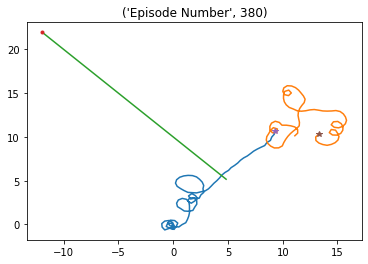

Episode * 381 * Avg Reward is ==> 2612.4042617448004 : Ag1 Reward ==> 1263.2261306000325 : Ag2 Reward ==> 974.5321315233155 


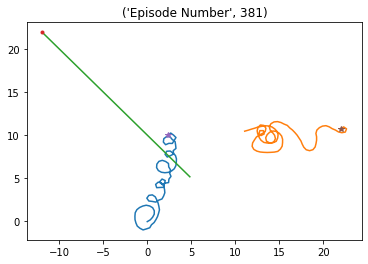

Episode * 382 * Avg Reward is ==> 2597.4604285954115 : Ag1 Reward ==> 1248.9930275953682 : Ag2 Reward ==> 1011.6344195056946 


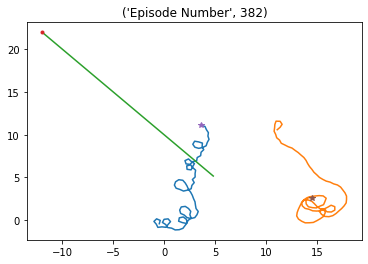

Episode * 383 * Avg Reward is ==> 2583.9703486339226 : Ag1 Reward ==> 1352.4342006514325 : Ag2 Reward ==> 1246.582367420496 


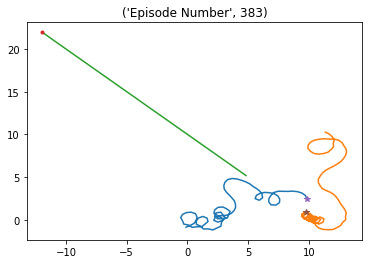

Episode * 384 * Avg Reward is ==> 2583.747827421583 : Ag1 Reward ==> 1344.2977764324498 : Ag2 Reward ==> 1367.0461019911704 


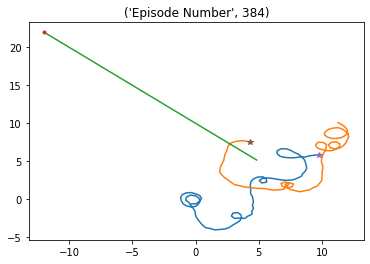

Episode * 385 * Avg Reward is ==> 2573.6959747302535 : Ag1 Reward ==> 1181.3822406108848 : Ag2 Reward ==> 1218.83219287619 


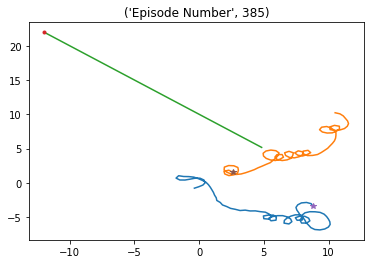

Episode * 386 * Avg Reward is ==> 2588.022671957482 : Ag1 Reward ==> 1188.9255385350327 : Ag2 Reward ==> 1286.5031373101508 


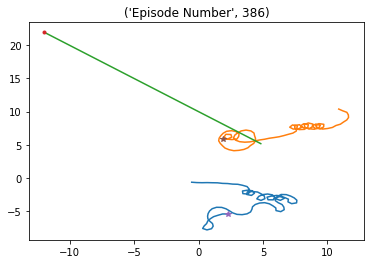

Episode * 387 * Avg Reward is ==> 2598.642543615469 : Ag1 Reward ==> 1342.6294201213786 : Ag2 Reward ==> 1349.488613316648 


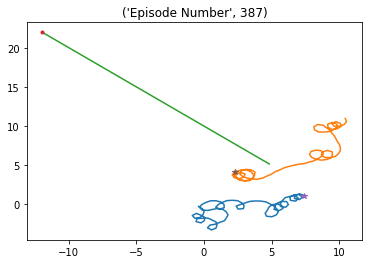

Episode * 388 * Avg Reward is ==> 2630.2705356315078 : Ag1 Reward ==> 1614.8808721390205 : Ag2 Reward ==> 1586.7466489516376 


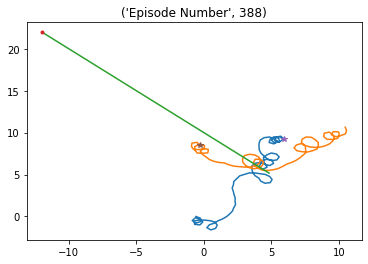

Episode * 389 * Avg Reward is ==> 2630.6061909084124 : Ag1 Reward ==> 1298.0653044105052 : Ag2 Reward ==> 944.834979115476 


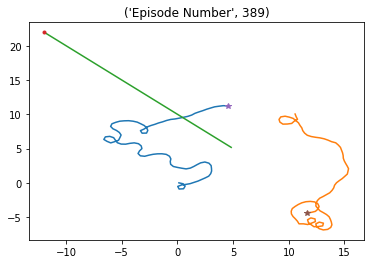

Episode * 390 * Avg Reward is ==> 2648.9549683843848 : Ag1 Reward ==> 1466.2743257164318 : Ag2 Reward ==> 1468.8901989144879 


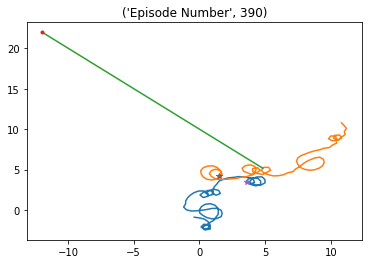

Episode * 391 * Avg Reward is ==> 2671.626815786192 : Ag1 Reward ==> 1550.2430435023691 : Ag2 Reward ==> 1539.524838216693 


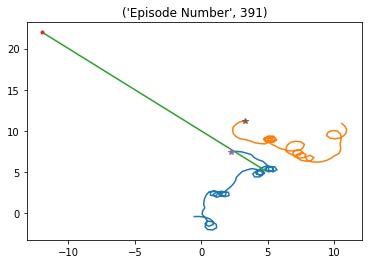

Episode * 392 * Avg Reward is ==> 2693.5870905561583 : Ag1 Reward ==> 1633.538384996309 : Ag2 Reward ==> 1564.846740174724 


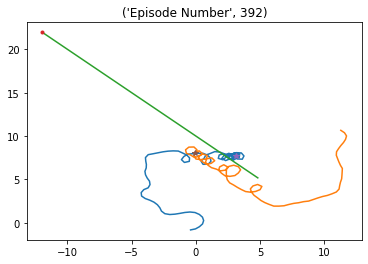

Episode * 393 * Avg Reward is ==> 2687.248802657096 : Ag1 Reward ==> 1279.350216484211 : Ag2 Reward ==> 1040.470941798937 


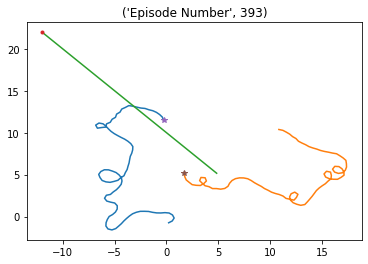

Episode * 394 * Avg Reward is ==> 2694.3634125724116 : Ag1 Reward ==> 1526.5189695843496 : Ag2 Reward ==> 1593.7022484158617 


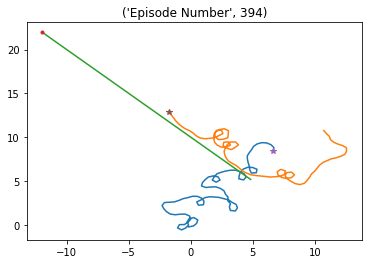

Episode * 395 * Avg Reward is ==> 2702.6624638817016 : Ag1 Reward ==> 1558.1084142459533 : Ag2 Reward ==> 1464.298333059009 


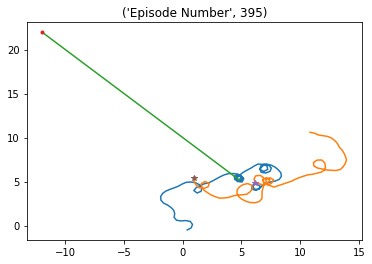

Episode * 396 * Avg Reward is ==> 2727.238989273642 : Ag1 Reward ==> 1683.464606318946 : Ag2 Reward ==> 1547.3276222512734 


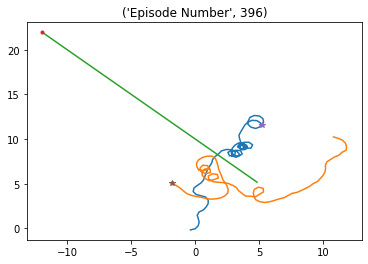

Episode * 397 * Avg Reward is ==> 2724.7447669045223 : Ag1 Reward ==> 1565.0302595131122 : Ag2 Reward ==> 1400.192768524566 


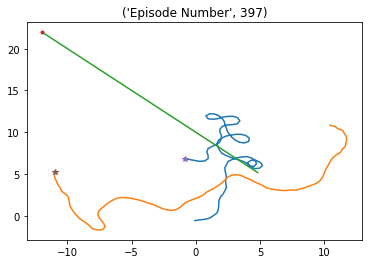

Episode * 398 * Avg Reward is ==> 2732.9500167625292 : Ag1 Reward ==> 1449.8445915930506 : Ag2 Reward ==> 1491.4846670215047 


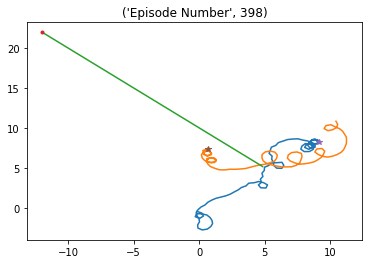

Episode * 399 * Avg Reward is ==> 2747.6968323998126 : Ag1 Reward ==> 1758.586548294402 : Ag2 Reward ==> 1684.2925696875343 


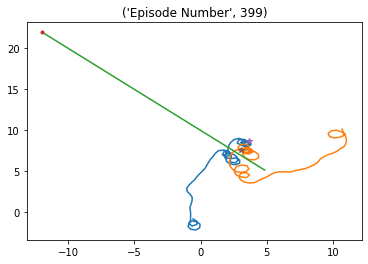

Episode * 400 * Avg Reward is ==> 2769.04299127805 : Ag1 Reward ==> 1701.5891455172632 : Ag2 Reward ==> 1659.548972921215 


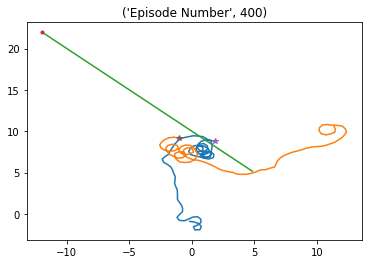

Episode * 401 * Avg Reward is ==> 2783.5893758724205 : Ag1 Reward ==> 1433.8623819099216 : Ag2 Reward ==> 1475.677648885997 


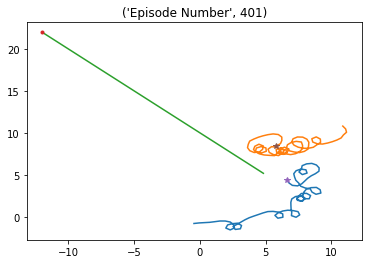

Episode * 402 * Avg Reward is ==> 2808.561602724779 : Ag1 Reward ==> 1607.0265541781484 : Ag2 Reward ==> 1388.368733581722 


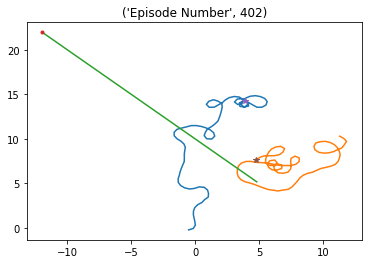

Episode * 403 * Avg Reward is ==> 2821.6595639630386 : Ag1 Reward ==> 1701.466378334764 : Ag2 Reward ==> 1645.1688031268059 


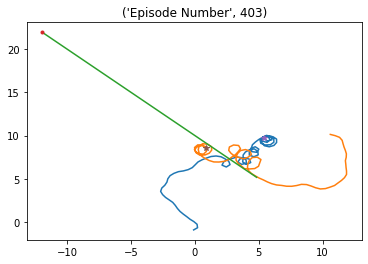

Episode * 404 * Avg Reward is ==> 2832.2808580117476 : Ag1 Reward ==> 1605.108326186195 : Ag2 Reward ==> 1577.7858202425718 


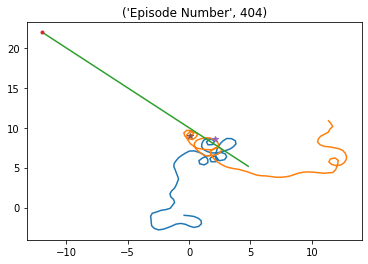

Episode * 405 * Avg Reward is ==> 2819.9832483264277 : Ag1 Reward ==> 1268.3980513647548 : Ag2 Reward ==> 1317.103346007857 


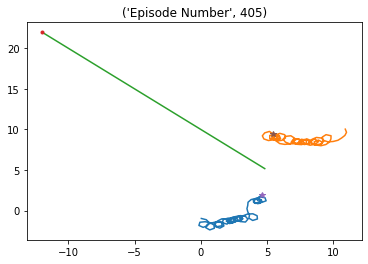

Episode * 406 * Avg Reward is ==> 2819.3041391586103 : Ag1 Reward ==> 1290.3168293591289 : Ag2 Reward ==> 1316.8355096760006 


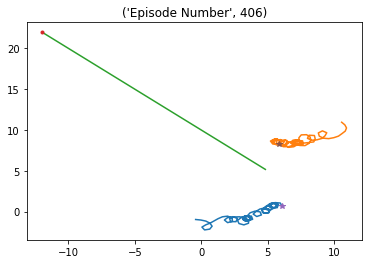

Episode * 407 * Avg Reward is ==> 2827.926079151981 : Ag1 Reward ==> 1810.3734824860353 : Ag2 Reward ==> 1786.9176293408182 


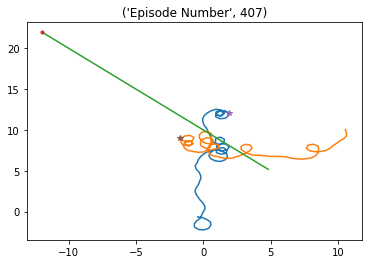

Episode * 408 * Avg Reward is ==> 2849.9131828848317 : Ag1 Reward ==> 1561.876802364334 : Ag2 Reward ==> 1555.9696798326415 


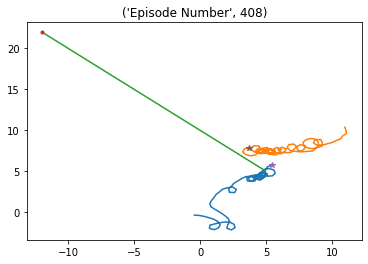

Episode * 409 * Avg Reward is ==> 2864.3318273114573 : Ag1 Reward ==> 1595.4216681401133 : Ag2 Reward ==> 1592.0210968172003 


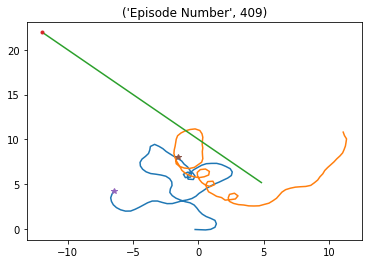

Episode * 410 * Avg Reward is ==> 2895.028617794537 : Ag1 Reward ==> 1623.4181976682646 : Ag2 Reward ==> 1568.0699421266968 


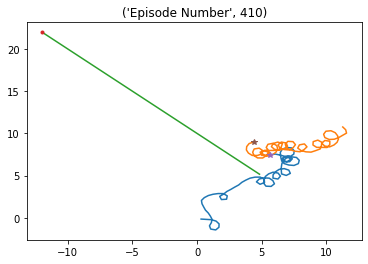

Episode * 411 * Avg Reward is ==> 2904.4818525868677 : Ag1 Reward ==> 1699.966581878665 : Ag2 Reward ==> 1708.6003613829378 


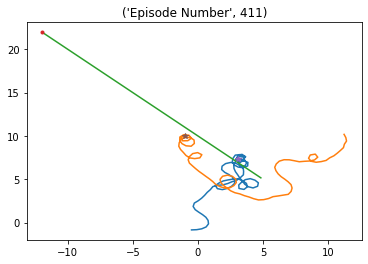

Episode * 412 * Avg Reward is ==> 2905.780714376161 : Ag1 Reward ==> 1394.2048750009292 : Ag2 Reward ==> 1487.5865678513942 


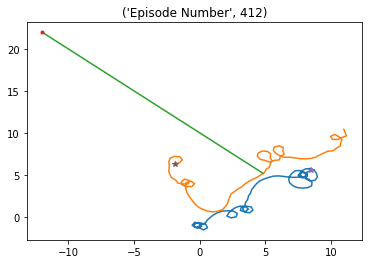

Episode * 413 * Avg Reward is ==> 2905.1329229436196 : Ag1 Reward ==> 1513.4766843834752 : Ag2 Reward ==> 1549.8898142835505 


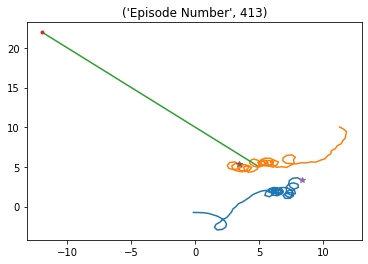

Episode * 414 * Avg Reward is ==> 2917.115661290062 : Ag1 Reward ==> 1567.4114184125801 : Ag2 Reward ==> 1581.5448727603823 


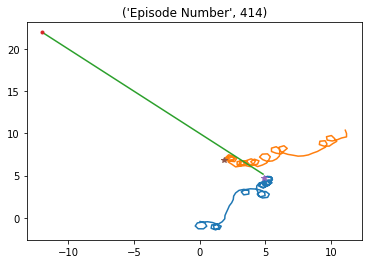

Episode * 415 * Avg Reward is ==> 2918.48017047976 : Ag1 Reward ==> 1485.858386862976 : Ag2 Reward ==> 1537.0869326713093 


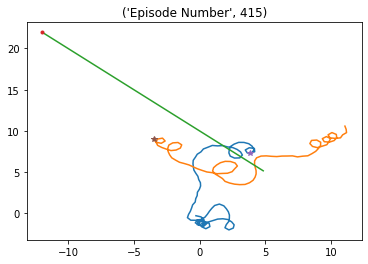

Episode * 416 * Avg Reward is ==> 2936.758599124013 : Ag1 Reward ==> 1765.125434613989 : Ag2 Reward ==> 1803.6000665822833 


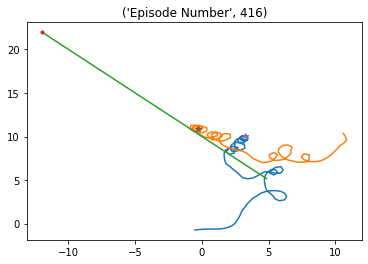

Episode * 417 * Avg Reward is ==> 2940.2812978450047 : Ag1 Reward ==> 1564.9587215768104 : Ag2 Reward ==> 1549.010073075259 


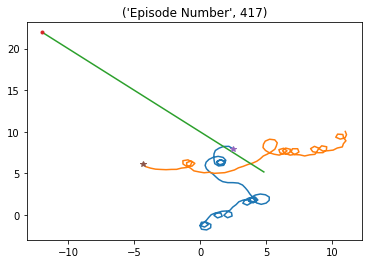

Episode * 418 * Avg Reward is ==> 2941.9383214430686 : Ag1 Reward ==> 1493.0861951448164 : Ag2 Reward ==> 1491.0693582762906 


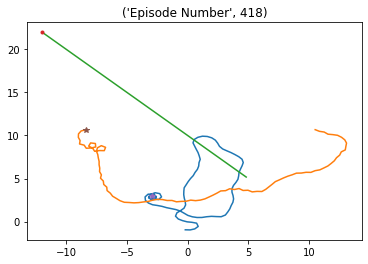

Episode * 419 * Avg Reward is ==> 2944.69749941755 : Ag1 Reward ==> 1536.6988927134396 : Ag2 Reward ==> 1529.717218318175 


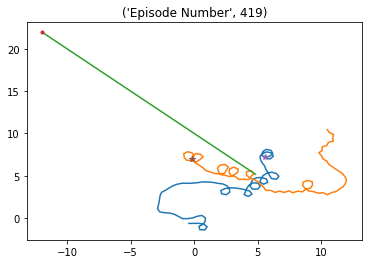

Episode * 420 * Avg Reward is ==> 2950.496067068935 : Ag1 Reward ==> 1385.7901242405253 : Ag2 Reward ==> 1205.8097112385644 


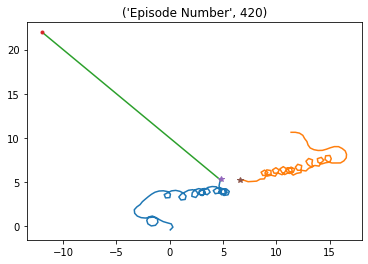

Episode * 421 * Avg Reward is ==> 2985.9628587175257 : Ag1 Reward ==> 1837.6443635743246 : Ag2 Reward ==> 1818.785564492649 


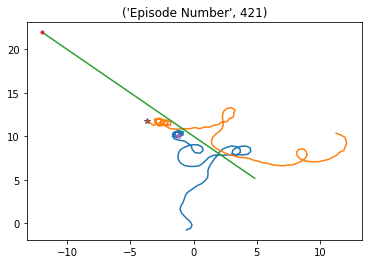

Episode * 422 * Avg Reward is ==> 3013.5968871587984 : Ag1 Reward ==> 1678.5908133481212 : Ag2 Reward ==> 1687.3977714038576 


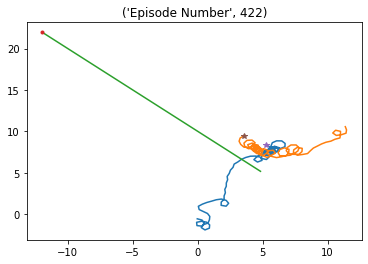

Episode * 423 * Avg Reward is ==> 3034.507942470206 : Ag1 Reward ==> 1735.2487792877755 : Ag2 Reward ==> 1700.2100012404685 


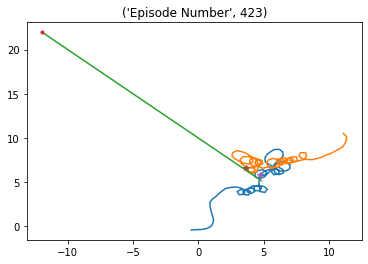

Episode * 424 * Avg Reward is ==> 3050.9557448333258 : Ag1 Reward ==> 1705.5116150489937 : Ag2 Reward ==> 1663.7443578994016 


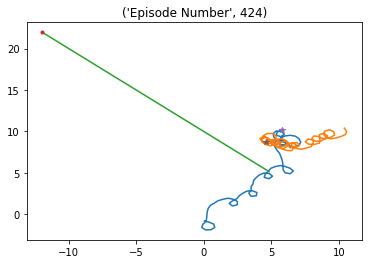

Episode * 425 * Avg Reward is ==> 3069.9784156863248 : Ag1 Reward ==> 1584.4720896840754 : Ag2 Reward ==> 1576.649177922951 


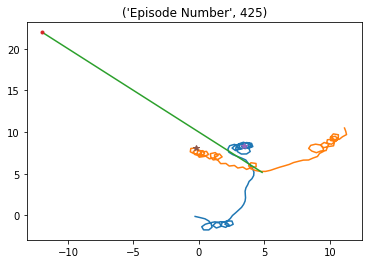

Episode * 426 * Avg Reward is ==> 3087.549384916162 : Ag1 Reward ==> 1597.4341157785063 : Ag2 Reward ==> 1580.8333292601671 


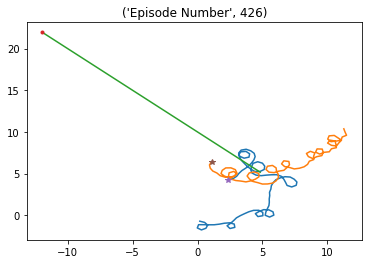

Episode * 427 * Avg Reward is ==> 3111.173463595471 : Ag1 Reward ==> 1788.4565032823791 : Ag2 Reward ==> 1848.624677328002 


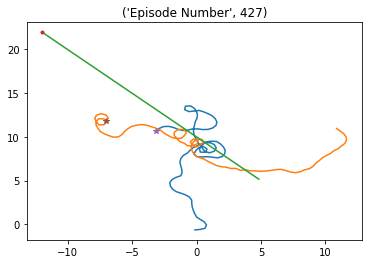

Episode * 428 * Avg Reward is ==> 3118.2809943251586 : Ag1 Reward ==> 1717.6004245234615 : Ag2 Reward ==> 1768.3283257547155 


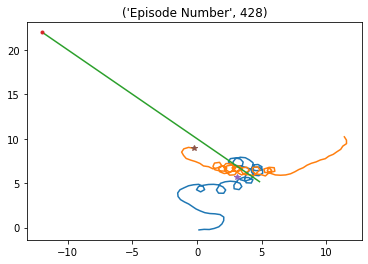

Episode * 429 * Avg Reward is ==> 3150.4953900020773 : Ag1 Reward ==> 1747.1104842265229 : Ag2 Reward ==> 1784.365626376197 


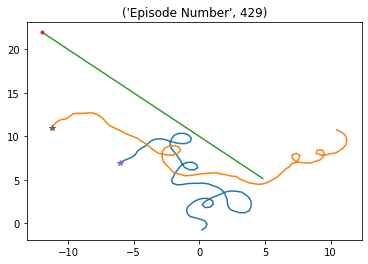

Episode * 430 * Avg Reward is ==> 3150.3327763649722 : Ag1 Reward ==> 1461.5336648938437 : Ag2 Reward ==> 1467.126314252862 


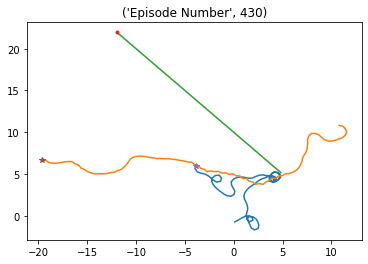

Episode * 431 * Avg Reward is ==> 3132.092101462387 : Ag1 Reward ==> 1281.9737646448907 : Ag2 Reward ==> 1078.1671209707774 


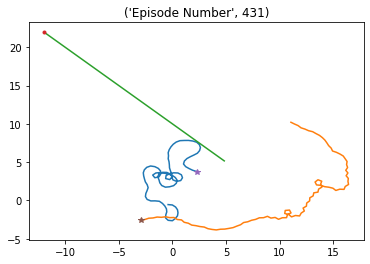

Episode * 432 * Avg Reward is ==> 3128.181729403099 : Ag1 Reward ==> 1500.1224573726395 : Ag2 Reward ==> 1541.8477854268635 


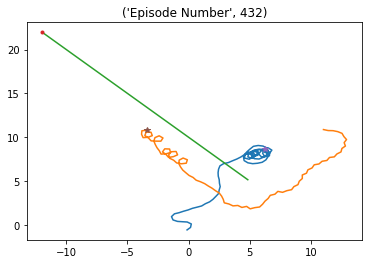

Episode * 433 * Avg Reward is ==> 3152.38490020619 : Ag1 Reward ==> 1669.6712235780485 : Ag2 Reward ==> 1618.2767668287504 


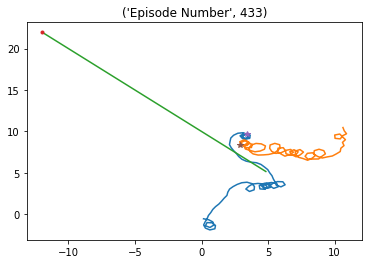

Episode * 434 * Avg Reward is ==> 3153.7934986424366 : Ag1 Reward ==> 1576.6533792989183 : Ag2 Reward ==> 1599.911776151152 


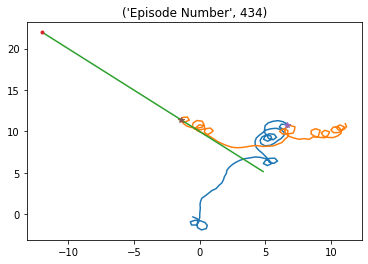

Episode * 435 * Avg Reward is ==> 3161.651808029522 : Ag1 Reward ==> 1662.1377880571354 : Ag2 Reward ==> 1674.601334731222 


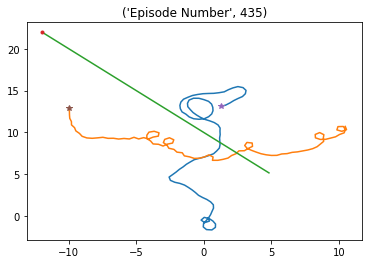

Episode * 436 * Avg Reward is ==> 3162.0243769578615 : Ag1 Reward ==> 1449.6851250405214 : Ag2 Reward ==> 1796.009860663281 


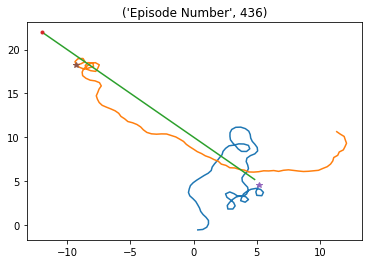

Episode * 437 * Avg Reward is ==> 3177.9516331296118 : Ag1 Reward ==> 1811.0535974958575 : Ag2 Reward ==> 1791.2596774118479 


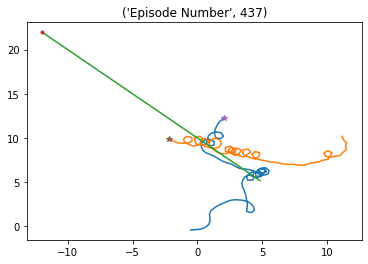

Episode * 438 * Avg Reward is ==> 3191.3155428731584 : Ag1 Reward ==> 1762.277950730113 : Ag2 Reward ==> 1713.6076976263164 


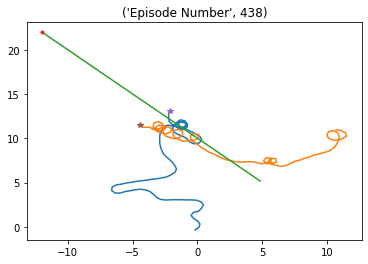

Episode * 439 * Avg Reward is ==> 3193.102839431169 : Ag1 Reward ==> 1735.1116819558906 : Ag2 Reward ==> 1779.2592983464488 


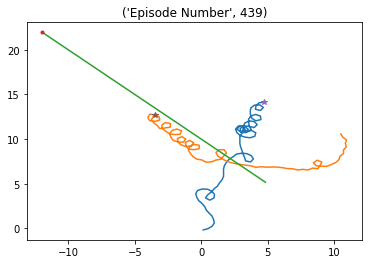

Episode * 440 * Avg Reward is ==> 3192.2627550688167 : Ag1 Reward ==> 1634.2802765895283 : Ag2 Reward ==> 1693.2544673548605 


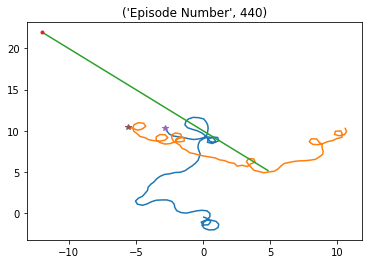

Episode * 441 * Avg Reward is ==> 3206.168388678223 : Ag1 Reward ==> 1787.3701713935388 : Ag2 Reward ==> 1678.3952037786323 


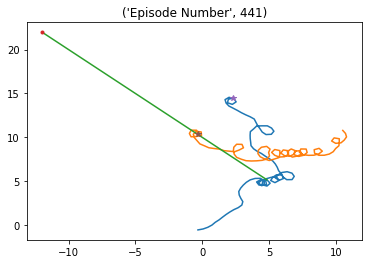

Episode * 442 * Avg Reward is ==> 3208.1708068412618 : Ag1 Reward ==> 1545.8214458191826 : Ag2 Reward ==> 1529.6705684622375 


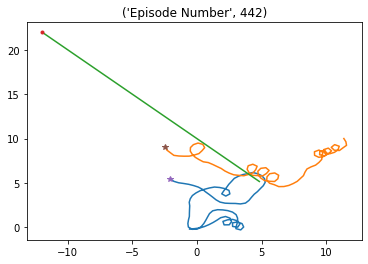

Episode * 443 * Avg Reward is ==> 3208.4669329767657 : Ag1 Reward ==> 1685.848496826822 : Ag2 Reward ==> 1672.6317300549117 


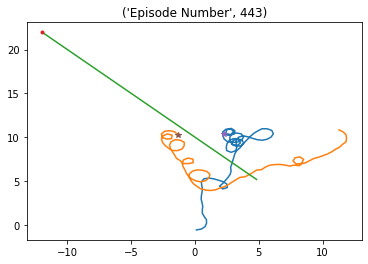

Episode * 444 * Avg Reward is ==> 3211.737394481008 : Ag1 Reward ==> 1640.5148208562948 : Ag2 Reward ==> 1673.197785742159 


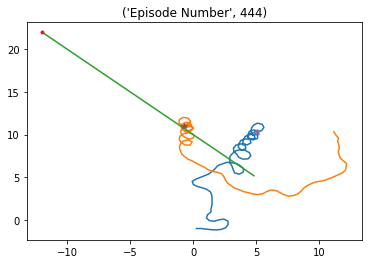

Episode * 445 * Avg Reward is ==> 3227.9734560989973 : Ag1 Reward ==> 1656.2877440515185 : Ag2 Reward ==> 1578.656118040681 


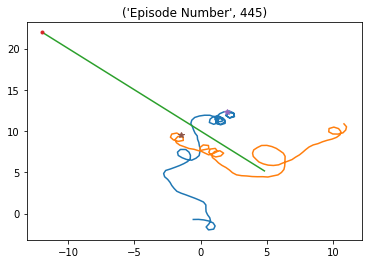

Episode * 446 * Avg Reward is ==> 3241.506226114233 : Ag1 Reward ==> 1557.025767774887 : Ag2 Reward ==> 1591.4373718696534 


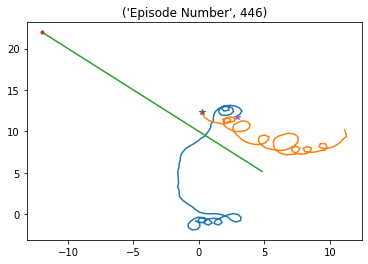

Episode * 447 * Avg Reward is ==> 3234.8893064820068 : Ag1 Reward ==> 1663.6096652139872 : Ag2 Reward ==> 1669.0046613238264 


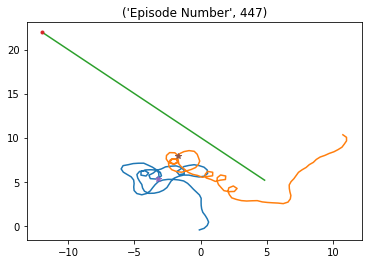

Episode * 448 * Avg Reward is ==> 3237.3735946488696 : Ag1 Reward ==> 1675.741977975036 : Ag2 Reward ==> 1541.476030896464 


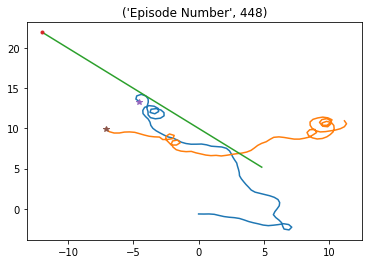

Episode * 449 * Avg Reward is ==> 3244.062772681552 : Ag1 Reward ==> 1771.5871102850538 : Ag2 Reward ==> 1683.422775979542 


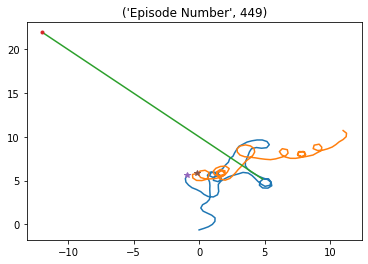

Episode * 450 * Avg Reward is ==> 3238.0212998298593 : Ag1 Reward ==> 1499.4395211395154 : Ag2 Reward ==> 1450.3897045877357 


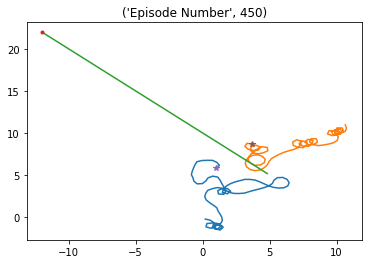

Episode * 451 * Avg Reward is ==> 3237.7188391264626 : Ag1 Reward ==> 1677.1639825666548 : Ag2 Reward ==> 1719.30453255908 


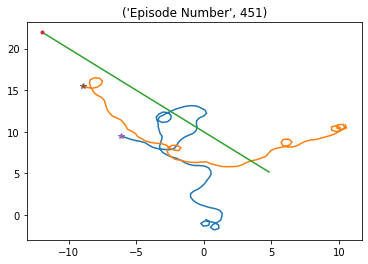

Episode * 452 * Avg Reward is ==> 3249.025838890377 : Ag1 Reward ==> 1667.6372980268823 : Ag2 Reward ==> 1666.4341353820307 


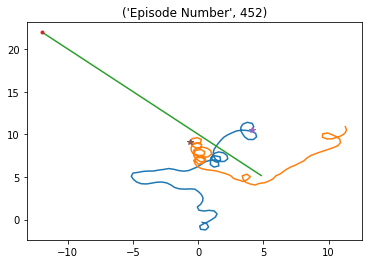

Episode * 453 * Avg Reward is ==> 3246.6434841577493 : Ag1 Reward ==> 1526.7439567968704 : Ag2 Reward ==> 1441.3283525650418 


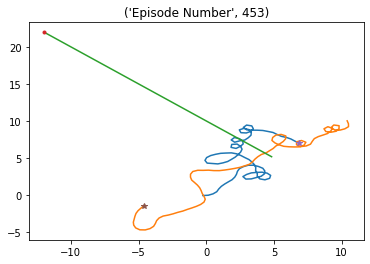

Episode * 454 * Avg Reward is ==> 3239.766631605214 : Ag1 Reward ==> 1489.018367957894 : Ag2 Reward ==> 1384.8638211136642 


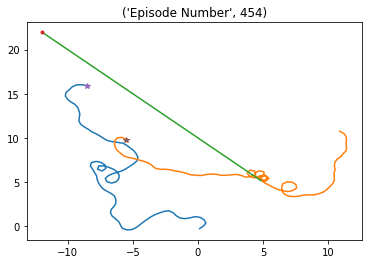

Episode * 455 * Avg Reward is ==> 3231.003030336851 : Ag1 Reward ==> 1294.1642733549897 : Ag2 Reward ==> 1378.2369954447715 


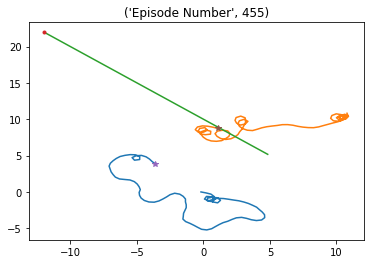

Episode * 456 * Avg Reward is ==> 3224.313351065224 : Ag1 Reward ==> 1591.1285517228278 : Ag2 Reward ==> 1710.0097786083757 


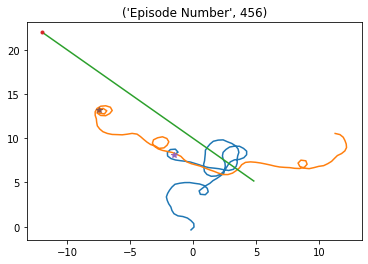

Episode * 457 * Avg Reward is ==> 3218.2605744989696 : Ag1 Reward ==> 1396.4636755943613 : Ag2 Reward ==> 1475.3940564075403 


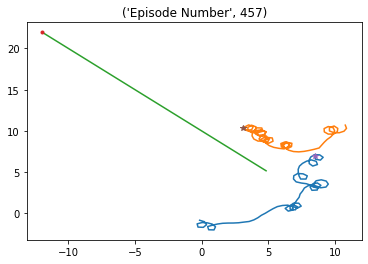

Episode * 458 * Avg Reward is ==> 3223.6998451904265 : Ag1 Reward ==> 1562.5895576020355 : Ag2 Reward ==> 1639.13682347733 


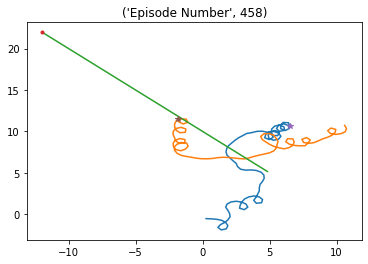

Episode * 459 * Avg Reward is ==> 3227.140795938368 : Ag1 Reward ==> 1590.851382048962 : Ag2 Reward ==> 1613.2027589003198 


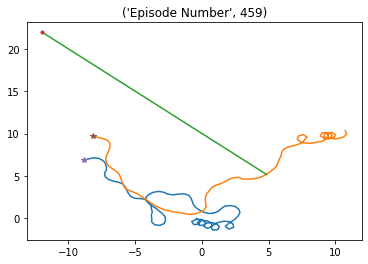

Episode * 460 * Avg Reward is ==> 3255.927685853961 : Ag1 Reward ==> 1876.1370559084794 : Ag2 Reward ==> 1866.9383761943175 


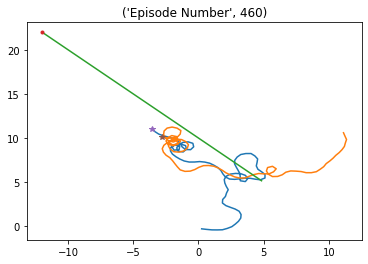

Episode * 461 * Avg Reward is ==> 3231.3458625007174 : Ag1 Reward ==> 1410.640287807537 : Ag2 Reward ==> 1262.5167061297097 


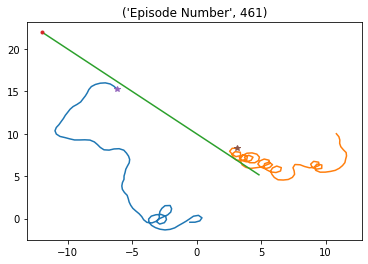

Episode * 462 * Avg Reward is ==> 3233.187296204954 : Ag1 Reward ==> 1714.5578002226223 : Ag2 Reward ==> 1725.0881326987844 


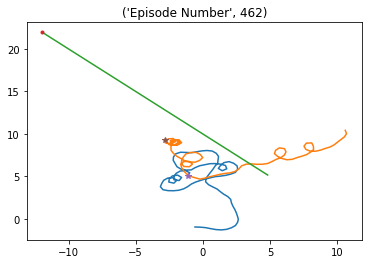

Episode * 463 * Avg Reward is ==> 3243.003421932419 : Ag1 Reward ==> 1912.0285764134155 : Ag2 Reward ==> 1916.0752332134346 


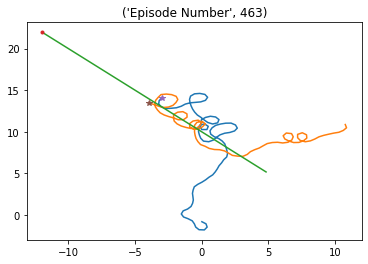

Episode * 464 * Avg Reward is ==> 3247.7771456391415 : Ag1 Reward ==> 1694.6157078729134 : Ag2 Reward ==> 1865.5892133443876 


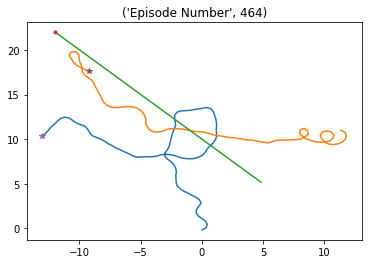

Episode * 465 * Avg Reward is ==> 3244.881082430727 : Ag1 Reward ==> 1575.8425213418654 : Ag2 Reward ==> 1469.4362179286024 


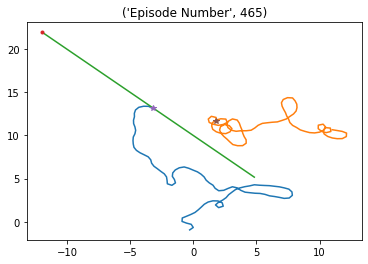

Episode * 466 * Avg Reward is ==> 3246.8710721264674 : Ag1 Reward ==> 1725.8817031778133 : Ag2 Reward ==> 1531.9853296904596 


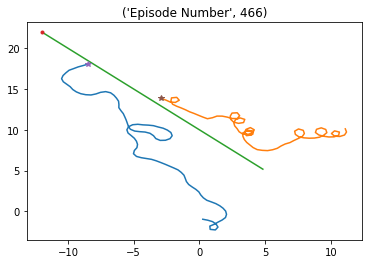

Episode * 467 * Avg Reward is ==> 3228.2723874080634 : Ag1 Reward ==> 1463.5845177847268 : Ag2 Reward ==> 1429.5492740895068 


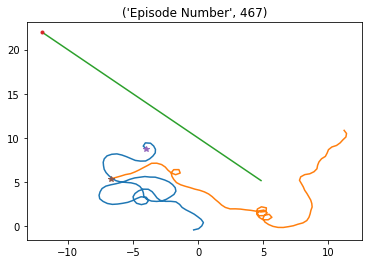

Episode * 468 * Avg Reward is ==> 3220.510608915022 : Ag1 Reward ==> 1620.822651418166 : Ag2 Reward ==> 1554.6349591383337 


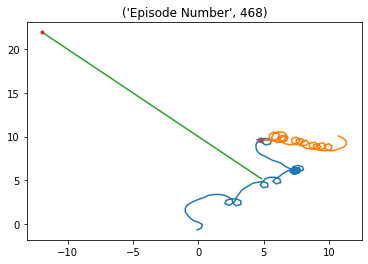

Episode * 469 * Avg Reward is ==> 3207.645308435367 : Ag1 Reward ==> 1547.2165430648506 : Ag2 Reward ==> 1469.6475483516833 


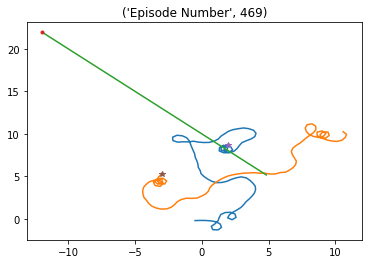

Episode * 470 * Avg Reward is ==> 3203.7560089545186 : Ag1 Reward ==> 1341.8337548284012 : Ag2 Reward ==> 1431.2542450843698 


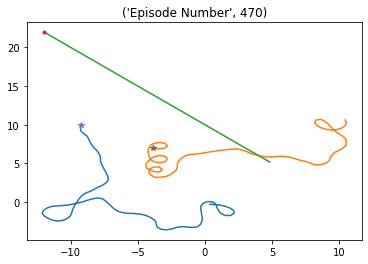

Episode * 471 * Avg Reward is ==> 3216.5151214162515 : Ag1 Reward ==> 1497.7937405035957 : Ag2 Reward ==> 1372.7116435813803 


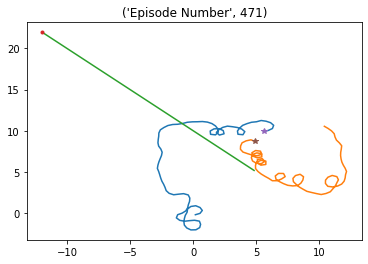

Episode * 472 * Avg Reward is ==> 3203.6026880200566 : Ag1 Reward ==> 1249.6776838360888 : Ag2 Reward ==> 1275.7952231156205 


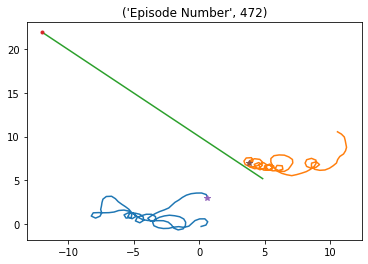

Episode * 473 * Avg Reward is ==> 3195.9181247741753 : Ag1 Reward ==> 1408.0920330580898 : Ag2 Reward ==> 1572.4734275134629 


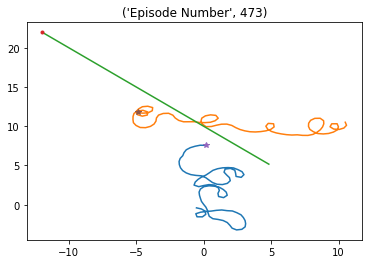

Episode * 474 * Avg Reward is ==> 3193.426698127267 : Ag1 Reward ==> 1587.9684847311212 : Ag2 Reward ==> 1488.939604842609 


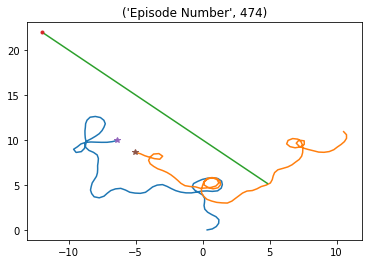

Episode * 475 * Avg Reward is ==> 3199.5760320101936 : Ag1 Reward ==> 1769.5006497248723 : Ag2 Reward ==> 1813.2118283805453 


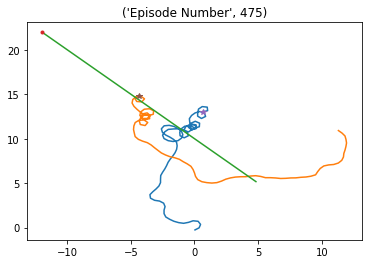

Episode * 476 * Avg Reward is ==> 3202.8921012234 : Ag1 Reward ==> 1711.2482335109125 : Ag2 Reward ==> 1667.0895207211513 


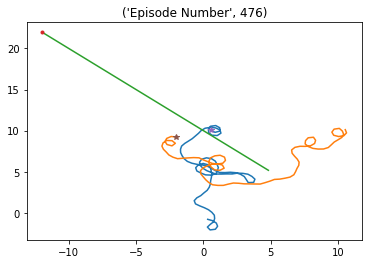

Episode * 477 * Avg Reward is ==> 3184.472930925828 : Ag1 Reward ==> 1346.817353274834 : Ag2 Reward ==> 1518.7291097299924 


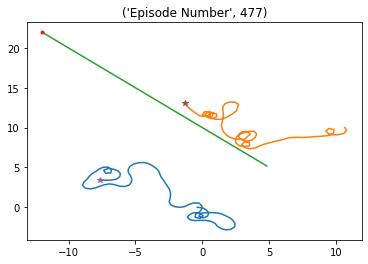

Episode * 478 * Avg Reward is ==> 3164.32598863248 : Ag1 Reward ==> 1327.1008517117718 : Ag2 Reward ==> 1342.9071049107376 


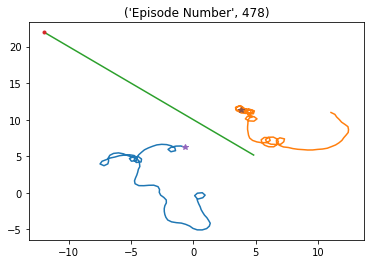

Episode * 479 * Avg Reward is ==> 3137.0942739050547 : Ag1 Reward ==> 1202.4931832924985 : Ag2 Reward ==> 1222.609207912822 


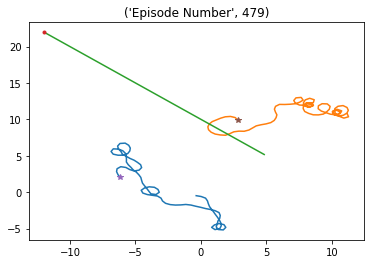

Episode * 480 * Avg Reward is ==> 3138.7434004412694 : Ag1 Reward ==> 1687.5154844538263 : Ag2 Reward ==> 1705.9843209391456 


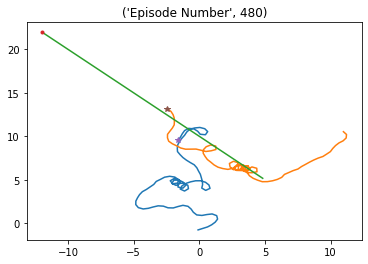

Episode * 481 * Avg Reward is ==> 3120.497290384018 : Ag1 Reward ==> 1400.5296264339358 : Ag2 Reward ==> 1335.3913464481818 


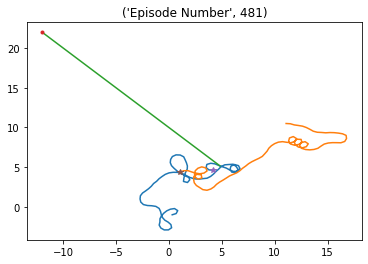

Episode * 482 * Avg Reward is ==> 3114.8795180275883 : Ag1 Reward ==> 1401.2544198123078 : Ag2 Reward ==> 1449.5267002119242 


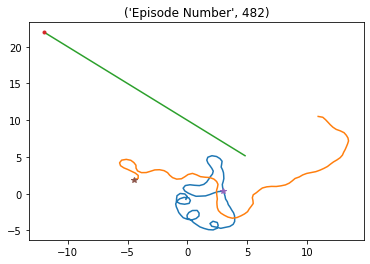

Episode * 483 * Avg Reward is ==> 3118.4861506655297 : Ag1 Reward ==> 1721.2884370506674 : Ag2 Reward ==> 1781.457095348718 


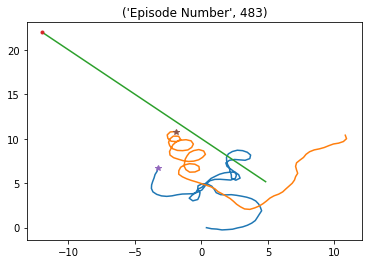

Episode * 484 * Avg Reward is ==> 3121.5049922968874 : Ag1 Reward ==> 1690.2342617706106 : Ag2 Reward ==> 1744.2320100821362 


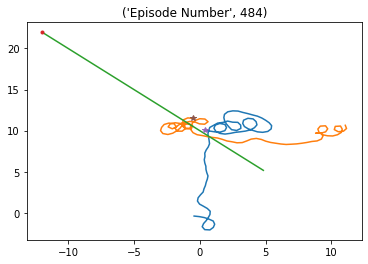

Episode * 485 * Avg Reward is ==> 3118.8412865072905 : Ag1 Reward ==> 1623.7720139470296 : Ag2 Reward ==> 1504.6236165613195 


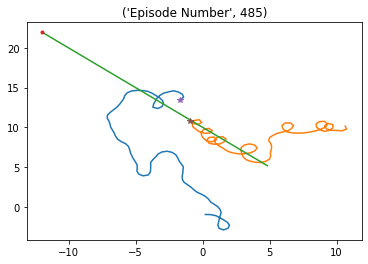

Episode * 486 * Avg Reward is ==> 3115.16102127416 : Ag1 Reward ==> 1558.4138996240836 : Ag2 Reward ==> 1442.838630695215 


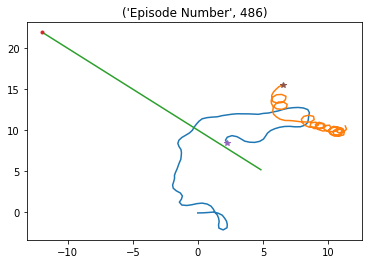

Episode * 487 * Avg Reward is ==> 3086.052435735261 : Ag1 Reward ==> 1121.5700748516147 : Ag2 Reward ==> 1046.700830130259 


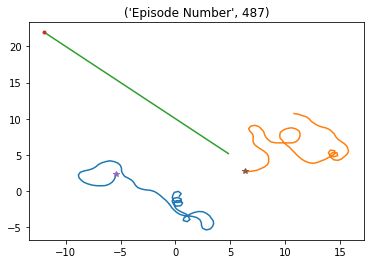

Episode * 488 * Avg Reward is ==> 3087.6516899774006 : Ag1 Reward ==> 1653.65412863866 : Ag2 Reward ==> 1627.5340499184028 


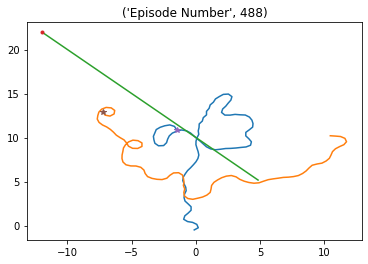

Episode * 489 * Avg Reward is ==> 3075.713789593103 : Ag1 Reward ==> 1488.9508264149656 : Ag2 Reward ==> 1488.5430444777326 


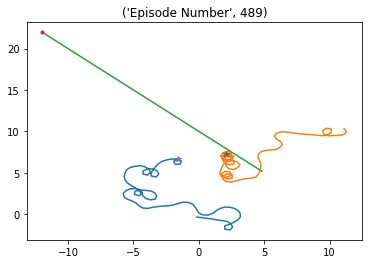

Episode * 490 * Avg Reward is ==> 3088.0472478559795 : Ag1 Reward ==> 1696.7438542625675 : Ag2 Reward ==> 1746.4237019797536 


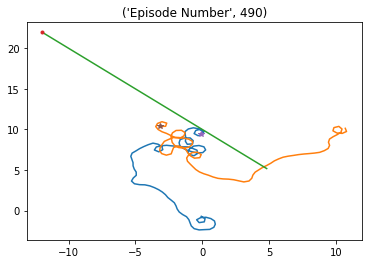

Episode * 491 * Avg Reward is ==> 3091.388579431625 : Ag1 Reward ==> 1816.5199014919258 : Ag2 Reward ==> 1713.601876659626 


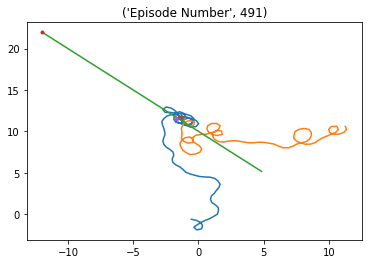

Episode * 492 * Avg Reward is ==> 3095.4916597569318 : Ag1 Reward ==> 1785.9051665688776 : Ag2 Reward ==> 1712.2894798523118 


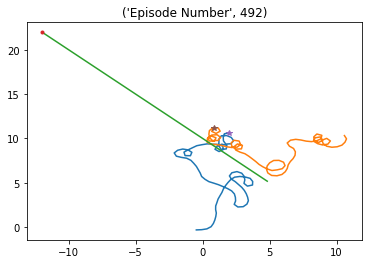

Episode * 493 * Avg Reward is ==> 3102.430677508306 : Ag1 Reward ==> 1712.1705301337513 : Ag2 Reward ==> 1533.4624892831282 


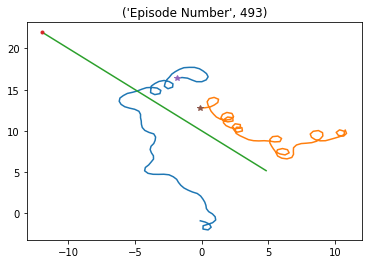

Episode * 494 * Avg Reward is ==> 3113.8190353619275 : Ag1 Reward ==> 1655.8745662142196 : Ag2 Reward ==> 1673.5419370022066 


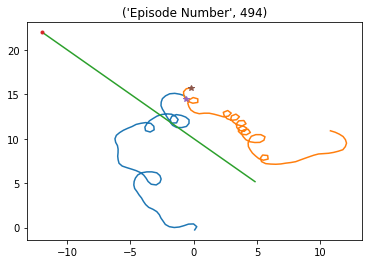

Episode * 495 * Avg Reward is ==> 3128.508021911003 : Ag1 Reward ==> 1539.780853766488 : Ag2 Reward ==> 1720.1798769962766 


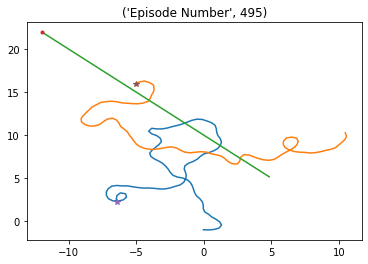

Episode * 496 * Avg Reward is ==> 3132.0342738391087 : Ag1 Reward ==> 1724.5898937582003 : Ag2 Reward ==> 1717.5985136972356 


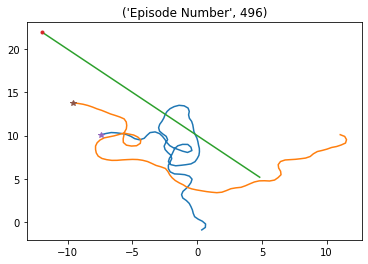

Episode * 497 * Avg Reward is ==> 3132.404796519949 : Ag1 Reward ==> 1517.1821665147684 : Ag2 Reward ==> 1369.4964727207496 


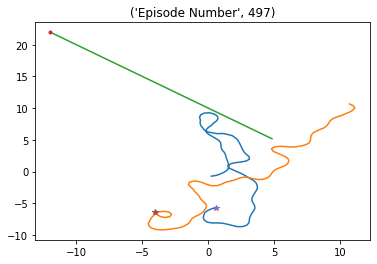

Episode * 498 * Avg Reward is ==> 3134.39127417876 : Ag1 Reward ==> 1667.5765101700415 : Ag2 Reward ==> 1613.6089772617581 


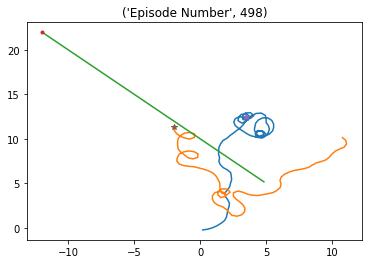

Episode * 499 * Avg Reward is ==> 3136.192087157614 : Ag1 Reward ==> 1651.440843792668 : Ag2 Reward ==> 1624.6458163107845 


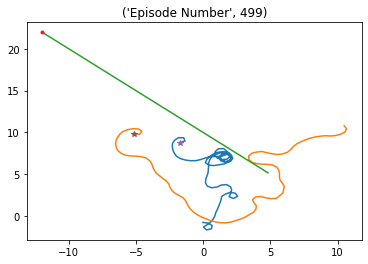

Episode * 500 * Avg Reward is ==> 3123.9589673130367 : Ag1 Reward ==> 1597.8645401731314 : Ag2 Reward ==> 1655.8860981465841 


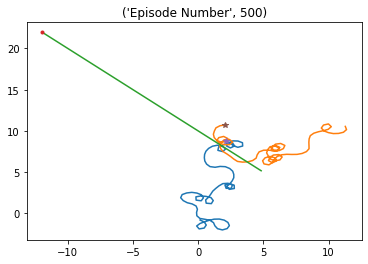

Episode * 501 * Avg Reward is ==> 3111.708119413746 : Ag1 Reward ==> 1085.2615032452888 : Ag2 Reward ==> 1097.8615747203216 


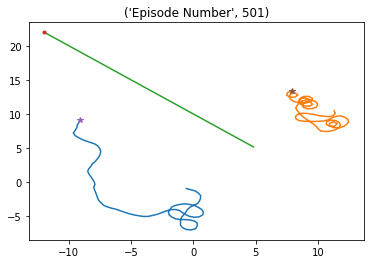

Episode * 502 * Avg Reward is ==> 3102.8039528359486 : Ag1 Reward ==> 1560.244693201228 : Ag2 Reward ==> 1523.2345766082785 


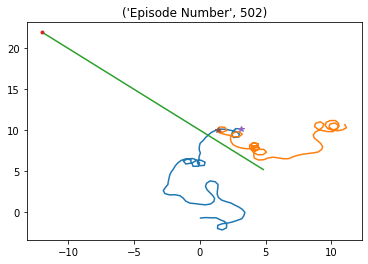

Episode * 503 * Avg Reward is ==> 3080.281779301975 : Ag1 Reward ==> 1377.5875536317922 : Ag2 Reward ==> 1549.629314636123 


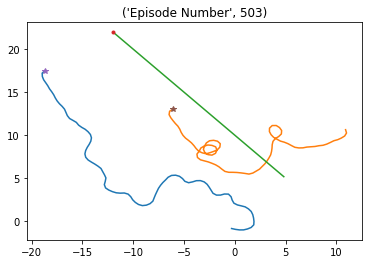

Episode * 504 * Avg Reward is ==> 3061.826296458702 : Ag1 Reward ==> 1416.4271671106062 : Ag2 Reward ==> 1405.5584403757712 


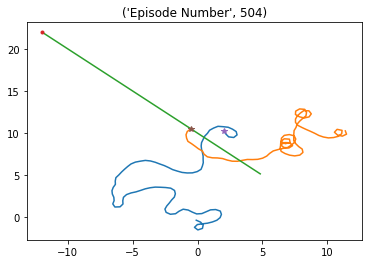

Episode * 505 * Avg Reward is ==> 3052.8955409688424 : Ag1 Reward ==> 1387.6963696214334 : Ag2 Reward ==> 1300.3521500546506 


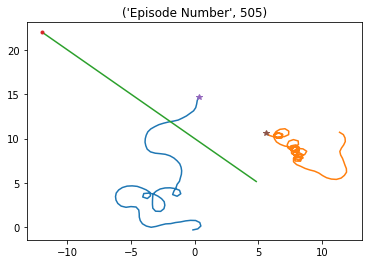

Episode * 506 * Avg Reward is ==> 3045.6361512979456 : Ag1 Reward ==> 1516.945722446555 : Ag2 Reward ==> 1450.545723585839 


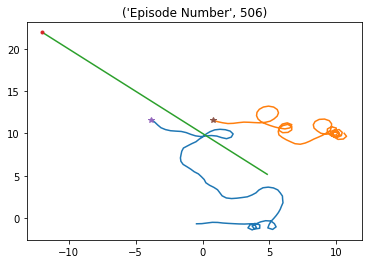

Episode * 507 * Avg Reward is ==> 3046.7828968245476 : Ag1 Reward ==> 1429.7534346611817 : Ag2 Reward ==> 1509.2501782771549 


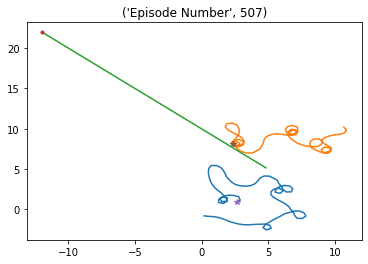

Episode * 508 * Avg Reward is ==> 3036.8938045624627 : Ag1 Reward ==> 1330.2776613325964 : Ag2 Reward ==> 1449.6162587405033 


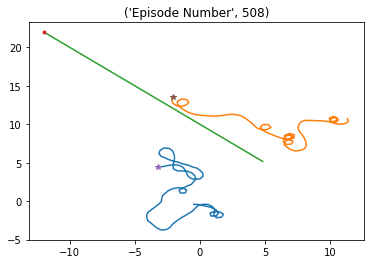

Episode * 509 * Avg Reward is ==> 3030.5514739671285 : Ag1 Reward ==> 1340.2658742725419 : Ag2 Reward ==> 1422.9049933306135 


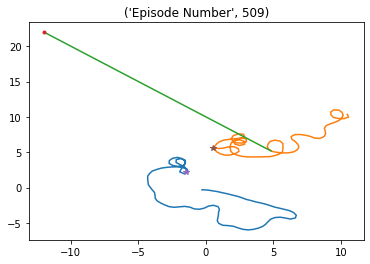

Episode * 510 * Avg Reward is ==> 3038.379266272258 : Ag1 Reward ==> 1716.5802952945621 : Ag2 Reward ==> 1369.619396823402 


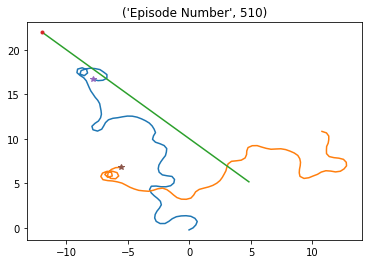

Episode * 511 * Avg Reward is ==> 3054.647242406212 : Ag1 Reward ==> 1773.5967600270415 : Ag2 Reward ==> 1747.6276694160895 


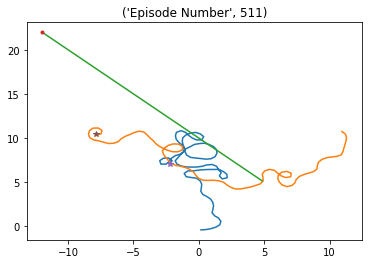

Episode * 512 * Avg Reward is ==> 3076.346097457629 : Ag1 Reward ==> 1714.1383300677226 : Ag2 Reward ==> 1679.2887789406839 


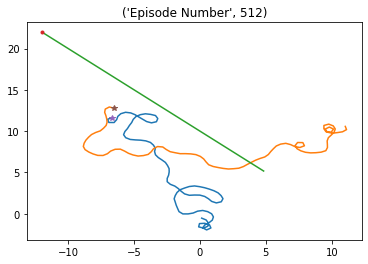

Episode * 513 * Avg Reward is ==> 3078.423089716504 : Ag1 Reward ==> 1512.985045303295 : Ag2 Reward ==> 1550.6601056232264 


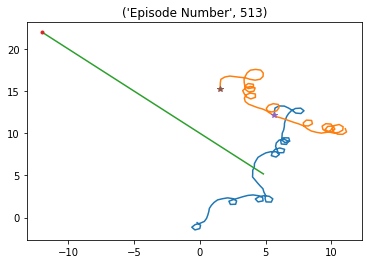

Episode * 514 * Avg Reward is ==> 3076.6690045455407 : Ag1 Reward ==> 1580.9230636886523 : Ag2 Reward ==> 1425.821619046546 


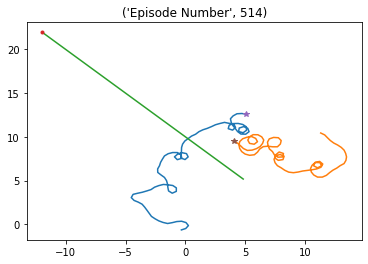

Episode * 515 * Avg Reward is ==> 3066.88149984814 : Ag1 Reward ==> 1509.9340566546853 : Ag2 Reward ==> 1681.2782335547 


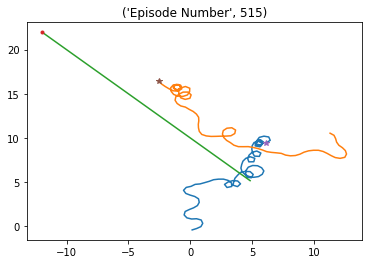

Episode * 516 * Avg Reward is ==> 3070.852372892024 : Ag1 Reward ==> 1782.283702140286 : Ag2 Reward ==> 1754.8889738471673 


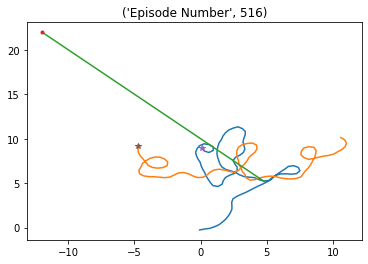

Episode * 517 * Avg Reward is ==> 3084.9437946803146 : Ag1 Reward ==> 1796.339847914631 : Ag2 Reward ==> 1632.863486621819 


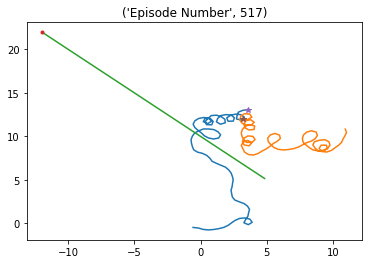

Episode * 518 * Avg Reward is ==> 3089.0392937977317 : Ag1 Reward ==> 1483.9348334623078 : Ag2 Reward ==> 1349.8930878568776 


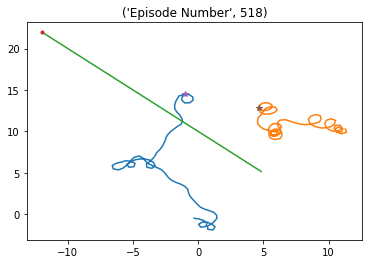

Episode * 519 * Avg Reward is ==> 3109.045228967608 : Ag1 Reward ==> 1724.3200331109483 : Ag2 Reward ==> 1501.019764889425 


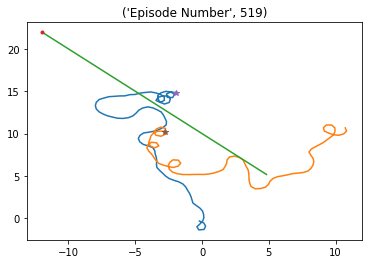

Episode * 520 * Avg Reward is ==> 3107.5291320640285 : Ag1 Reward ==> 1652.000576500138 : Ag2 Reward ==> 1680.8553527496401 


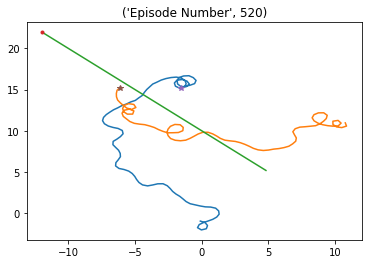

Episode * 521 * Avg Reward is ==> 3098.5399657791313 : Ag1 Reward ==> 1180.8814689046774 : Ag2 Reward ==> 1195.4728525815558 


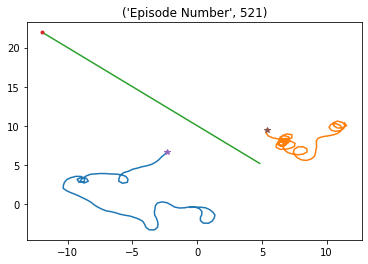

Episode * 522 * Avg Reward is ==> 3113.8595073878123 : Ag1 Reward ==> 1723.0996578990425 : Ag2 Reward ==> 1740.463126472436 


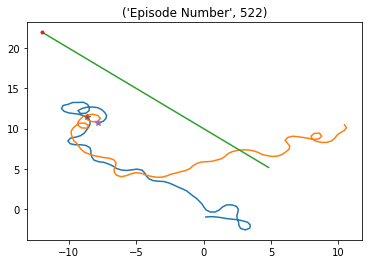

Episode * 523 * Avg Reward is ==> 3118.6680988576163 : Ag1 Reward ==> 1840.401167696164 : Ag2 Reward ==> 1854.6880234953815 


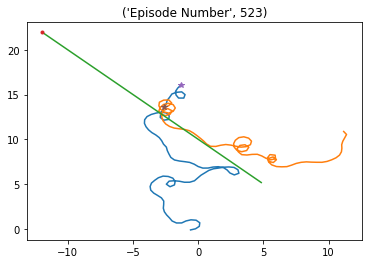

Episode * 524 * Avg Reward is ==> 3127.5818854378476 : Ag1 Reward ==> 1883.6209976456314 : Ag2 Reward ==> 1907.3967374163672 


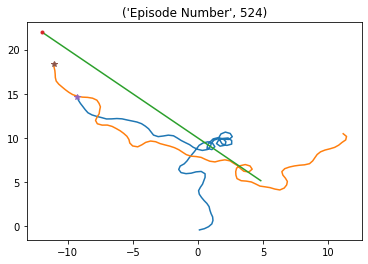

Episode * 525 * Avg Reward is ==> 3114.593756928973 : Ag1 Reward ==> 1258.6651642951454 : Ag2 Reward ==> 1350.2053258582093 


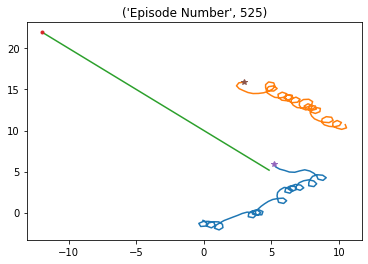

Episode * 526 * Avg Reward is ==> 3131.2854390078614 : Ag1 Reward ==> 1836.118447209423 : Ag2 Reward ==> 1832.8013662654128 


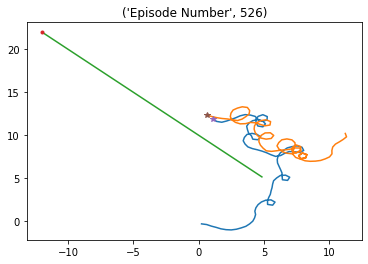

Episode * 527 * Avg Reward is ==> 3164.4759053910425 : Ag1 Reward ==> 1828.2225153633742 : Ag2 Reward ==> 1667.6670449457424 


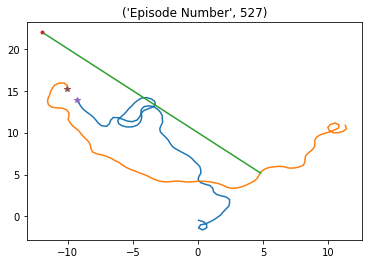

Episode * 528 * Avg Reward is ==> 3160.643292521858 : Ag1 Reward ==> 1561.7604592442506 : Ag2 Reward ==> 1566.1232045454212 


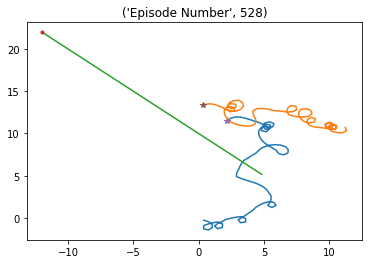

Episode * 529 * Avg Reward is ==> 3156.9208427889125 : Ag1 Reward ==> 1562.688038882978 : Ag2 Reward ==> 1265.9078426919293 


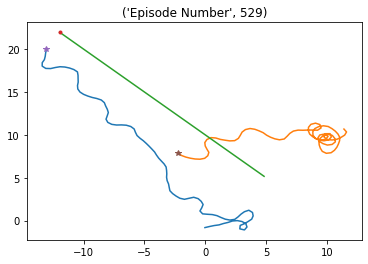

Episode * 530 * Avg Reward is ==> 3136.37568866994 : Ag1 Reward ==> 1475.1861760073755 : Ag2 Reward ==> 1146.175215476026 


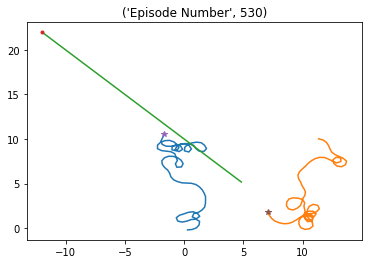

Episode * 531 * Avg Reward is ==> 3125.574060723219 : Ag1 Reward ==> 1500.5470706956805 : Ag2 Reward ==> 1597.50958958704 


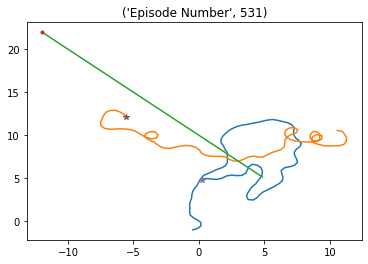

Episode * 532 * Avg Reward is ==> 3109.2568296664112 : Ag1 Reward ==> 1472.2663955978398 : Ag2 Reward ==> 1373.2390085510249 


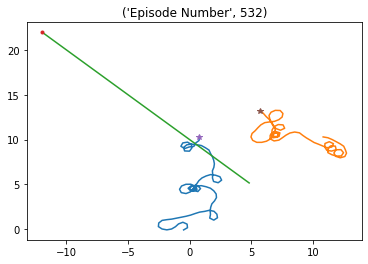

Episode * 533 * Avg Reward is ==> 3100.683918961433 : Ag1 Reward ==> 1453.3050705559938 : Ag2 Reward ==> 1449.4115206617505 


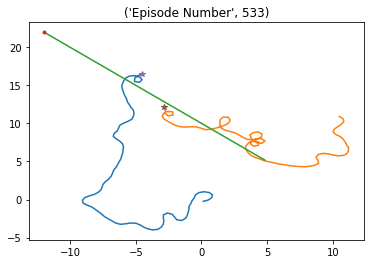

Episode * 534 * Avg Reward is ==> 3094.7023557449475 : Ag1 Reward ==> 1565.5545070644007 : Ag2 Reward ==> 1524.5994674926058 


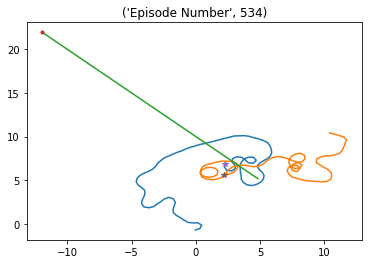

Episode * 535 * Avg Reward is ==> 3088.5904694397104 : Ag1 Reward ==> 1564.8539119204668 : Ag2 Reward ==> 1450.6313666328315 


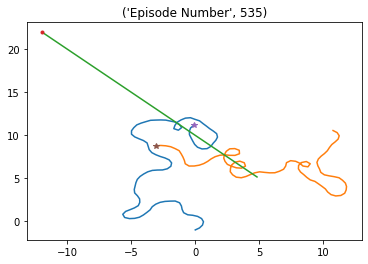

Episode * 536 * Avg Reward is ==> 3091.855651535364 : Ag1 Reward ==> 1830.9871114765908 : Ag2 Reward ==> 1741.8085798049929 


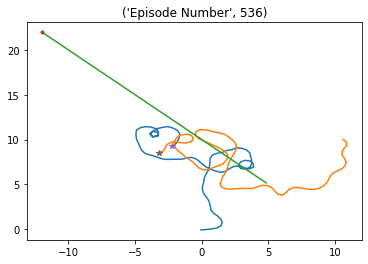

Episode * 537 * Avg Reward is ==> 3096.9555175740816 : Ag1 Reward ==> 1545.5828089785039 : Ag2 Reward ==> 1545.090471805725 


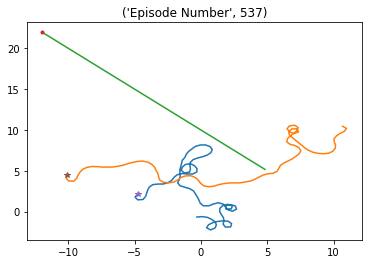

Episode * 538 * Avg Reward is ==> 3078.779784794079 : Ag1 Reward ==> 1414.801780017624 : Ag2 Reward ==> 1139.3543962140614 


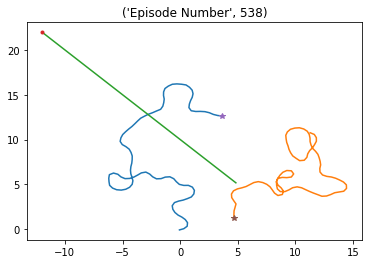

Episode * 539 * Avg Reward is ==> 3072.3616635919743 : Ag1 Reward ==> 1554.9753360134944 : Ag2 Reward ==> 1464.3864760057672 


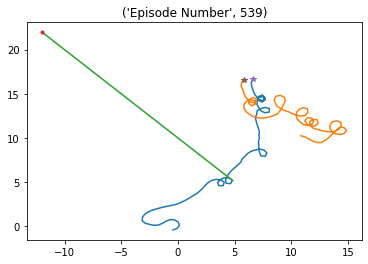

Episode * 540 * Avg Reward is ==> 3066.590289649706 : Ag1 Reward ==> 1527.4513735209853 : Ag2 Reward ==> 1495.4443071079847 


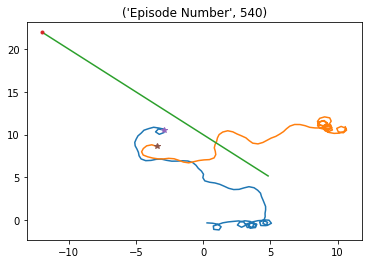

Episode * 541 * Avg Reward is ==> 3077.836785232529 : Ag1 Reward ==> 1303.3038670566402 : Ag2 Reward ==> 1329.679034221904 


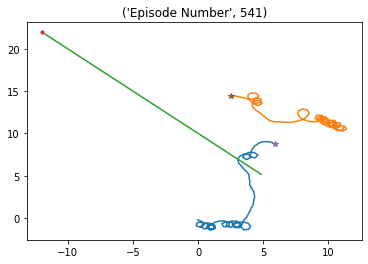

Episode * 542 * Avg Reward is ==> 3083.742350116097 : Ag1 Reward ==> 1709.4331680149755 : Ag2 Reward ==> 1610.2686971372443 


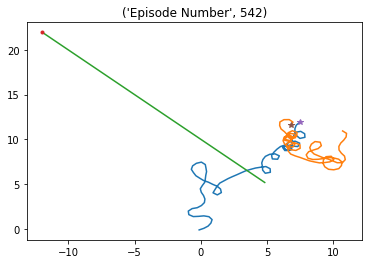

Episode * 543 * Avg Reward is ==> 3090.6492517072465 : Ag1 Reward ==> 1655.1905231479586 : Ag2 Reward ==> 1548.3024087659333 


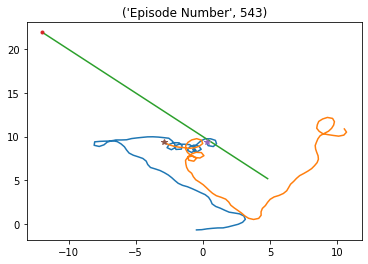

Episode * 544 * Avg Reward is ==> 3099.1138676456203 : Ag1 Reward ==> 1606.732059587576 : Ag2 Reward ==> 1553.8381854337547 


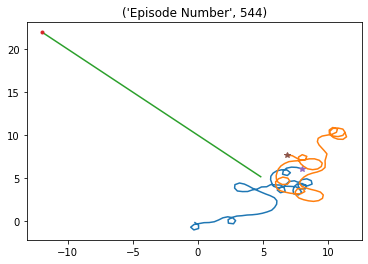

Episode * 545 * Avg Reward is ==> 3094.4827427340424 : Ag1 Reward ==> 1343.5902875978368 : Ag2 Reward ==> 1159.2132356151187 


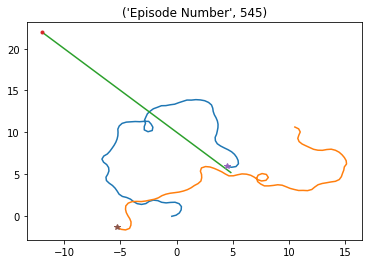

Episode * 546 * Avg Reward is ==> 3104.42268116981 : Ag1 Reward ==> 1747.1109025706503 : Ag2 Reward ==> 1617.978080892447 


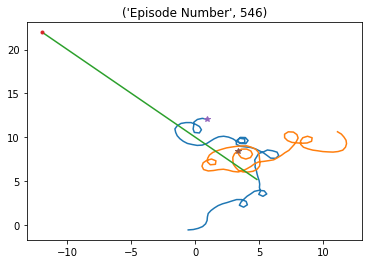

Episode * 547 * Avg Reward is ==> 3121.961467687276 : Ag1 Reward ==> 1886.0498988787965 : Ag2 Reward ==> 1754.505174758189 


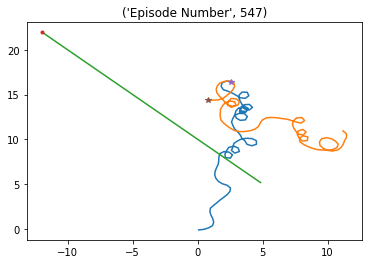

Episode * 548 * Avg Reward is ==> 3121.15310722804 : Ag1 Reward ==> 1370.8728015544948 : Ag2 Reward ==> 1376.6867001491612 


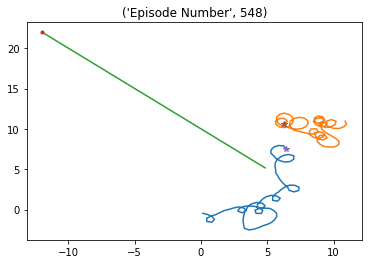

Episode * 549 * Avg Reward is ==> 3120.6919361497385 : Ag1 Reward ==> 1345.410887439095 : Ag2 Reward ==> 1399.3131370319995 


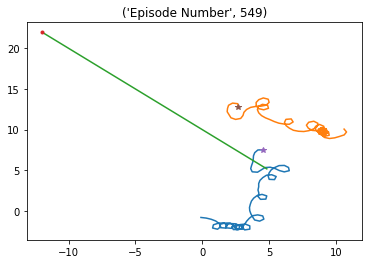

Episode * 550 * Avg Reward is ==> 3125.784436336923 : Ag1 Reward ==> 1601.2897951534724 : Ag2 Reward ==> 1688.6099044518612 


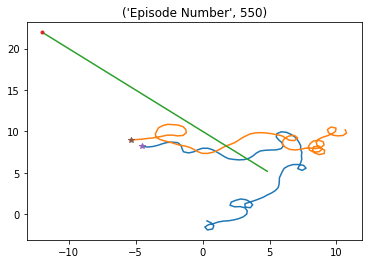

Episode * 551 * Avg Reward is ==> 3105.401036142607 : Ag1 Reward ==> 1459.444413576455 : Ag2 Reward ==> 1246.444008094059 


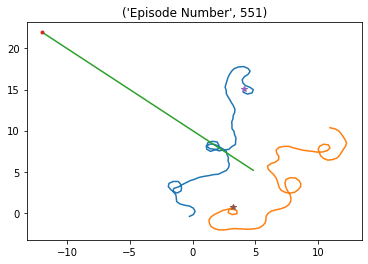

Episode * 552 * Avg Reward is ==> 3089.5918106745225 : Ag1 Reward ==> 1399.7204083227637 : Ag2 Reward ==> 1361.3376819622495 


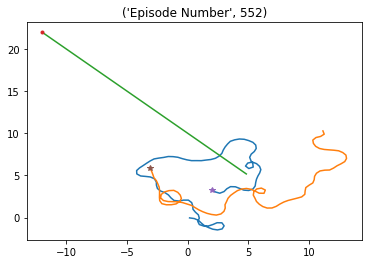

Episode * 553 * Avg Reward is ==> 3083.548562456583 : Ag1 Reward ==> 1511.4937059699485 : Ag2 Reward ==> 1310.4215162389921 


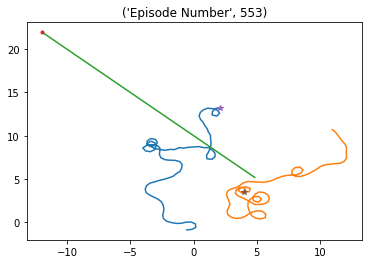

Episode * 554 * Avg Reward is ==> 3072.7256334707026 : Ag1 Reward ==> 1263.0511690037436 : Ag2 Reward ==> 1310.7763542962255 


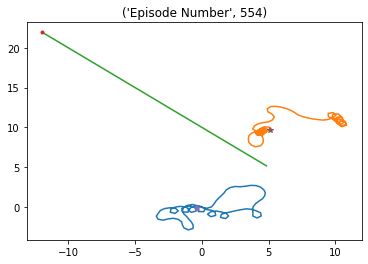

Episode * 555 * Avg Reward is ==> 3078.794374673628 : Ag1 Reward ==> 1725.4115596896547 : Ag2 Reward ==> 1708.5503786367524 


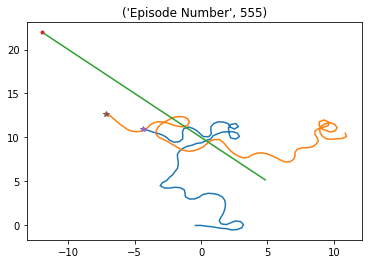

Episode * 556 * Avg Reward is ==> 3082.554474805275 : Ag1 Reward ==> 1846.035437741673 : Ag2 Reward ==> 1841.5412435116473 


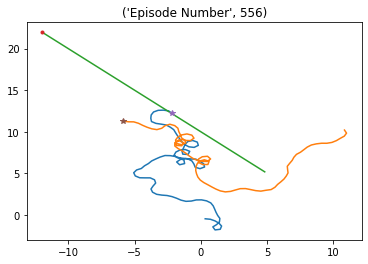

Episode * 557 * Avg Reward is ==> 3082.6676476054395 : Ag1 Reward ==> 1723.987851088888 : Ag2 Reward ==> 1709.7423954541705 


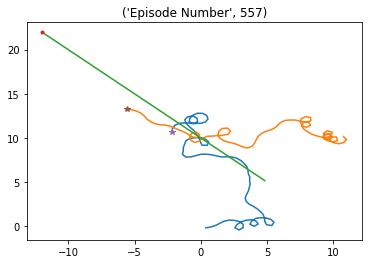

Episode * 558 * Avg Reward is ==> 3105.4902551994846 : Ag1 Reward ==> 1897.3612632261734 : Ag2 Reward ==> 1849.3709618548075 


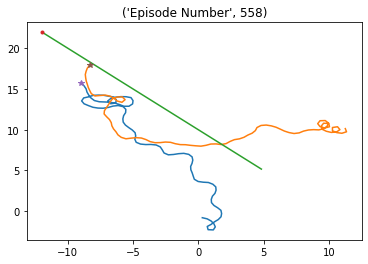

Episode * 559 * Avg Reward is ==> 3106.15339396521 : Ag1 Reward ==> 1633.9942614183708 : Ag2 Reward ==> 1617.871087211008 


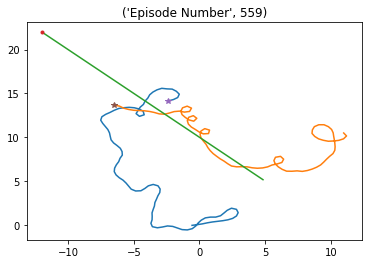

Episode * 560 * Avg Reward is ==> 3103.9492904687613 : Ag1 Reward ==> 1587.9307399041168 : Ag2 Reward ==> 1656.7610494877113 


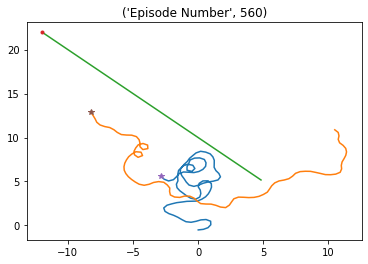

Episode * 561 * Avg Reward is ==> 3129.6916455460846 : Ag1 Reward ==> 1691.598401250817 : Ag2 Reward ==> 1714.4501233283736 


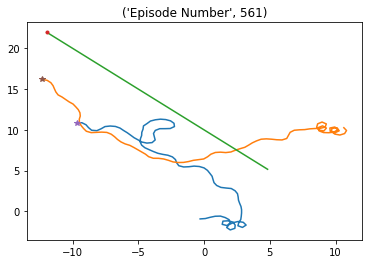

Episode * 562 * Avg Reward is ==> 3134.181249571925 : Ag1 Reward ==> 1739.8095386690607 : Ag2 Reward ==> 1903.337406735999 


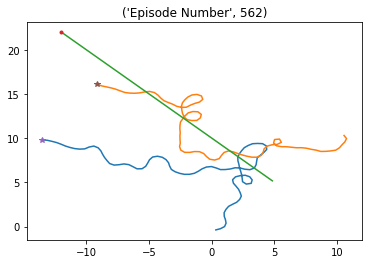

Episode * 563 * Avg Reward is ==> 3134.8057295369954 : Ag1 Reward ==> 1810.4878544358041 : Ag2 Reward ==> 1909.5805353585872 


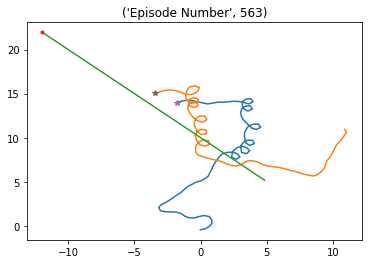

Episode * 564 * Avg Reward is ==> 3121.911819971758 : Ag1 Reward ==> 1632.1921857315779 : Ag2 Reward ==> 1643.069166720909 


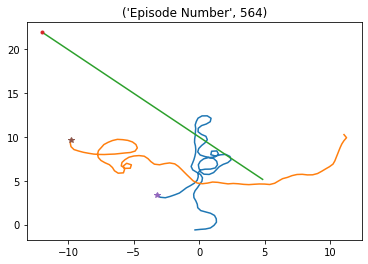

Episode * 565 * Avg Reward is ==> 3141.556715577062 : Ag1 Reward ==> 1657.912598117009 : Ag2 Reward ==> 1736.7537162485191 


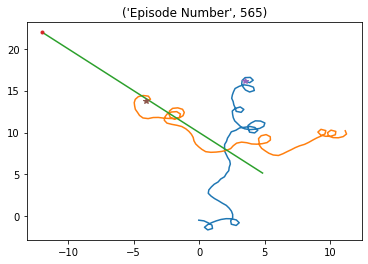

Episode * 566 * Avg Reward is ==> 3128.4054024935967 : Ag1 Reward ==> 1540.4873842773077 : Ag2 Reward ==> 1602.379905858913 


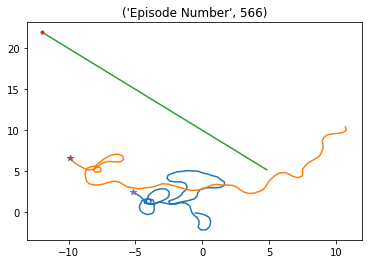

Episode * 567 * Avg Reward is ==> 3126.606160955774 : Ag1 Reward ==> 1642.1720663705826 : Ag2 Reward ==> 1781.7478324256317 


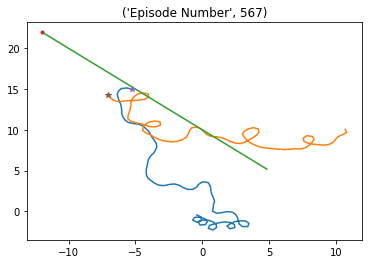

Episode * 568 * Avg Reward is ==> 3119.6096197295237 : Ag1 Reward ==> 1565.5045700931325 : Ag2 Reward ==> 1282.5174446465107 


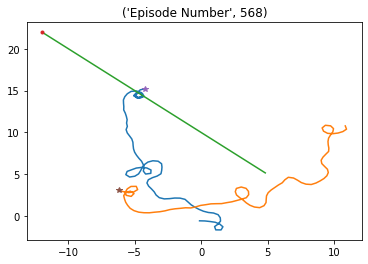

Episode * 569 * Avg Reward is ==> 3127.1986721816534 : Ag1 Reward ==> 1614.0720669376876 : Ag2 Reward ==> 1518.085912722427 


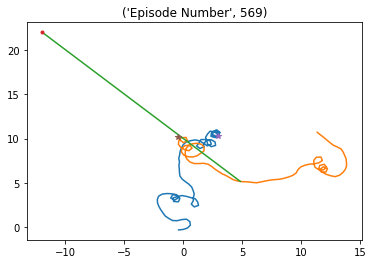

Episode * 570 * Avg Reward is ==> 3143.4165197494744 : Ag1 Reward ==> 1607.6180549026246 : Ag2 Reward ==> 1662.4572392936188 


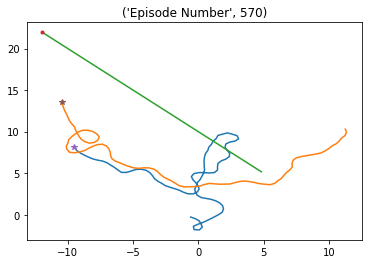

Episode * 571 * Avg Reward is ==> 3143.7057955370124 : Ag1 Reward ==> 1538.7017029563972 : Ag2 Reward ==> 1570.9259888278496 


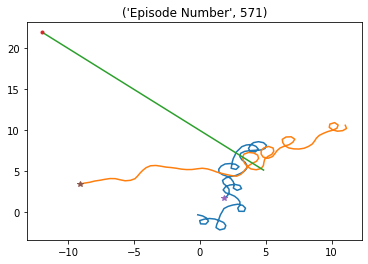

Episode * 572 * Avg Reward is ==> 3133.2063657536464 : Ag1 Reward ==> 1287.255181833928 : Ag2 Reward ==> 1138.2730309802732 


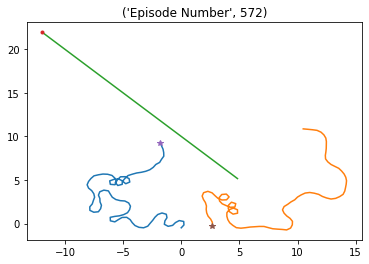

Episode * 573 * Avg Reward is ==> 3133.879321925173 : Ag1 Reward ==> 1455.8008217134602 : Ag2 Reward ==> 1473.8340163653572 


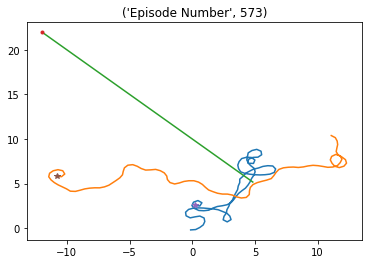

Episode * 574 * Avg Reward is ==> 3134.593876401685 : Ag1 Reward ==> 1558.8257819459643 : Ag2 Reward ==> 1559.9103716715215 


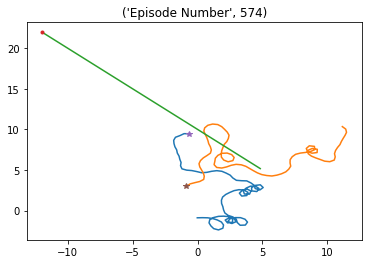

Episode * 575 * Avg Reward is ==> 3134.990514271594 : Ag1 Reward ==> 1561.4845440140482 : Ag2 Reward ==> 1469.866249335607 


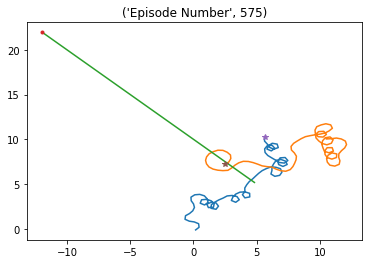

Episode * 576 * Avg Reward is ==> 3122.2584732040305 : Ag1 Reward ==> 1587.8150844938555 : Ag2 Reward ==> 1475.6989640852003 


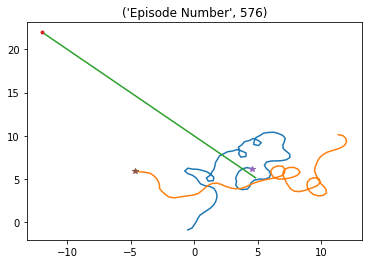

Episode * 577 * Avg Reward is ==> 3140.885439787223 : Ag1 Reward ==> 1913.7754103460302 : Ag2 Reward ==> 1921.976533765883 


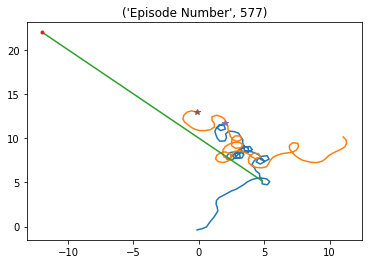

Episode * 578 * Avg Reward is ==> 3150.261633365336 : Ag1 Reward ==> 1453.2386126700296 : Ag2 Reward ==> 1475.9653066861767 


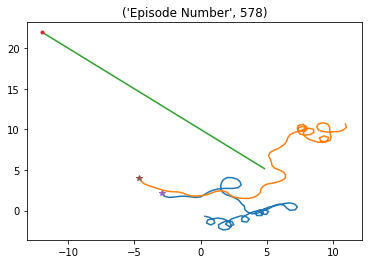

Episode * 579 * Avg Reward is ==> 3165.844137512662 : Ag1 Reward ==> 1780.3507002898896 : Ag2 Reward ==> 1862.3112776224255 


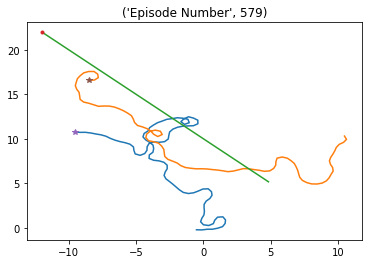

Episode * 580 * Avg Reward is ==> 3172.3339082742787 : Ag1 Reward ==> 1640.2185073538635 : Ag2 Reward ==> 1642.2680037397815 


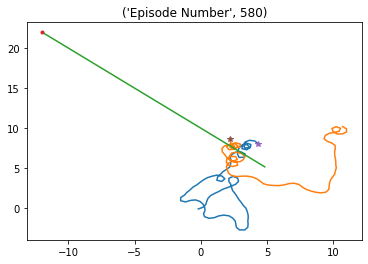

Episode * 581 * Avg Reward is ==> 3174.6553308923567 : Ag1 Reward ==> 1416.8720434986851 : Ag2 Reward ==> 1308.9677625029606 


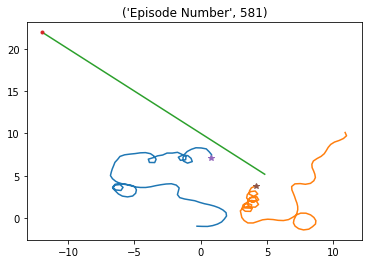

Episode * 582 * Avg Reward is ==> 3157.8658167218086 : Ag1 Reward ==> 1329.4037488017707 : Ag2 Reward ==> 1318.7175495285398 


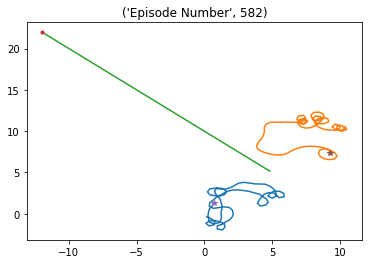

Episode * 583 * Avg Reward is ==> 3169.1552828393733 : Ag1 Reward ==> 1818.771823389293 : Ag2 Reward ==> 1836.2997532271777 


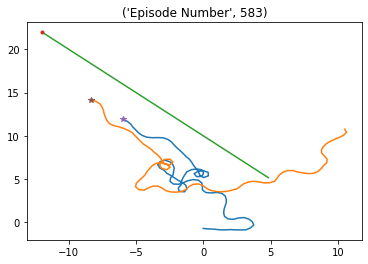

Episode * 584 * Avg Reward is ==> 3178.167725513326 : Ag1 Reward ==> 1724.4231035432888 : Ag2 Reward ==> 1796.644848436157 


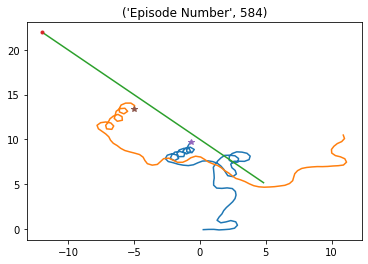

Episode * 585 * Avg Reward is ==> 3195.734560089255 : Ag1 Reward ==> 1503.1214717142836 : Ag2 Reward ==> 1702.355434535826 


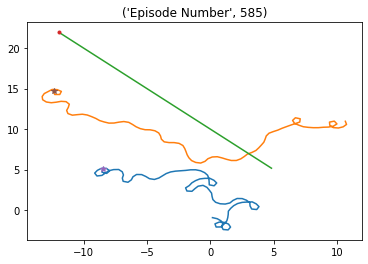

Episode * 586 * Avg Reward is ==> 3199.6542725955906 : Ag1 Reward ==> 1693.3032903130318 : Ag2 Reward ==> 1828.5741934034813 


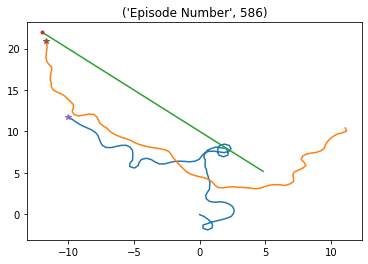

Episode * 587 * Avg Reward is ==> 3194.0887686091237 : Ag1 Reward ==> 1702.0675344317822 : Ag2 Reward ==> 1715.8673797465583 


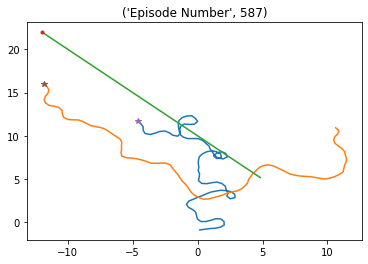

Episode * 588 * Avg Reward is ==> 3212.637099094326 : Ag1 Reward ==> 1801.9090870676082 : Ag2 Reward ==> 1687.583634044125 


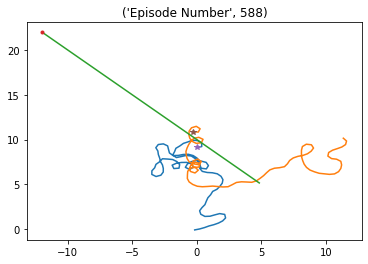

Episode * 589 * Avg Reward is ==> 3228.117194818271 : Ag1 Reward ==> 1605.4987841742159 : Ag2 Reward ==> 1758.4290692546822 


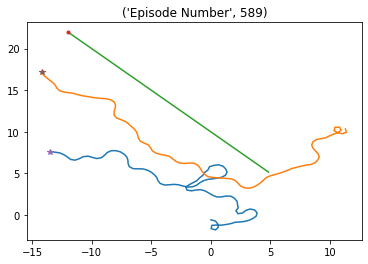

Episode * 590 * Avg Reward is ==> 3233.129616678563 : Ag1 Reward ==> 1734.6210406502264 : Ag2 Reward ==> 1755.7755333667835 


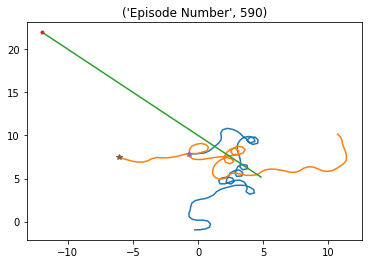

Episode * 591 * Avg Reward is ==> 3240.114698697824 : Ag1 Reward ==> 1414.9966328464177 : Ag2 Reward ==> 1570.2950695945435 


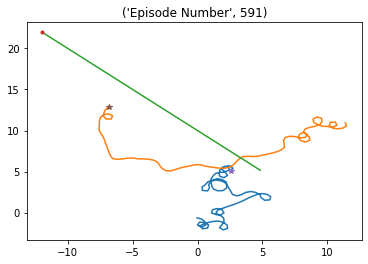

Episode * 592 * Avg Reward is ==> 3249.2540458191775 : Ag1 Reward ==> 1518.337964713096 : Ag2 Reward ==> 1608.294010426056 


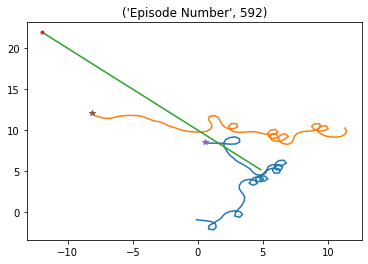

Episode * 593 * Avg Reward is ==> 3242.3988464126605 : Ag1 Reward ==> 1180.8104914808512 : Ag2 Reward ==> 1366.8967544674128 


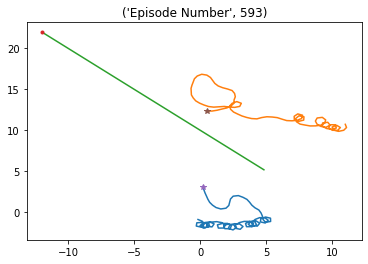

Episode * 594 * Avg Reward is ==> 3257.997556745025 : Ag1 Reward ==> 1585.832048001701 : Ag2 Reward ==> 1611.9438885928637 


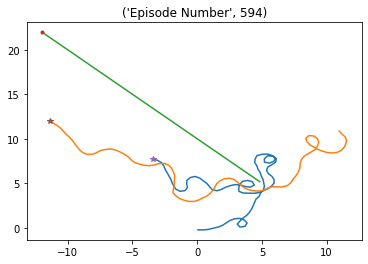

Episode * 595 * Avg Reward is ==> 3248.525104746549 : Ag1 Reward ==> 1493.0609130699281 : Ag2 Reward ==> 1562.0029453174263 


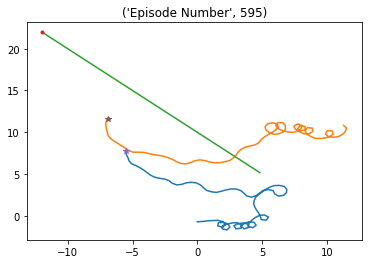

Episode * 596 * Avg Reward is ==> 3232.337347840794 : Ag1 Reward ==> 1543.0526026185805 : Ag2 Reward ==> 1497.0138024045334 


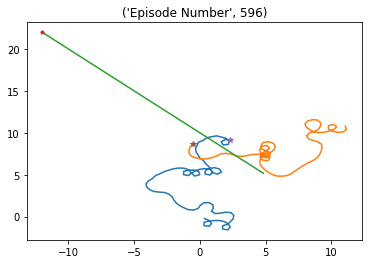

Episode * 597 * Avg Reward is ==> 3221.880055081607 : Ag1 Reward ==> 1454.8092442117659 : Ag2 Reward ==> 1560.6292919638258 


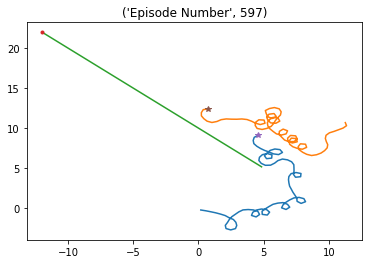

Episode * 598 * Avg Reward is ==> 3211.2672197373195 : Ag1 Reward ==> 1668.880899341642 : Ag2 Reward ==> 1653.3379119678261 


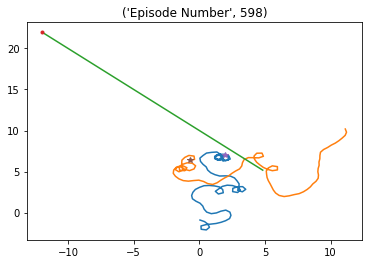

Episode * 599 * Avg Reward is ==> 3211.3460959705044 : Ag1 Reward ==> 1575.720061778711 : Ag2 Reward ==> 1679.3003361780573 


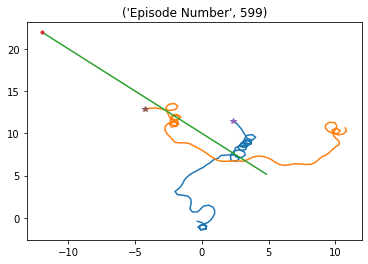

Episode * 600 * Avg Reward is ==> 3216.1191752421737 : Ag1 Reward ==> 1734.5451364125242 : Ag2 Reward ==> 1701.0698238460902 


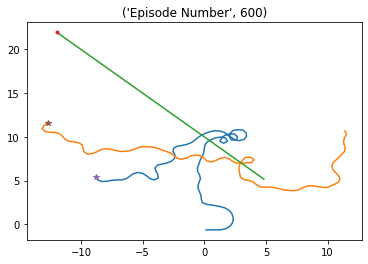

Episode * 601 * Avg Reward is ==> 3197.4711246479906 : Ag1 Reward ==> 1314.6326081025168 : Ag2 Reward ==> 1345.4938927093544 


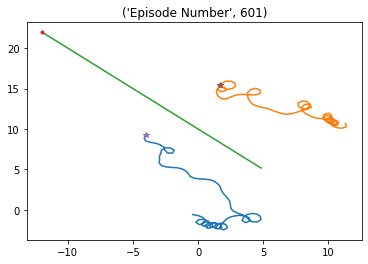

Episode * 602 * Avg Reward is ==> 3190.4321909618957 : Ag1 Reward ==> 1625.3191078004324 : Ag2 Reward ==> 1736.270490160815 


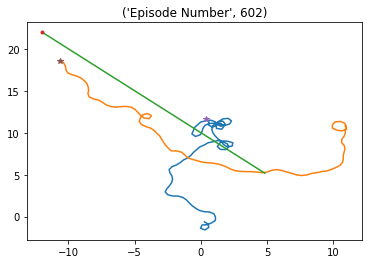

Episode * 603 * Avg Reward is ==> 3180.045133236092 : Ag1 Reward ==> 1604.3181098556536 : Ag2 Reward ==> 1700.2679709066128 


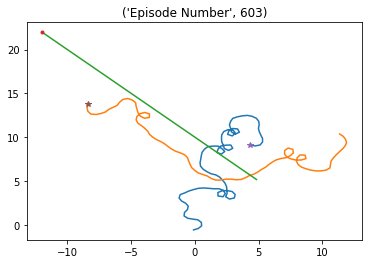

Episode * 604 * Avg Reward is ==> 3187.6742418655613 : Ag1 Reward ==> 1787.9883671376635 : Ag2 Reward ==> 1792.4373304935814 


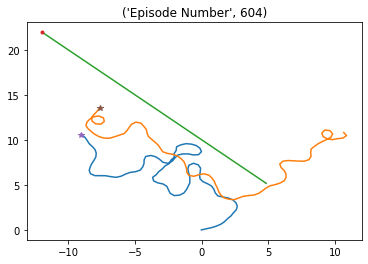

Episode * 605 * Avg Reward is ==> 3184.753155339973 : Ag1 Reward ==> 1572.600602038999 : Ag2 Reward ==> 1705.2222513029958 


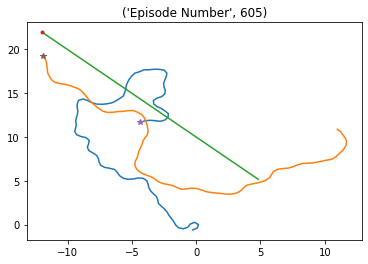

Episode * 606 * Avg Reward is ==> 3185.463686089696 : Ag1 Reward ==> 1500.295975658361 : Ag2 Reward ==> 1670.9925444667722 


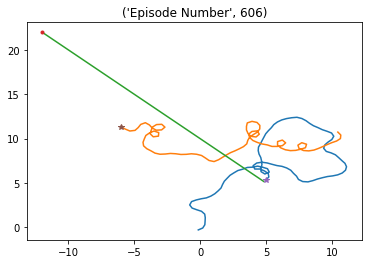

Episode * 607 * Avg Reward is ==> 3170.702257747552 : Ag1 Reward ==> 1335.5321906169768 : Ag2 Reward ==> 1497.9305744934773 


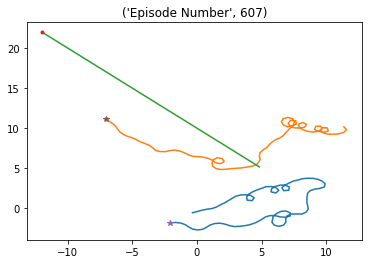

Episode * 608 * Avg Reward is ==> 3186.5880860546667 : Ag1 Reward ==> 1746.3653819457495 : Ag2 Reward ==> 1737.0897650785073 


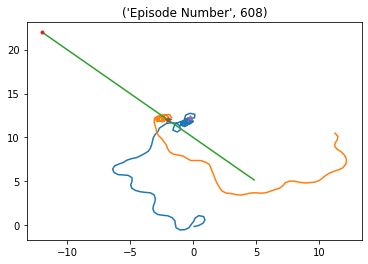

Episode * 609 * Avg Reward is ==> 3179.6862586537186 : Ag1 Reward ==> 1423.7315034870396 : Ag2 Reward ==> 1432.3533801351361 


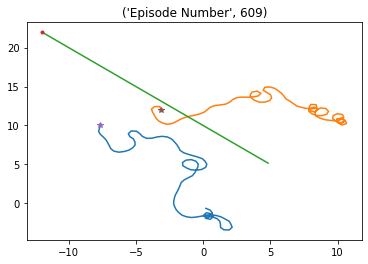

Episode * 610 * Avg Reward is ==> 3187.5978847747842 : Ag1 Reward ==> 1786.4668713272797 : Ag2 Reward ==> 1800.0734677115954 


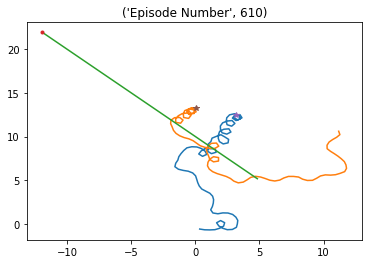

Episode * 611 * Avg Reward is ==> 3188.959300826343 : Ag1 Reward ==> 1485.548511717585 : Ag2 Reward ==> 1678.5358221290082 


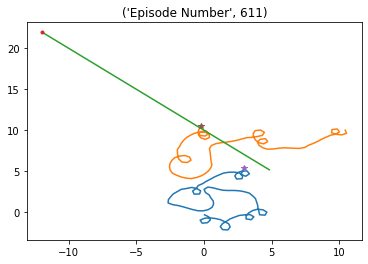

Episode * 612 * Avg Reward is ==> 3214.9584092209343 : Ag1 Reward ==> 1738.2248714722932 : Ag2 Reward ==> 1727.2676771255299 


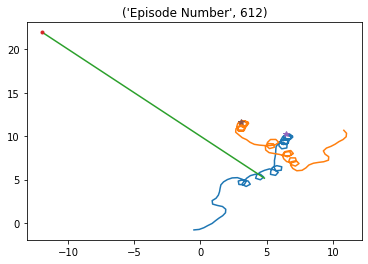

Episode * 613 * Avg Reward is ==> 3200.3482573217984 : Ag1 Reward ==> 1185.1965770740292 : Ag2 Reward ==> 1160.0321850393748 


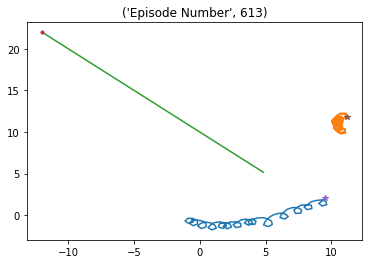

Episode * 614 * Avg Reward is ==> 3210.7656147659236 : Ag1 Reward ==> 1718.936492401009 : Ag2 Reward ==> 1816.4939589814828 


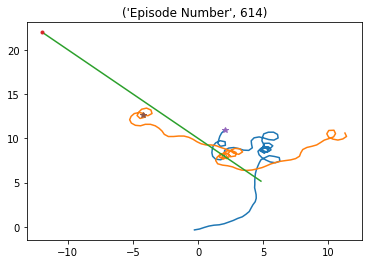

Episode * 615 * Avg Reward is ==> 3218.555856991091 : Ag1 Reward ==> 1682.517617133813 : Ag2 Reward ==> 1660.4428652225326 


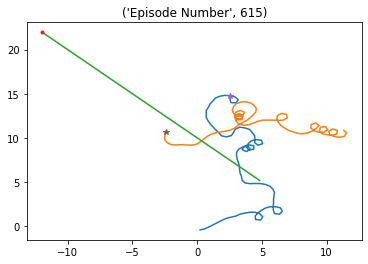

Episode * 616 * Avg Reward is ==> 3216.741969761907 : Ag1 Reward ==> 1509.159204182052 : Ag2 Reward ==> 1481.7993552296432 


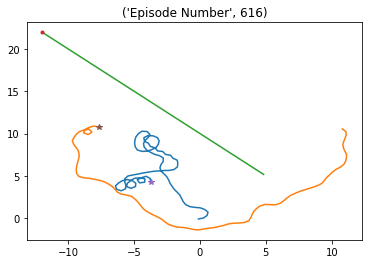

Episode * 617 * Avg Reward is ==> 3211.0078796756984 : Ag1 Reward ==> 1765.5347085373771 : Ag2 Reward ==> 1840.8536321262102 


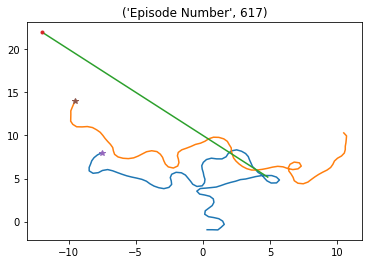

Episode * 618 * Avg Reward is ==> 3218.1291482523784 : Ag1 Reward ==> 1642.8132480139984 : Ag2 Reward ==> 1571.2414144093855 


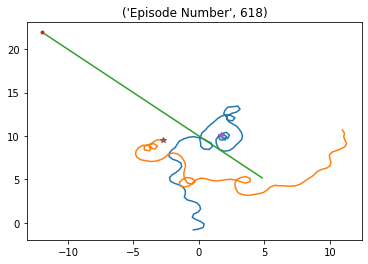

Episode * 619 * Avg Reward is ==> 3213.6447247748592 : Ag1 Reward ==> 1761.958874215869 : Ag2 Reward ==> 1701.3261645956932 


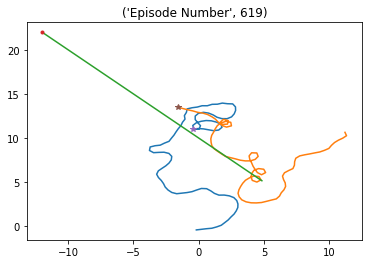

Episode * 620 * Avg Reward is ==> 3209.092674942543 : Ag1 Reward ==> 1604.7170080232854 : Ag2 Reward ==> 1495.6875097777254 


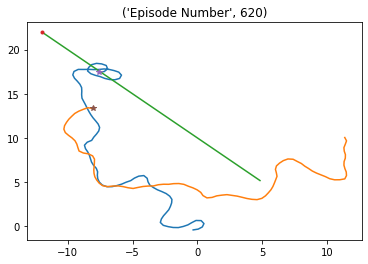

Episode * 621 * Avg Reward is ==> 3203.107949739765 : Ag1 Reward ==> 1216.4002656929174 : Ag2 Reward ==> 1270.0505321976052 


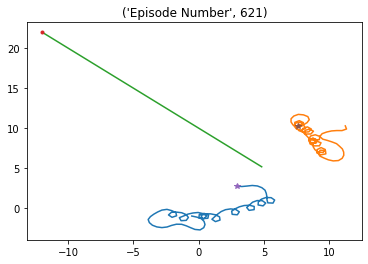

Episode * 622 * Avg Reward is ==> 3235.7901706844464 : Ag1 Reward ==> 1944.147081139569 : Ag2 Reward ==> 2011.2630549779835 


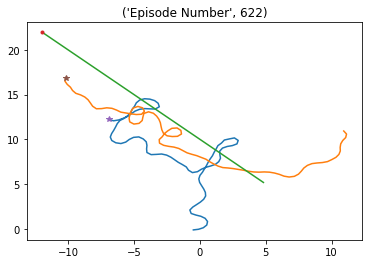

Episode * 623 * Avg Reward is ==> 3221.224992004006 : Ag1 Reward ==> 1550.6367747151996 : Ag2 Reward ==> 1521.827654683638 


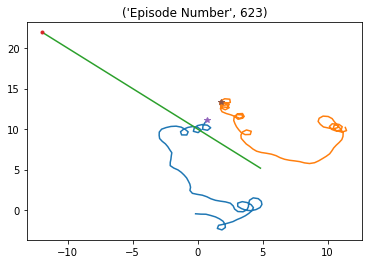

Episode * 624 * Avg Reward is ==> 3213.012734962877 : Ag1 Reward ==> 1620.1761333429906 : Ag2 Reward ==> 1572.4015369913195 


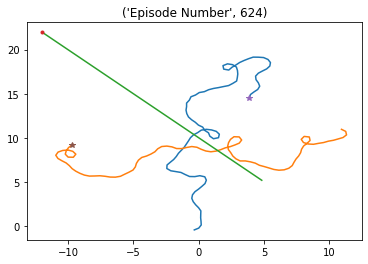

Episode * 625 * Avg Reward is ==> 3234.7458790040255 : Ag1 Reward ==> 2046.571005454846 : Ag2 Reward ==> 2028.2316624412044 


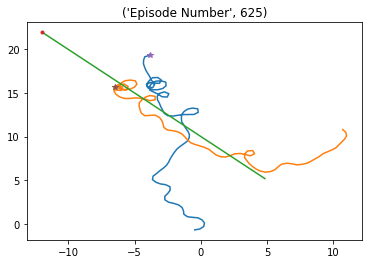

Episode * 626 * Avg Reward is ==> 3219.907020870982 : Ag1 Reward ==> 1391.3647587976084 : Ag2 Reward ==> 1536.9583995971568 


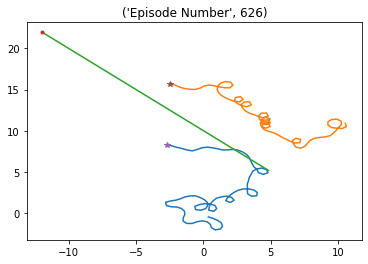

Episode * 627 * Avg Reward is ==> 3231.0914579786577 : Ag1 Reward ==> 1924.0628087575767 : Ag2 Reward ==> 1941.2495897277977 


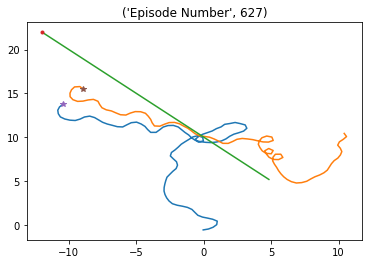

Episode * 628 * Avg Reward is ==> 3218.760810392135 : Ag1 Reward ==> 1493.0224482297986 : Ag2 Reward ==> 1503.2443694210285 


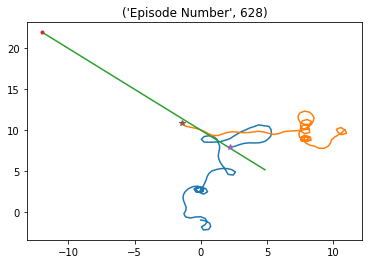

Episode * 629 * Avg Reward is ==> 3224.615417054891 : Ag1 Reward ==> 1702.7342308664327 : Ag2 Reward ==> 1895.3778890727008 


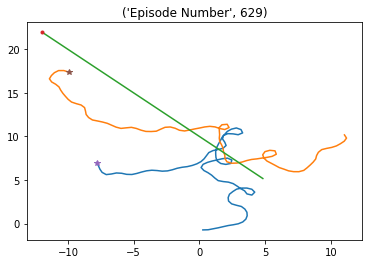

Episode * 630 * Avg Reward is ==> 3219.1613823620646 : Ag1 Reward ==> 1650.944372438141 : Ag2 Reward ==> 1621.2908138658152 


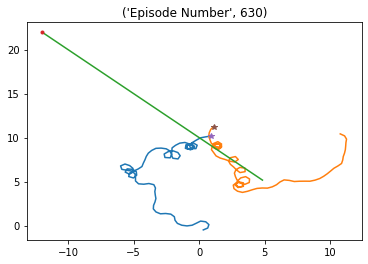

Episode * 631 * Avg Reward is ==> 3235.582500913119 : Ag1 Reward ==> 1800.3384493170638 : Ag2 Reward ==> 1841.7979951660661 


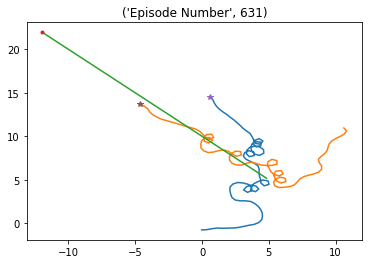

Episode * 632 * Avg Reward is ==> 3251.5529443050414 : Ag1 Reward ==> 1834.6746120561486 : Ag2 Reward ==> 1930.7750987599068 


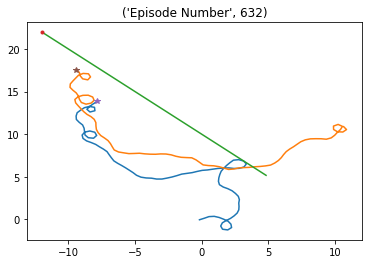

Episode * 633 * Avg Reward is ==> 3281.2492440312317 : Ag1 Reward ==> 1861.2926109061611 : Ag2 Reward ==> 1874.266624089722 


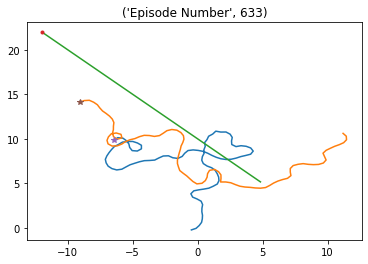

Episode * 634 * Avg Reward is ==> 3284.8098512140446 : Ag1 Reward ==> 1655.4123068461072 : Ag2 Reward ==> 1684.7879170609444 


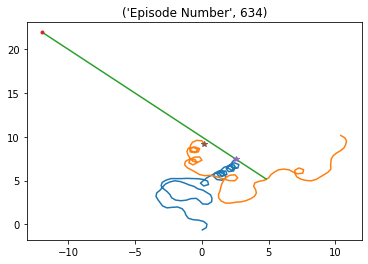

Episode * 635 * Avg Reward is ==> 3289.375815427628 : Ag1 Reward ==> 1586.9299079677874 : Ag2 Reward ==> 1650.7725189629214 


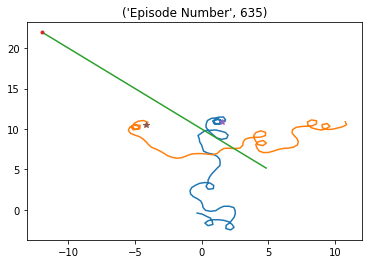

Episode * 636 * Avg Reward is ==> 3294.678495828731 : Ag1 Reward ==> 1609.020596406198 : Ag2 Reward ==> 1643.1530246610287 


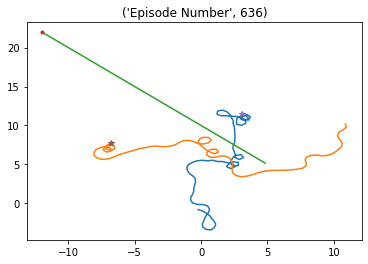

Episode * 637 * Avg Reward is ==> 3304.5073992321895 : Ag1 Reward ==> 1664.832315935233 : Ag2 Reward ==> 1743.762356378708 


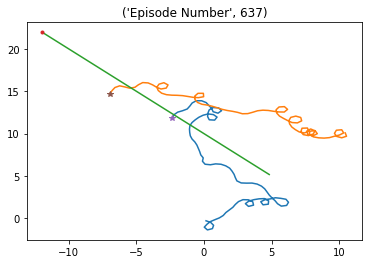

Episode * 638 * Avg Reward is ==> 3318.010066304231 : Ag1 Reward ==> 1931.2385889165814 : Ag2 Reward ==> 1931.0869052745375 


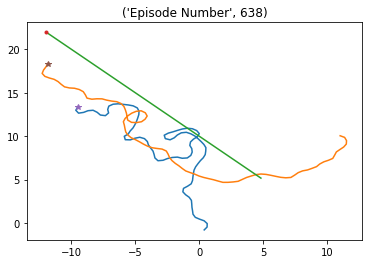

Episode * 639 * Avg Reward is ==> 3308.9438318243047 : Ag1 Reward ==> 1512.8453125336753 : Ag2 Reward ==> 1379.5257062260653 


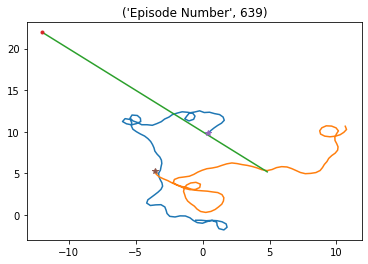

Episode * 640 * Avg Reward is ==> 3314.4889714950527 : Ag1 Reward ==> 1740.1913591966786 : Ag2 Reward ==> 1917.2291878918454 


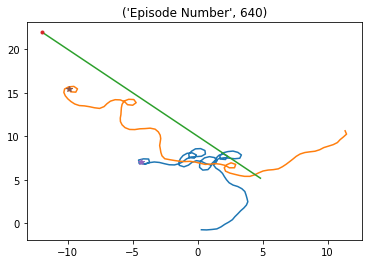

Episode * 641 * Avg Reward is ==> 3317.9611165397523 : Ag1 Reward ==> 1316.2603502889012 : Ag2 Reward ==> 1482.7519523109459 


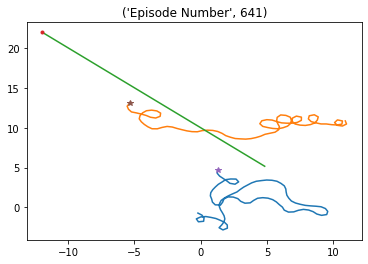

Episode * 642 * Avg Reward is ==> 3317.008599897713 : Ag1 Reward ==> 1713.2408568910264 : Ag2 Reward ==> 1610.2480753886343 


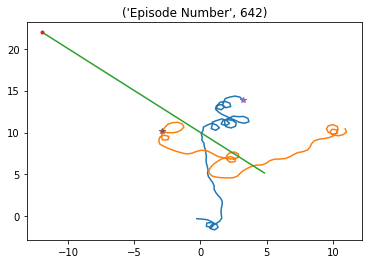

Episode * 643 * Avg Reward is ==> 3305.6489283409855 : Ag1 Reward ==> 1513.5984587435476 : Ag2 Reward ==> 1336.6007597496305 


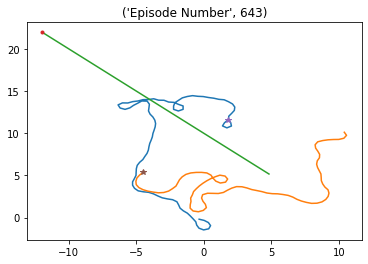

Episode * 644 * Avg Reward is ==> 3290.777040119764 : Ag1 Reward ==> 1459.7990017887082 : Ag2 Reward ==> 1525.7511669936807 


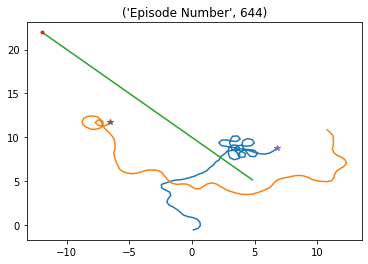

Episode * 645 * Avg Reward is ==> 3281.3960549091876 : Ag1 Reward ==> 1491.9439450256352 : Ag2 Reward ==> 1410.6394998933129 


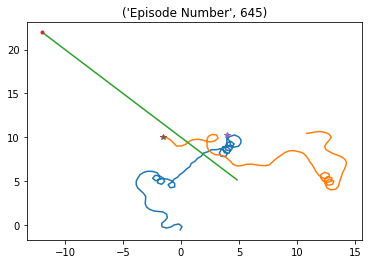

Episode * 646 * Avg Reward is ==> 3281.4281754950453 : Ag1 Reward ==> 1661.06433694334 : Ag2 Reward ==> 1511.5090066160851 


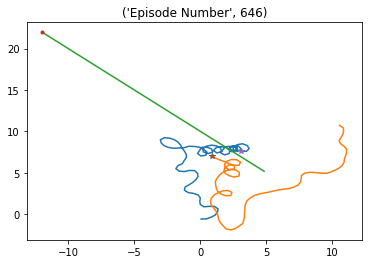

Episode * 647 * Avg Reward is ==> 3293.0993163695107 : Ag1 Reward ==> 1702.3291371280197 : Ag2 Reward ==> 1597.979262961031 


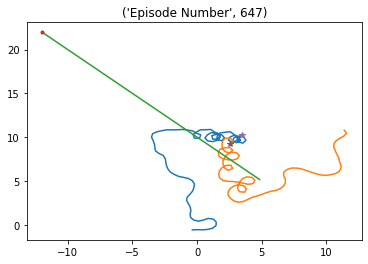

Episode * 648 * Avg Reward is ==> 3281.8314547677314 : Ag1 Reward ==> 1557.7660894441888 : Ag2 Reward ==> 1474.9745935089268 


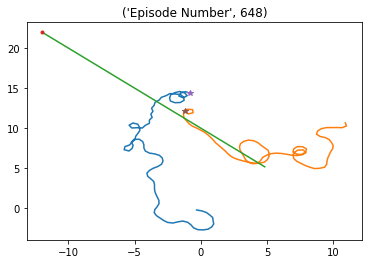

Episode * 649 * Avg Reward is ==> 3284.6856777693056 : Ag1 Reward ==> 1499.2069917467554 : Ag2 Reward ==> 1471.0468119383786 


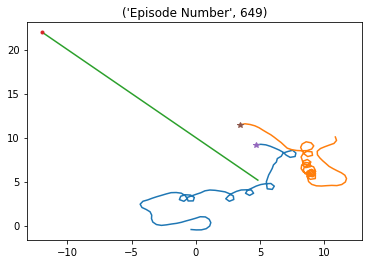

Episode * 650 * Avg Reward is ==> 3281.7834153369085 : Ag1 Reward ==> 1792.3413816678476 : Ag2 Reward ==> 1678.1084600751312 


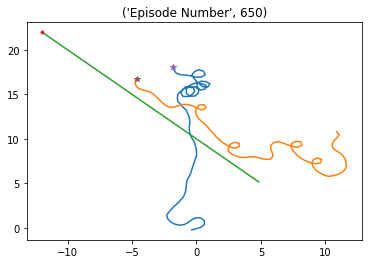

Episode * 651 * Avg Reward is ==> 3286.870339127557 : Ag1 Reward ==> 1661.1420978177105 : Ag2 Reward ==> 1706.419187654838 


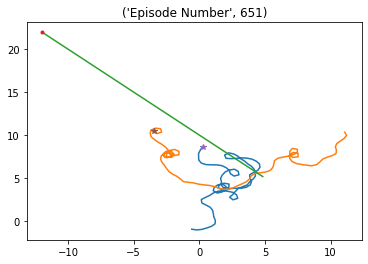

Episode * 652 * Avg Reward is ==> 3292.47715431071 : Ag1 Reward ==> 1815.391363305013 : Ag2 Reward ==> 1874.3737926189121 


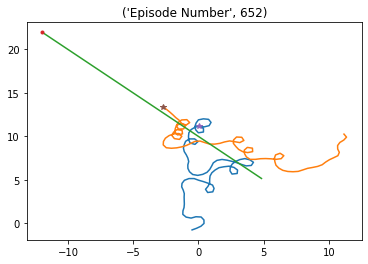

Episode * 653 * Avg Reward is ==> 3304.609413839485 : Ag1 Reward ==> 1463.2886762747837 : Ag2 Reward ==> 1367.2304669896434 


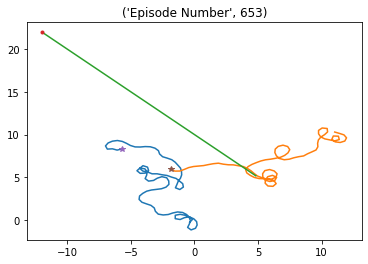

Episode * 654 * Avg Reward is ==> 3303.1543709011457 : Ag1 Reward ==> 1706.0359723632007 : Ag2 Reward ==> 1771.1927614857013 


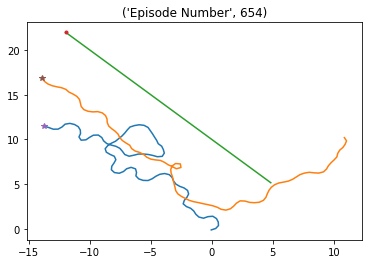

Episode * 655 * Avg Reward is ==> 3310.857704013875 : Ag1 Reward ==> 1809.0610398408487 : Ag2 Reward ==> 1842.0327670246704 


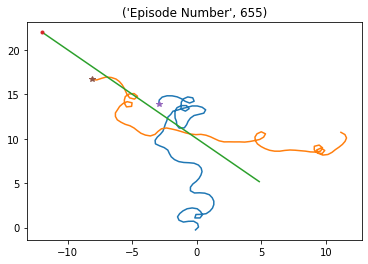

Episode * 656 * Avg Reward is ==> 3331.6086070814868 : Ag1 Reward ==> 1814.3954990801508 : Ag2 Reward ==> 2006.5991830360347 


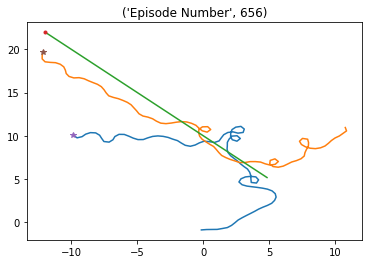

Episode * 657 * Avg Reward is ==> 3316.4605760490495 : Ag1 Reward ==> 1380.5782070998937 : Ag2 Reward ==> 1619.8888922661797 


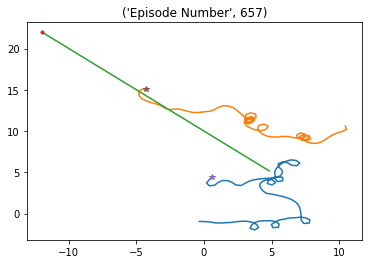

Episode * 658 * Avg Reward is ==> 3313.9016808335487 : Ag1 Reward ==> 1484.1147456991632 : Ag2 Reward ==> 1627.5841081042033 


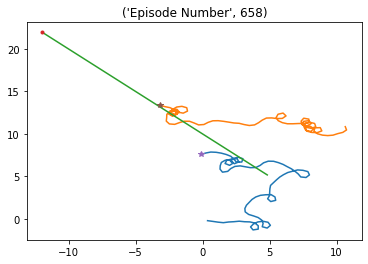

Episode * 659 * Avg Reward is ==> 3307.3056772184705 : Ag1 Reward ==> 1559.6448703942767 : Ag2 Reward ==> 1639.8000238141615 


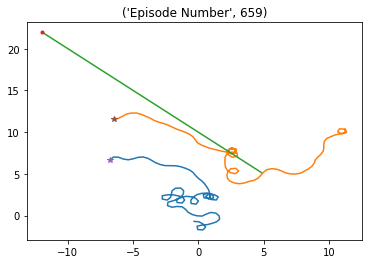

Episode * 660 * Avg Reward is ==> 3321.1201215404435 : Ag1 Reward ==> 1738.461351802939 : Ag2 Reward ==> 1914.520938876998 


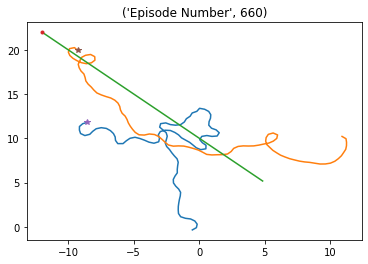

Episode * 661 * Avg Reward is ==> 3333.906385124837 : Ag1 Reward ==> 1442.2936319679184 : Ag2 Reward ==> 1555.6077092983205 


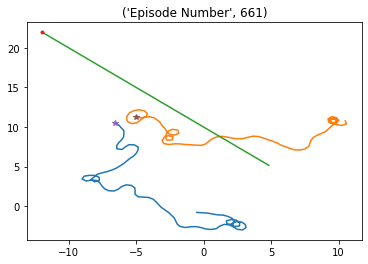

Episode * 662 * Avg Reward is ==> 3316.9790551819997 : Ag1 Reward ==> 1562.0897071289605 : Ag2 Reward ==> 1716.2272312750974 


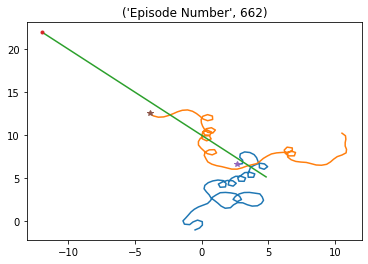

Episode * 663 * Avg Reward is ==> 3322.5013437899515 : Ag1 Reward ==> 1638.448344618011 : Ag2 Reward ==> 1654.9076290989221 


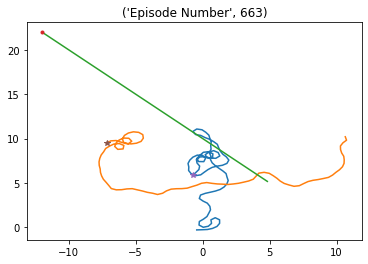

Episode * 664 * Avg Reward is ==> 3321.75581296358 : Ag1 Reward ==> 1551.1272790797539 : Ag2 Reward ==> 1611.629158199672 


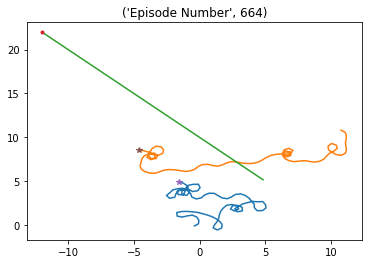

Episode * 665 * Avg Reward is ==> 3304.063349650146 : Ag1 Reward ==> 1685.103767409157 : Ag2 Reward ==> 1682.0003679495367 


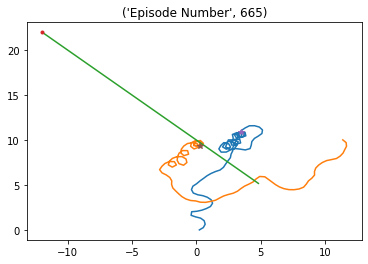

Episode * 666 * Avg Reward is ==> 3305.7605772278635 : Ag1 Reward ==> 1492.2741042126413 : Ag2 Reward ==> 1503.938157290845 


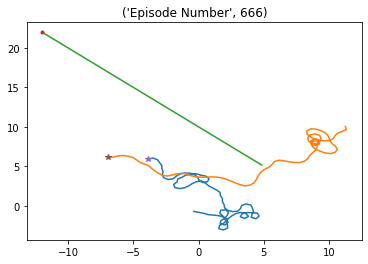

Episode * 667 * Avg Reward is ==> 3289.2469493217263 : Ag1 Reward ==> 1593.166046505644 : Ag2 Reward ==> 1611.6012357342283 


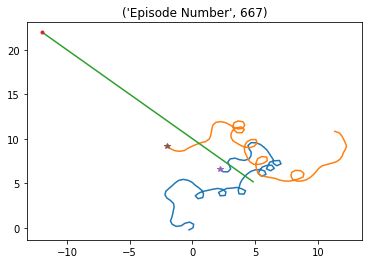

Episode * 668 * Avg Reward is ==> 3294.7431670910255 : Ag1 Reward ==> 1655.4634737152314 : Ag2 Reward ==> 1560.6520547075718 


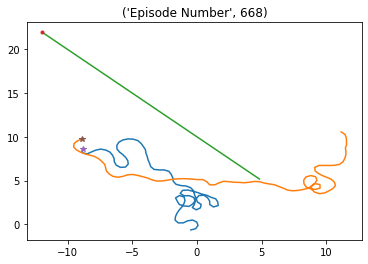

Episode * 669 * Avg Reward is ==> 3294.9865734520135 : Ag1 Reward ==> 1801.7545837207576 : Ag2 Reward ==> 1806.0937906578595 


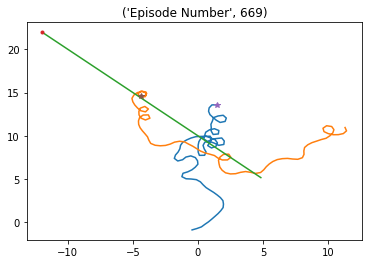

Episode * 670 * Avg Reward is ==> 3304.9273068848715 : Ag1 Reward ==> 1861.3908228329767 : Ag2 Reward ==> 1808.4737007853118 


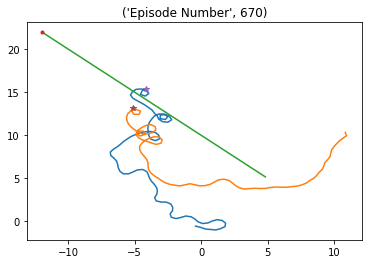

Episode * 671 * Avg Reward is ==> 3299.285936878213 : Ag1 Reward ==> 1651.8520753485393 : Ag2 Reward ==> 1764.6295688682276 


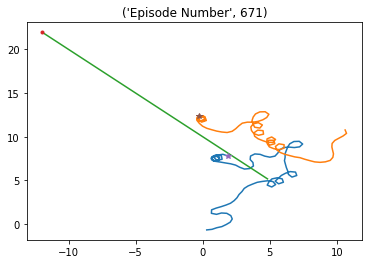

Episode * 672 * Avg Reward is ==> 3275.2906017681257 : Ag1 Reward ==> 1325.5466203784385 : Ag2 Reward ==> 1480.0896860341725 


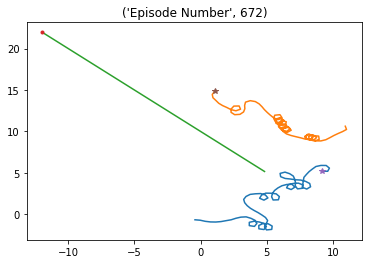

Episode * 673 * Avg Reward is ==> 3259.250393372631 : Ag1 Reward ==> 1477.3163262706505 : Ag2 Reward ==> 1616.6345729054333 


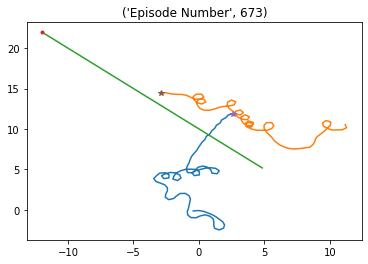

Episode * 674 * Avg Reward is ==> 3271.122280903173 : Ag1 Reward ==> 1822.381449199991 : Ag2 Reward ==> 1992.6942759287274 


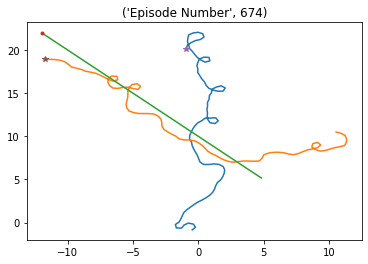

Episode * 675 * Avg Reward is ==> 3274.219659741181 : Ag1 Reward ==> 1627.5716421775828 : Ag2 Reward ==> 1734.025938273466 


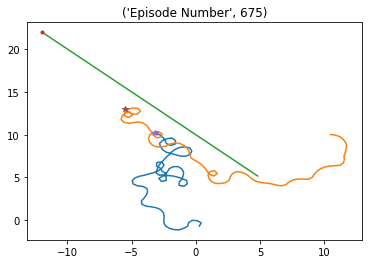

Episode * 676 * Avg Reward is ==> 3261.662641081551 : Ag1 Reward ==> 1305.4264331431189 : Ag2 Reward ==> 1444.4664415389152 


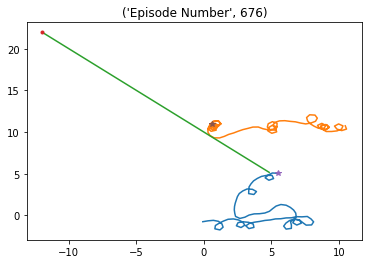

Episode * 677 * Avg Reward is ==> 3248.3116148228924 : Ag1 Reward ==> 1393.404788544328 : Ag2 Reward ==> 1481.1488334232379 


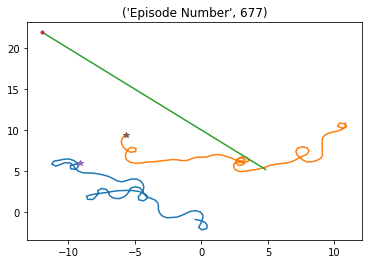

Episode * 678 * Avg Reward is ==> 3224.5821333494823 : Ag1 Reward ==> 1434.6283629362501 : Ag2 Reward ==> 1478.5178723184772 


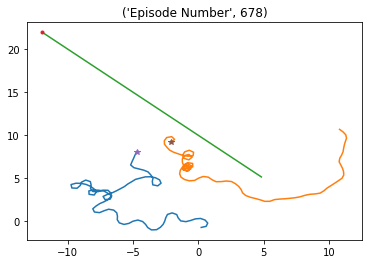

Episode * 679 * Avg Reward is ==> 3210.7094787124724 : Ag1 Reward ==> 1092.2217644059028 : Ag2 Reward ==> 1245.2430688734348 


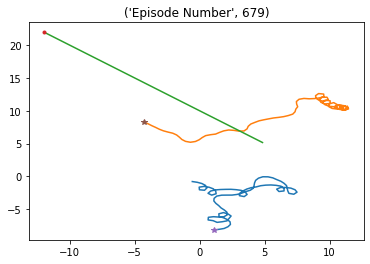

Episode * 680 * Avg Reward is ==> 3203.344244856988 : Ag1 Reward ==> 1663.258994834018 : Ag2 Reward ==> 1699.552198035138 


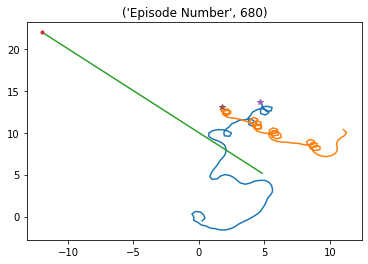

Episode * 681 * Avg Reward is ==> 3239.149740376881 : Ag1 Reward ==> 2057.986622685955 : Ag2 Reward ==> 2173.245500709599 


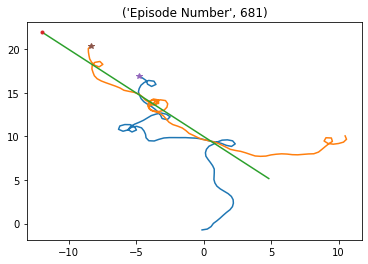

Episode * 682 * Avg Reward is ==> 3225.5247028192143 : Ag1 Reward ==> 1317.3321799792532 : Ag2 Reward ==> 1461.1552499937661 


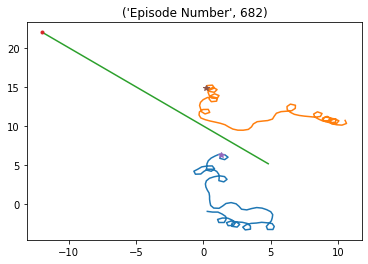

Episode * 683 * Avg Reward is ==> 3235.3907864415924 : Ag1 Reward ==> 1582.4883888672407 : Ag2 Reward ==> 1662.3541745210382 


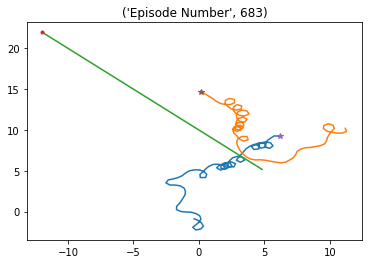

Episode * 684 * Avg Reward is ==> 3254.2051588967433 : Ag1 Reward ==> 1818.4795724169041 : Ag2 Reward ==> 1919.6454945715307 


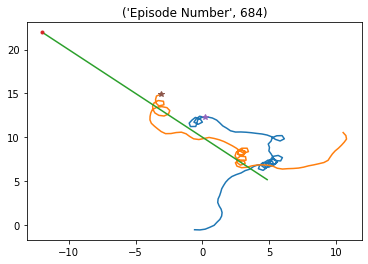

Episode * 685 * Avg Reward is ==> 3266.5071899132954 : Ag1 Reward ==> 1669.0978380825393 : Ag2 Reward ==> 1725.5668474985064 


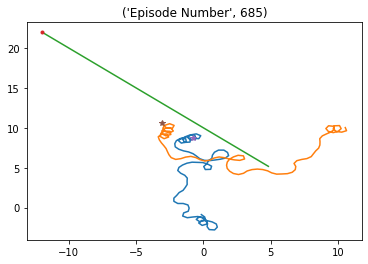

Episode * 686 * Avg Reward is ==> 3261.16089980561 : Ag1 Reward ==> 1345.4600750055026 : Ag2 Reward ==> 1613.2616642465055 


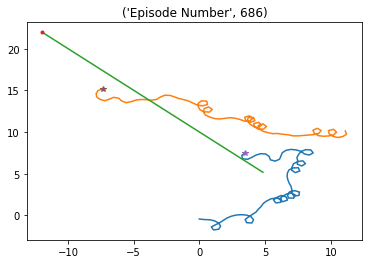

Episode * 687 * Avg Reward is ==> 3259.7309405740716 : Ag1 Reward ==> 1622.0006329656449 : Ag2 Reward ==> 1621.109397861849 


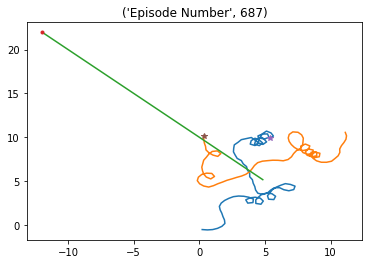

Episode * 688 * Avg Reward is ==> 3270.0003931440947 : Ag1 Reward ==> 1623.797182547151 : Ag2 Reward ==> 1819.7216032068925 


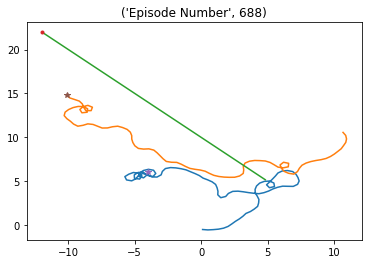

Episode * 689 * Avg Reward is ==> 3279.237801659782 : Ag1 Reward ==> 1668.6268878004196 : Ag2 Reward ==> 1671.1232565122073 


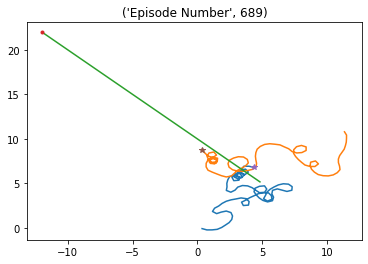

Episode * 690 * Avg Reward is ==> 3267.4862409534508 : Ag1 Reward ==> 1378.6265207612087 : Ag2 Reward ==> 1621.7608927285244 


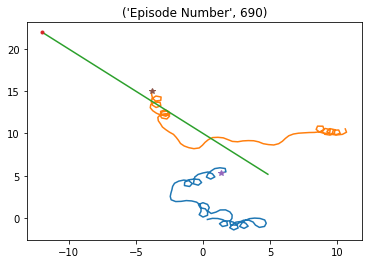

Episode * 691 * Avg Reward is ==> 3271.859490216221 : Ag1 Reward ==> 1683.4218568354165 : Ag2 Reward ==> 1859.0693991479363 


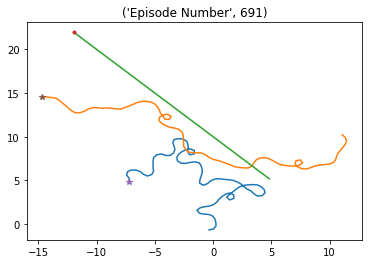

Episode * 692 * Avg Reward is ==> 3261.833756745809 : Ag1 Reward ==> 1634.8833180202653 : Ag2 Reward ==> 1653.8524990871801 


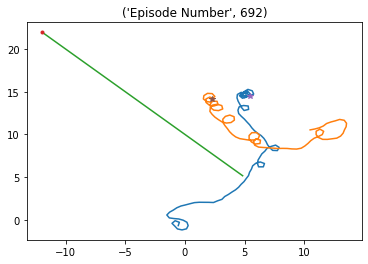

Episode * 693 * Avg Reward is ==> 3273.4878730800774 : Ag1 Reward ==> 1559.3777446072472 : Ag2 Reward ==> 1737.3060520279344 


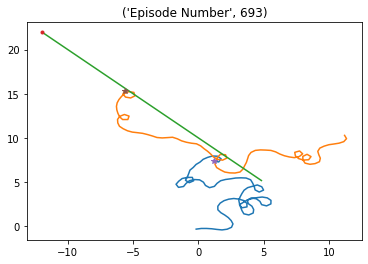

Episode * 694 * Avg Reward is ==> 3264.926459186682 : Ag1 Reward ==> 1330.5889507467914 : Ag2 Reward ==> 1804.1832273662826 


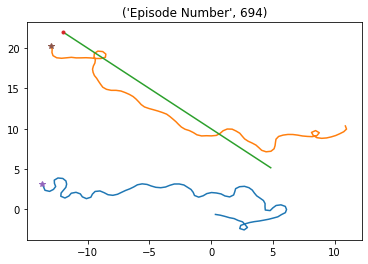

Episode * 695 * Avg Reward is ==> 3245.9723316904506 : Ag1 Reward ==> 1330.0852756865513 : Ag2 Reward ==> 1562.8434313297096 


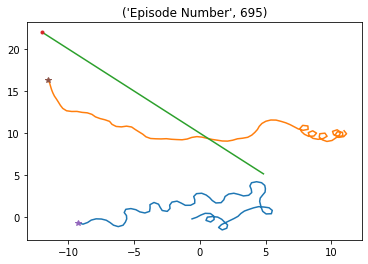

Episode * 696 * Avg Reward is ==> 3213.5457343685694 : Ag1 Reward ==> 1247.89336951113 : Ag2 Reward ==> 1276.0374197298136 


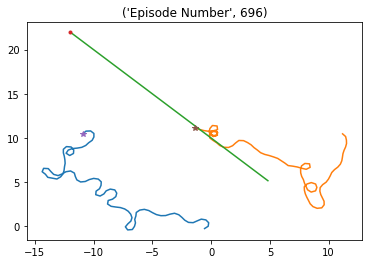

Episode * 697 * Avg Reward is ==> 3215.2639696344963 : Ag1 Reward ==> 1387.3806572472374 : Ag2 Reward ==> 1681.8158527559024 


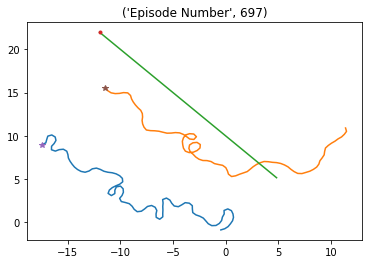

Episode * 698 * Avg Reward is ==> 3232.879754560242 : Ag1 Reward ==> 1843.8845226859305 : Ag2 Reward ==> 1972.4457281472544 


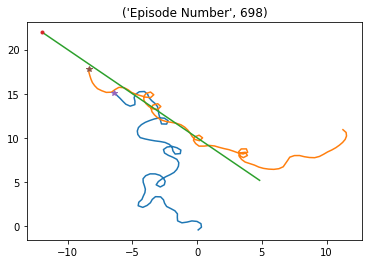

Episode * 699 * Avg Reward is ==> 3225.410380352023 : Ag1 Reward ==> 1377.536521235804 : Ag2 Reward ==> 1523.133404643888 


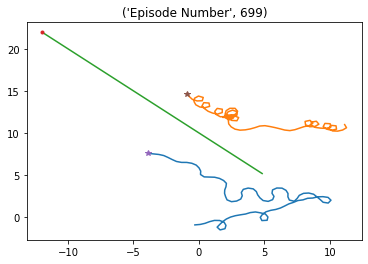

Episode * 700 * Avg Reward is ==> 3202.714037360819 : Ag1 Reward ==> 1296.3774204108154 : Ag2 Reward ==> 1448.7511506209717 


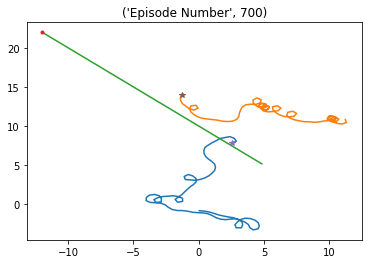

Episode * 701 * Avg Reward is ==> 3212.089287824034 : Ag1 Reward ==> 1561.3226790316835 : Ag2 Reward ==> 1811.588680763137 


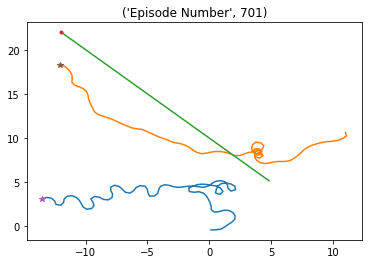

Episode * 702 * Avg Reward is ==> 3221.0127792472786 : Ag1 Reward ==> 1789.4941446181315 : Ag2 Reward ==> 1845.7624507156895 


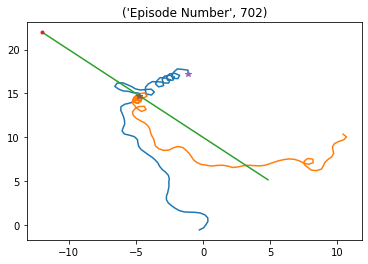

Episode * 703 * Avg Reward is ==> 3205.637794768684 : Ag1 Reward ==> 1267.9896189225765 : Ag2 Reward ==> 1410.3669756506158 


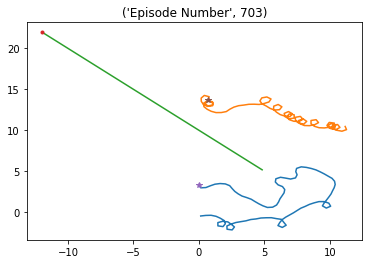

Episode * 704 * Avg Reward is ==> 3211.650797520669 : Ag1 Reward ==> 1551.6180782303697 : Ag2 Reward ==> 1851.6584691284336 


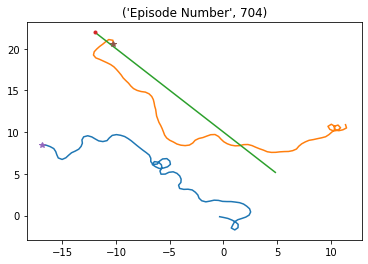

Episode * 705 * Avg Reward is ==> 3209.636674146165 : Ag1 Reward ==> 1586.7999384087177 : Ag2 Reward ==> 1699.7392619698146 


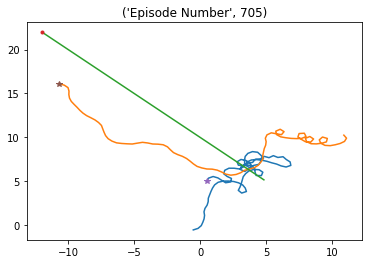

Episode * 706 * Avg Reward is ==> 3229.992054369152 : Ag1 Reward ==> 1816.8524841605072 : Ag2 Reward ==> 1993.5749862624432 


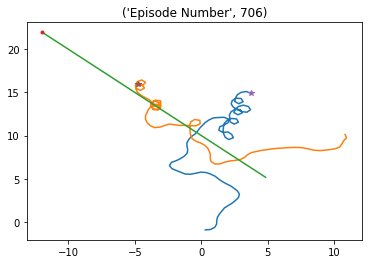

Episode * 707 * Avg Reward is ==> 3233.755661564707 : Ag1 Reward ==> 1593.1083403526777 : Ag2 Reward ==> 1762.203229709426 


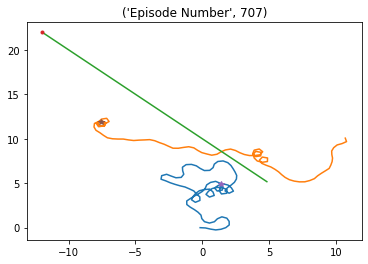

Episode * 708 * Avg Reward is ==> 3236.189347490188 : Ag1 Reward ==> 1596.6283548558993 : Ag2 Reward ==> 1716.8346105861228 


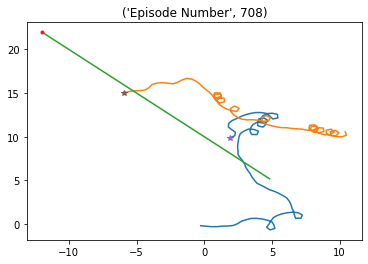

Episode * 709 * Avg Reward is ==> 3225.607244230568 : Ag1 Reward ==> 1496.74359809707 : Ag2 Reward ==> 1687.820645896756 


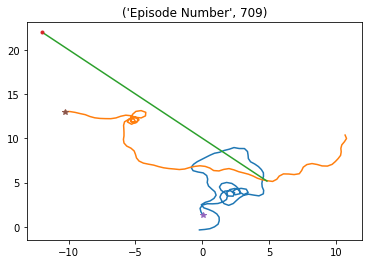

Episode * 710 * Avg Reward is ==> 3209.3582870667988 : Ag1 Reward ==> 1426.815988002769 : Ag2 Reward ==> 1593.0902490647434 


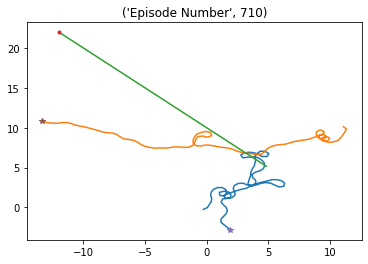

Episode * 711 * Avg Reward is ==> 3200.397816748864 : Ag1 Reward ==> 1496.0682323740023 : Ag2 Reward ==> 1561.9945991253746 


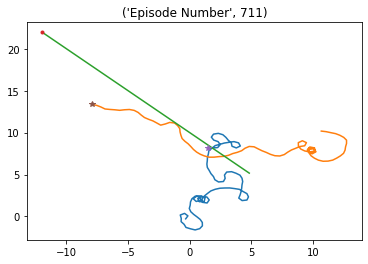

Episode * 712 * Avg Reward is ==> 3216.0680061843996 : Ag1 Reward ==> 1706.9019282139172 : Ag2 Reward ==> 1725.5419556201152 


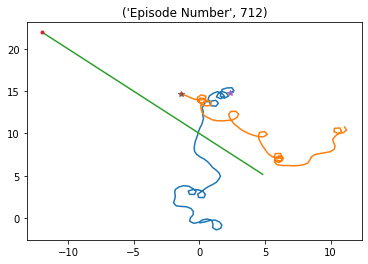

Episode * 713 * Avg Reward is ==> 3205.152881691874 : Ag1 Reward ==> 1207.6968704139297 : Ag2 Reward ==> 1449.649049061142 


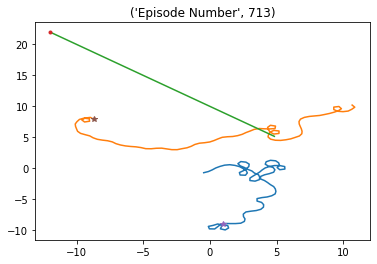

Episode * 714 * Avg Reward is ==> 3197.3294327640738 : Ag1 Reward ==> 1696.9534645270248 : Ag2 Reward ==> 1805.1843034896829 


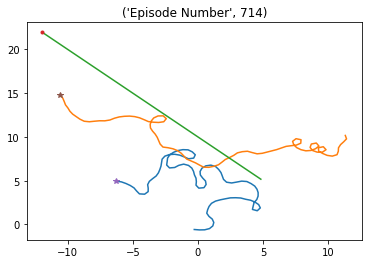

Episode * 715 * Avg Reward is ==> 3209.1390701089113 : Ag1 Reward ==> 1790.025378375657 : Ag2 Reward ==> 2043.9576958688915 


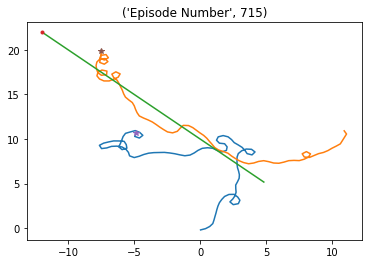

Episode * 716 * Avg Reward is ==> 3213.501859805682 : Ag1 Reward ==> 1358.5816585528937 : Ag2 Reward ==> 1565.8228039999642 


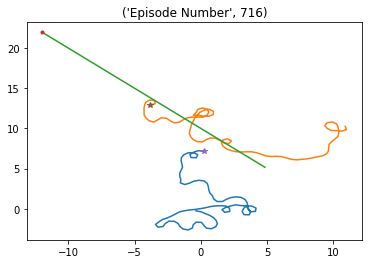

Episode * 717 * Avg Reward is ==> 3218.698301970432 : Ag1 Reward ==> 1311.4772917579721 : Ag2 Reward ==> 1770.9340167995995 


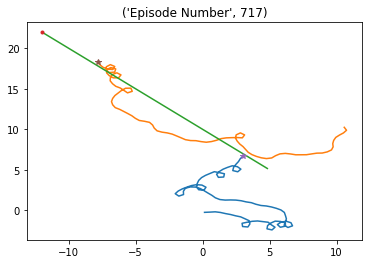

Episode * 718 * Avg Reward is ==> 3214.4293989493162 : Ag1 Reward ==> 1233.0408599952616 : Ag2 Reward ==> 1509.3492544148244 


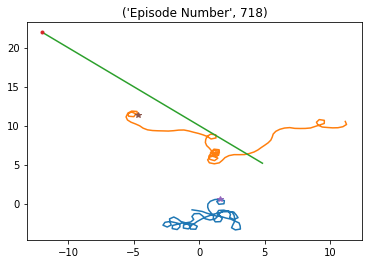

Episode * 719 * Avg Reward is ==> 3238.9548188678577 : Ag1 Reward ==> 1583.1384573185599 : Ag2 Reward ==> 1735.3431727024488 


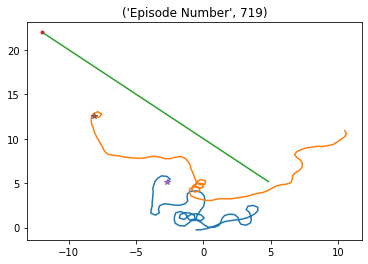

Episode * 720 * Avg Reward is ==> 3230.555362545695 : Ag1 Reward ==> 1430.7331256574623 : Ag2 Reward ==> 1596.0998143251893 


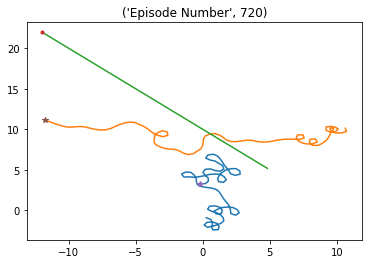

Episode * 721 * Avg Reward is ==> 3202.1565441368016 : Ag1 Reward ==> 1480.463252914313 : Ag2 Reward ==> 1614.8161341254895 


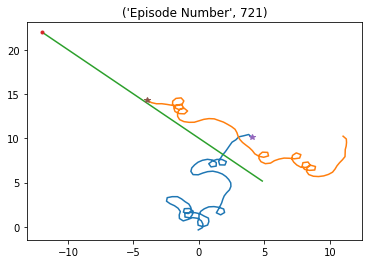

Episode * 722 * Avg Reward is ==> 3211.2035689500144 : Ag1 Reward ==> 1387.7817054161017 : Ag2 Reward ==> 1752.5867170854262 


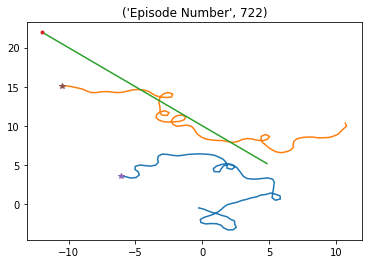

Episode * 723 * Avg Reward is ==> 3203.885086827817 : Ag1 Reward ==> 1372.1420111086882 : Ag2 Reward ==> 1579.9612673917022 


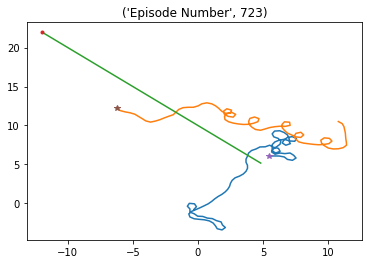

Episode * 724 * Avg Reward is ==> 3179.5352563274027 : Ag1 Reward ==> 1224.973844934508 : Ag2 Reward ==> 1539.1580020373556 


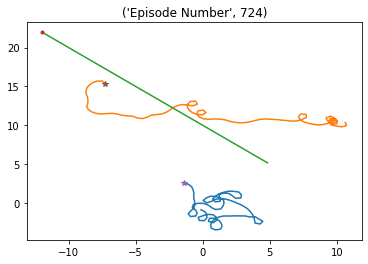

Episode * 725 * Avg Reward is ==> 3180.264531952612 : Ag1 Reward ==> 1736.629292549559 : Ag2 Reward ==> 1687.2064180398531 


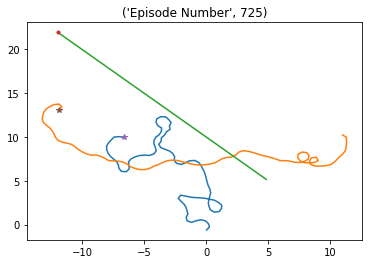

Episode * 726 * Avg Reward is ==> 3190.8513129591897 : Ag1 Reward ==> 1533.4768417032992 : Ag2 Reward ==> 1848.7161378118226 


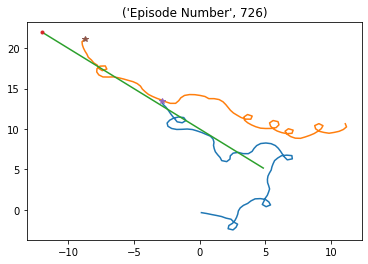

Episode * 727 * Avg Reward is ==> 3199.112304632229 : Ag1 Reward ==> 1756.5468744164755 : Ag2 Reward ==> 1817.0028233325772 


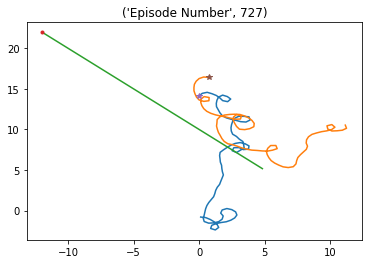

Episode * 728 * Avg Reward is ==> 3202.7584935402256 : Ag1 Reward ==> 1807.8734417871483 : Ag2 Reward ==> 1781.4929002867611 


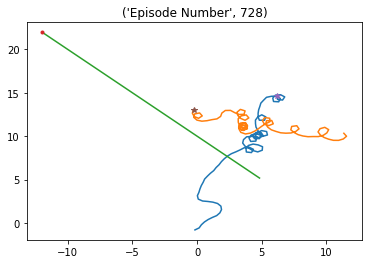

Episode * 729 * Avg Reward is ==> 3205.022471929236 : Ag1 Reward ==> 1692.0376398638223 : Ag2 Reward ==> 1738.271640009227 


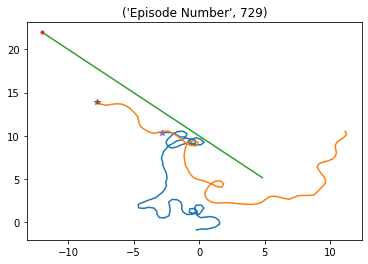

Episode * 730 * Avg Reward is ==> 3204.794477788066 : Ag1 Reward ==> 1425.3284860973479 : Ag2 Reward ==> 1565.9391617455901 


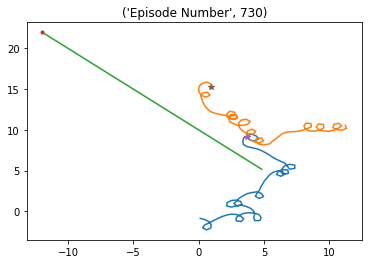

Episode * 731 * Avg Reward is ==> 3199.0462838799854 : Ag1 Reward ==> 1613.6175875427305 : Ag2 Reward ==> 1698.9459121173873 


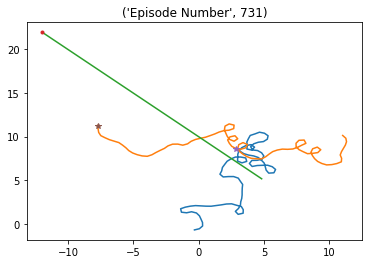

Episode * 732 * Avg Reward is ==> 3184.3562606834366 : Ag1 Reward ==> 1202.299405188769 : Ag2 Reward ==> 1498.8354840567456 


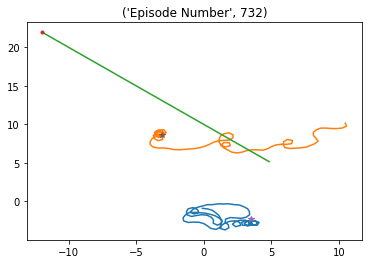

Episode * 733 * Avg Reward is ==> 3182.4952121746473 : Ag1 Reward ==> 1562.7516784104573 : Ag2 Reward ==> 1659.4901778731423 


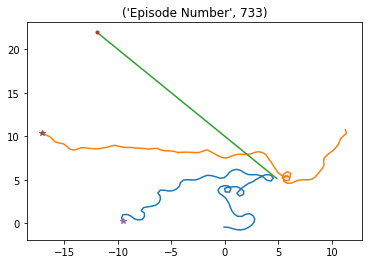

Episode * 734 * Avg Reward is ==> 3181.3807608448346 : Ag1 Reward ==> 1553.537533875668 : Ag2 Reward ==> 1536.6565910449124 


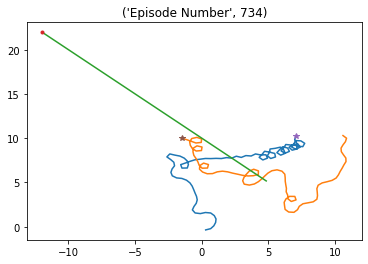

Episode * 735 * Avg Reward is ==> 3185.6628471915783 : Ag1 Reward ==> 1437.7447492291008 : Ag2 Reward ==> 1626.4674116569067 


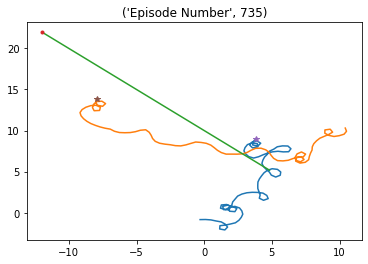

Episode * 736 * Avg Reward is ==> 3207.4700342766023 : Ag1 Reward ==> 1649.1676034992586 : Ag2 Reward ==> 1747.050669142651 


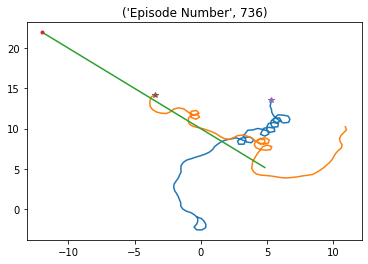

Episode * 737 * Avg Reward is ==> 3224.1128202892914 : Ag1 Reward ==> 1844.0054255565417 : Ag2 Reward ==> 1890.9025249541623 


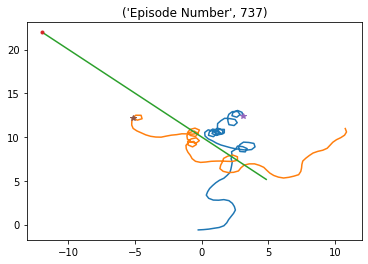

Episode * 738 * Avg Reward is ==> 3198.0634452677687 : Ag1 Reward ==> 1254.3855271170503 : Ag2 Reward ==> 1519.9697228552304 


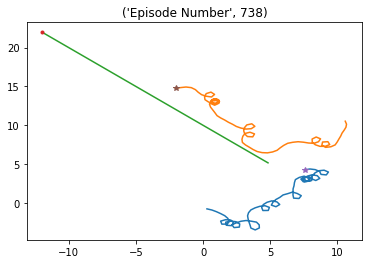

Episode * 739 * Avg Reward is ==> 3203.422486556696 : Ag1 Reward ==> 1439.1783883439525 : Ag2 Reward ==> 1675.8531890928173 


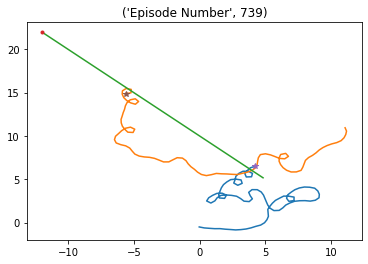

Episode * 740 * Avg Reward is ==> 3213.8024641515267 : Ag1 Reward ==> 1576.3112698645393 : Ag2 Reward ==> 1584.0164049604714 


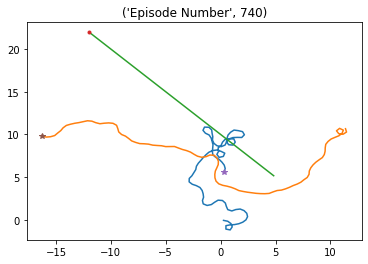

Episode * 741 * Avg Reward is ==> 3201.868319184523 : Ag1 Reward ==> 1446.610815861957 : Ag2 Reward ==> 1448.934745252712 


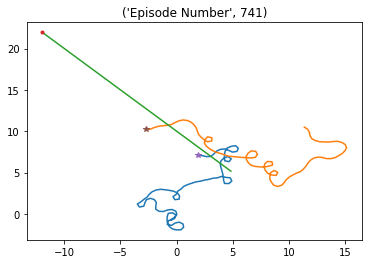

Episode * 742 * Avg Reward is ==> 3197.6520449688373 : Ag1 Reward ==> 1649.9459953681692 : Ag2 Reward ==> 1816.6596313382352 


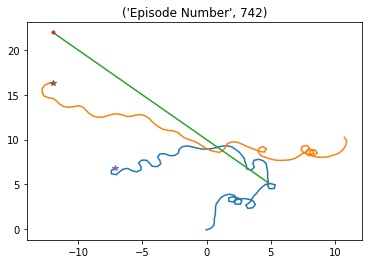

Episode * 743 * Avg Reward is ==> 3209.4121362995384 : Ag1 Reward ==> 1518.3399592424184 : Ag2 Reward ==> 1630.4202885588168 


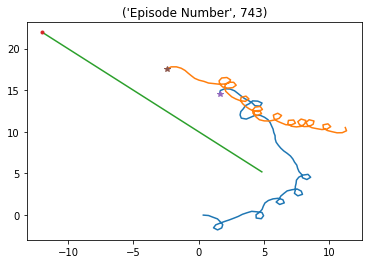

Episode * 744 * Avg Reward is ==> 3206.622162613973 : Ag1 Reward ==> 1629.5713360272912 : Ag2 Reward ==> 1662.1062639089034 


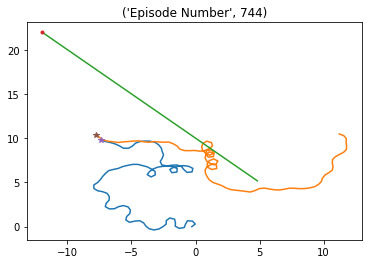

Episode * 745 * Avg Reward is ==> 3207.086442195574 : Ag1 Reward ==> 1541.0383610716171 : Ag2 Reward ==> 1764.0720225709438 


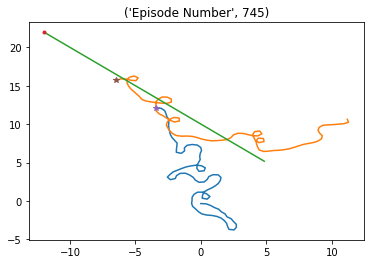

Episode * 746 * Avg Reward is ==> 3190.5959823346006 : Ag1 Reward ==> 1505.7128794488153 : Ag2 Reward ==> 1645.0961965352085 


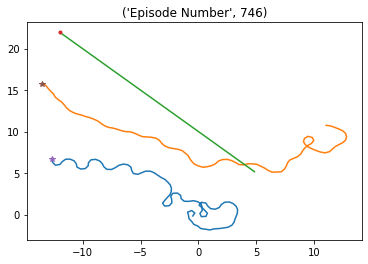

Episode * 747 * Avg Reward is ==> 3191.5483243124527 : Ag1 Reward ==> 1700.113636987992 : Ag2 Reward ==> 1693.29161218818 


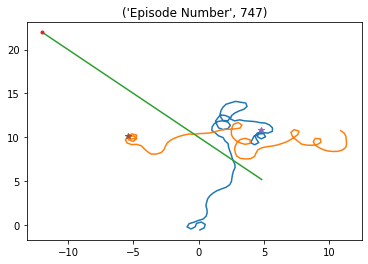

Episode * 748 * Avg Reward is ==> 3188.8794870107968 : Ag1 Reward ==> 1482.6865078030214 : Ag2 Reward ==> 1724.0229655727585 


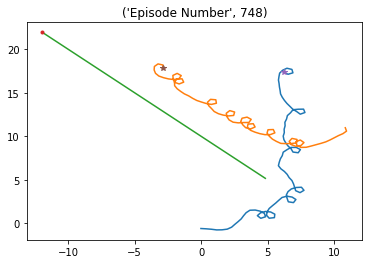

Episode * 749 * Avg Reward is ==> 3185.902636753318 : Ag1 Reward ==> 1520.6586328502276 : Ag2 Reward ==> 1544.8316008444679 


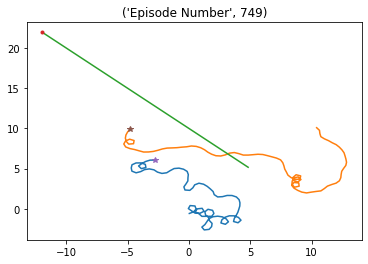

Episode * 750 * Avg Reward is ==> 3179.610320678951 : Ag1 Reward ==> 1298.4969015803042 : Ag2 Reward ==> 1469.7166925125211 


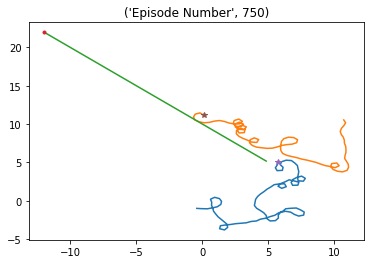

Episode * 751 * Avg Reward is ==> 3169.599170495924 : Ag1 Reward ==> 1253.931739480231 : Ag2 Reward ==> 1403.6850846980633 


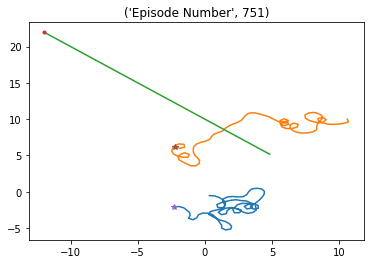

Episode * 752 * Avg Reward is ==> 3170.6968499863638 : Ag1 Reward ==> 1692.501201268005 : Ag2 Reward ==> 1783.8498621836097 


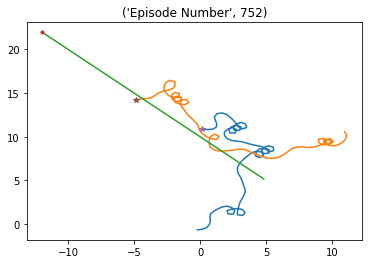

Episode * 753 * Avg Reward is ==> 3197.7314695331024 : Ag1 Reward ==> 1880.070565077361 : Ag2 Reward ==> 1858.6601362672607 


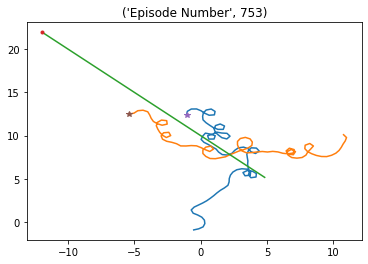

Episode * 754 * Avg Reward is ==> 3191.975846106954 : Ag1 Reward ==> 1539.4174429730474 : Ag2 Reward ==> 1732.4953879977286 


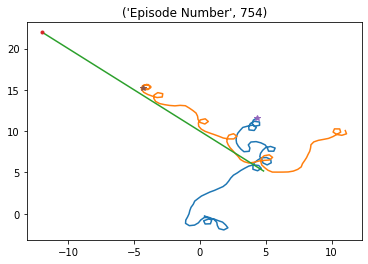

Episode * 755 * Avg Reward is ==> 3169.7196375919293 : Ag1 Reward ==> 1394.2660911987077 : Ag2 Reward ==> 1549.4686424448366 


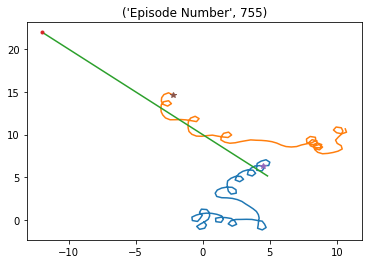

Episode * 756 * Avg Reward is ==> 3177.8678900481013 : Ag1 Reward ==> 1528.372590875771 : Ag2 Reward ==> 1721.9619699239613 


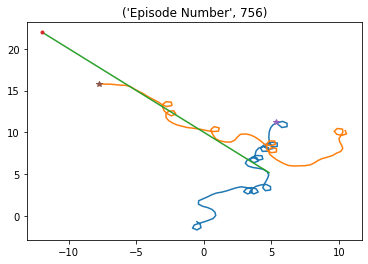

Episode * 757 * Avg Reward is ==> 3180.787829848905 : Ag1 Reward ==> 1468.4848662931063 : Ag2 Reward ==> 1730.7240342966097 


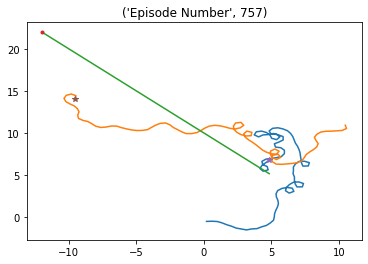

Episode * 758 * Avg Reward is ==> 3187.901818744717 : Ag1 Reward ==> 1420.738204807587 : Ag2 Reward ==> 1606.2114654349848 


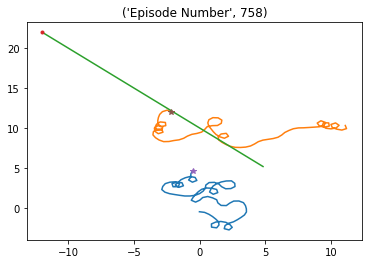

Episode * 759 * Avg Reward is ==> 3189.082215023143 : Ag1 Reward ==> 1585.818156424244 : Ag2 Reward ==> 1779.879324733812 


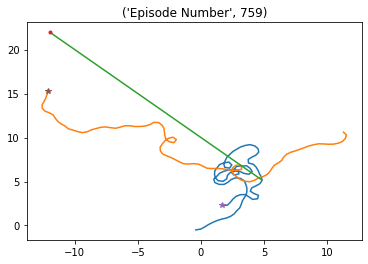

Episode * 760 * Avg Reward is ==> 3190.9601440569218 : Ag1 Reward ==> 1497.7400825893917 : Ag2 Reward ==> 1604.2100187444078 


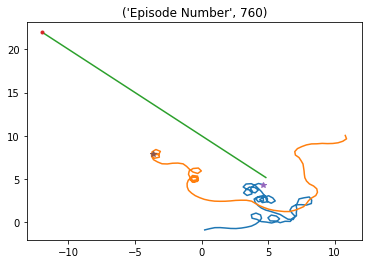

Episode * 761 * Avg Reward is ==> 3188.1083857536805 : Ag1 Reward ==> 1400.985912760217 : Ag2 Reward ==> 1580.2231421499182 


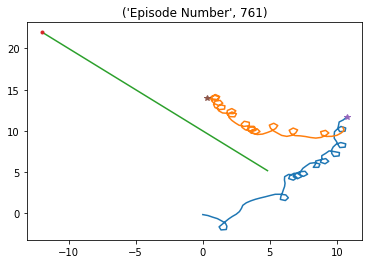

Episode * 762 * Avg Reward is ==> 3193.978175390931 : Ag1 Reward ==> 1703.9557913467245 : Ag2 Reward ==> 1671.2042166448293 


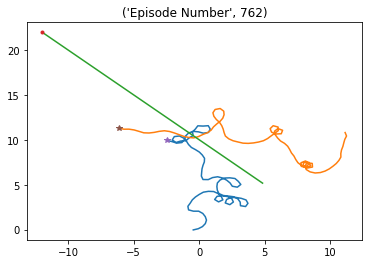

Episode * 763 * Avg Reward is ==> 3195.0622747943357 : Ag1 Reward ==> 1479.892768701781 : Ag2 Reward ==> 1515.5744859348038 


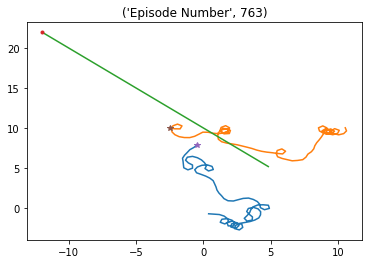

Episode * 764 * Avg Reward is ==> 3197.36365121336 : Ag1 Reward ==> 1348.9967086094975 : Ag2 Reward ==> 1507.1901951233426 


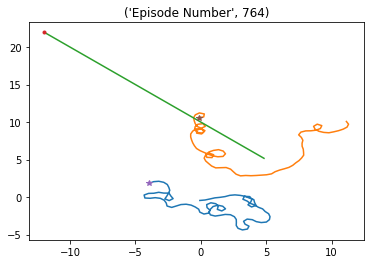

Episode * 765 * Avg Reward is ==> 3189.8241543446325 : Ag1 Reward ==> 1453.0071872333926 : Ag2 Reward ==> 1669.2486486069179 


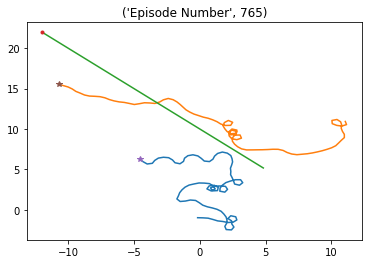

Episode * 766 * Avg Reward is ==> 3185.06525298715 : Ag1 Reward ==> 1572.033583023922 : Ag2 Reward ==> 1619.8033421919054 


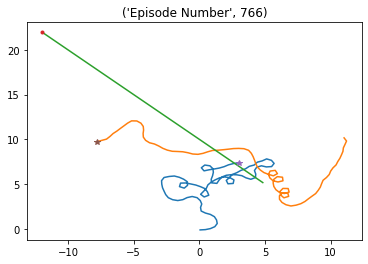

Episode * 767 * Avg Reward is ==> 3161.555805682711 : Ag1 Reward ==> 1375.422300139792 : Ag2 Reward ==> 1257.7495054316885 


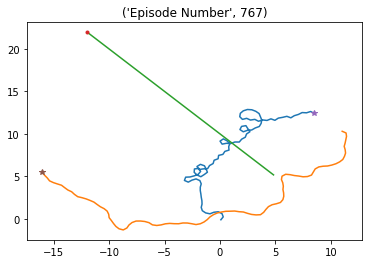

Episode * 768 * Avg Reward is ==> 3151.644203671578 : Ag1 Reward ==> 1518.4737722222162 : Ag2 Reward ==> 1674.4284894063899 


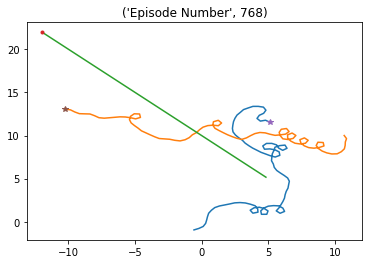

Episode * 769 * Avg Reward is ==> 3145.2079709574136 : Ag1 Reward ==> 1536.8201902964538 : Ag2 Reward ==> 1636.0397810100053 


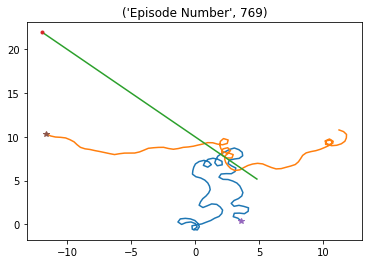

Episode * 770 * Avg Reward is ==> 3149.7627768203492 : Ag1 Reward ==> 1554.4370131873166 : Ag2 Reward ==> 1619.0228691730604 


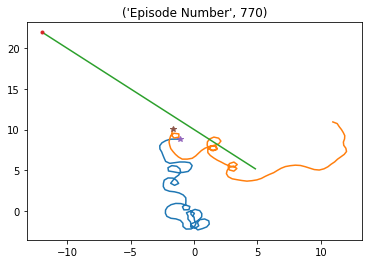

Episode * 771 * Avg Reward is ==> 3153.00138245941 : Ag1 Reward ==> 1633.7346304711032 : Ag2 Reward ==> 1808.3730947514239 


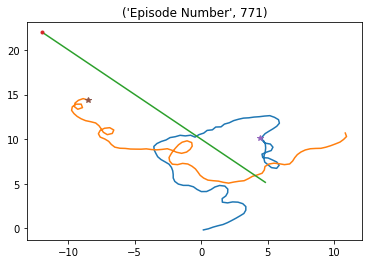

Episode * 772 * Avg Reward is ==> 3158.4312424201607 : Ag1 Reward ==> 1289.9236542060999 : Ag2 Reward ==> 1628.4056334694637 


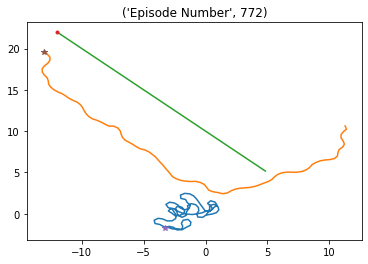

Episode * 773 * Avg Reward is ==> 3158.5416837598955 : Ag1 Reward ==> 1570.6300602368003 : Ag2 Reward ==> 1656.0294496361803 


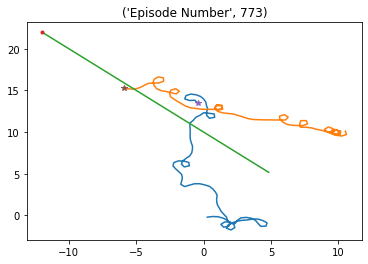

Episode * 774 * Avg Reward is ==> 3155.380749541793 : Ag1 Reward ==> 1355.5381524560955 : Ag2 Reward ==> 1608.2186037404101 


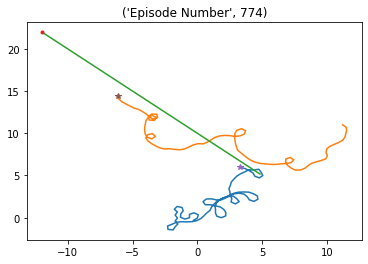

Episode * 775 * Avg Reward is ==> 3161.3642984467792 : Ag1 Reward ==> 1585.5186890671707 : Ag2 Reward ==> 1718.0354280182726 


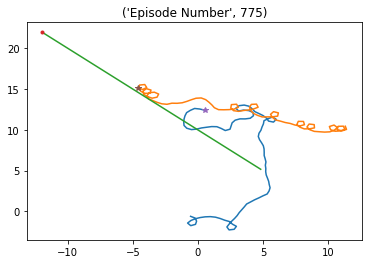

Episode * 776 * Avg Reward is ==> 3168.2881166253483 : Ag1 Reward ==> 1787.7980557878466 : Ag2 Reward ==> 1885.3729439968229 


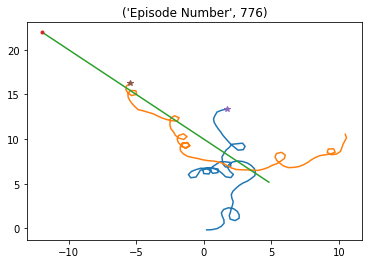

Episode * 777 * Avg Reward is ==> 3145.1313873155277 : Ag1 Reward ==> 1268.1490387189458 : Ag2 Reward ==> 1540.4897393989327 


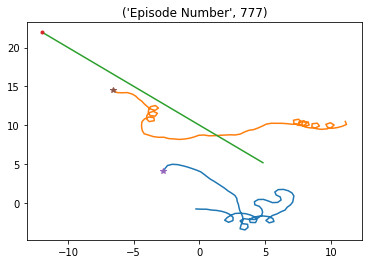

Episode * 778 * Avg Reward is ==> 3158.9762794989224 : Ag1 Reward ==> 1625.3438944888 : Ag2 Reward ==> 1702.807042819271 


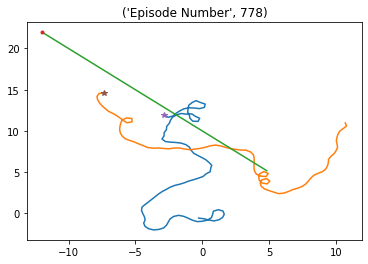

Episode * 779 * Avg Reward is ==> 3167.183525100597 : Ag1 Reward ==> 1574.228878468925 : Ag2 Reward ==> 1869.0925230348264 


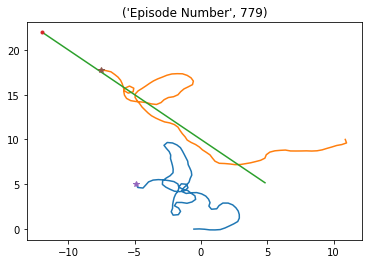

Episode * 780 * Avg Reward is ==> 3175.8041797202504 : Ag1 Reward ==> 1688.003110764963 : Ag2 Reward ==> 1817.1507488461948 


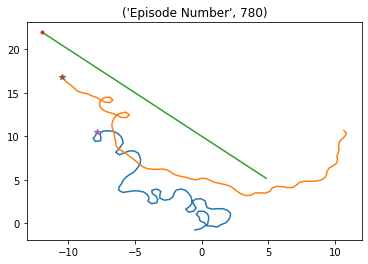

Episode * 781 * Avg Reward is ==> 3190.617009823355 : Ag1 Reward ==> 1655.474876920436 : Ag2 Reward ==> 1832.5838883184208 


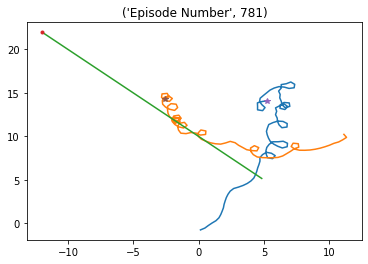

Episode * 782 * Avg Reward is ==> 3180.076391969168 : Ag1 Reward ==> 1474.9477074495035 : Ag2 Reward ==> 1570.0332050894215 


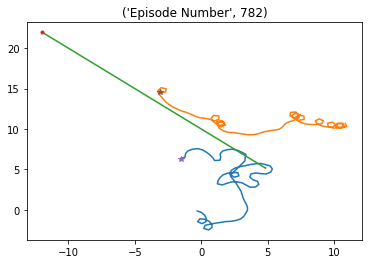

Episode * 783 * Avg Reward is ==> 3181.8268289201305 : Ag1 Reward ==> 1503.8911276245592 : Ag2 Reward ==> 1714.886598215175 


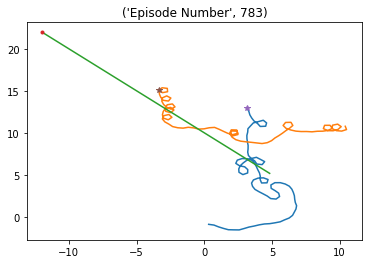

Episode * 784 * Avg Reward is ==> 3169.9985580041175 : Ag1 Reward ==> 1233.2182682492846 : Ag2 Reward ==> 1585.3284950463778 


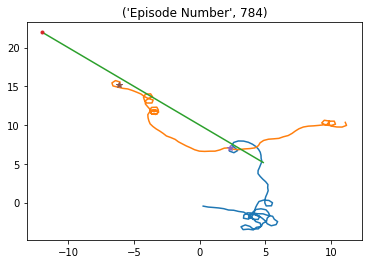

Episode * 785 * Avg Reward is ==> 3176.533956766316 : Ag1 Reward ==> 1662.7176777862014 : Ag2 Reward ==> 1903.808656344309 


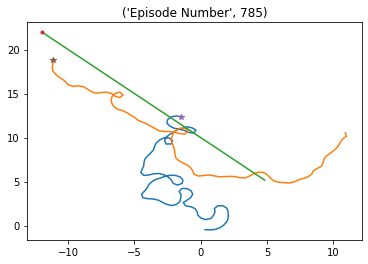

Episode * 786 * Avg Reward is ==> 3175.7307234038135 : Ag1 Reward ==> 1428.754074335825 : Ag2 Reward ==> 1689.9256671480937 


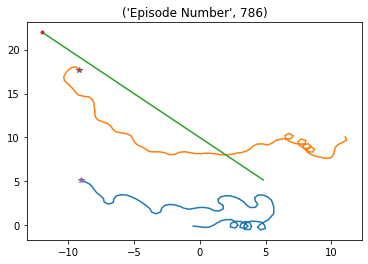

Episode * 787 * Avg Reward is ==> 3165.642723723852 : Ag1 Reward ==> 1362.204164389856 : Ag2 Reward ==> 1627.681097587881 


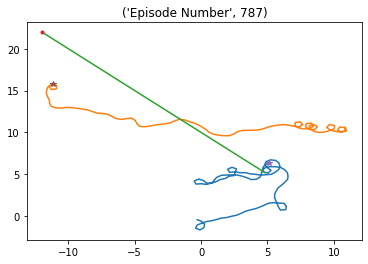

Episode * 788 * Avg Reward is ==> 3173.8897494234234 : Ag1 Reward ==> 1632.238405886182 : Ag2 Reward ==> 1904.3520954724386 


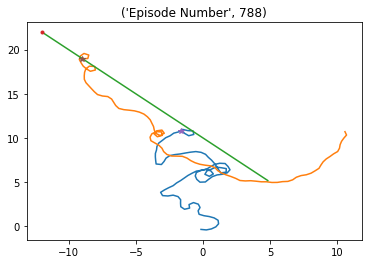

Episode * 789 * Avg Reward is ==> 3166.3313054148343 : Ag1 Reward ==> 1285.9001439565673 : Ag2 Reward ==> 1477.2523293945642 


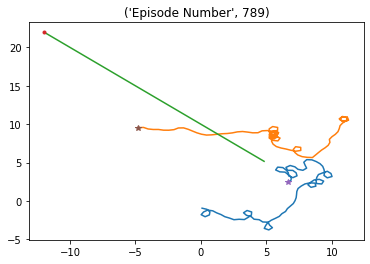

Episode * 790 * Avg Reward is ==> 3186.005831272415 : Ag1 Reward ==> 1646.989237550916 : Ag2 Reward ==> 1908.205390845135 


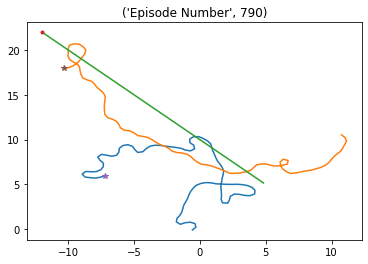

Episode * 791 * Avg Reward is ==> 3203.865283432863 : Ag1 Reward ==> 1630.594717110272 : Ag2 Reward ==> 1741.4001934859582 


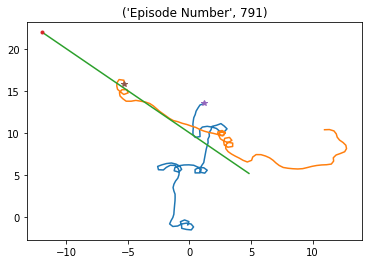

Episode * 792 * Avg Reward is ==> 3184.6139081646443 : Ag1 Reward ==> 1237.2985181395802 : Ag2 Reward ==> 1468.9975345832615 


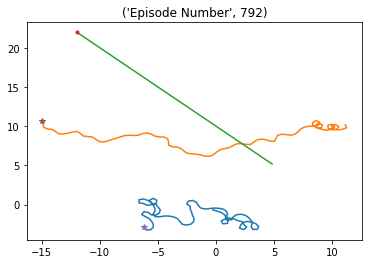

Episode * 793 * Avg Reward is ==> 3165.2215636109345 : Ag1 Reward ==> 1286.710207631647 : Ag2 Reward ==> 1676.3267115645829 


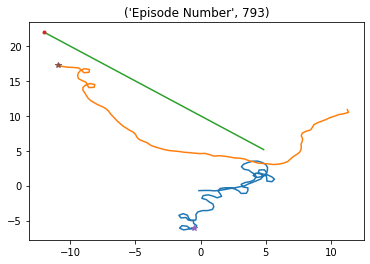

Episode * 794 * Avg Reward is ==> 3147.7027421571124 : Ag1 Reward ==> 1177.0413831442897 : Ag2 Reward ==> 1394.1185896736008 


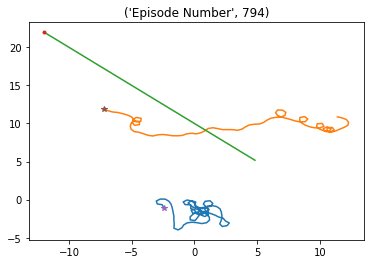

Episode * 795 * Avg Reward is ==> 3149.8510679606106 : Ag1 Reward ==> 1431.8933202207447 : Ag2 Reward ==> 1597.7744455627528 


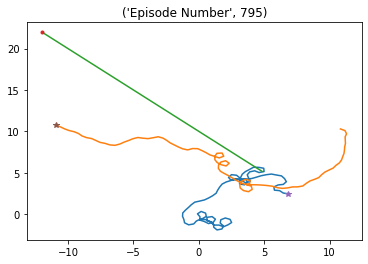

Episode * 796 * Avg Reward is ==> 3152.691731573571 : Ag1 Reward ==> 1645.5603373273066 : Ag2 Reward ==> 1718.400767990825 


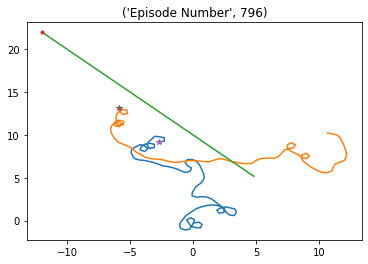

Episode * 797 * Avg Reward is ==> 3153.10573118826 : Ag1 Reward ==> 1376.0255525168518 : Ag2 Reward ==> 1839.7433326604187 


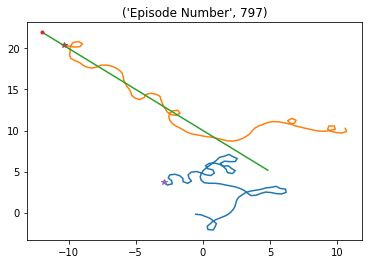

Episode * 798 * Avg Reward is ==> 3149.2779273217116 : Ag1 Reward ==> 1257.443412980831 : Ag2 Reward ==> 1616.394102599789 


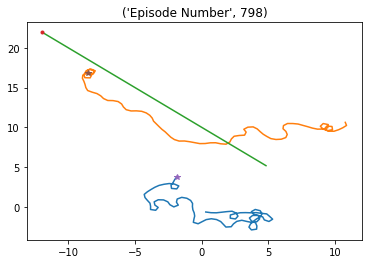

Episode * 799 * Avg Reward is ==> 3142.9290857977007 : Ag1 Reward ==> 1420.689328490962 : Ag2 Reward ==> 1691.0544917066832 


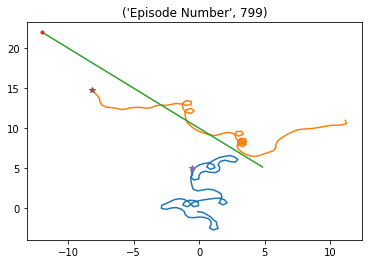

Episode * 800 * Avg Reward is ==> 3129.451487980495 : Ag1 Reward ==> 1186.4731764586136 : Ag2 Reward ==> 1376.3730121869603 


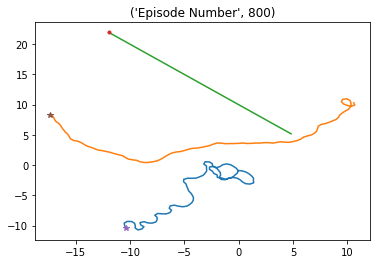

Episode * 801 * Avg Reward is ==> 3138.856592155992 : Ag1 Reward ==> 1666.714607164695 : Ag2 Reward ==> 1690.6986147653138 


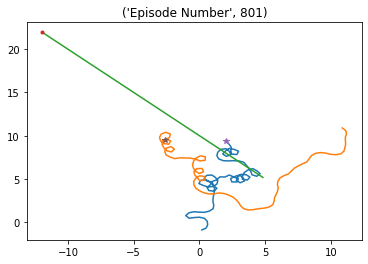

Episode * 802 * Avg Reward is ==> 3140.0135543253064 : Ag1 Reward ==> 1669.7067667600022 : Ag2 Reward ==> 1751.73172800413 


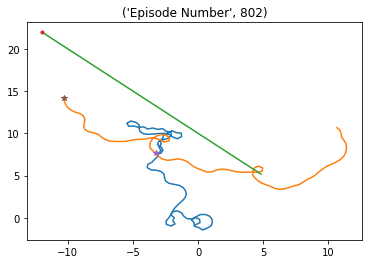

Episode * 803 * Avg Reward is ==> 3152.3277300697196 : Ag1 Reward ==> 1775.1549913435867 : Ag2 Reward ==> 1712.8792930695138 


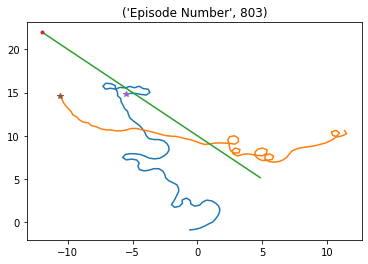

Episode * 804 * Avg Reward is ==> 3176.7344174991977 : Ag1 Reward ==> 1924.4870993869133 : Ag2 Reward ==> 1907.9673015250596 


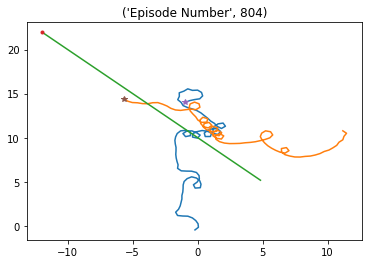

Episode * 805 * Avg Reward is ==> 3191.6712445833627 : Ag1 Reward ==> 1845.0436644837027 : Ag2 Reward ==> 1874.6852547231954 


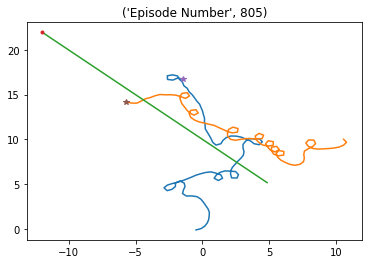

Episode * 806 * Avg Reward is ==> 3195.504821217367 : Ag1 Reward ==> 1568.7587613797193 : Ag2 Reward ==> 1776.4212291962845 


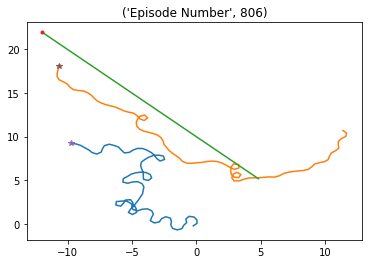

Episode * 807 * Avg Reward is ==> 3215.8192699834262 : Ag1 Reward ==> 1674.2408473194191 : Ag2 Reward ==> 1771.5089088944173 


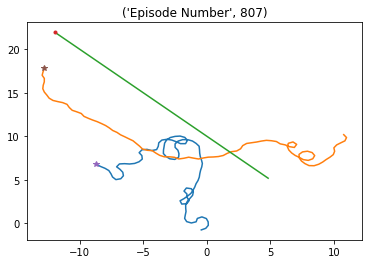

Episode * 808 * Avg Reward is ==> 3222.82016707196 : Ag1 Reward ==> 1708.113776823978 : Ag2 Reward ==> 1764.8243683459887 


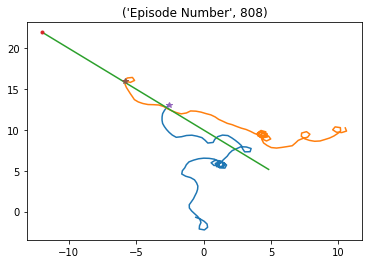

Episode * 809 * Avg Reward is ==> 3223.3449966317385 : Ag1 Reward ==> 1564.8008760441544 : Ag2 Reward ==> 1629.0522776534365 


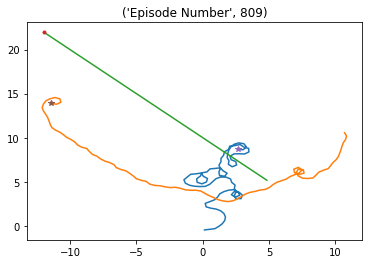

Episode * 810 * Avg Reward is ==> 3235.662001576528 : Ag1 Reward ==> 1764.8803638721556 : Ag2 Reward ==> 1901.2597162798024 


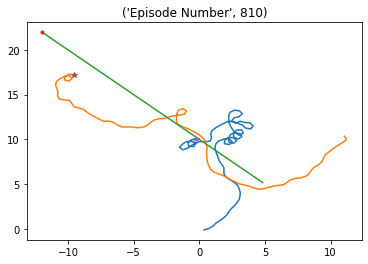

Episode * 811 * Avg Reward is ==> 3226.7028823639253 : Ag1 Reward ==> 1495.5000032133144 : Ag2 Reward ==> 1588.2429535051167 


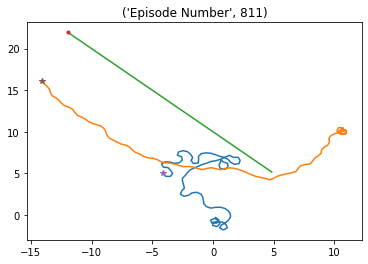

Episode * 812 * Avg Reward is ==> 3236.6320932057415 : Ag1 Reward ==> 1539.572651378719 : Ag2 Reward ==> 1775.9250699694976 


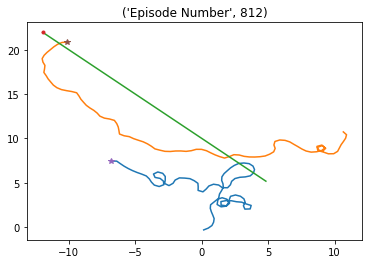

Episode * 813 * Avg Reward is ==> 3238.880578470313 : Ag1 Reward ==> 1598.7648771301936 : Ag2 Reward ==> 1717.834043325644 


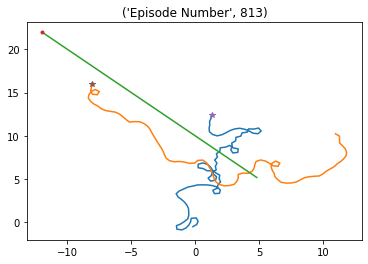

Episode * 814 * Avg Reward is ==> 3251.4737190318483 : Ag1 Reward ==> 1717.8093858750317 : Ag2 Reward ==> 1749.6729927828737 


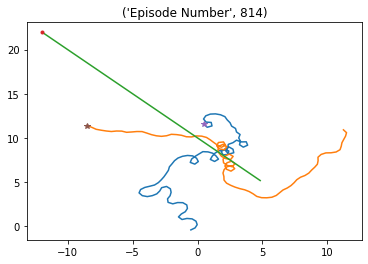

Episode * 815 * Avg Reward is ==> 3242.0697479325468 : Ag1 Reward ==> 1397.4967894025733 : Ag2 Reward ==> 1529.8984837108321 


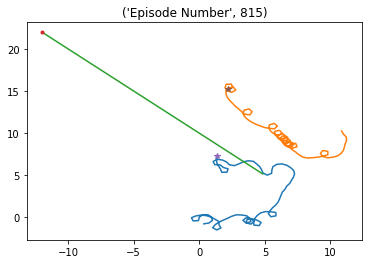

Episode * 816 * Avg Reward is ==> 3216.8003637339766 : Ag1 Reward ==> 1239.2167623973107 : Ag2 Reward ==> 1423.1788694445368 


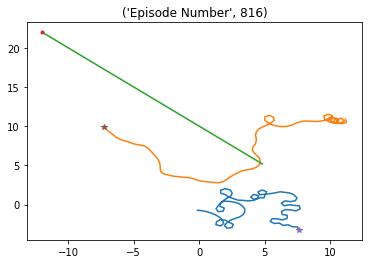

Episode * 817 * Avg Reward is ==> 3221.7731000277718 : Ag1 Reward ==> 1461.953989733048 : Ag2 Reward ==> 1545.59424013664 


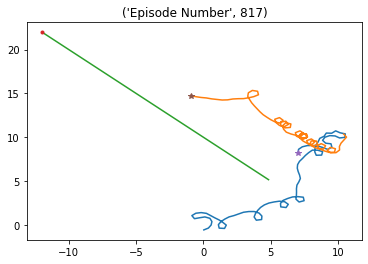

Episode * 818 * Avg Reward is ==> 3210.9336154929165 : Ag1 Reward ==> 1325.2606446972256 : Ag2 Reward ==> 1569.3109112166424 


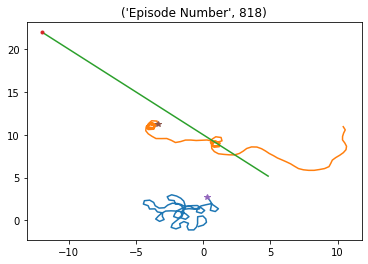

Episode * 819 * Avg Reward is ==> 3211.616675550488 : Ag1 Reward ==> 1635.6773138981125 : Ag2 Reward ==> 1834.9664899084914 


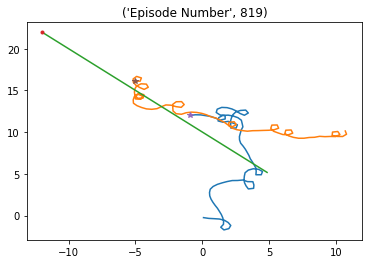

Episode * 820 * Avg Reward is ==> 3191.369291546978 : Ag1 Reward ==> 1146.8616238801615 : Ag2 Reward ==> 1548.3968755905967 


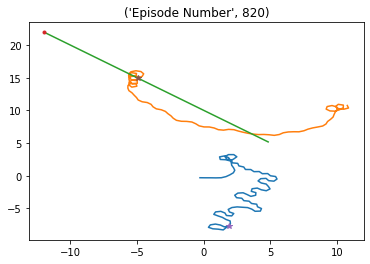

Episode * 821 * Avg Reward is ==> 3175.321071378631 : Ag1 Reward ==> 1292.6190010154799 : Ag2 Reward ==> 1553.5109574894934 


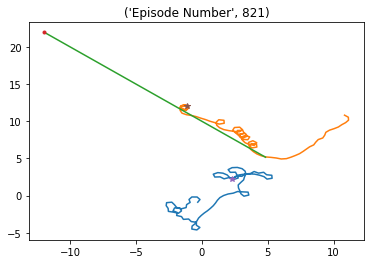

Episode * 822 * Avg Reward is ==> 3174.4940953875166 : Ag1 Reward ==> 1493.7047821820888 : Ag2 Reward ==> 1518.1970907122516 


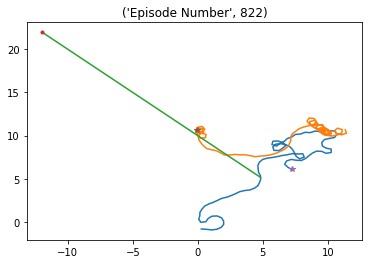

Episode * 823 * Avg Reward is ==> 3160.6353729855628 : Ag1 Reward ==> 1187.119235565886 : Ag2 Reward ==> 1477.309594195695 


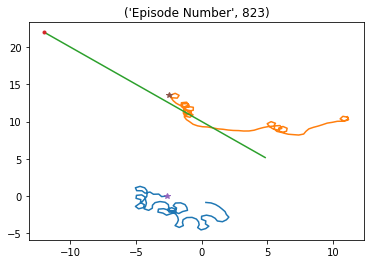

Episode * 824 * Avg Reward is ==> 3185.384122871612 : Ag1 Reward ==> 1907.4135899313958 : Ag2 Reward ==> 1901.0831688062592 


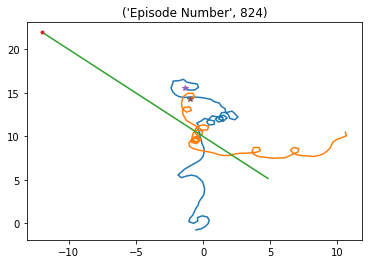

Episode * 825 * Avg Reward is ==> 3192.070524142214 : Ag1 Reward ==> 1870.1443651880647 : Ag2 Reward ==> 1963.838019766499 


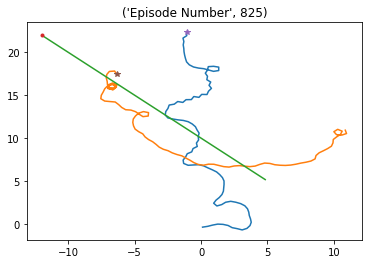

Episode * 826 * Avg Reward is ==> 3188.41052830607 : Ag1 Reward ==> 1403.9435987289264 : Ag2 Reward ==> 1568.336309309257 


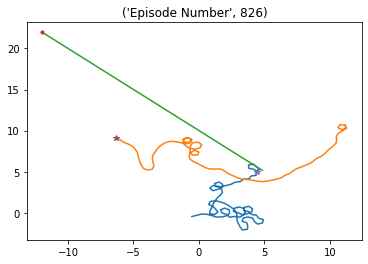

Episode * 827 * Avg Reward is ==> 3207.5294275181595 : Ag1 Reward ==> 1869.9965560154426 : Ag2 Reward ==> 1884.6446744458651 


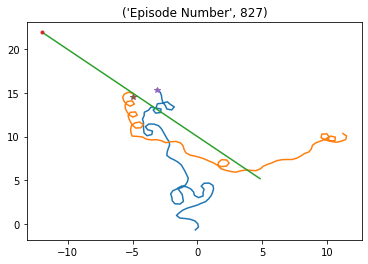

Episode * 828 * Avg Reward is ==> 3202.999796406679 : Ag1 Reward ==> 1672.3767807088489 : Ag2 Reward ==> 1683.028476190556 


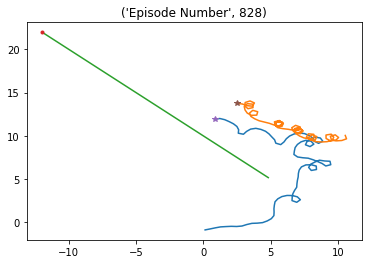

Episode * 829 * Avg Reward is ==> 3207.523150335911 : Ag1 Reward ==> 1409.7479207089182 : Ag2 Reward ==> 1534.3387098114983 


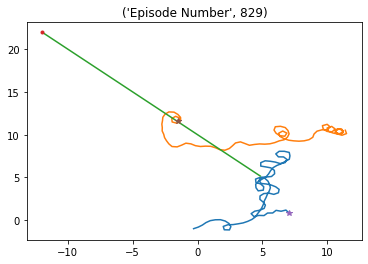

Episode * 830 * Avg Reward is ==> 3192.8311703395934 : Ag1 Reward ==> 1388.5870236916253 : Ag2 Reward ==> 1578.928404851726 


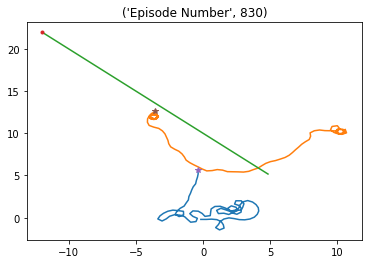

Episode * 831 * Avg Reward is ==> 3190.2396839893827 : Ag1 Reward ==> 1573.2078799116407 : Ag2 Reward ==> 1695.1275766761567 


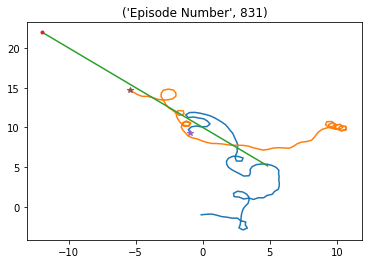

Episode * 832 * Avg Reward is ==> 3192.810164708386 : Ag1 Reward ==> 1270.1722368664755 : Ag2 Reward ==> 1538.943044616509 


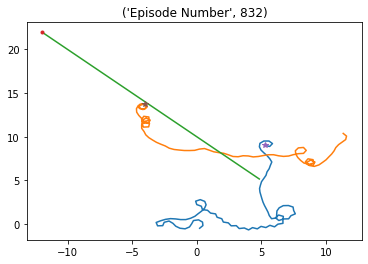

Episode * 833 * Avg Reward is ==> 3199.2346392732798 : Ag1 Reward ==> 1553.5606276452302 : Ag2 Reward ==> 1666.4552741467337 


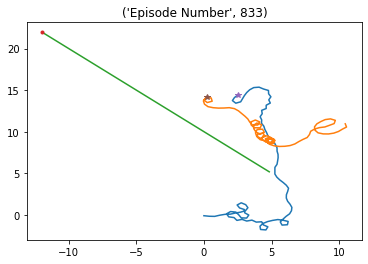

Episode * 834 * Avg Reward is ==> 3205.1767403346857 : Ag1 Reward ==> 1275.8214823131948 : Ag2 Reward ==> 1533.022532960949 


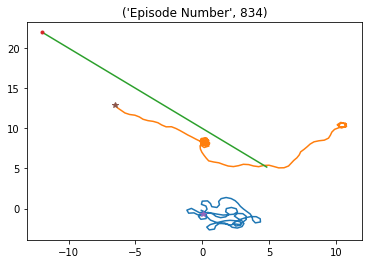

Episode * 835 * Avg Reward is ==> 3209.888679152097 : Ag1 Reward ==> 1514.288926591773 : Ag2 Reward ==> 1703.856391888171 


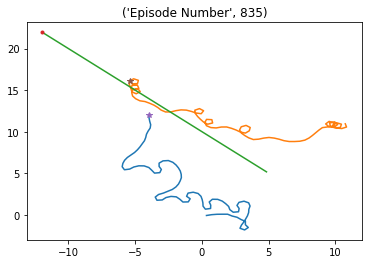

Episode * 836 * Avg Reward is ==> 3204.594698454475 : Ag1 Reward ==> 1445.034656254734 : Ag2 Reward ==> 1707.1672211585142 


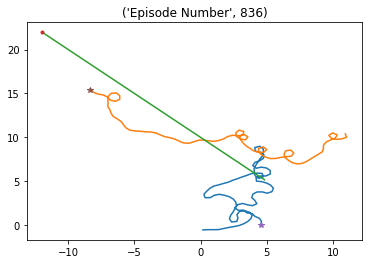

Episode * 837 * Avg Reward is ==> 3202.4157084669746 : Ag1 Reward ==> 1465.0531526325867 : Ag2 Reward ==> 1663.5561330446812 


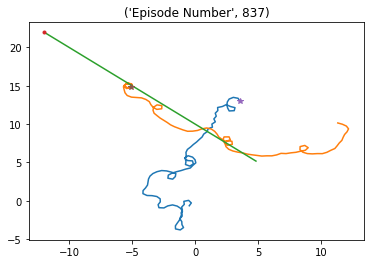

Episode * 838 * Avg Reward is ==> 3210.6049942057903 : Ag1 Reward ==> 1561.4762889887138 : Ag2 Reward ==> 1639.932656144538 


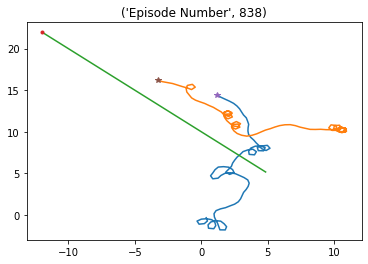

Episode * 839 * Avg Reward is ==> 3207.4756111166257 : Ag1 Reward ==> 1324.620908942101 : Ag2 Reward ==> 1661.9475876889599 


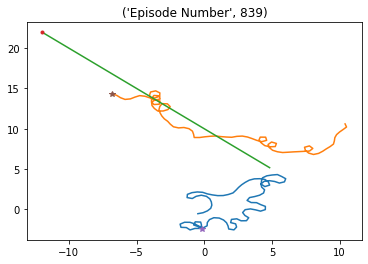

Episode * 840 * Avg Reward is ==> 3218.7013140873783 : Ag1 Reward ==> 1331.4497681771938 : Ag2 Reward ==> 1680.4245392984706 


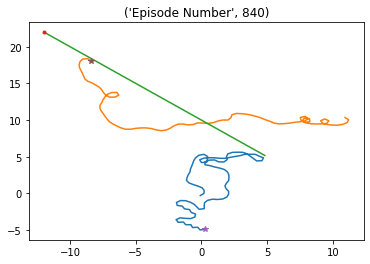

Episode * 841 * Avg Reward is ==> 3230.6293738719096 : Ag1 Reward ==> 1827.6676449554698 : Ag2 Reward ==> 2006.8679683558018 


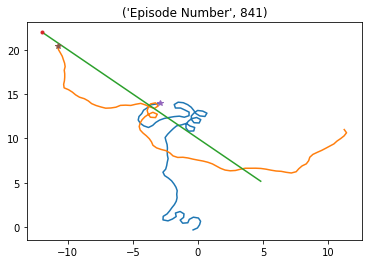

Episode * 842 * Avg Reward is ==> 3230.2927821784274 : Ag1 Reward ==> 1660.3874545491103 : Ag2 Reward ==> 1747.587372475728 


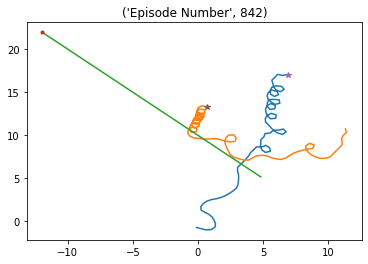

Episode * 843 * Avg Reward is ==> 3226.42458890391 : Ag1 Reward ==> 1581.3371339403147 : Ag2 Reward ==> 1751.9694194920862 


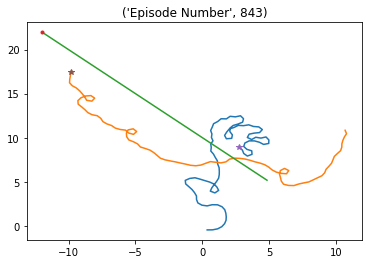

Episode * 844 * Avg Reward is ==> 3213.3256602615684 : Ag1 Reward ==> 1557.7319928963193 : Ag2 Reward ==> 1750.7652623219933 


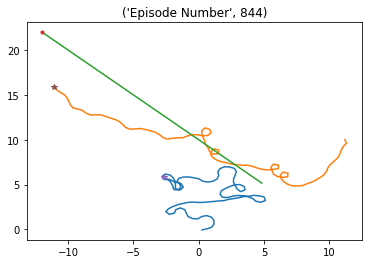

Episode * 845 * Avg Reward is ==> 3206.6311840046365 : Ag1 Reward ==> 1699.2794201654672 : Ag2 Reward ==> 1752.6704487641382 


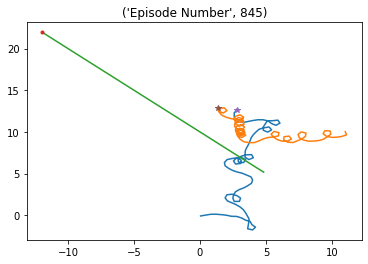

Episode * 846 * Avg Reward is ==> 3202.8439233841164 : Ag1 Reward ==> 1522.8942399372722 : Ag2 Reward ==> 1670.7953258179377 


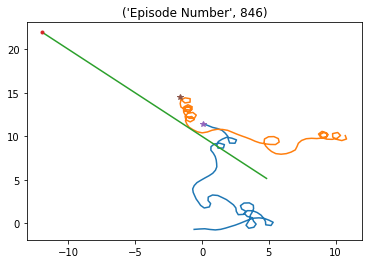

Episode * 847 * Avg Reward is ==> 3203.4087872966247 : Ag1 Reward ==> 1622.137741452121 : Ag2 Reward ==> 1846.2065712620513 


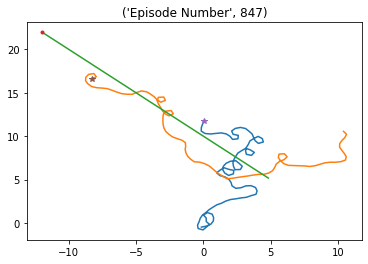

Episode * 848 * Avg Reward is ==> 3198.9465186537236 : Ag1 Reward ==> 1550.1959690147505 : Ag2 Reward ==> 1744.2514304391875 


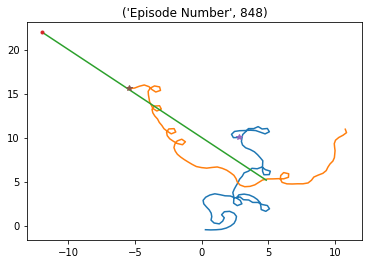

Episode * 849 * Avg Reward is ==> 3195.895630980503 : Ag1 Reward ==> 1451.0682523126952 : Ag2 Reward ==> 1620.7493944560606 


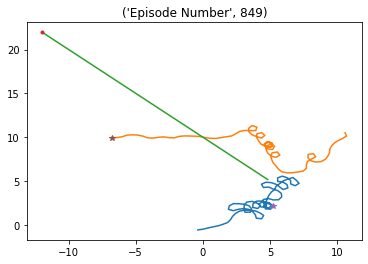

Episode * 850 * Avg Reward is ==> 3166.895820574379 : Ag1 Reward ==> 1180.0109406546414 : Ag2 Reward ==> 1326.136723252341 


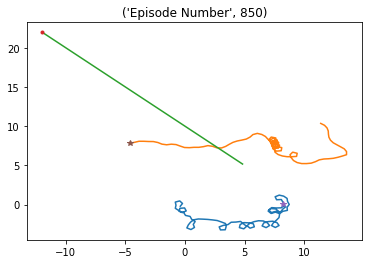

Episode * 851 * Avg Reward is ==> 3159.909829903604 : Ag1 Reward ==> 1316.724492699572 : Ag2 Reward ==> 1487.5788371878718 


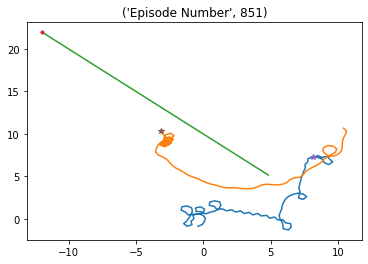

Episode * 852 * Avg Reward is ==> 3149.904248387537 : Ag1 Reward ==> 1387.0505014231744 : Ag2 Reward ==> 1528.2239592823514 


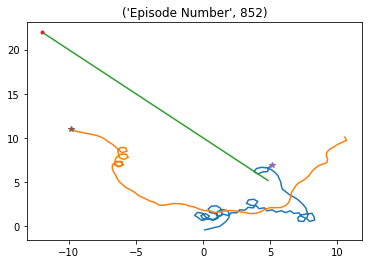

Episode * 853 * Avg Reward is ==> 3145.5212694687243 : Ag1 Reward ==> 1433.1645628826511 : Ag2 Reward ==> 1708.1152008206964 


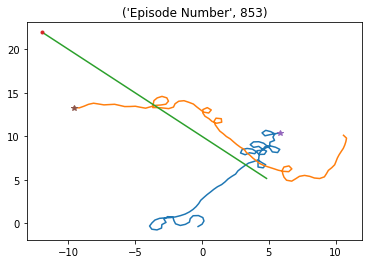

Episode * 854 * Avg Reward is ==> 3132.9717420234165 : Ag1 Reward ==> 1384.274405932826 : Ag2 Reward ==> 1581.226874912749 


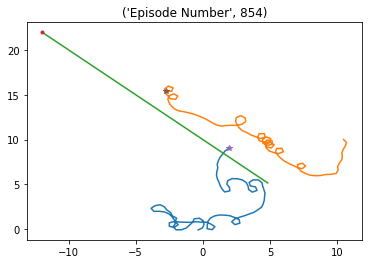

Episode * 855 * Avg Reward is ==> 3136.8759908152933 : Ag1 Reward ==> 1337.6870029018733 : Ag2 Reward ==> 1745.878221886621 


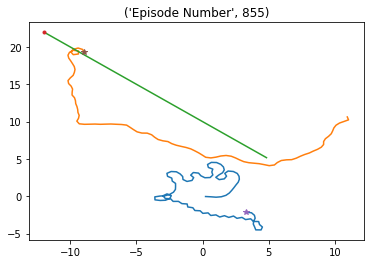

Episode * 856 * Avg Reward is ==> 3154.289699750182 : Ag1 Reward ==> 1590.3341727453114 : Ag2 Reward ==> 1768.609816492065 


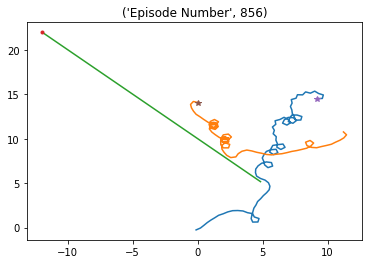

Episode * 857 * Avg Reward is ==> 3147.9585741677665 : Ag1 Reward ==> 1391.5606135034589 : Ag2 Reward ==> 1362.742593069628 


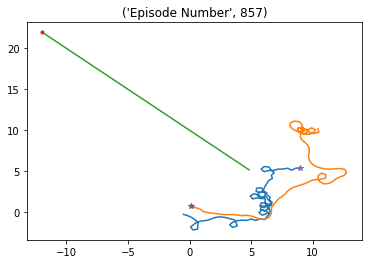

Episode * 858 * Avg Reward is ==> 3156.2795927055845 : Ag1 Reward ==> 1472.9160354871278 : Ag2 Reward ==> 1754.4962619394532 


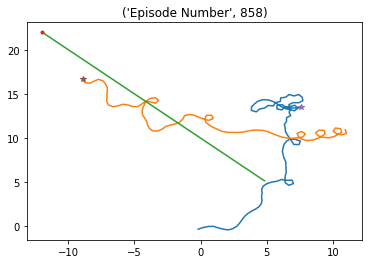

Episode * 859 * Avg Reward is ==> 3165.7997328149963 : Ag1 Reward ==> 1865.6637204111432 : Ag2 Reward ==> 1985.7856877719184 


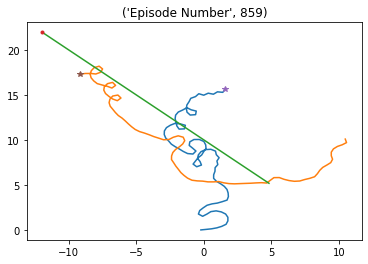

Episode * 860 * Avg Reward is ==> 3179.6170269598642 : Ag1 Reward ==> 1525.6392410260328 : Ag2 Reward ==> 1722.311024239446 


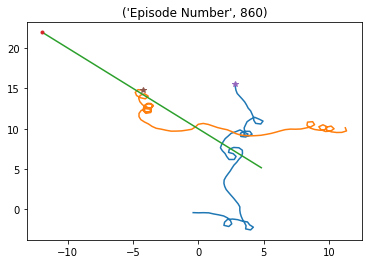

Episode * 861 * Avg Reward is ==> 3186.9695122282806 : Ag1 Reward ==> 1514.3171310052046 : Ag2 Reward ==> 1625.9122382364349 


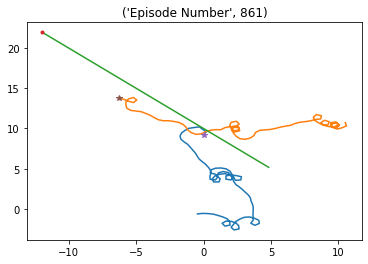

Episode * 862 * Avg Reward is ==> 3193.4511978953437 : Ag1 Reward ==> 1568.2980147066871 : Ag2 Reward ==> 1702.8712848701641 


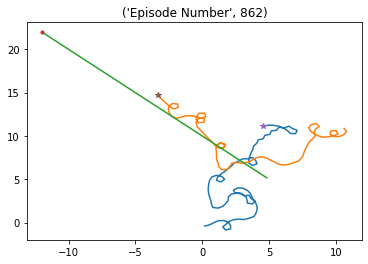

Episode * 863 * Avg Reward is ==> 3206.591966079607 : Ag1 Reward ==> 1481.8374388609748 : Ag2 Reward ==> 1708.2221182711426 


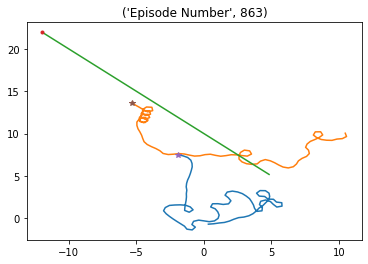

Episode * 864 * Avg Reward is ==> 3183.2652738245442 : Ag1 Reward ==> 1298.3142871339394 : Ag2 Reward ==> 1577.1147814012227 


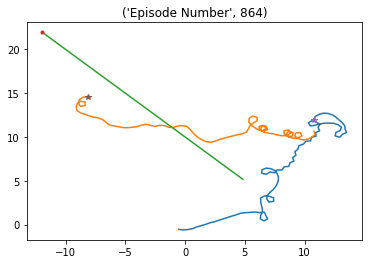

Episode * 865 * Avg Reward is ==> 3160.5515745199464 : Ag1 Reward ==> 1295.3102109581025 : Ag2 Reward ==> 1630.1242018125365 


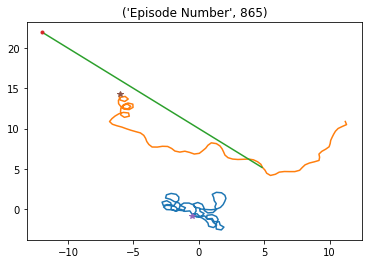

Episode * 866 * Avg Reward is ==> 3163.1769951396973 : Ag1 Reward ==> 1396.258295745997 : Ag2 Reward ==> 1681.0384370822303 


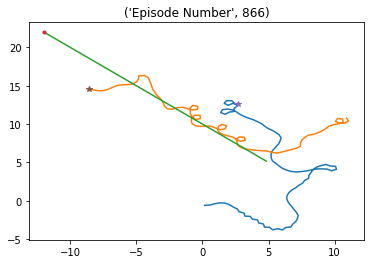

Episode * 867 * Avg Reward is ==> 3150.997793125628 : Ag1 Reward ==> 1591.645616284673 : Ag2 Reward ==> 1675.827533613862 


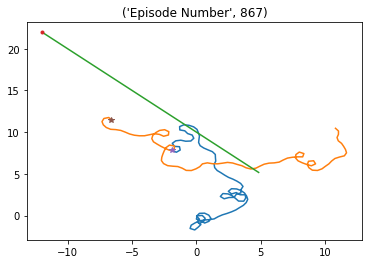

Episode * 868 * Avg Reward is ==> 3141.405149471146 : Ag1 Reward ==> 1402.8682317791227 : Ag2 Reward ==> 1568.8312789410031 


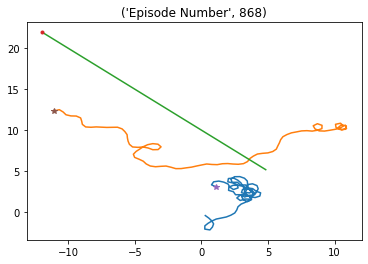

Episode * 869 * Avg Reward is ==> 3139.5936512854328 : Ag1 Reward ==> 1334.2706286888288 : Ag2 Reward ==> 1537.3560744030585 


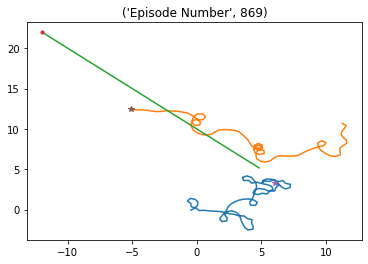

Episode * 870 * Avg Reward is ==> 3140.46228203087 : Ag1 Reward ==> 1422.3897779192685 : Ag2 Reward ==> 1579.8708804415728 


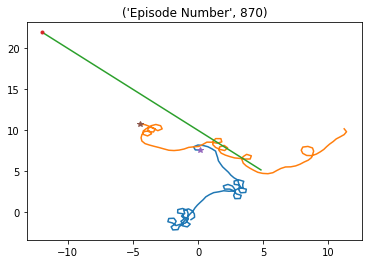

Episode * 871 * Avg Reward is ==> 3139.2173235463124 : Ag1 Reward ==> 1530.374876768092 : Ag2 Reward ==> 1688.1622404373857 


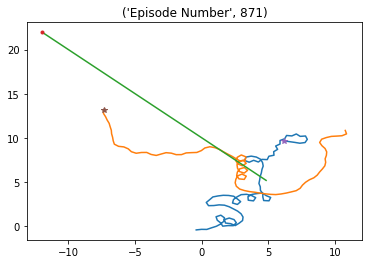

Episode * 872 * Avg Reward is ==> 3147.0461328857973 : Ag1 Reward ==> 1491.329907667961 : Ag2 Reward ==> 1630.9377473944319 


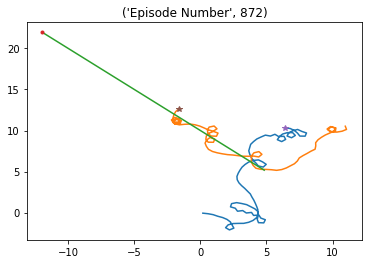

Episode * 873 * Avg Reward is ==> 3151.596640302242 : Ag1 Reward ==> 1629.9074636941195 : Ag2 Reward ==> 1772.128734755633 


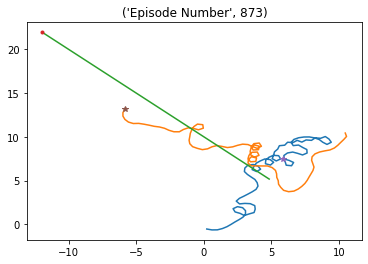

Episode * 874 * Avg Reward is ==> 3148.7975368566717 : Ag1 Reward ==> 1253.1797772843563 : Ag2 Reward ==> 1443.7001001669607 


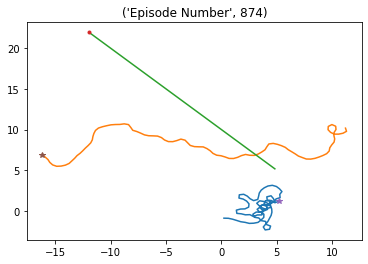

Episode * 875 * Avg Reward is ==> 3138.6170753628185 : Ag1 Reward ==> 1293.0525747136016 : Ag2 Reward ==> 1517.8742840122195 


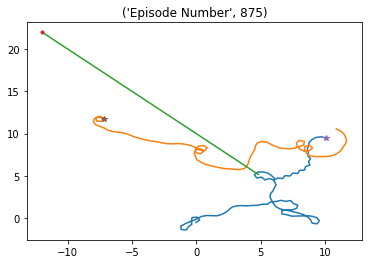

Episode * 876 * Avg Reward is ==> 3120.3634733772533 : Ag1 Reward ==> 954.5319821889714 : Ag2 Reward ==> 1467.525815801678 


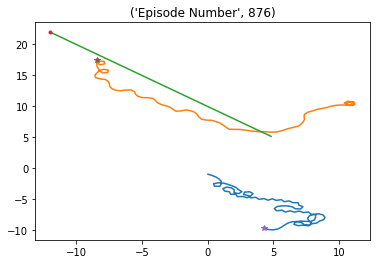

Episode * 877 * Avg Reward is ==> 3110.94806435153 : Ag1 Reward ==> 1241.8045379232042 : Ag2 Reward ==> 1510.1883867251086 


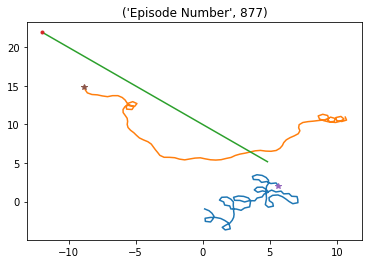

Episode * 878 * Avg Reward is ==> 3102.860912324702 : Ag1 Reward ==> 1354.8626697697944 : Ag2 Reward ==> 1523.0601942903559 


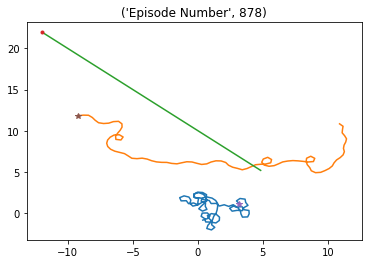

Episode * 879 * Avg Reward is ==> 3110.558227073709 : Ag1 Reward ==> 1514.0156968224153 : Ag2 Reward ==> 1780.4453897689139 


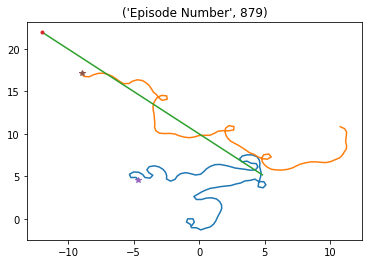

Episode * 880 * Avg Reward is ==> 3115.447785508515 : Ag1 Reward ==> 1486.6686592883555 : Ag2 Reward ==> 1720.7879855795677 


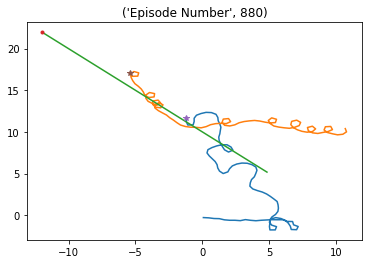

Episode * 881 * Avg Reward is ==> 3091.8125031002664 : Ag1 Reward ==> 1354.4763532038287 : Ag2 Reward ==> 1534.6479637774823 


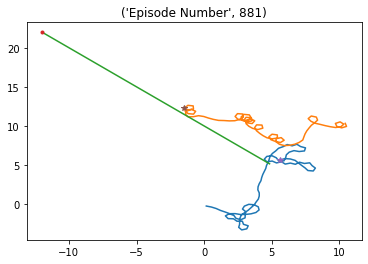

Episode * 882 * Avg Reward is ==> 3093.30885484017 : Ag1 Reward ==> 1659.5057810724109 : Ag2 Reward ==> 1808.3231155485828 


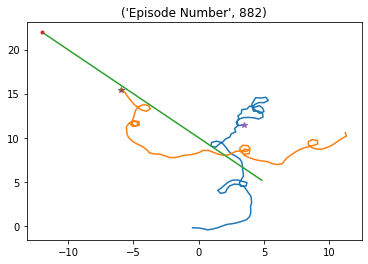

Episode * 883 * Avg Reward is ==> 3090.801054908171 : Ag1 Reward ==> 1447.4170798712507 : Ag2 Reward ==> 1785.5774762811873 


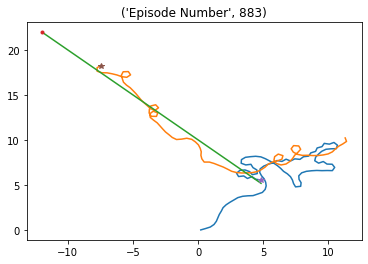

Episode * 884 * Avg Reward is ==> 3077.9694211647775 : Ag1 Reward ==> 1183.1316271957235 : Ag2 Reward ==> 1612.1002782868434 


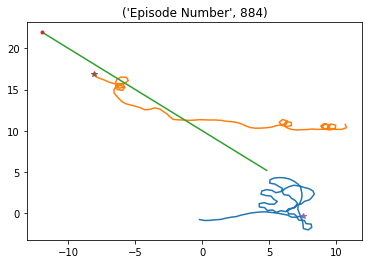

Episode * 885 * Avg Reward is ==> 3066.9898310147473 : Ag1 Reward ==> 1427.9503790414497 : Ag2 Reward ==> 1584.8158838869613 


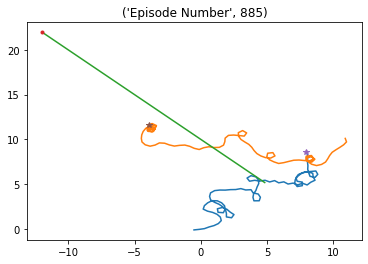

Episode * 886 * Avg Reward is ==> 3060.5182520324634 : Ag1 Reward ==> 1343.8708410884785 : Ag2 Reward ==> 1590.955565375363 


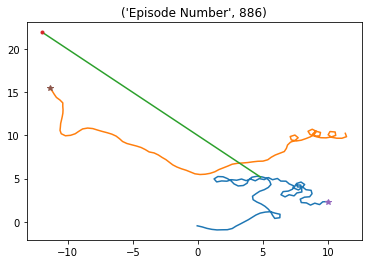

Episode * 887 * Avg Reward is ==> 3051.9285306863435 : Ag1 Reward ==> 1439.2373903728446 : Ag2 Reward ==> 1685.5180684965408 


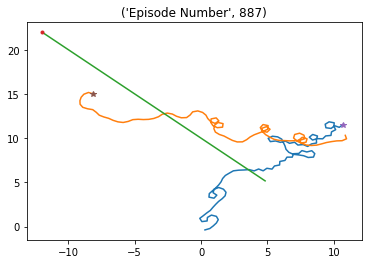

Episode * 888 * Avg Reward is ==> 3044.900064931671 : Ag1 Reward ==> 1421.9367071498484 : Ag2 Reward ==> 1591.3720621171717 


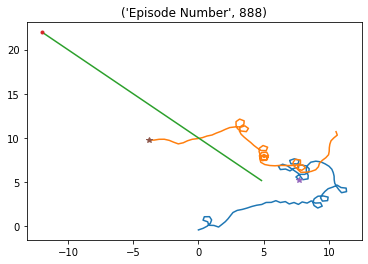

Episode * 889 * Avg Reward is ==> 3045.7094411695844 : Ag1 Reward ==> 1400.7738760588318 : Ag2 Reward ==> 1703.4188202264609 


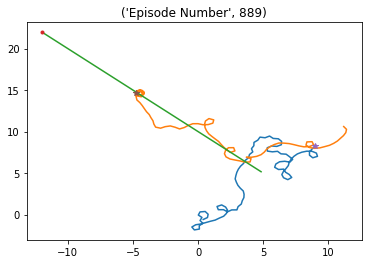

Episode * 890 * Avg Reward is ==> 3058.9215626483447 : Ag1 Reward ==> 1496.7616269112925 : Ag2 Reward ==> 1537.8708961461136 


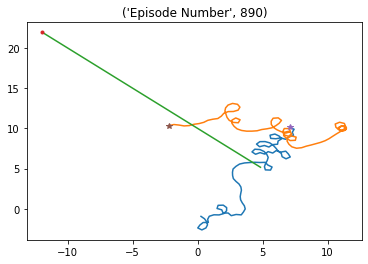

Episode * 891 * Avg Reward is ==> 3071.3757878100428 : Ag1 Reward ==> 1614.2917621975973 : Ag2 Reward ==> 1688.180574157751 


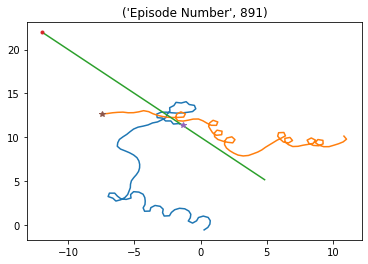

Episode * 892 * Avg Reward is ==> 3072.7061848313097 : Ag1 Reward ==> 1392.520730761458 : Ag2 Reward ==> 1575.969610794753 


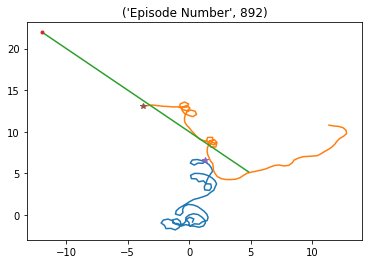

Episode * 893 * Avg Reward is ==> 3066.3304466293 : Ag1 Reward ==> 1360.8114733394514 : Ag2 Reward ==> 1525.4387622834997 


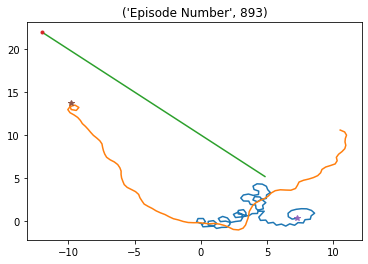

Episode * 894 * Avg Reward is ==> 3068.0032898078957 : Ag1 Reward ==> 1445.41661726842 : Ag2 Reward ==> 1586.9983907209803 


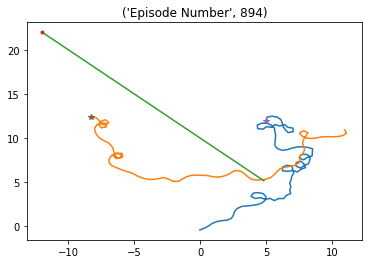

Episode * 895 * Avg Reward is ==> 3052.8899369400287 : Ag1 Reward ==> 978.6460945668232 : Ag2 Reward ==> 1500.3850155070083 


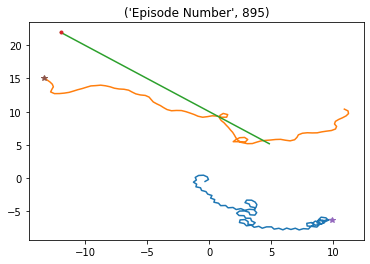

Episode * 896 * Avg Reward is ==> 3047.2290616186956 : Ag1 Reward ==> 1524.4558046421241 : Ag2 Reward ==> 1608.0531717419283 


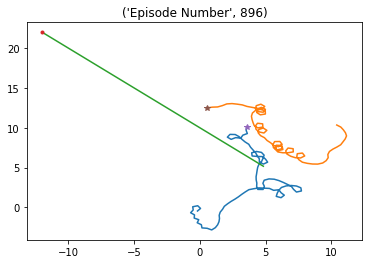

Episode * 897 * Avg Reward is ==> 3064.8786590664995 : Ag1 Reward ==> 1688.873714393182 : Ag2 Reward ==> 1771.4133900920556 


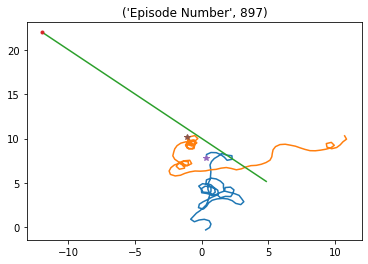

Episode * 898 * Avg Reward is ==> 3073.376649112671 : Ag1 Reward ==> 1801.5638819225396 : Ag2 Reward ==> 1765.7680173509161 


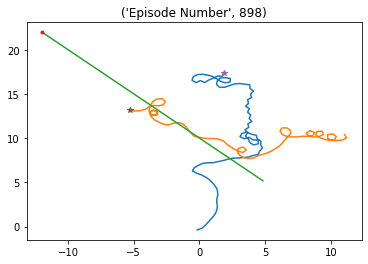

Episode * 899 * Avg Reward is ==> 3061.9217595399205 : Ag1 Reward ==> 1633.7314187862685 : Ag2 Reward ==> 1759.5224064867464 


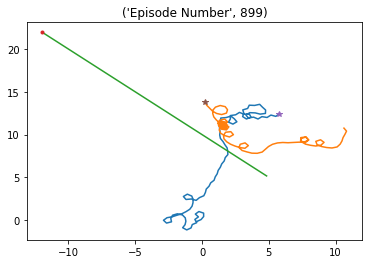

Episode * 900 * Avg Reward is ==> 3047.8846028111902 : Ag1 Reward ==> 1033.3026729297494 : Ag2 Reward ==> 1653.1613231865376 


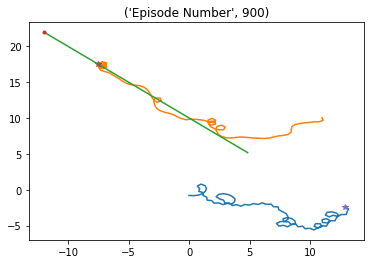

Episode * 901 * Avg Reward is ==> 3068.1276954818954 : Ag1 Reward ==> 1866.3646923559922 : Ag2 Reward ==> 2083.5883837138317 


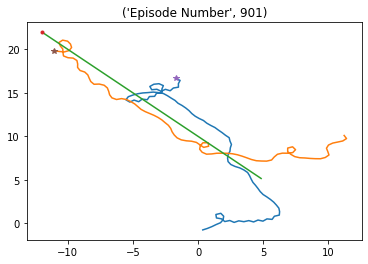

Episode * 902 * Avg Reward is ==> 3047.461518632596 : Ag1 Reward ==> 1132.124011970711 : Ag2 Reward ==> 1312.398213634169 


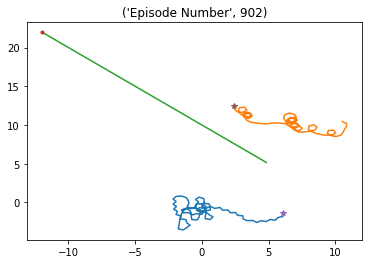

Episode * 903 * Avg Reward is ==> 3034.4021063623477 : Ag1 Reward ==> 1216.8797015868454 : Ag2 Reward ==> 1450.8033647353388 


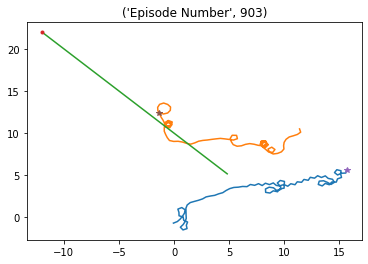

Episode * 904 * Avg Reward is ==> 3021.2579214388597 : Ag1 Reward ==> 1066.111715865579 : Ag2 Reward ==> 1283.5499557300702 


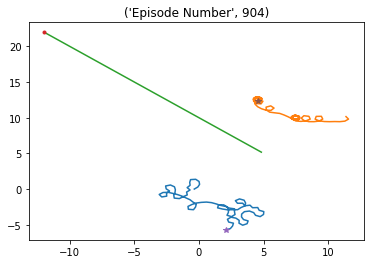

Episode * 905 * Avg Reward is ==> 3013.4349134647846 : Ag1 Reward ==> 1265.345373613769 : Ag2 Reward ==> 1347.1687201938805 


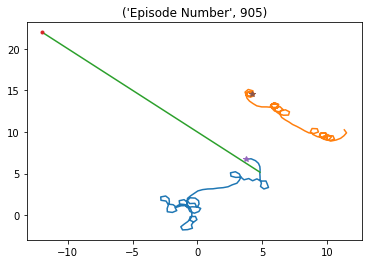

Episode * 906 * Avg Reward is ==> 3000.0963072852355 : Ag1 Reward ==> 1123.6633672337468 : Ag2 Reward ==> 1420.0891184124987 


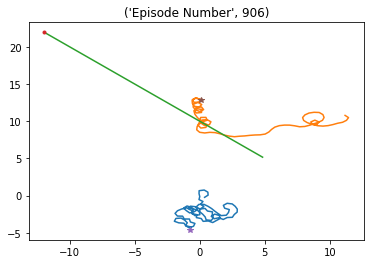

Episode * 907 * Avg Reward is ==> 3000.819486250302 : Ag1 Reward ==> 1502.6928780615294 : Ag2 Reward ==> 1793.7074304396597 


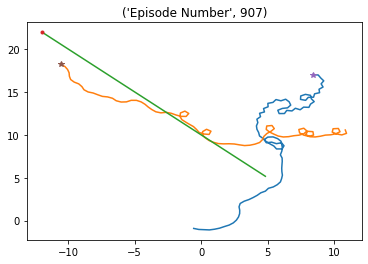

Episode * 908 * Avg Reward is ==> 3020.2700414751275 : Ag1 Reward ==> 1835.1890948793546 : Ag2 Reward ==> 1914.5326248337915 


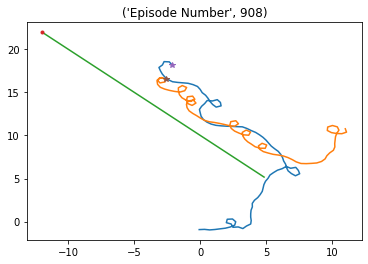

Episode * 909 * Avg Reward is ==> 3016.33285215472 : Ag1 Reward ==> 1202.9295273606083 : Ag2 Reward ==> 1511.209602914999 


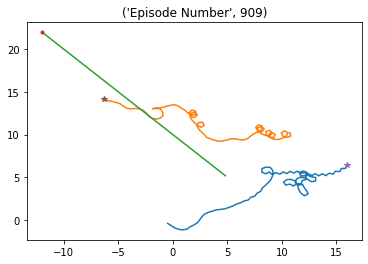

Episode * 910 * Avg Reward is ==> 3031.0565939222483 : Ag1 Reward ==> 1763.8464859930789 : Ag2 Reward ==> 1827.3638430688713 


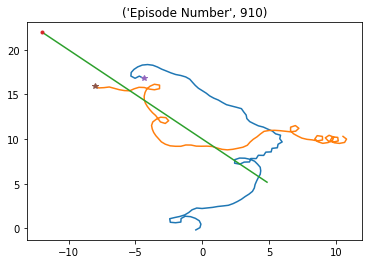

Episode * 911 * Avg Reward is ==> 3034.370647621343 : Ag1 Reward ==> 1584.0559314101681 : Ag2 Reward ==> 1767.043333759102 


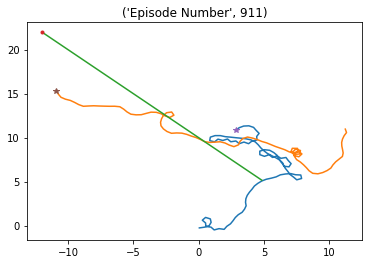

Episode * 912 * Avg Reward is ==> 3027.0117898751364 : Ag1 Reward ==> 1195.4929034173235 : Ag2 Reward ==> 1632.4204417968044 


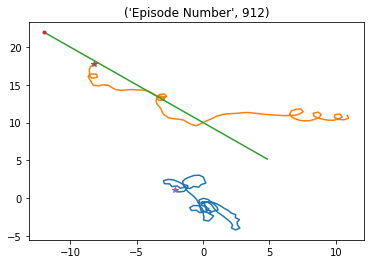

Episode * 913 * Avg Reward is ==> 3008.8501799847845 : Ag1 Reward ==> 1170.9472257553211 : Ag2 Reward ==> 1504.6245770803569 


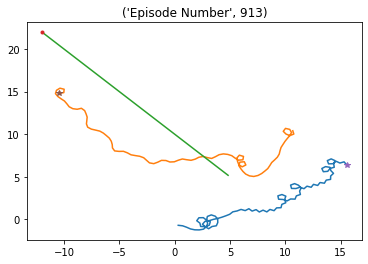

Episode * 914 * Avg Reward is ==> 3007.1146200561707 : Ag1 Reward ==> 1125.5293737174713 : Ag2 Reward ==> 1501.9281065892844 


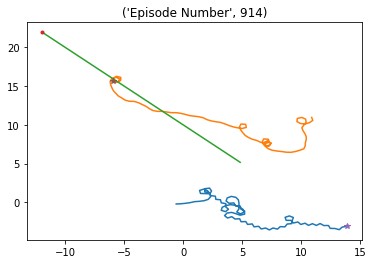

Episode * 915 * Avg Reward is ==> 3009.0673938392674 : Ag1 Reward ==> 1426.1749818922567 : Ag2 Reward ==> 1462.8628281574386 


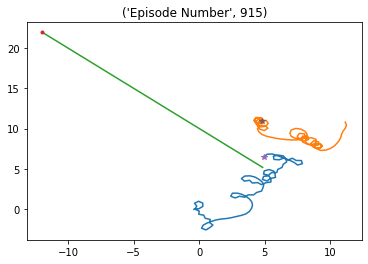

Episode * 916 * Avg Reward is ==> 3035.416779883139 : Ag1 Reward ==> 1725.8405675111337 : Ag2 Reward ==> 1750.192672234386 


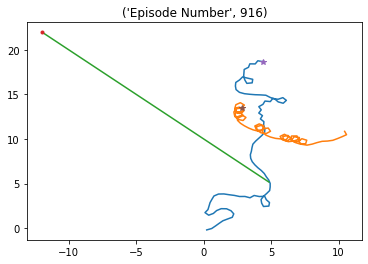

Episode * 917 * Avg Reward is ==> 3036.564927006318 : Ag1 Reward ==> 1227.487491443574 : Ag2 Reward ==> 1570.4313181319103 


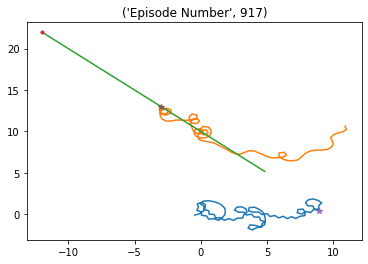

Episode * 918 * Avg Reward is ==> 3043.9979023268843 : Ag1 Reward ==> 1337.9126998580462 : Ag2 Reward ==> 1837.3291770247433 


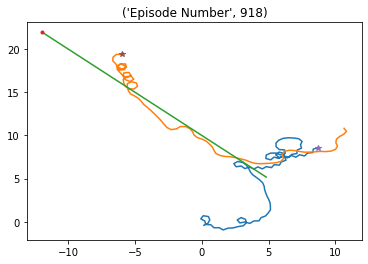

Episode * 919 * Avg Reward is ==> 3036.2555899260697 : Ag1 Reward ==> 1387.1504924713786 : Ag2 Reward ==> 1597.6180980873762 


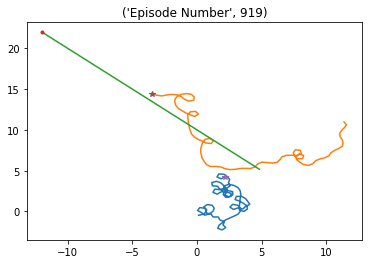

Episode * 920 * Avg Reward is ==> 3026.982529517358 : Ag1 Reward ==> 1262.1846374861063 : Ag2 Reward ==> 1574.349591033344 


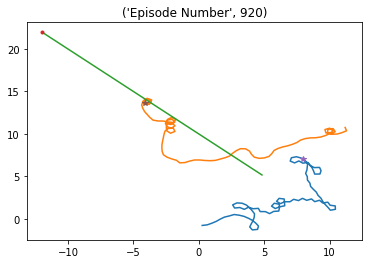

Episode * 921 * Avg Reward is ==> 3036.306850262663 : Ag1 Reward ==> 1392.9844224320148 : Ag2 Reward ==> 1869.1127243614926 


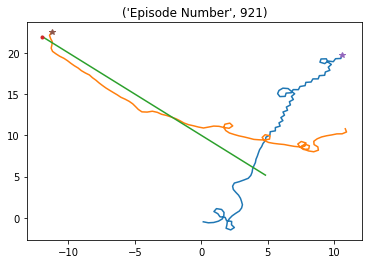

Episode * 922 * Avg Reward is ==> 3017.453758817673 : Ag1 Reward ==> 1129.675529563167 : Ag2 Reward ==> 1584.0297092582377 


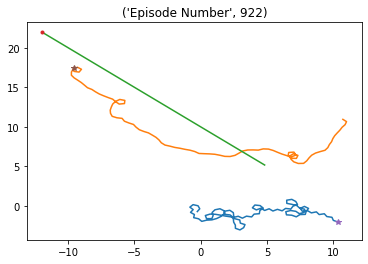

Episode * 923 * Avg Reward is ==> 3021.803652321969 : Ag1 Reward ==> 1584.0228767612334 : Ag2 Reward ==> 1822.9674195630382 


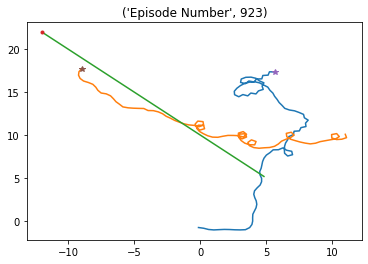

Episode * 924 * Avg Reward is ==> 3016.3063397454544 : Ag1 Reward ==> 1055.479915972858 : Ag2 Reward ==> 1519.8594864491265 


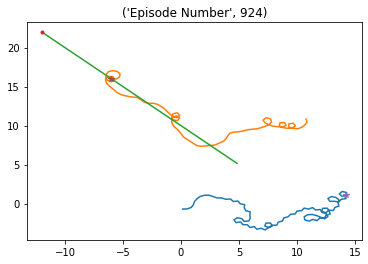

Episode * 925 * Avg Reward is ==> 3016.13878997572 : Ag1 Reward ==> 1376.7214041481814 : Ag2 Reward ==> 1629.3428679908563 


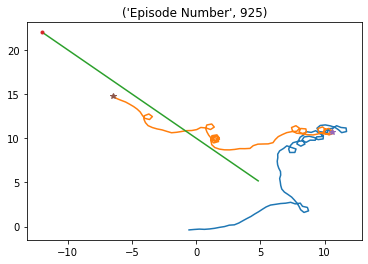

Episode * 926 * Avg Reward is ==> 3015.3988319089904 : Ag1 Reward ==> 1154.8249607641978 : Ag2 Reward ==> 1750.4031230304718 


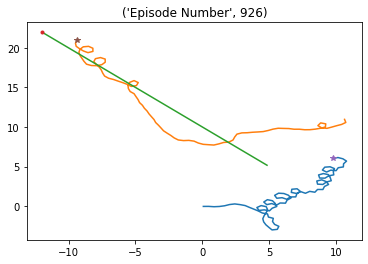

Episode * 927 * Avg Reward is ==> 3009.6541990027786 : Ag1 Reward ==> 1305.620586954249 : Ag2 Reward ==> 1589.349555666661 


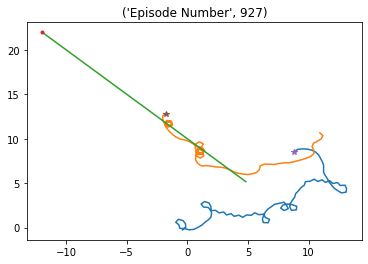

Episode * 928 * Avg Reward is ==> 3026.1698937893166 : Ag1 Reward ==> 1707.2442616443568 : Ag2 Reward ==> 1966.6922990841667 


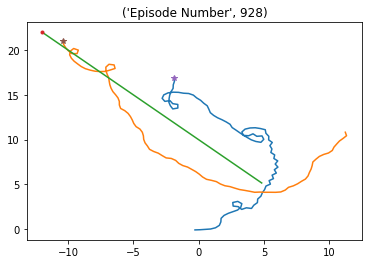

Episode * 929 * Avg Reward is ==> 3033.729790906559 : Ag1 Reward ==> 1512.5562699450234 : Ag2 Reward ==> 1894.0323110299832 


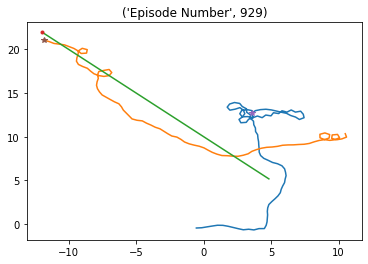

Episode * 930 * Avg Reward is ==> 3031.2127120894656 : Ag1 Reward ==> 1254.6419480819723 : Ag2 Reward ==> 1679.3074222916948 


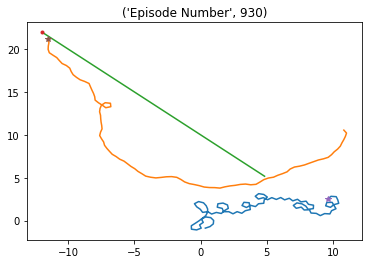

Episode * 931 * Avg Reward is ==> 3027.223786254611 : Ag1 Reward ==> 1487.699875408706 : Ag2 Reward ==> 1655.2154275524308 


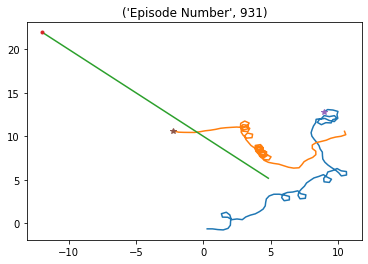

Episode * 932 * Avg Reward is ==> 3017.7006821618675 : Ag1 Reward ==> 1165.328369490418 : Ag2 Reward ==> 1422.2378083560725 


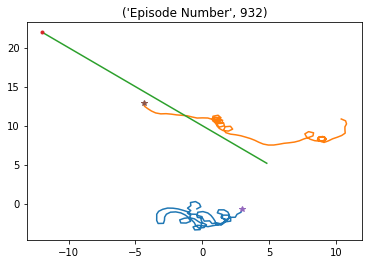

Episode * 933 * Avg Reward is ==> 3008.7118663503757 : Ag1 Reward ==> 955.9070043452065 : Ag2 Reward ==> 1570.7905988180653 


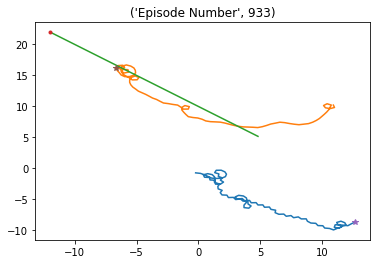

Episode * 934 * Avg Reward is ==> 3017.2951970116496 : Ag1 Reward ==> 1607.5405076785516 : Ag2 Reward ==> 1768.2077267618286 


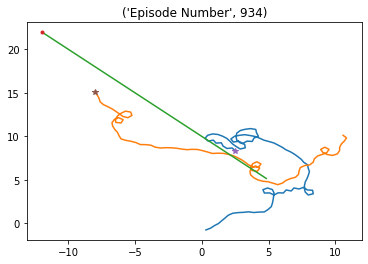

Episode * 935 * Avg Reward is ==> 3028.8792009311123 : Ag1 Reward ==> 1377.468541032463 : Ag2 Reward ==> 1564.9227258198673 


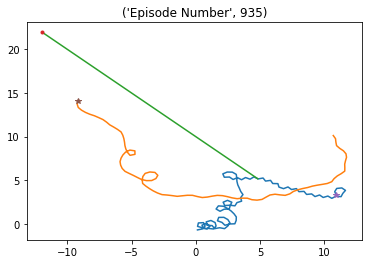

Episode * 936 * Avg Reward is ==> 3033.4132029122693 : Ag1 Reward ==> 1588.0808907992605 : Ag2 Reward ==> 1725.7881648310818 


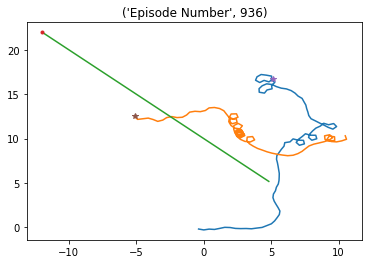

Episode * 937 * Avg Reward is ==> 3039.1439929526305 : Ag1 Reward ==> 1730.2344767336847 : Ag2 Reward ==> 1959.2842293659946 


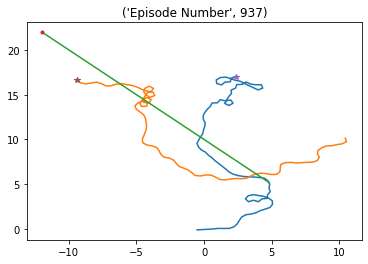

Episode * 938 * Avg Reward is ==> 3043.4731615399533 : Ag1 Reward ==> 1827.5038093629562 : Ag2 Reward ==> 1912.9948334033995 


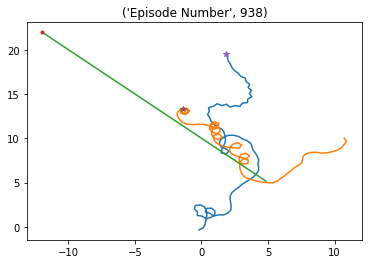

Episode * 939 * Avg Reward is ==> 3020.307729169736 : Ag1 Reward ==> 1109.3151312839 : Ag2 Reward ==> 1357.3213991804273 


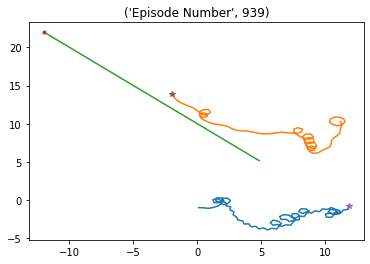

Episode * 940 * Avg Reward is ==> 3043.065162354953 : Ag1 Reward ==> 1651.2958860499311 : Ag2 Reward ==> 1945.4654374750226 


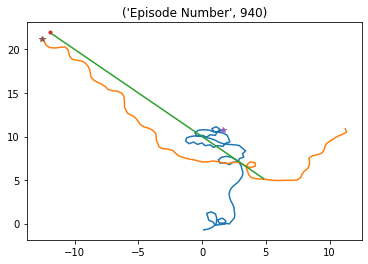

Episode * 941 * Avg Reward is ==> 3019.8514311333347 : Ag1 Reward ==> 1401.6719242251422 : Ag2 Reward ==> 1619.731902979954 


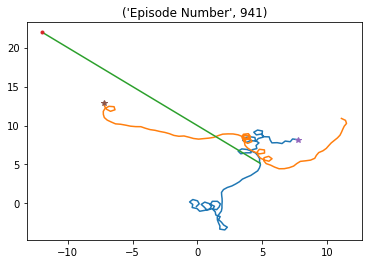

Episode * 942 * Avg Reward is ==> 3037.658376649347 : Ag1 Reward ==> 1533.4917002377042 : Ag2 Reward ==> 1623.308346007653 


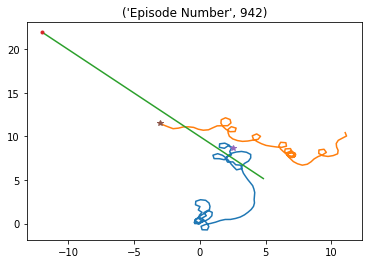

Episode * 943 * Avg Reward is ==> 3048.666493234032 : Ag1 Reward ==> 1450.0762390314612 : Ag2 Reward ==> 1657.9314906781472 


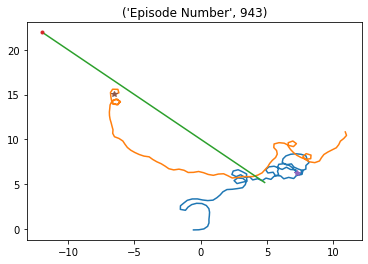

Episode * 944 * Avg Reward is ==> 3055.3828480597854 : Ag1 Reward ==> 1144.7438972651514 : Ag2 Reward ==> 1473.5719673606275 


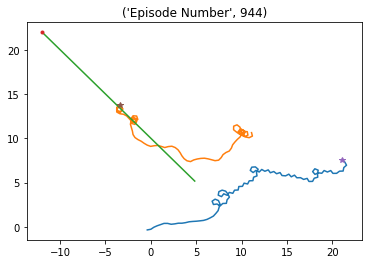

Episode * 945 * Avg Reward is ==> 3062.3923015868177 : Ag1 Reward ==> 1302.2049562911445 : Ag2 Reward ==> 1590.687278597804 


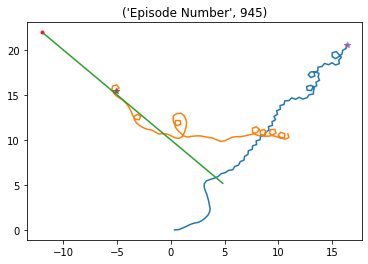

Episode * 946 * Avg Reward is ==> 3063.9042493730944 : Ag1 Reward ==> 1210.952921800783 : Ag2 Reward ==> 1393.2774752965124 


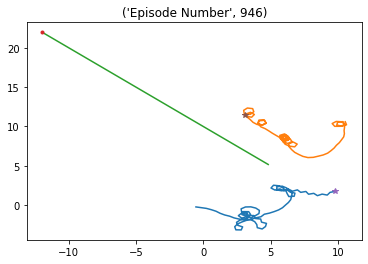

Episode * 947 * Avg Reward is ==> 3045.61309557201 : Ag1 Reward ==> 1056.6272789552822 : Ag2 Reward ==> 1508.1268775025462 


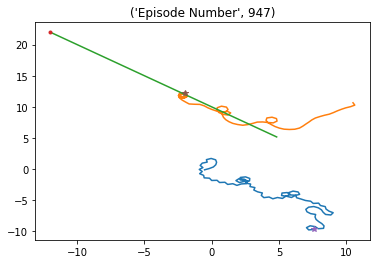

Episode * 948 * Avg Reward is ==> 3026.871547116195 : Ag1 Reward ==> 1403.15272407585 : Ag2 Reward ==> 1596.9070574047032 


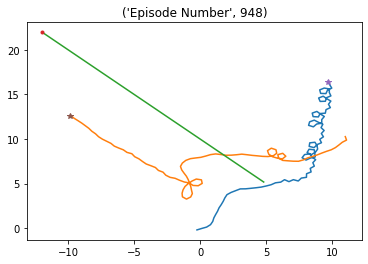

Episode * 949 * Avg Reward is ==> 3032.457127122821 : Ag1 Reward ==> 1321.0174916112976 : Ag2 Reward ==> 1616.5448389293551 


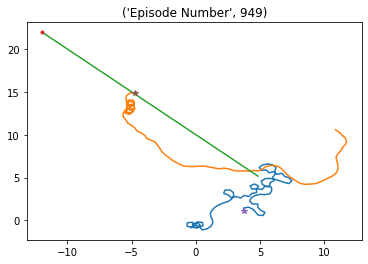

Episode * 950 * Avg Reward is ==> 3013.7223631576408 : Ag1 Reward ==> 1220.0296521859505 : Ag2 Reward ==> 1621.7901182687785 


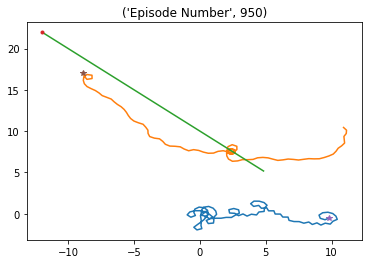

Episode * 951 * Avg Reward is ==> 3014.4711738898395 : Ag1 Reward ==> 1527.0608816425554 : Ag2 Reward ==> 1853.9908128146803 


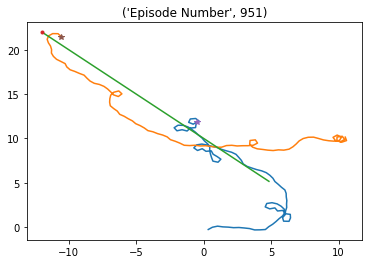

Episode * 952 * Avg Reward is ==> 3013.2863258876873 : Ag1 Reward ==> 1261.815031870208 : Ag2 Reward ==> 1518.7043932578313 


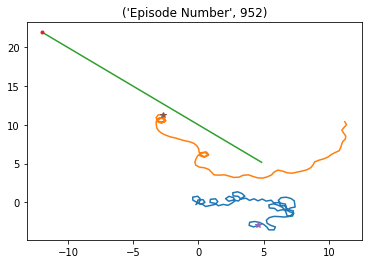

Episode * 953 * Avg Reward is ==> 3018.9651899229398 : Ag1 Reward ==> 1191.1044452592082 : Ag2 Reward ==> 1711.6219189865533 


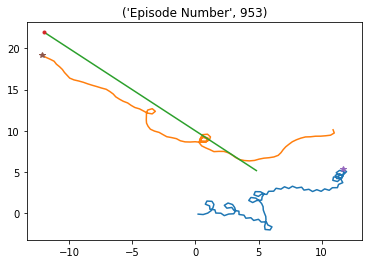

Episode * 954 * Avg Reward is ==> 3026.639518817836 : Ag1 Reward ==> 1216.523738140561 : Ag2 Reward ==> 1717.906897962035 


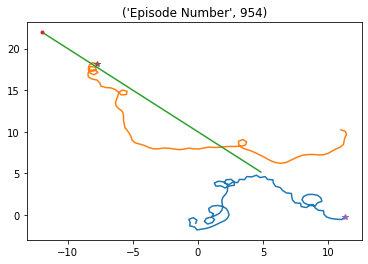

Episode * 955 * Avg Reward is ==> 3019.318799462615 : Ag1 Reward ==> 1040.4376458669046 : Ag2 Reward ==> 1555.7713899739604 


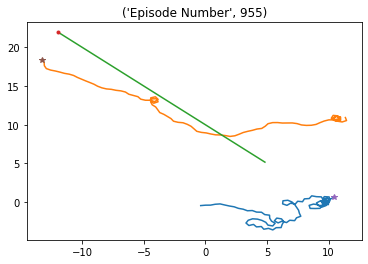

Episode * 956 * Avg Reward is ==> 3007.979911548183 : Ag1 Reward ==> 1367.1069803289197 : Ag2 Reward ==> 1655.3707428393177 


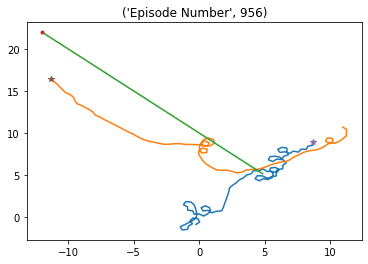

Episode * 957 * Avg Reward is ==> 3022.232668624888 : Ag1 Reward ==> 1565.6470940307224 : Ag2 Reward ==> 1802.3819986129565 


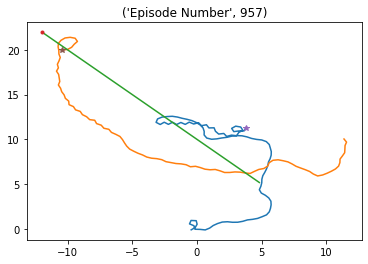

Episode * 958 * Avg Reward is ==> 3009.049053459198 : Ag1 Reward ==> 1167.5706915620478 : Ag2 Reward ==> 1480.326578693162 


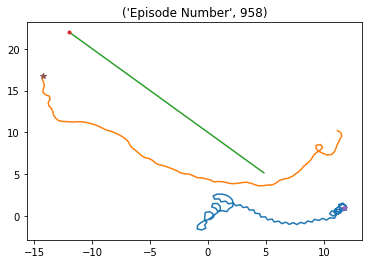

Episode * 959 * Avg Reward is ==> 3008.565851150611 : Ag1 Reward ==> 1319.9869584481694 : Ag2 Reward ==> 1645.4535397670932 


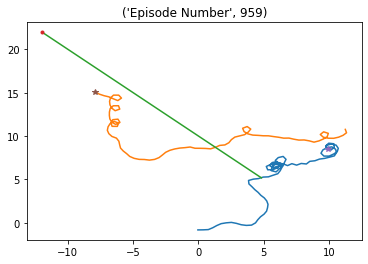

Episode * 960 * Avg Reward is ==> 3017.685248929338 : Ag1 Reward ==> 1376.9488592157254 : Ag2 Reward ==> 1824.3612804528027 


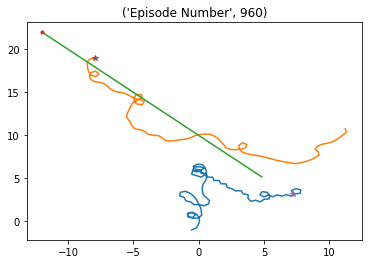

Episode * 961 * Avg Reward is ==> 3020.266132569023 : Ag1 Reward ==> 1556.1956994664608 : Ag2 Reward ==> 1809.1367929144214 


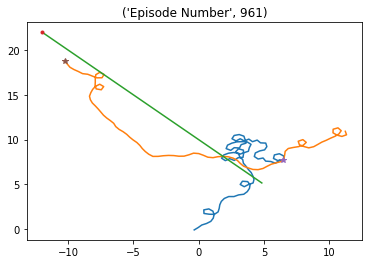

Episode * 962 * Avg Reward is ==> 3029.93182615259 : Ag1 Reward ==> 1323.523114254106 : Ag2 Reward ==> 1776.8098679099944 


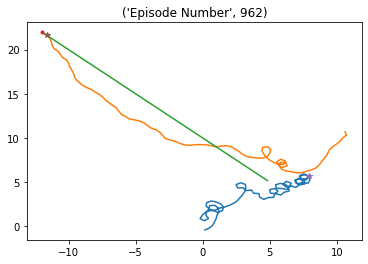

Episode * 963 * Avg Reward is ==> 3013.929670869483 : Ag1 Reward ==> 1252.9398641656248 : Ag2 Reward ==> 1513.9642208343548 


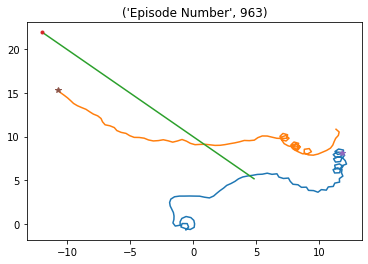

Episode * 964 * Avg Reward is ==> 3038.783418834454 : Ag1 Reward ==> 1661.741332000581 : Ag2 Reward ==> 1907.7479890202615 


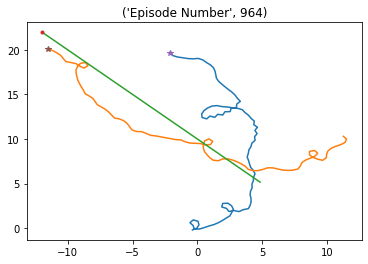

Episode * 965 * Avg Reward is ==> 3046.1877304428576 : Ag1 Reward ==> 1405.7810867054823 : Ag2 Reward ==> 1896.4556497696942 


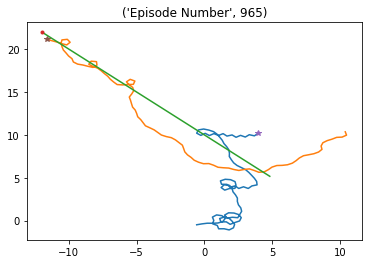

Episode * 966 * Avg Reward is ==> 3039.511368827697 : Ag1 Reward ==> 1139.1148990721879 : Ag2 Reward ==> 1499.0587201160654 


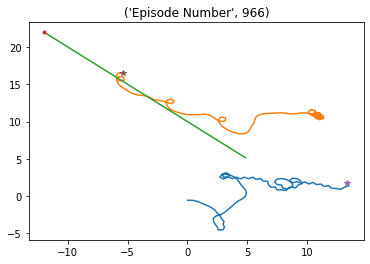

Episode * 967 * Avg Reward is ==> 3029.480676781303 : Ag1 Reward ==> 1037.3058838968666 : Ag2 Reward ==> 1456.436576868277 


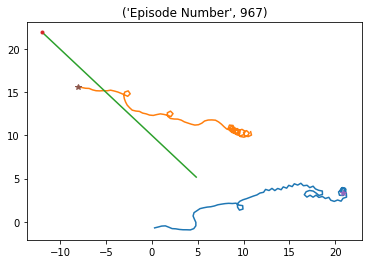

Episode * 968 * Avg Reward is ==> 3013.1739355262844 : Ag1 Reward ==> 1396.1584330503308 : Ag2 Reward ==> 1625.508477477457 


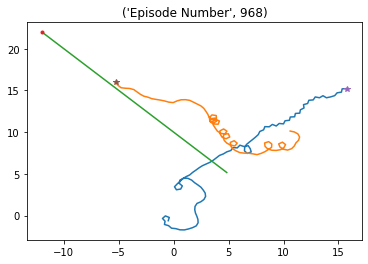

Episode * 969 * Avg Reward is ==> 2995.044749029703 : Ag1 Reward ==> 1126.0026865575842 : Ag2 Reward ==> 1555.4184345541528 


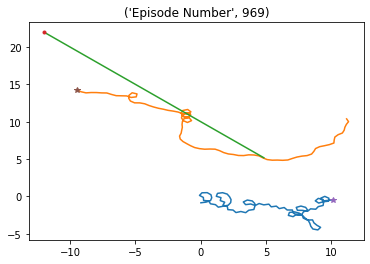

Episode * 970 * Avg Reward is ==> 2999.031501855661 : Ag1 Reward ==> 1517.3235121893727 : Ag2 Reward ==> 1576.0959712226436 


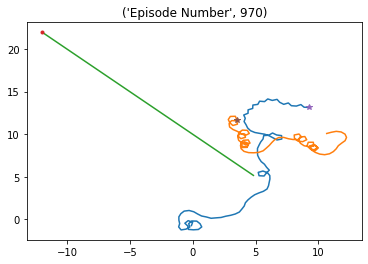

Episode * 971 * Avg Reward is ==> 2984.485863641028 : Ag1 Reward ==> 1151.3345008956364 : Ag2 Reward ==> 1409.7552734801764 


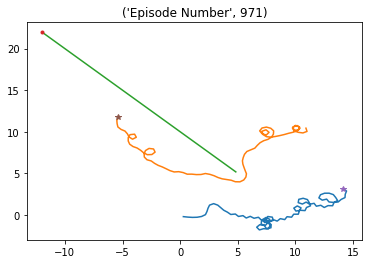

Episode * 972 * Avg Reward is ==> 2996.8561056329963 : Ag1 Reward ==> 1334.7899000591694 : Ag2 Reward ==> 1747.585957466035 


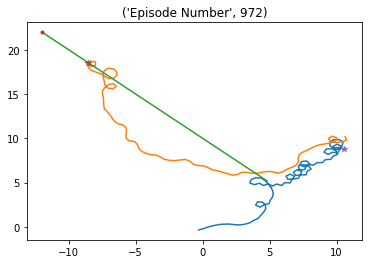

Episode * 973 * Avg Reward is ==> 3006.5056683266826 : Ag1 Reward ==> 1298.8739675764937 : Ag2 Reward ==> 1613.806143334234 


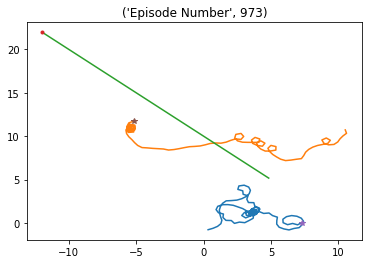

Episode * 974 * Avg Reward is ==> 3000.0245480736444 : Ag1 Reward ==> 1508.7306669477234 : Ag2 Reward ==> 1607.772757371132 


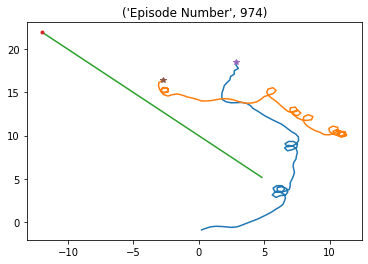

Episode * 975 * Avg Reward is ==> 3008.9400414077763 : Ag1 Reward ==> 1558.7373125352901 : Ag2 Reward ==> 1740.2736876823226 


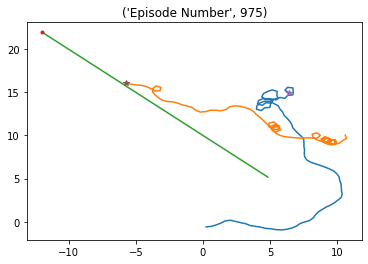

Episode * 976 * Avg Reward is ==> 3015.7453579052512 : Ag1 Reward ==> 1693.6749674378332 : Ag2 Reward ==> 1892.406748091498 


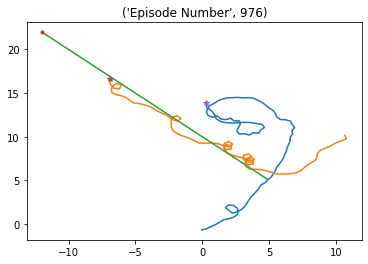

Episode * 977 * Avg Reward is ==> 3001.3582770185017 : Ag1 Reward ==> 1384.7453097857142 : Ag2 Reward ==> 1729.2901608439915 


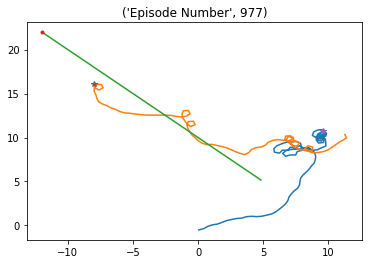

Episode * 978 * Avg Reward is ==> 3001.5597619334667 : Ag1 Reward ==> 1791.4354970116915 : Ag2 Reward ==> 1957.122542353261 


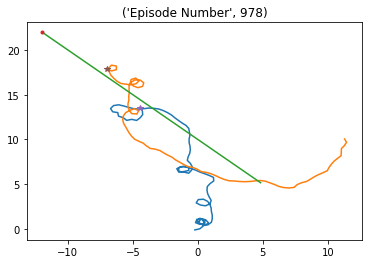

Episode * 979 * Avg Reward is ==> 3017.9234749753764 : Ag1 Reward ==> 1484.8388377428294 : Ag2 Reward ==> 1636.346214397887 


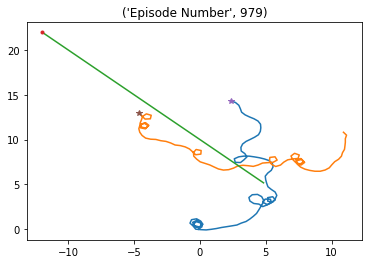

Episode * 980 * Avg Reward is ==> 3006.039332685029 : Ag1 Reward ==> 1426.1814452062572 : Ag2 Reward ==> 1695.214186704787 


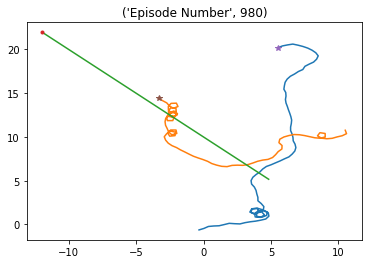

Episode * 981 * Avg Reward is ==> 3024.3711678934037 : Ag1 Reward ==> 1850.4930220642252 : Ag2 Reward ==> 1904.1842134758715 


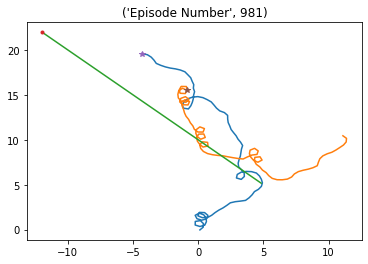

Episode * 982 * Avg Reward is ==> 3038.9834515533607 : Ag1 Reward ==> 1823.2018814396652 : Ag2 Reward ==> 1918.0895112039643 


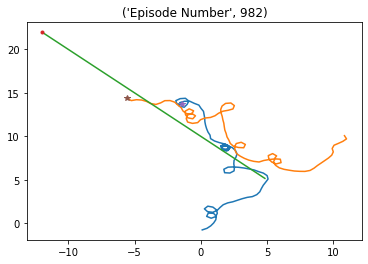

Episode * 983 * Avg Reward is ==> 3056.0557311105595 : Ag1 Reward ==> 1778.7480833471386 : Ag2 Reward ==> 2012.1508286504427 


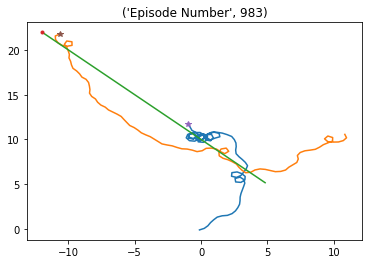

Episode * 984 * Avg Reward is ==> 3089.5822712826434 : Ag1 Reward ==> 1948.8665582693498 : Ag2 Reward ==> 2010.5109132397704 


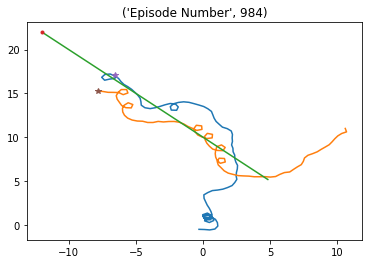

Episode * 985 * Avg Reward is ==> 3123.550772864891 : Ag1 Reward ==> 2090.8151282184594 : Ag2 Reward ==> 2160.817169960401 


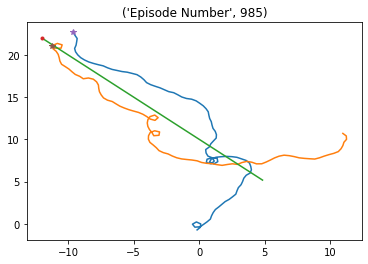

Episode * 986 * Avg Reward is ==> 3145.4531746643697 : Ag1 Reward ==> 1626.4842866327579 : Ag2 Reward ==> 1853.8421824436816 


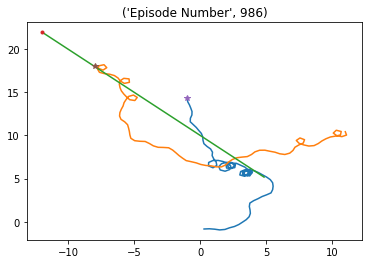

Episode * 987 * Avg Reward is ==> 3170.6241909993537 : Ag1 Reward ==> 1718.0869069998669 : Ag2 Reward ==> 1853.5079028573111 


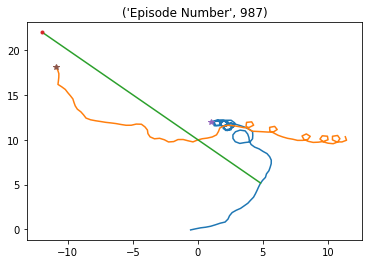

Episode * 988 * Avg Reward is ==> 3170.7211303015165 : Ag1 Reward ==> 1286.1418705619822 : Ag2 Reward ==> 1717.7954830050962 


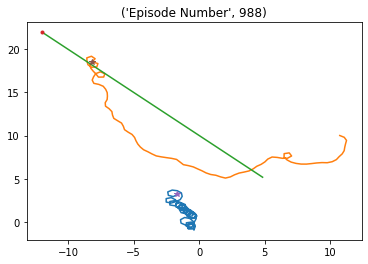

Episode * 989 * Avg Reward is ==> 3184.2065414922813 : Ag1 Reward ==> 1638.9501747237791 : Ag2 Reward ==> 1838.0286034474634 


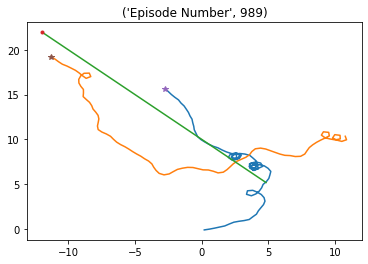

Episode * 990 * Avg Reward is ==> 3197.0125993629517 : Ag1 Reward ==> 1617.4269282925577 : Ag2 Reward ==> 1736.6351569889905 


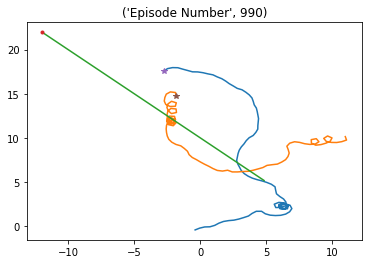

Episode * 991 * Avg Reward is ==> 3220.8312596720434 : Ag1 Reward ==> 2125.8495626077142 : Ag2 Reward ==> 2207.948544213195 


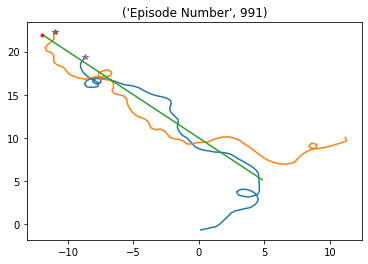

Episode * 992 * Avg Reward is ==> 3242.857086742895 : Ag1 Reward ==> 1792.9660900862857 : Ag2 Reward ==> 1868.5864178758036 


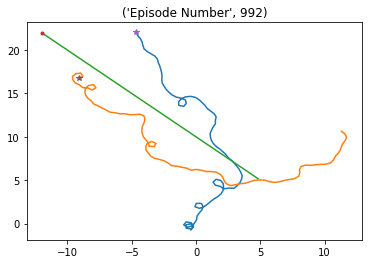

Episode * 993 * Avg Reward is ==> 3252.534846951089 : Ag1 Reward ==> 1561.0766295287876 : Ag2 Reward ==> 1728.7601430447587 


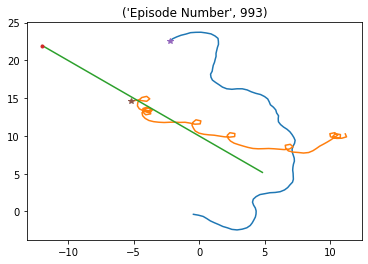

Episode * 994 * Avg Reward is ==> 3268.5701344935324 : Ag1 Reward ==> 1805.1572023160936 : Ag2 Reward ==> 1770.6849354842352 


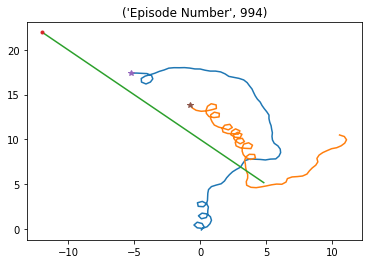

Episode * 995 * Avg Reward is ==> 3280.0255852230266 : Ag1 Reward ==> 1503.915389806567 : Ag2 Reward ==> 1550.5116752140436 


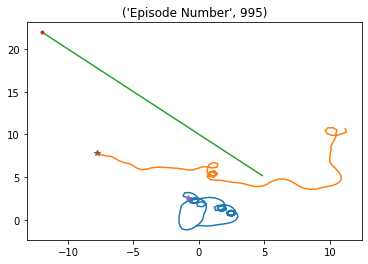

Episode * 996 * Avg Reward is ==> 3295.5324835488036 : Ag1 Reward ==> 1782.524306827603 : Ag2 Reward ==> 1860.2293493717193 


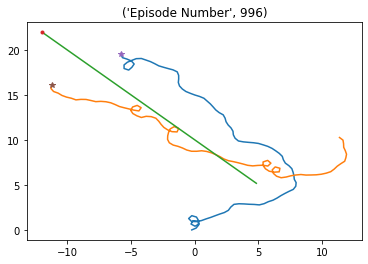

Episode * 997 * Avg Reward is ==> 3289.843876231691 : Ag1 Reward ==> 1416.051596498537 : Ag2 Reward ==> 1724.433203460649 


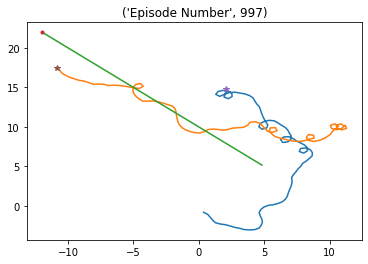

Episode * 998 * Avg Reward is ==> 3316.411960273169 : Ag1 Reward ==> 1868.344497773718 : Ag2 Reward ==> 1842.2761341406006 


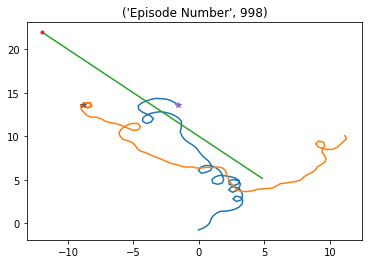

Episode * 999 * Avg Reward is ==> 3312.24534647524 : Ag1 Reward ==> 1305.2815662522278 : Ag2 Reward ==> 1493.4943800458745 


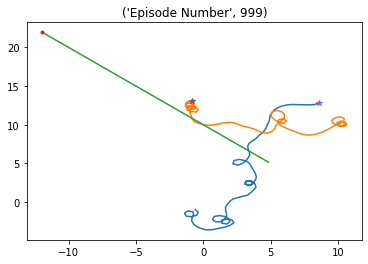

Episode * 1000 * Avg Reward is ==> 3330.217803295132 : Ag1 Reward ==> 1893.3540649378035 : Ag2 Reward ==> 2026.8543475264169 


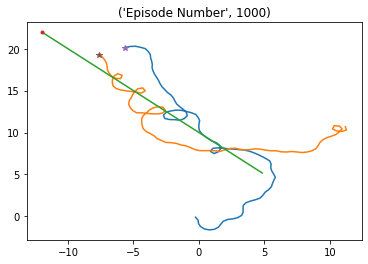

Episode * 1001 * Avg Reward is ==> 3336.9892878212145 : Ag1 Reward ==> 1799.2780171459528 : Ag2 Reward ==> 1836.9138562782132 


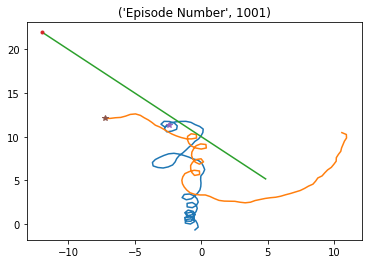

Episode * 1002 * Avg Reward is ==> 3354.2665916345964 : Ag1 Reward ==> 1888.1592616632097 : Ag2 Reward ==> 1903.2658730361627 


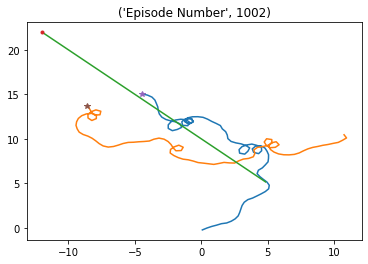

Episode * 1003 * Avg Reward is ==> 3367.399492165781 : Ag1 Reward ==> 1567.3868498347335 : Ag2 Reward ==> 1724.8332564126204 


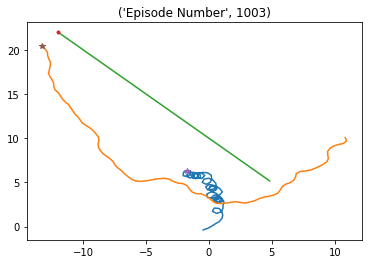

Episode * 1004 * Avg Reward is ==> 3362.1266518648104 : Ag1 Reward ==> 1577.775404226997 : Ag2 Reward ==> 1780.800304755044 


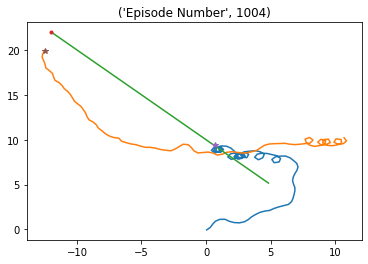

Episode * 1005 * Avg Reward is ==> 3370.0527491990265 : Ag1 Reward ==> 1743.5677920155101 : Ag2 Reward ==> 1875.7128378283035 


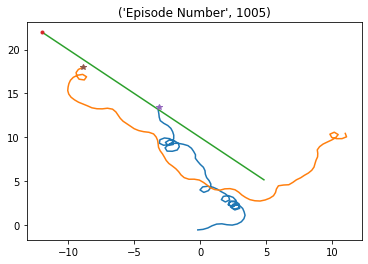

Episode * 1006 * Avg Reward is ==> 3383.59547493958 : Ag1 Reward ==> 1547.0519373224918 : Ag2 Reward ==> 1632.83071148792 


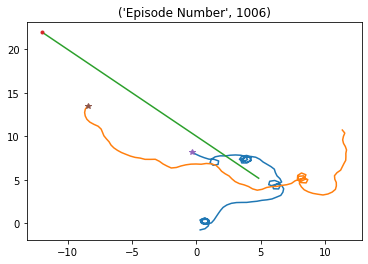

Episode * 1007 * Avg Reward is ==> 3406.9869949224653 : Ag1 Reward ==> 1629.4054753692594 : Ag2 Reward ==> 1799.9977847112623 


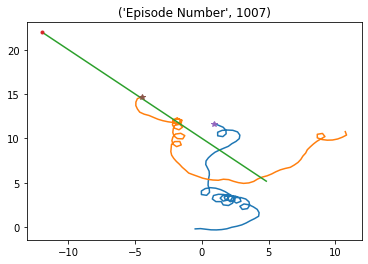

Episode * 1008 * Avg Reward is ==> 3420.3973991999337 : Ag1 Reward ==> 1726.6465255358248 : Ag2 Reward ==> 1831.436556090724 


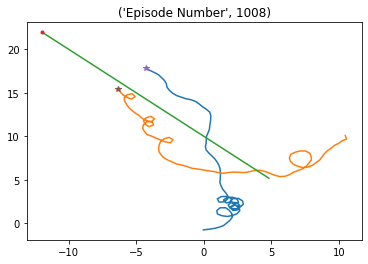

Episode * 1009 * Avg Reward is ==> 3441.940376649591 : Ag1 Reward ==> 1659.7947932990178 : Ag2 Reward ==> 1883.3454257989993 


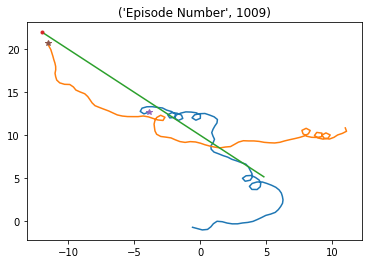

Episode * 1010 * Avg Reward is ==> 3456.3357116648417 : Ag1 Reward ==> 1835.873541637409 : Ag2 Reward ==> 1833.359342384626 


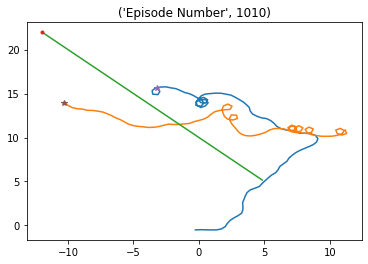

Episode * 1011 * Avg Reward is ==> 3477.8447231157143 : Ag1 Reward ==> 1731.6633087934117 : Ag2 Reward ==> 1689.7869236173099 


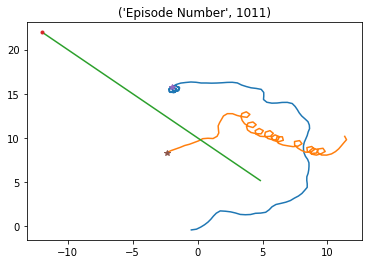

Episode * 1012 * Avg Reward is ==> 3490.5380079081106 : Ag1 Reward ==> 1790.2081422853093 : Ag2 Reward ==> 1799.899106935743 


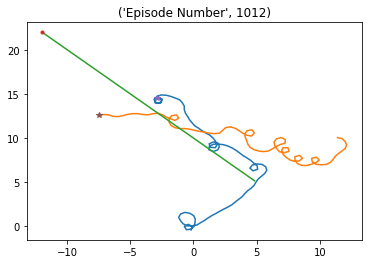

Episode * 1013 * Avg Reward is ==> 3498.9166222786466 : Ag1 Reward ==> 1588.1467873292377 : Ag2 Reward ==> 1659.6778984029359 


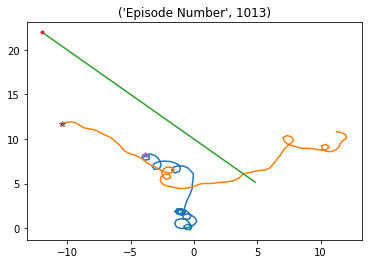

Episode * 1014 * Avg Reward is ==> 3508.7657344933964 : Ag1 Reward ==> 1676.2427917850969 : Ag2 Reward ==> 1834.2251211237544 


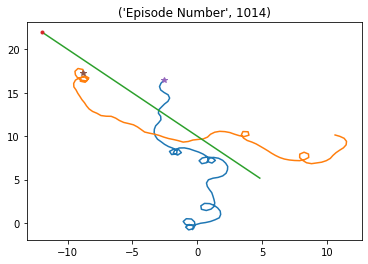

Episode * 1015 * Avg Reward is ==> 3514.6679581428107 : Ag1 Reward ==> 1700.8300236446676 : Ag2 Reward ==> 1834.2699225495135 


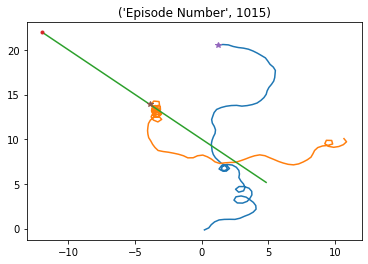

Episode * 1016 * Avg Reward is ==> 3506.4878256337206 : Ag1 Reward ==> 1651.1261479047669 : Ag2 Reward ==> 1607.7502672609533 


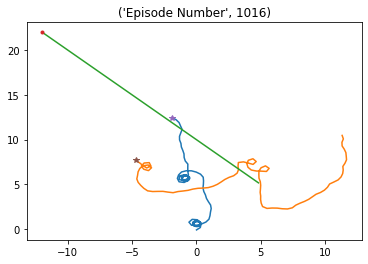

Episode * 1017 * Avg Reward is ==> 3513.8427676904953 : Ag1 Reward ==> 1667.0333766494439 : Ag2 Reward ==> 1741.1997762512647 


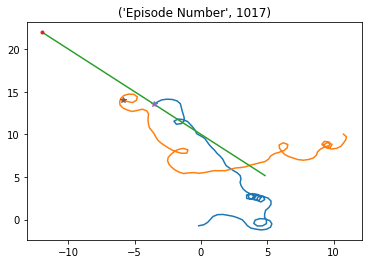

Episode * 1018 * Avg Reward is ==> 3485.0885498662115 : Ag1 Reward ==> 1209.7055762719247 : Ag2 Reward ==> 1388.6837501216846 


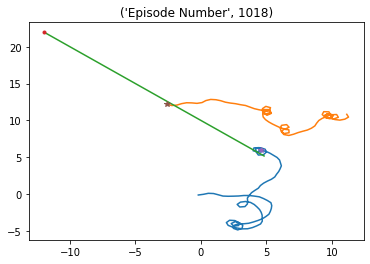

Episode * 1019 * Avg Reward is ==> 3475.988404715104 : Ag1 Reward ==> 1304.6184876321379 : Ag2 Reward ==> 1452.5607584642823 


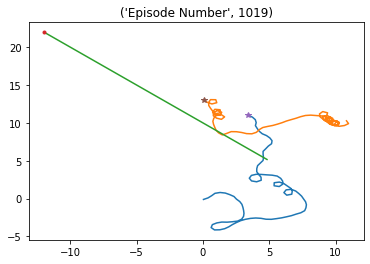

Episode * 1020 * Avg Reward is ==> 3494.135853798074 : Ag1 Reward ==> 1885.2383807844478 : Ag2 Reward ==> 1962.0552144454018 


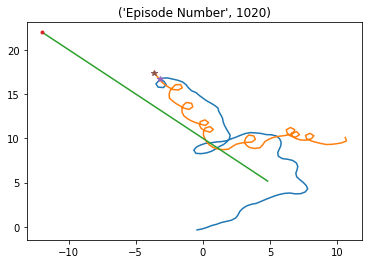

Episode * 1021 * Avg Reward is ==> 3489.9419811089742 : Ag1 Reward ==> 1803.1407819306444 : Ag2 Reward ==> 1783.7815460454308 


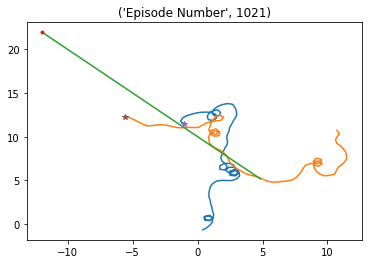

Episode * 1022 * Avg Reward is ==> 3490.242616528456 : Ag1 Reward ==> 1870.0469431243853 : Ag2 Reward ==> 1883.2698662985204 


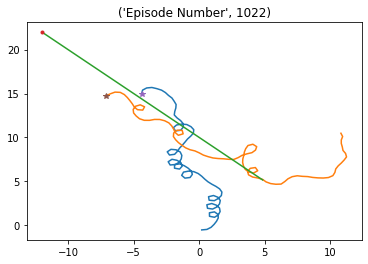

Episode * 1023 * Avg Reward is ==> 3476.8298396460204 : Ag1 Reward ==> 1647.5527890407643 : Ag2 Reward ==> 1606.8350476594187 


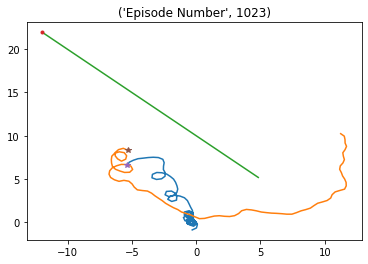

Episode * 1024 * Avg Reward is ==> 3466.814907702594 : Ag1 Reward ==> 1773.2570018231436 : Ag2 Reward ==> 1785.5231919489456 


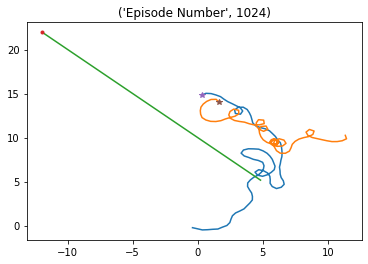

Episode * 1025 * Avg Reward is ==> 3450.848990326374 : Ag1 Reward ==> 1795.1892629279048 : Ag2 Reward ==> 1817.8063402021214 


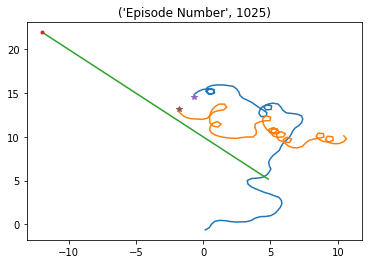

Episode * 1026 * Avg Reward is ==> 3455.578423028589 : Ag1 Reward ==> 1809.9016767779356 : Ag2 Reward ==> 1859.6021003871138 


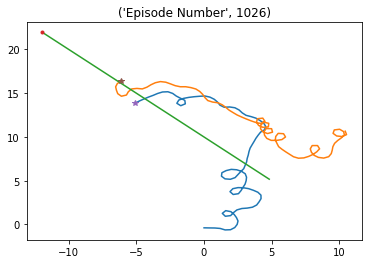

Episode * 1027 * Avg Reward is ==> 3446.620084732998 : Ag1 Reward ==> 1532.897696630234 : Ag2 Reward ==> 1680.3635814032812 


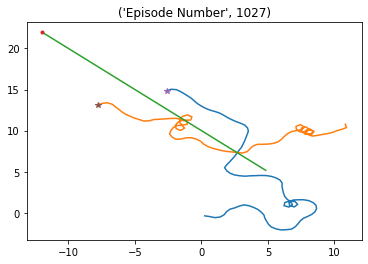

Episode * 1028 * Avg Reward is ==> 3465.167397153581 : Ag1 Reward ==> 1887.046455412615 : Ag2 Reward ==> 1858.7833949778078 


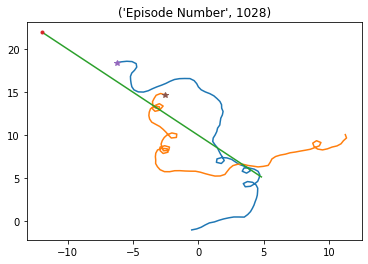

Episode * 1029 * Avg Reward is ==> 3469.7442940070077 : Ag1 Reward ==> 1792.7176402113098 : Ag2 Reward ==> 1867.3370120969896 


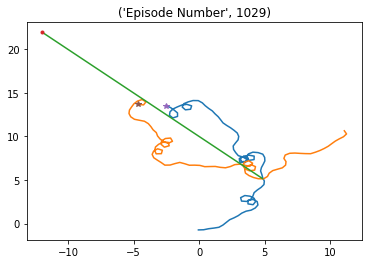

Episode * 1030 * Avg Reward is ==> 3482.7585700625423 : Ag1 Reward ==> 1852.9764628208115 : Ag2 Reward ==> 2021.656664682102 


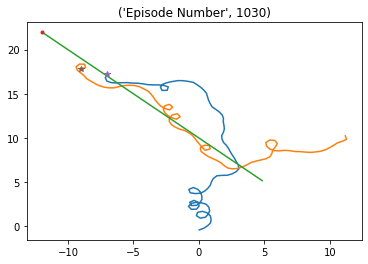

Episode * 1031 * Avg Reward is ==> 3459.0738132269776 : Ag1 Reward ==> 1574.544922476193 : Ag2 Reward ==> 1811.8629109221524 


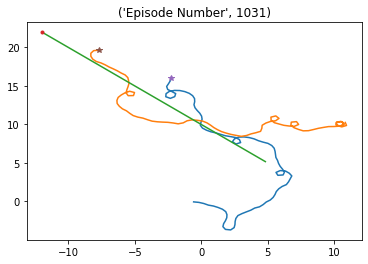

Episode * 1032 * Avg Reward is ==> 3445.877682924921 : Ag1 Reward ==> 1419.797895559383 : Ag2 Reward ==> 1713.9094003204118 


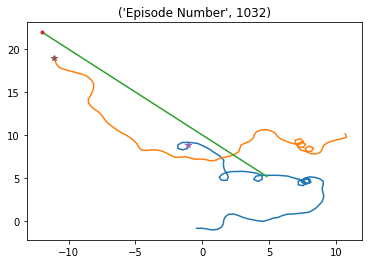

Episode * 1033 * Avg Reward is ==> 3455.8721604596058 : Ag1 Reward ==> 1795.2348954060321 : Ag2 Reward ==> 1894.3809785549417 


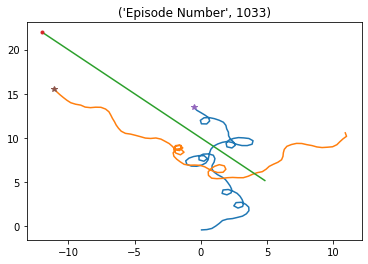

Episode * 1034 * Avg Reward is ==> 3452.199891753976 : Ag1 Reward ==> 1699.7127501563798 : Ag2 Reward ==> 1729.2386394187222 


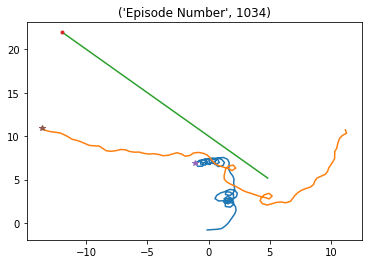

Episode * 1035 * Avg Reward is ==> 3459.1013170370325 : Ag1 Reward ==> 1556.1773046946976 : Ag2 Reward ==> 1774.306771648185 


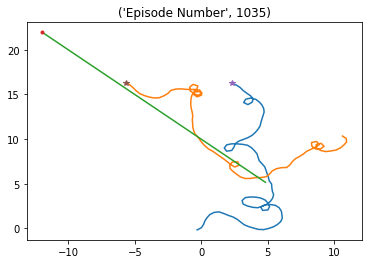

Episode * 1036 * Avg Reward is ==> 3460.8398868529134 : Ag1 Reward ==> 1852.4893203501897 : Ag2 Reward ==> 1859.8071284843734 


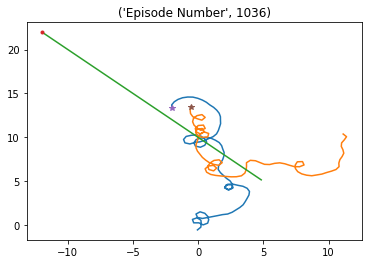

Episode * 1037 * Avg Reward is ==> 3473.2014857158915 : Ag1 Reward ==> 1853.017997618535 : Ag2 Reward ==> 1781.9307568598038 


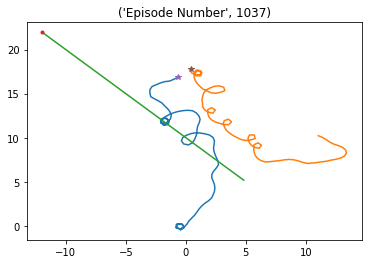

Episode * 1038 * Avg Reward is ==> 3452.155139217324 : Ag1 Reward ==> 1262.8094983846179 : Ag2 Reward ==> 1605.9572735869783 


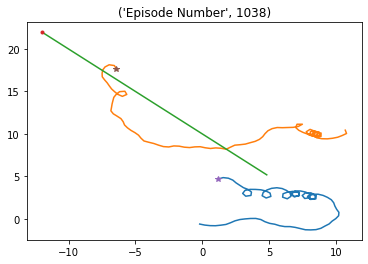

Episode * 1039 * Avg Reward is ==> 3469.817550051203 : Ag1 Reward ==> 1659.831467774965 : Ag2 Reward ==> 1845.4409118782871 


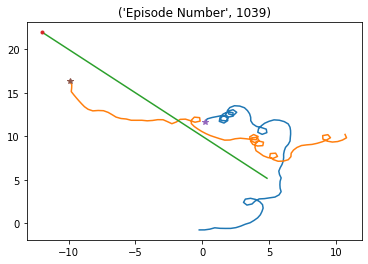

Episode * 1040 * Avg Reward is ==> 3461.299487780218 : Ag1 Reward ==> 1775.9449256309854 : Ag2 Reward ==> 1803.5409959938315 


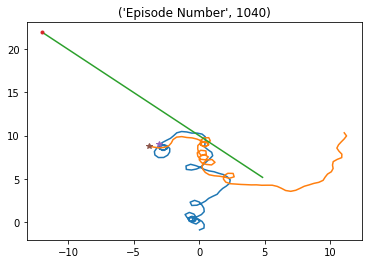

Episode * 1041 * Avg Reward is ==> 3459.435834495888 : Ag1 Reward ==> 1795.424845249945 : Ag2 Reward ==> 1766.220896801021 


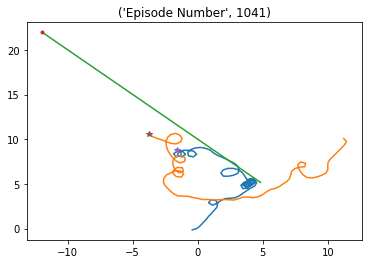

Episode * 1042 * Avg Reward is ==> 3458.751027549447 : Ag1 Reward ==> 1878.191805756739 : Ag2 Reward ==> 1885.8410510850006 


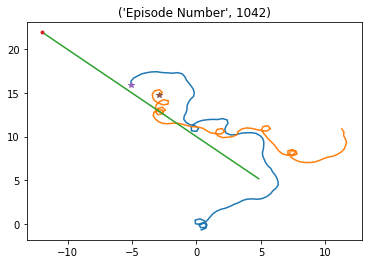

Episode * 1043 * Avg Reward is ==> 3457.3219665211845 : Ag1 Reward ==> 1552.6990599286032 : Ag2 Reward ==> 1682.358605188244 


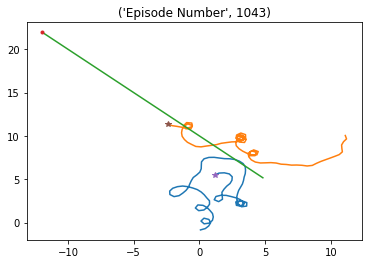

Episode * 1044 * Avg Reward is ==> 3476.4632837491504 : Ag1 Reward ==> 2152.0630730061207 : Ag2 Reward ==> 1972.1653250945683 


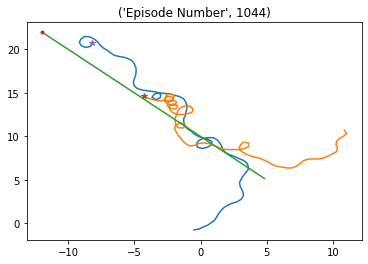

Episode * 1045 * Avg Reward is ==> 3465.127322075493 : Ag1 Reward ==> 1575.8452689031392 : Ag2 Reward ==> 1589.9968939943387 


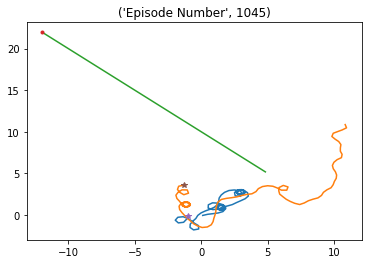

Episode * 1046 * Avg Reward is ==> 3479.287895794024 : Ag1 Reward ==> 1860.3869985957933 : Ag2 Reward ==> 1885.9185989558753 


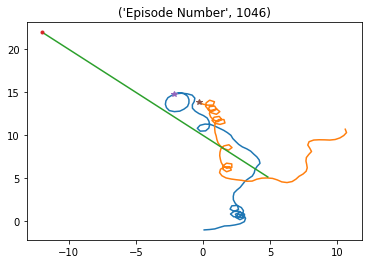

Episode * 1047 * Avg Reward is ==> 3477.49274042068 : Ag1 Reward ==> 1658.6407937171382 : Ag2 Reward ==> 1698.9562514296533 


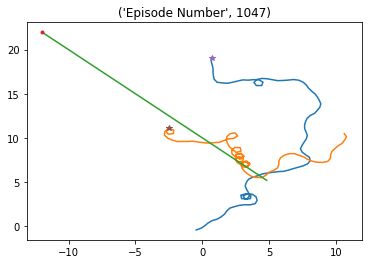

Episode * 1048 * Avg Reward is ==> 3459.0786879660955 : Ag1 Reward ==> 1344.4254856950186 : Ag2 Reward ==> 1477.0954977481492 


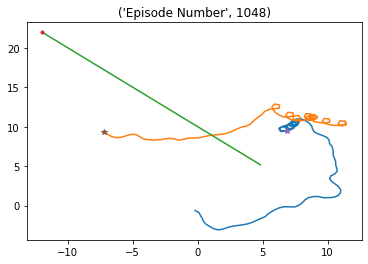

Episode * 1049 * Avg Reward is ==> 3458.6349649487265 : Ag1 Reward ==> 1722.662113496125 : Ag2 Reward ==> 1802.7291849071485 


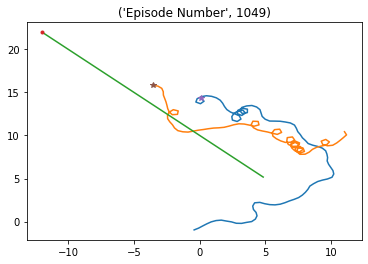

Episode * 1050 * Avg Reward is ==> 3447.3496102021963 : Ag1 Reward ==> 1547.2069471918464 : Ag2 Reward ==> 1670.6117469689416 


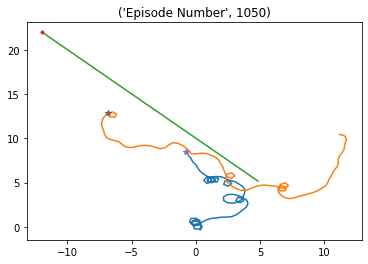

Episode * 1051 * Avg Reward is ==> 3453.268584609608 : Ag1 Reward ==> 1848.3588267228752 : Ag2 Reward ==> 1809.8503819843424 


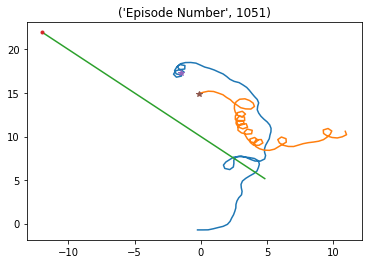

Episode * 1052 * Avg Reward is ==> 3460.744628214719 : Ag1 Reward ==> 1958.844462372714 : Ag2 Reward ==> 1930.3045310527605 


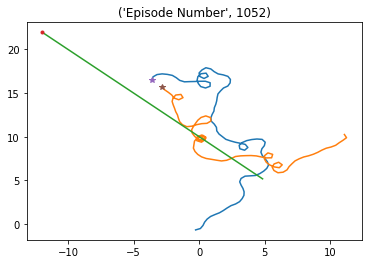

Episode * 1053 * Avg Reward is ==> 3457.155020528925 : Ag1 Reward ==> 1556.696883681071 : Ag2 Reward ==> 1547.543494619338 


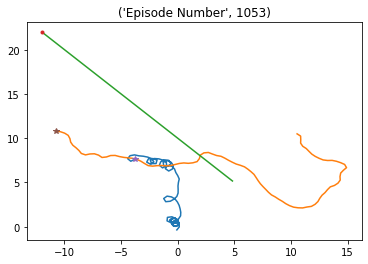

Episode * 1054 * Avg Reward is ==> 3458.518387676748 : Ag1 Reward ==> 1698.3336057794145 : Ag2 Reward ==> 1866.6689930423483 


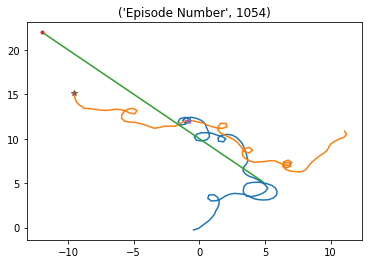

Episode * 1055 * Avg Reward is ==> 3453.052725296106 : Ag1 Reward ==> 1647.9531090003313 : Ag2 Reward ==> 1668.5203419681945 


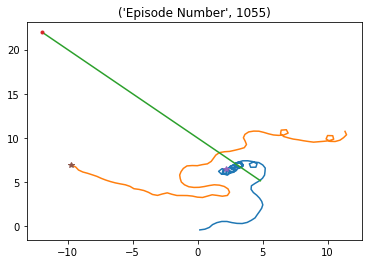

Episode * 1056 * Avg Reward is ==> 3444.9407098493903 : Ag1 Reward ==> 1461.3673922866415 : Ag2 Reward ==> 1473.0284050104244 


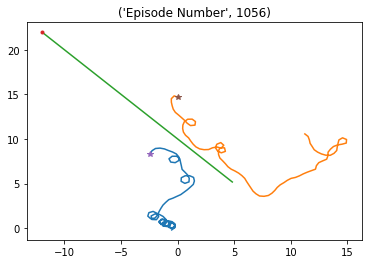

Episode * 1057 * Avg Reward is ==> 3454.1123241656414 : Ag1 Reward ==> 1838.1401353140939 : Ag2 Reward ==> 1936.9575902366778 


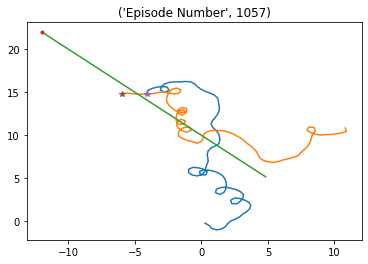

Episode * 1058 * Avg Reward is ==> 3474.9399666463733 : Ag1 Reward ==> 1680.6426193557943 : Ag2 Reward ==> 1750.8524062670776 


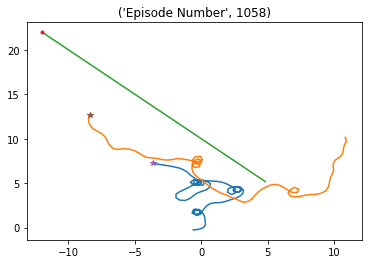

Episode * 1059 * Avg Reward is ==> 3493.2210969938506 : Ag1 Reward ==> 1725.4764304334285 : Ag2 Reward ==> 1762.9480295621065 


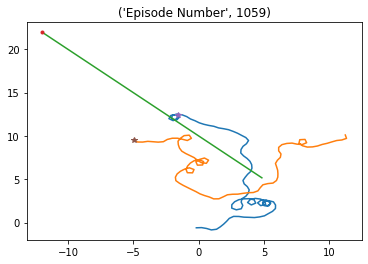

Episode * 1060 * Avg Reward is ==> 3478.7659541923845 : Ag1 Reward ==> 1574.7692710110719 : Ag2 Reward ==> 1694.3186121601082 


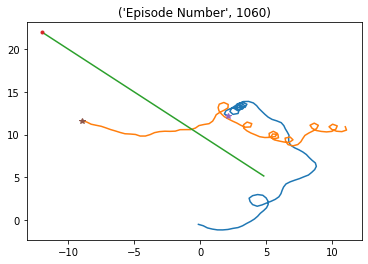

Episode * 1061 * Avg Reward is ==> 3482.778241036761 : Ag1 Reward ==> 1876.373245695001 : Ag2 Reward ==> 1871.040556056136 


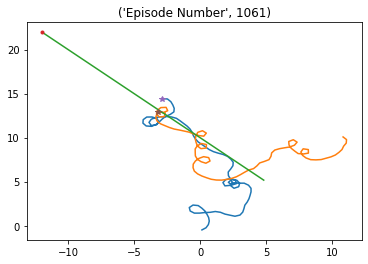

Episode * 1062 * Avg Reward is ==> 3476.98091385526 : Ag1 Reward ==> 1727.2729537709224 : Ag2 Reward ==> 1794.150768391938 


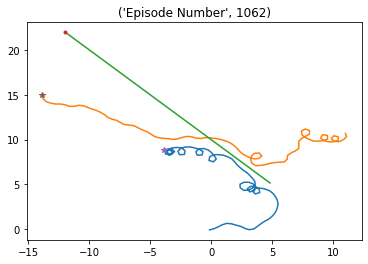

Episode * 1063 * Avg Reward is ==> 3484.146568111373 : Ag1 Reward ==> 1714.4696784580976 : Ag2 Reward ==> 1826.5443284866176 


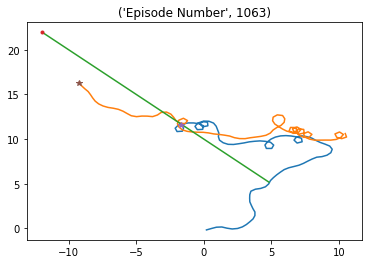

Episode * 1064 * Avg Reward is ==> 3488.4841497144894 : Ag1 Reward ==> 1845.909652362363 : Ag2 Reward ==> 1886.3738055343804 


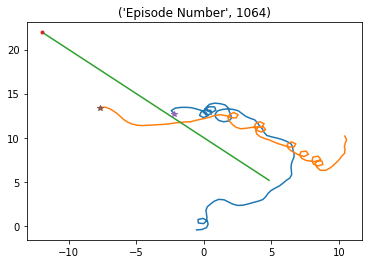

Episode * 1065 * Avg Reward is ==> 3499.81359004155 : Ag1 Reward ==> 2090.188626136664 : Ag2 Reward ==> 1975.9845900757862 


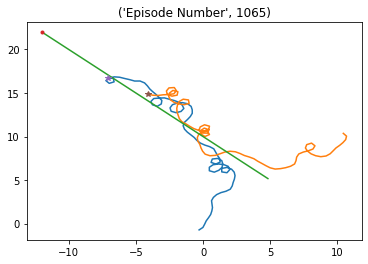

Episode * 1066 * Avg Reward is ==> 3497.0039034291926 : Ag1 Reward ==> 1679.5678760632006 : Ag2 Reward ==> 1877.5484366075325 


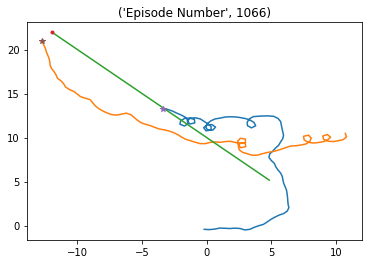

Episode * 1067 * Avg Reward is ==> 3500.3462066183492 : Ag1 Reward ==> 1588.0783688670147 : Ag2 Reward ==> 1758.8750367327732 


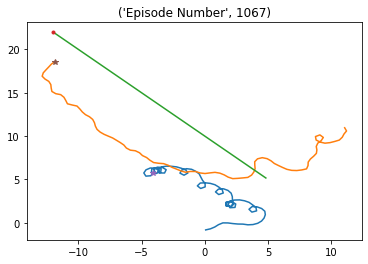

Episode * 1068 * Avg Reward is ==> 3481.823961151672 : Ag1 Reward ==> 1376.297733127026 : Ag2 Reward ==> 1628.6422985962804 


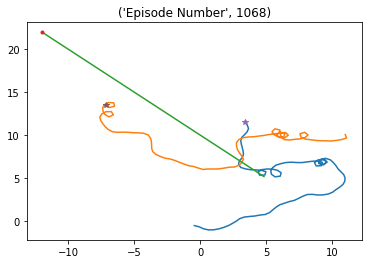

Episode * 1069 * Avg Reward is ==> 3471.349394687682 : Ag1 Reward ==> 1557.215018795837 : Ag2 Reward ==> 1683.856974952891 


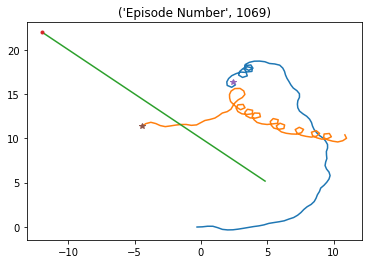

Episode * 1070 * Avg Reward is ==> 3459.9133975566124 : Ag1 Reward ==> 1696.5056365248458 : Ag2 Reward ==> 1720.6876057352654 


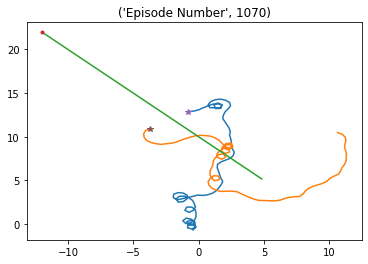

Episode * 1071 * Avg Reward is ==> 3467.465197358159 : Ag1 Reward ==> 1858.3319066138638 : Ag2 Reward ==> 1830.147918846342 


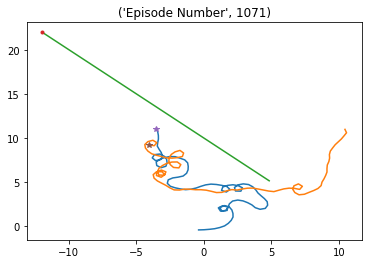

Episode * 1072 * Avg Reward is ==> 3468.871955124283 : Ag1 Reward ==> 1462.5693080223523 : Ag2 Reward ==> 1727.408298502425 


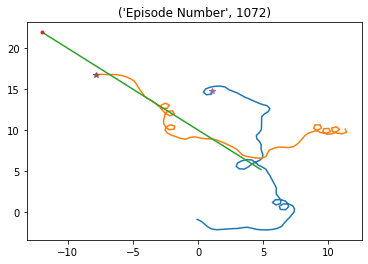

Episode * 1073 * Avg Reward is ==> 3456.4255474450692 : Ag1 Reward ==> 1472.8024963640441 : Ag2 Reward ==> 1718.9570704283883 


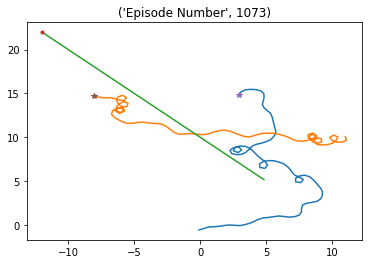

Episode * 1074 * Avg Reward is ==> 3464.1663127286724 : Ag1 Reward ==> 1877.0869630364448 : Ag2 Reward ==> 1861.4950378827634 


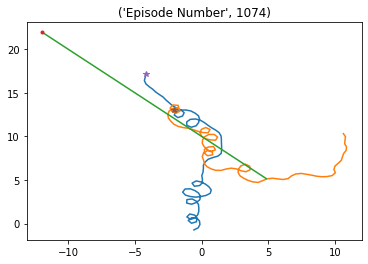

Episode * 1075 * Avg Reward is ==> 3467.940704279755 : Ag1 Reward ==> 1652.4862668075218 : Ag2 Reward ==> 1828.9734715786901 


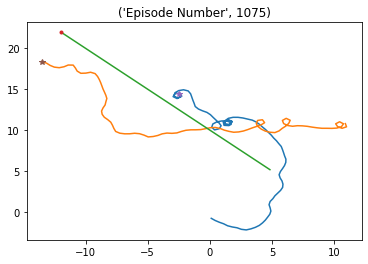

Episode * 1076 * Avg Reward is ==> 3452.991749529922 : Ag1 Reward ==> 1506.5874629312698 : Ag2 Reward ==> 1607.7507959099637 


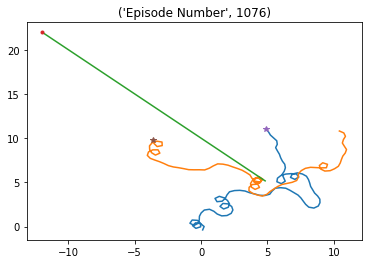

Episode * 1077 * Avg Reward is ==> 3447.5988109878285 : Ag1 Reward ==> 1685.1026610391132 : Ag2 Reward ==> 1734.1285517554866 


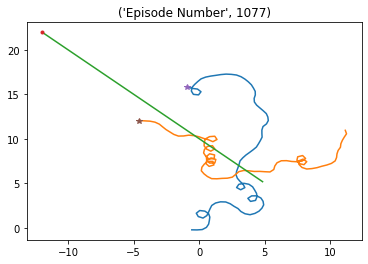

Episode * 1078 * Avg Reward is ==> 3470.6212141454953 : Ag1 Reward ==> 1905.7020299233973 : Ag2 Reward ==> 1883.96086835487 


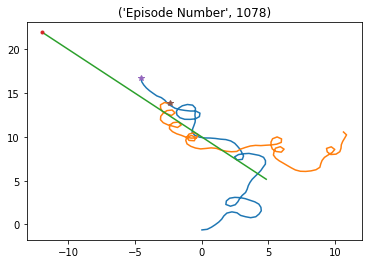

Episode * 1079 * Avg Reward is ==> 3466.54517865877 : Ag1 Reward ==> 1453.7620750725175 : Ag2 Reward ==> 1888.4688851117064 


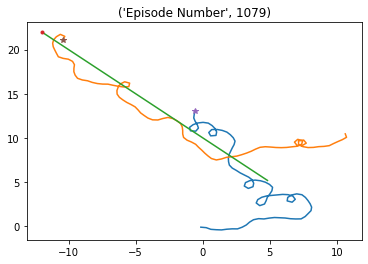

Episode * 1080 * Avg Reward is ==> 3462.148179734533 : Ag1 Reward ==> 1650.3602898827764 : Ag2 Reward ==> 1753.2456747725823 


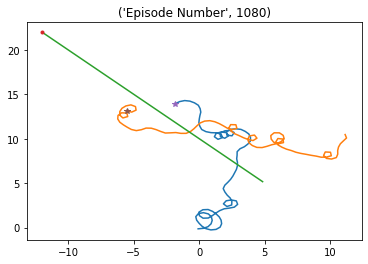

Episode * 1081 * Avg Reward is ==> 3454.0887102929964 : Ag1 Reward ==> 1579.8533044388596 : Ag2 Reward ==> 1659.4136599506173 


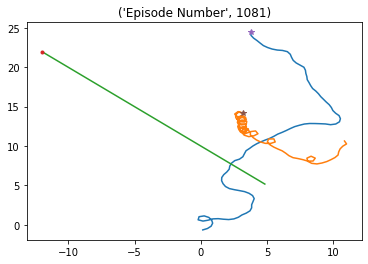

Episode * 1082 * Avg Reward is ==> 3426.846422845808 : Ag1 Reward ==> 1259.1772953165919 : Ag2 Reward ==> 1415.1640636376223 


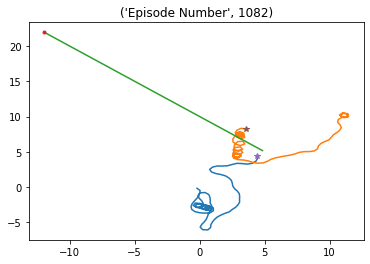

Episode * 1083 * Avg Reward is ==> 3434.1530636548255 : Ag1 Reward ==> 1721.8988689839248 : Ag2 Reward ==> 1805.424428493635 


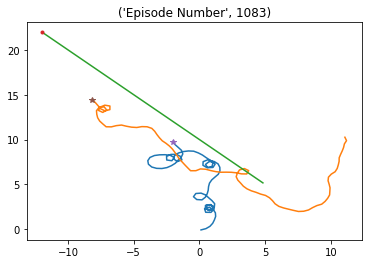

Episode * 1084 * Avg Reward is ==> 3413.5311118607474 : Ag1 Reward ==> 1561.2836622339232 : Ag2 Reward ==> 1738.0666641036487 


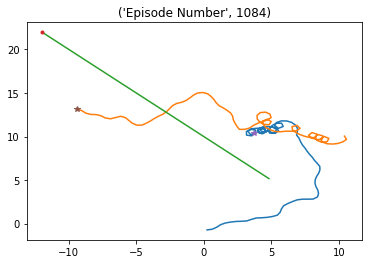

Episode * 1085 * Avg Reward is ==> 3427.4865529172516 : Ag1 Reward ==> 1863.872910297918 : Ag2 Reward ==> 1860.1868948597298 


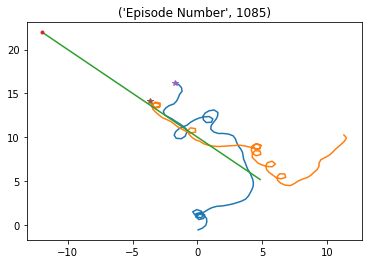

Episode * 1086 * Avg Reward is ==> 3411.4381521197856 : Ag1 Reward ==> 1432.8263284623924 : Ag2 Reward ==> 1671.543237190648 


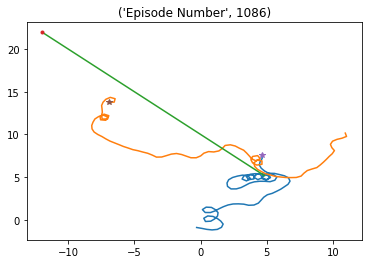

Episode * 1087 * Avg Reward is ==> 3414.1477085085426 : Ag1 Reward ==> 1712.0277960404258 : Ag2 Reward ==> 1753.951504656606 


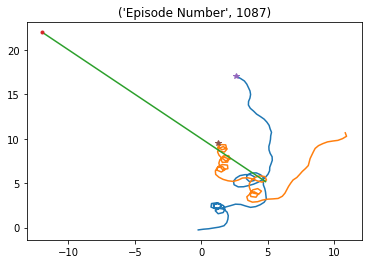

Episode * 1088 * Avg Reward is ==> 3428.6931289798217 : Ag1 Reward ==> 1644.0594177773553 : Ag2 Reward ==> 1759.278384516998 


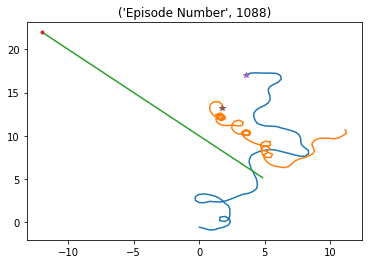

Episode * 1089 * Avg Reward is ==> 3428.7021031895174 : Ag1 Reward ==> 1737.9758617131301 : Ag2 Reward ==> 1787.7744050779347 


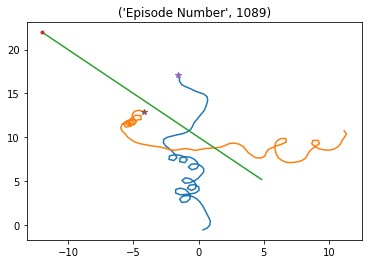

Episode * 1090 * Avg Reward is ==> 3437.2422243326328 : Ag1 Reward ==> 1726.2402004674238 : Ag2 Reward ==> 1833.1833394180094 


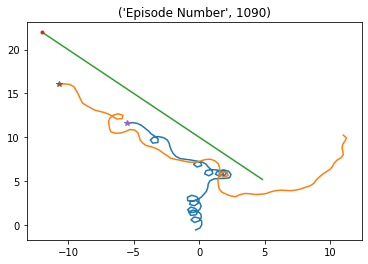

Episode * 1091 * Avg Reward is ==> 3417.512993561299 : Ag1 Reward ==> 1336.7264420306792 : Ag2 Reward ==> 1532.3135358232134 


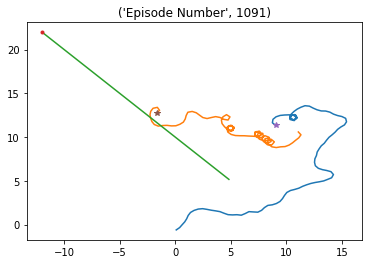

Episode * 1092 * Avg Reward is ==> 3405.2393686812807 : Ag1 Reward ==> 1669.0895628687833 : Ag2 Reward ==> 1729.1144353559434 


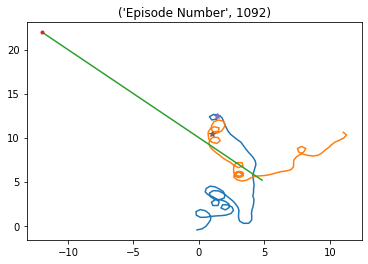

Episode * 1093 * Avg Reward is ==> 3422.5348657905915 : Ag1 Reward ==> 1898.9613474919993 : Ag2 Reward ==> 1897.0989151808433 


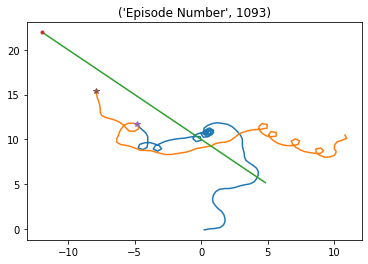

Episode * 1094 * Avg Reward is ==> 3427.7722863681984 : Ag1 Reward ==> 1851.5847177592827 : Ag2 Reward ==> 1922.9147041667422 


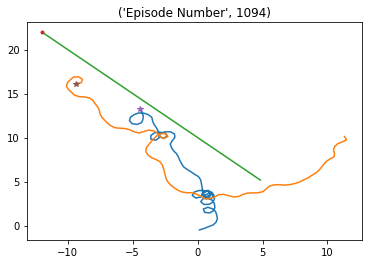

Episode * 1095 * Avg Reward is ==> 3433.7329064683354 : Ag1 Reward ==> 1694.386582933995 : Ag2 Reward ==> 1860.511672040036 


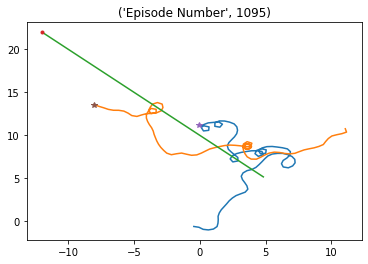

Episode * 1096 * Avg Reward is ==> 3441.182906090186 : Ag1 Reward ==> 1546.165753784372 : Ag2 Reward ==> 1686.230028386711 


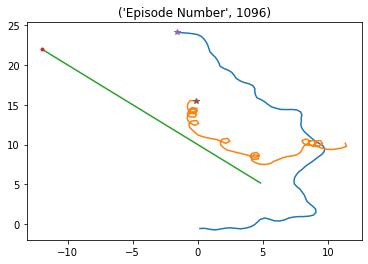

Episode * 1097 * Avg Reward is ==> 3429.054277787208 : Ag1 Reward ==> 1637.1952814401548 : Ag2 Reward ==> 1652.7573119914805 


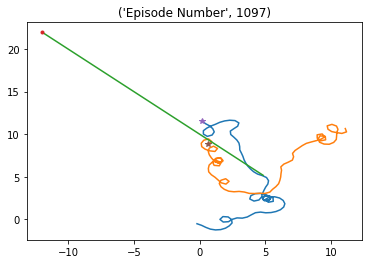

Episode * 1098 * Avg Reward is ==> 3433.4628193498625 : Ag1 Reward ==> 1795.3160016419652 : Ag2 Reward ==> 1812.5206864870836 


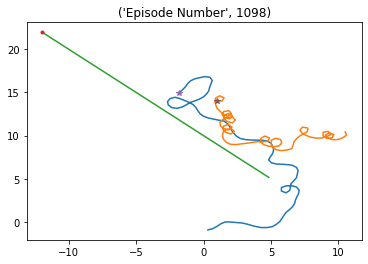

Episode * 1099 * Avg Reward is ==> 3437.686605072784 : Ag1 Reward ==> 1753.3390184342443 : Ag2 Reward ==> 1904.0368704781542 


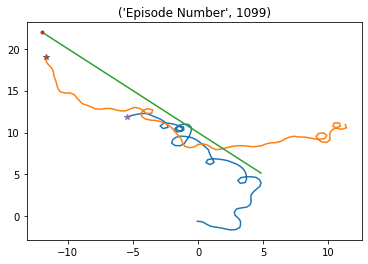

Episode * 1100 * Avg Reward is ==> 3427.027472804561 : Ag1 Reward ==> 1313.9768327662969 : Ag2 Reward ==> 1528.7457596759675 


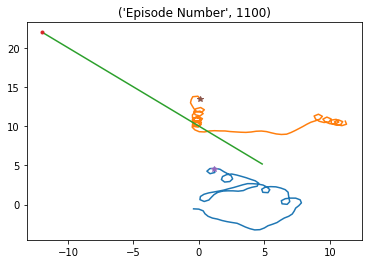

Episode * 1101 * Avg Reward is ==> 3419.919444385893 : Ag1 Reward ==> 1570.4860518793723 : Ag2 Reward ==> 1892.606613125037 


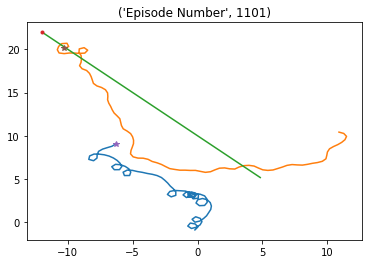

Episode * 1102 * Avg Reward is ==> 3424.181630341217 : Ag1 Reward ==> 1825.347149809542 : Ag2 Reward ==> 1866.5640105662603 


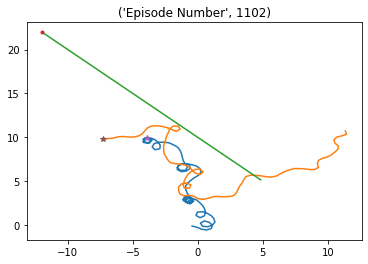

Episode * 1103 * Avg Reward is ==> 3427.530686741462 : Ag1 Reward ==> 1828.4760609563837 : Ag2 Reward ==> 1846.5002019981505 


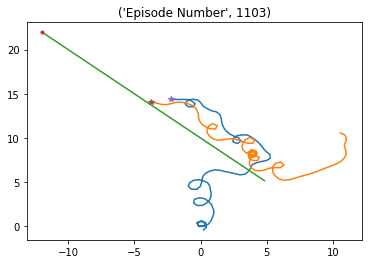

Episode * 1104 * Avg Reward is ==> 3427.8620003936317 : Ag1 Reward ==> 1836.9997836596754 : Ag2 Reward ==> 1908.5362203238826 


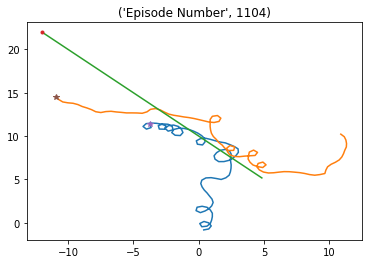

Episode * 1105 * Avg Reward is ==> 3414.79928267132 : Ag1 Reward ==> 1774.8580107070813 : Ag2 Reward ==> 1768.8064966128957 


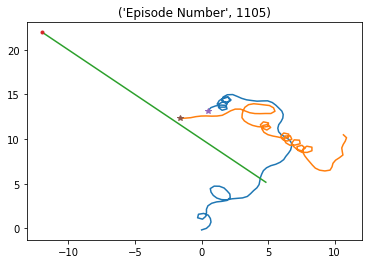

Episode * 1106 * Avg Reward is ==> 3421.2715010909974 : Ag1 Reward ==> 1907.7390997917698 : Ag2 Reward ==> 1908.265949666082 


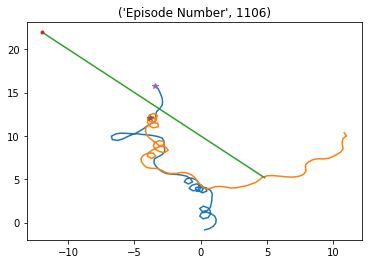

Episode * 1107 * Avg Reward is ==> 3427.809723302871 : Ag1 Reward ==> 1792.701229137894 : Ag2 Reward ==> 1815.7810649368212 


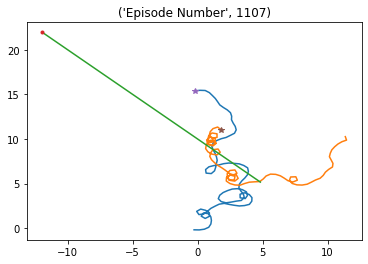

Episode * 1108 * Avg Reward is ==> 3452.9812191790406 : Ag1 Reward ==> 1981.3785715912686 : Ag2 Reward ==> 2030.4212951788145 


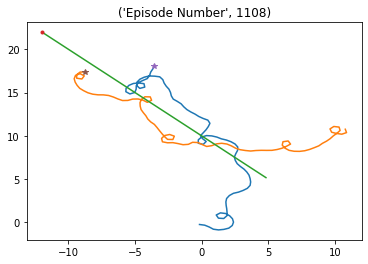

Episode * 1109 * Avg Reward is ==> 3454.6015605457483 : Ag1 Reward ==> 1555.6836960142632 : Ag2 Reward ==> 1750.201952402802 


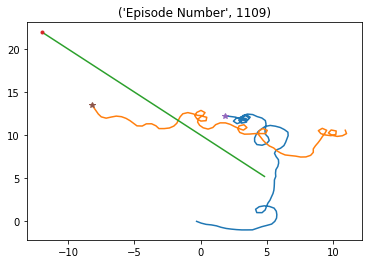

Episode * 1110 * Avg Reward is ==> 3450.1433825790496 : Ag1 Reward ==> 1581.0949061084175 : Ag2 Reward ==> 1657.7712174837507 


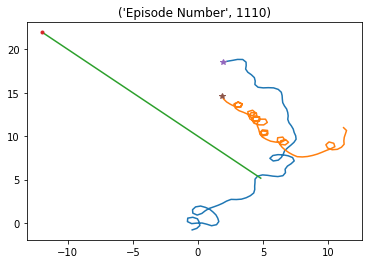

Episode * 1111 * Avg Reward is ==> 3442.5276510878734 : Ag1 Reward ==> 1651.8235789381852 : Ag2 Reward ==> 1732.02698687496 


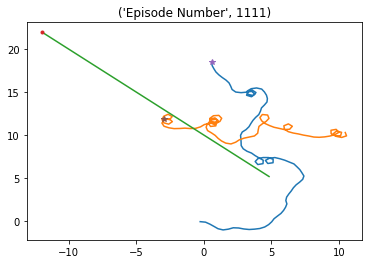

Episode * 1112 * Avg Reward is ==> 3453.507143633656 : Ag1 Reward ==> 1660.6250965647534 : Ag2 Reward ==> 1968.5322117913215 


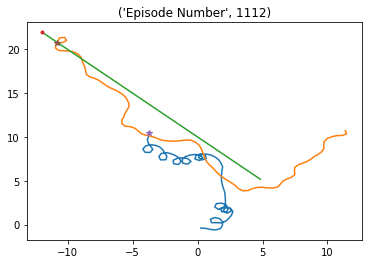

Episode * 1113 * Avg Reward is ==> 3457.925939685826 : Ag1 Reward ==> 1578.4249088215204 : Ag2 Reward ==> 1790.0865000577144 


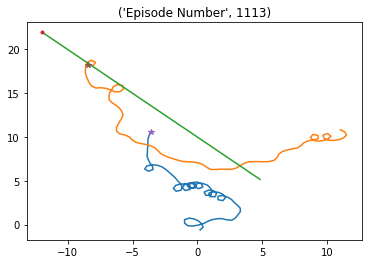

Episode * 1114 * Avg Reward is ==> 3456.7688796231814 : Ag1 Reward ==> 1833.340300846002 : Ag2 Reward ==> 1858.9592975674218 


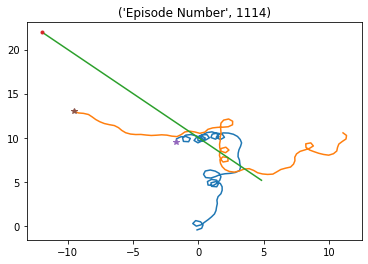

Episode * 1115 * Avg Reward is ==> 3460.742602200823 : Ag1 Reward ==> 1808.600999033768 : Ag2 Reward ==> 1831.8076424580938 


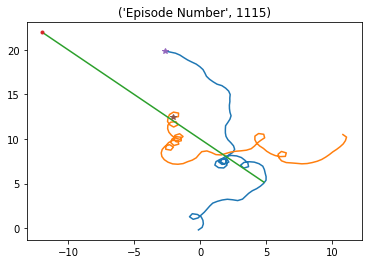

Episode * 1116 * Avg Reward is ==> 3463.5994551072167 : Ag1 Reward ==> 1508.994608600679 : Ag2 Reward ==> 1719.617766496302 


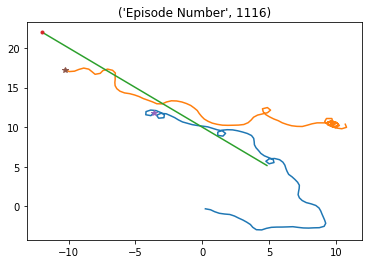

Episode * 1117 * Avg Reward is ==> 3467.940518385145 : Ag1 Reward ==> 1789.1457101989913 : Ag2 Reward ==> 1803.7280337127377 


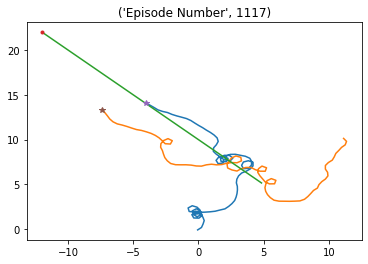

Episode * 1118 * Avg Reward is ==> 3464.1861931175276 : Ag1 Reward ==> 1734.5729985963517 : Ag2 Reward ==> 1904.9168889772268 


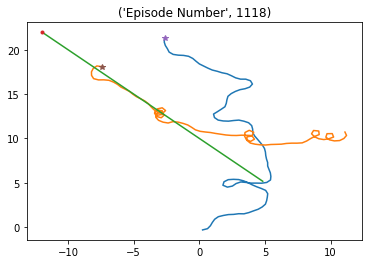

Episode * 1119 * Avg Reward is ==> 3467.909084903752 : Ag1 Reward ==> 1686.012567721894 : Ag2 Reward ==> 1805.1340639113093 


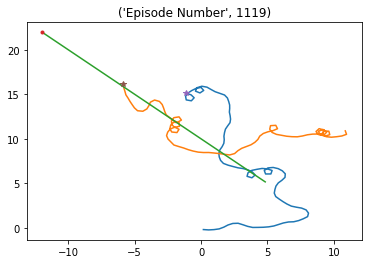

Episode * 1120 * Avg Reward is ==> 3475.8586562074697 : Ag1 Reward ==> 1789.491625569199 : Ag2 Reward ==> 1932.0971912348803 


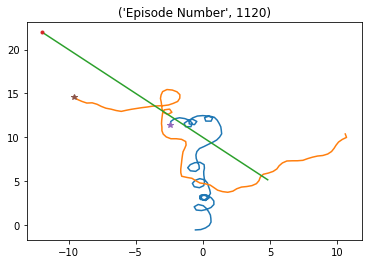

Episode * 1121 * Avg Reward is ==> 3471.7050974333333 : Ag1 Reward ==> 1464.6714872828773 : Ag2 Reward ==> 1608.4531261411207 


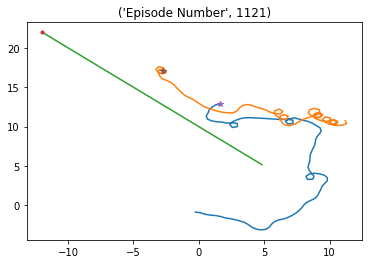

Episode * 1122 * Avg Reward is ==> 3472.074129037447 : Ag1 Reward ==> 1254.4393265998237 : Ag2 Reward ==> 1434.6632965189488 


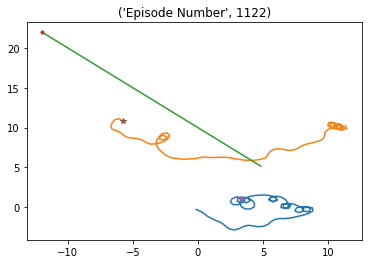

Episode * 1123 * Avg Reward is ==> 3462.490078697813 : Ag1 Reward ==> 1537.1425274725202 : Ag2 Reward ==> 1606.8187564196662 


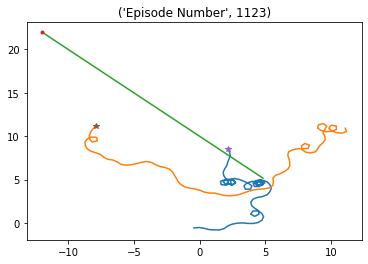

Episode * 1124 * Avg Reward is ==> 3457.645634112112 : Ag1 Reward ==> 1495.3177875775914 : Ag2 Reward ==> 1610.2547553319628 


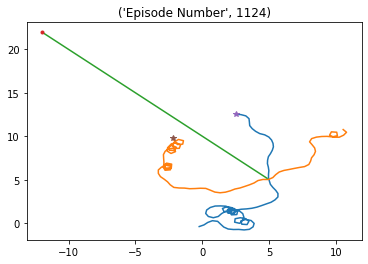

Episode * 1125 * Avg Reward is ==> 3465.6170949932084 : Ag1 Reward ==> 1973.4643626140728 : Ag2 Reward ==> 2069.4538777874395 


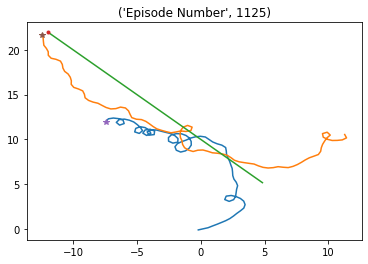

Episode * 1126 * Avg Reward is ==> 3488.202684246916 : Ag1 Reward ==> 1901.887364599245 : Ag2 Reward ==> 2105.9057712020976 


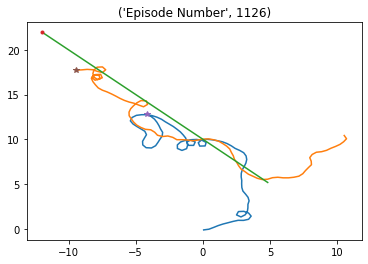

Episode * 1127 * Avg Reward is ==> 3494.268675566657 : Ag1 Reward ==> 1852.3674181664855 : Ag2 Reward ==> 1856.251535320167 


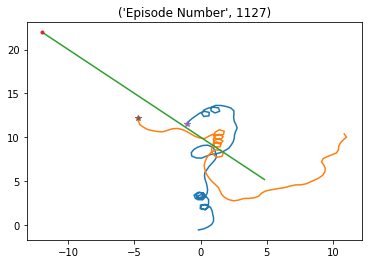

Episode * 1128 * Avg Reward is ==> 3492.074694994072 : Ag1 Reward ==> 1561.7691311377766 : Ag2 Reward ==> 1753.8094482532024 


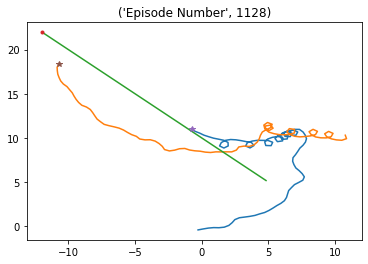

Episode * 1129 * Avg Reward is ==> 3494.2019741357262 : Ag1 Reward ==> 1760.7705082200841 : Ag2 Reward ==> 1850.0709242371418 


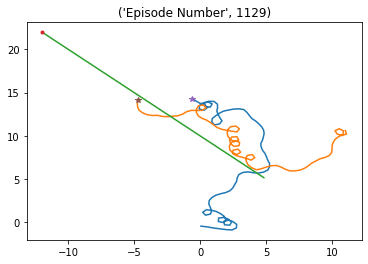

Episode * 1130 * Avg Reward is ==> 3495.6021965300583 : Ag1 Reward ==> 1851.1343559959894 : Ag2 Reward ==> 1764.298079662714 


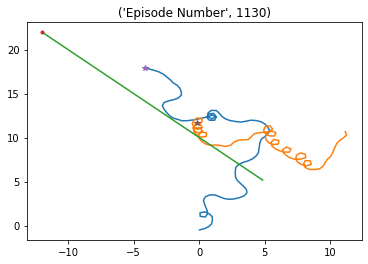

Episode * 1131 * Avg Reward is ==> 3519.127987229999 : Ag1 Reward ==> 1820.4769234149364 : Ag2 Reward ==> 1989.5946824365824 


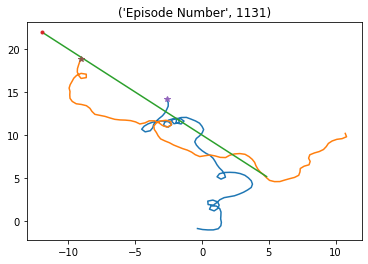

Episode * 1132 * Avg Reward is ==> 3516.9164009704155 : Ag1 Reward ==> 1618.8471624312951 : Ag2 Reward ==> 1690.893385410086 


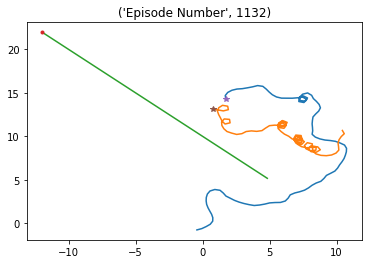

Episode * 1133 * Avg Reward is ==> 3518.22764437062 : Ag1 Reward ==> 1959.153115136526 : Ag2 Reward ==> 1889.356883544508 


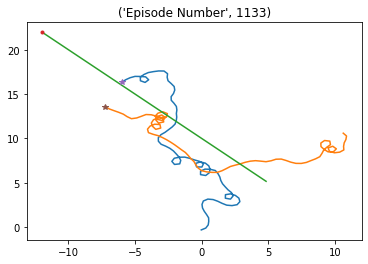

Episode * 1134 * Avg Reward is ==> 3514.2418762071416 : Ag1 Reward ==> 1784.7157685647853 : Ag2 Reward ==> 1830.3529268220864 


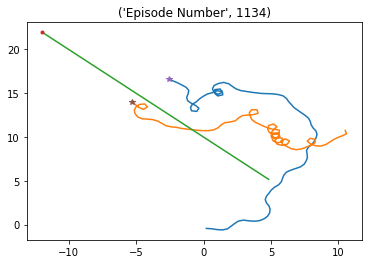

Episode * 1135 * Avg Reward is ==> 3511.803039362682 : Ag1 Reward ==> 1740.4648245004341 : Ag2 Reward ==> 1716.879956695206 


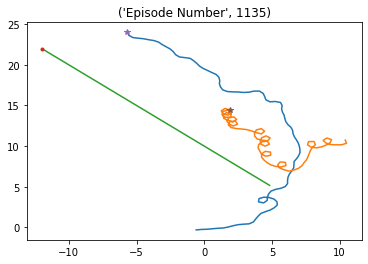

Episode * 1136 * Avg Reward is ==> 3518.2439239786045 : Ag1 Reward ==> 1739.0649130173504 : Ag2 Reward ==> 1750.9662537906377 


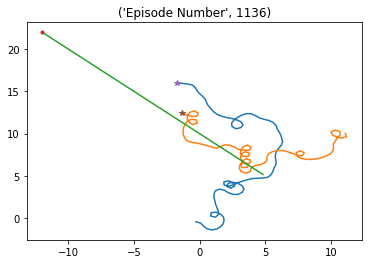

Episode * 1137 * Avg Reward is ==> 3528.3029297841467 : Ag1 Reward ==> 1835.089615590907 : Ag2 Reward ==> 1857.223210062417 


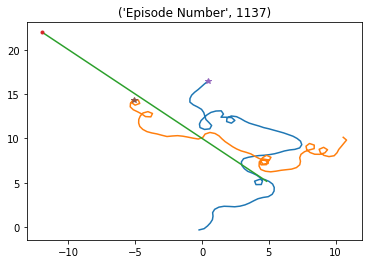

Episode * 1138 * Avg Reward is ==> 3520.037438672828 : Ag1 Reward ==> 1563.2932154270802 : Ag2 Reward ==> 1713.9238282492436 


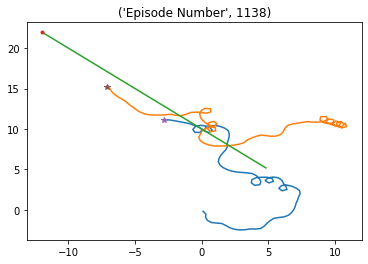

Episode * 1139 * Avg Reward is ==> 3506.759239772016 : Ag1 Reward ==> 1546.2410147665148 : Ag2 Reward ==> 1580.0069181133742 


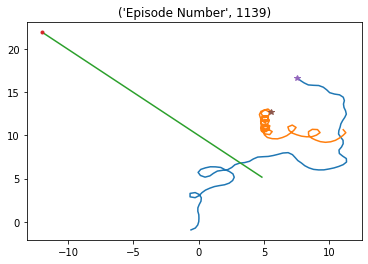

Episode * 1140 * Avg Reward is ==> 3531.8793875643946 : Ag1 Reward ==> 1839.96396775781 : Ag2 Reward ==> 2007.5645363796211 


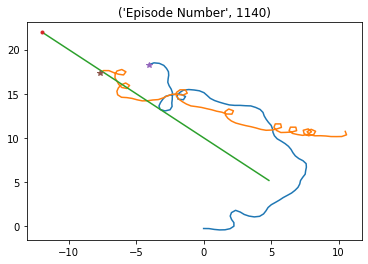

Episode * 1141 * Avg Reward is ==> 3525.810513870866 : Ag1 Reward ==> 1563.0541313033157 : Ag2 Reward ==> 1657.2835859599572 


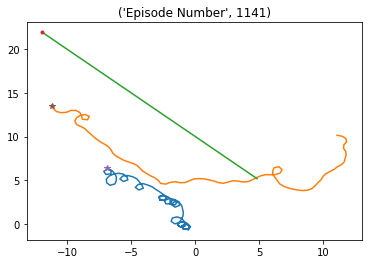

Episode * 1142 * Avg Reward is ==> 3532.1565399853816 : Ag1 Reward ==> 1987.404284612476 : Ag2 Reward ==> 1958.347920343927 


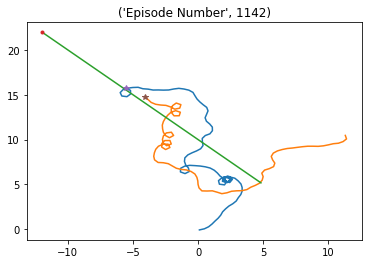

Episode * 1143 * Avg Reward is ==> 3527.1881327262445 : Ag1 Reward ==> 1707.4105216229982 : Ag2 Reward ==> 1768.8294509660718 


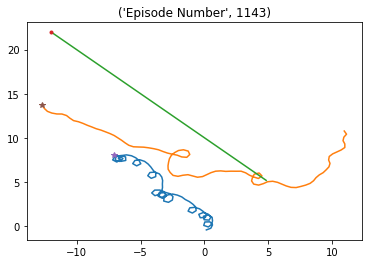

Episode * 1144 * Avg Reward is ==> 3517.4627669844244 : Ag1 Reward ==> 1665.7497805742817 : Ag2 Reward ==> 1690.771593736473 


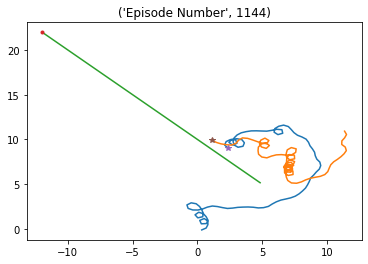

Episode * 1145 * Avg Reward is ==> 3514.7501400566643 : Ag1 Reward ==> 1647.0748868748542 : Ag2 Reward ==> 1788.084543334695 


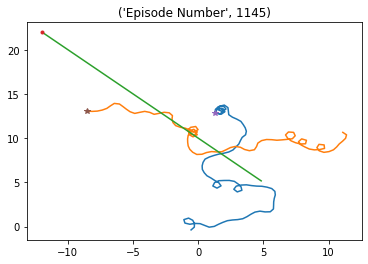

Episode * 1146 * Avg Reward is ==> 3513.250617107721 : Ag1 Reward ==> 1864.0671490940872 : Ag2 Reward ==> 1891.95698240605 


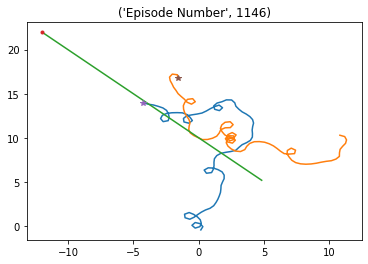

Episode * 1147 * Avg Reward is ==> 3510.140227619803 : Ag1 Reward ==> 1721.0272580682797 : Ag2 Reward ==> 1763.0394564897047 


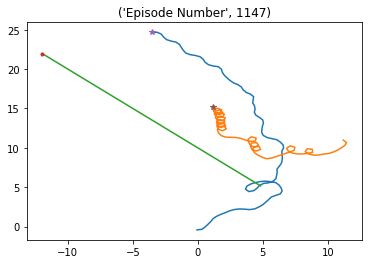

Episode * 1148 * Avg Reward is ==> 3506.715311627423 : Ag1 Reward ==> 1926.864222333573 : Ag2 Reward ==> 1947.9390047413408 


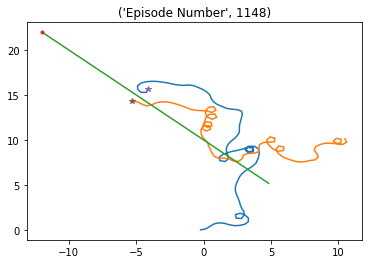

Episode * 1149 * Avg Reward is ==> 3519.75569471745 : Ag1 Reward ==> 1888.5198581505742 : Ag2 Reward ==> 1938.981113867514 


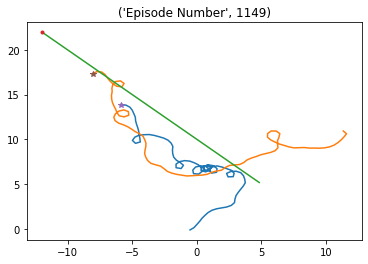

Episode * 1150 * Avg Reward is ==> 3511.5411070031564 : Ag1 Reward ==> 1480.420891032385 : Ag2 Reward ==> 1429.8617239880914 


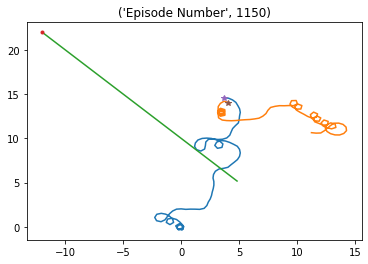

Episode * 1151 * Avg Reward is ==> 3500.613058443322 : Ag1 Reward ==> 1397.1729555489605 : Ag2 Reward ==> 1549.5556678707644 


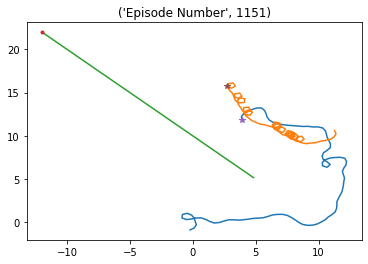

Episode * 1152 * Avg Reward is ==> 3506.8983173707993 : Ag1 Reward ==> 1893.2390240516838 : Ag2 Reward ==> 1987.328641403495 


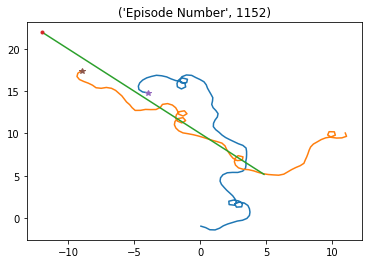

Episode * 1153 * Avg Reward is ==> 3519.8102344357453 : Ag1 Reward ==> 1960.8237764528594 : Ag2 Reward ==> 1924.1643150242123 


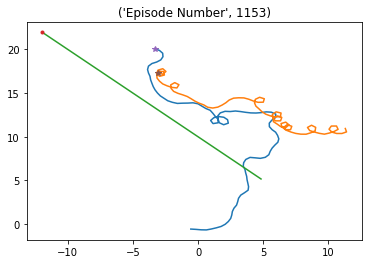

Episode * 1154 * Avg Reward is ==> 3512.3568565205337 : Ag1 Reward ==> 1722.19380300073 : Ag2 Reward ==> 1671.970678804228 


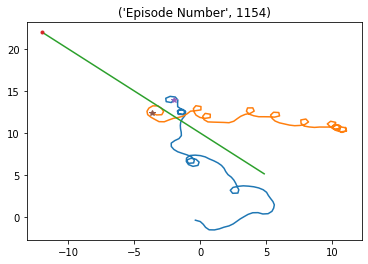

Episode * 1155 * Avg Reward is ==> 3515.26119983475 : Ag1 Reward ==> 1844.9957563279486 : Ag2 Reward ==> 1911.586617732579 


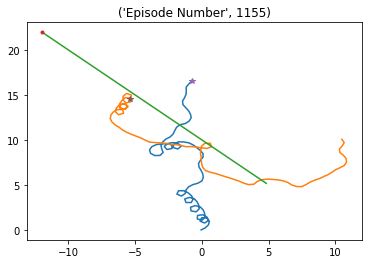

Episode * 1156 * Avg Reward is ==> 3517.4573171642305 : Ag1 Reward ==> 1659.5897612906779 : Ag2 Reward ==> 1656.8673069855015 


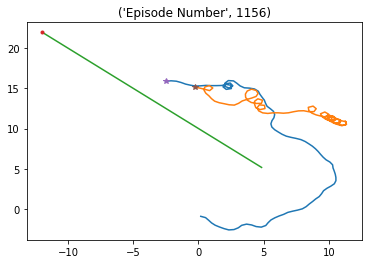

Episode * 1157 * Avg Reward is ==> 3513.5794910417653 : Ag1 Reward ==> 1706.154991919921 : Ag2 Reward ==> 1731.6057070932243 


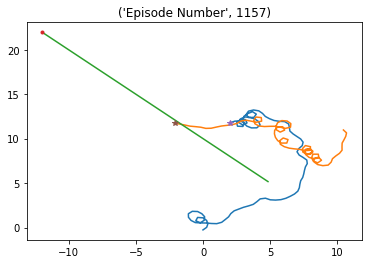

Episode * 1158 * Avg Reward is ==> 3511.7497334855993 : Ag1 Reward ==> 1673.6171616132276 : Ag2 Reward ==> 1892.6824237137023 


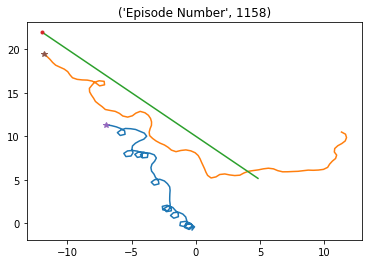

Episode * 1159 * Avg Reward is ==> 3515.536064900174 : Ag1 Reward ==> 1778.639903879634 : Ag2 Reward ==> 1863.9599843365822 


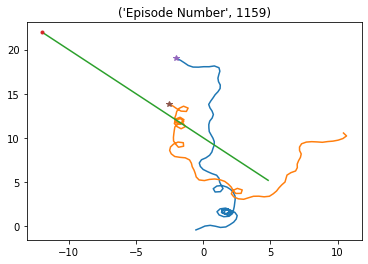

Episode * 1160 * Avg Reward is ==> 3519.2268354569474 : Ag1 Reward ==> 1850.5356434804853 : Ag2 Reward ==> 2018.6839955944893 


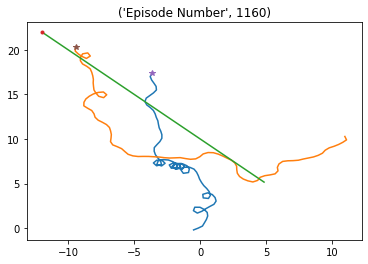

Episode * 1161 * Avg Reward is ==> 3520.20355597554 : Ag1 Reward ==> 1514.2333290737706 : Ag2 Reward ==> 1597.9601050939475 


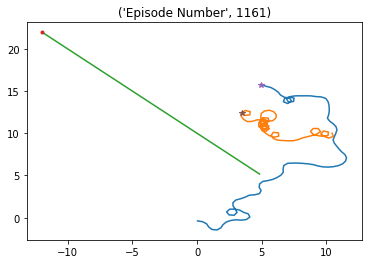

Episode * 1162 * Avg Reward is ==> 3539.041839130464 : Ag1 Reward ==> 1627.4288568944537 : Ag2 Reward ==> 1815.2050924212467 


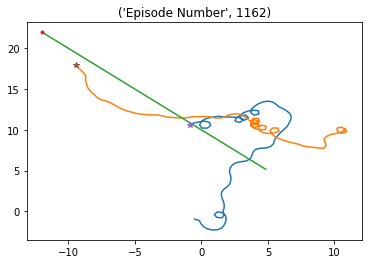

Episode * 1163 * Avg Reward is ==> 3554.8064099774406 : Ag1 Reward ==> 1956.2248531233608 : Ag2 Reward ==> 1818.3192646479101 


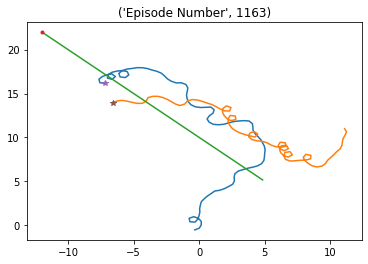

Episode * 1164 * Avg Reward is ==> 3565.489688389317 : Ag1 Reward ==> 1734.6482489114153 : Ag2 Reward ==> 1798.2554304731957 


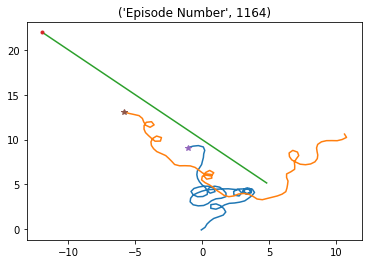

Episode * 1165 * Avg Reward is ==> 3556.9234974483684 : Ag1 Reward ==> 1945.6934336800157 : Ag2 Reward ==> 1754.5771690835654 


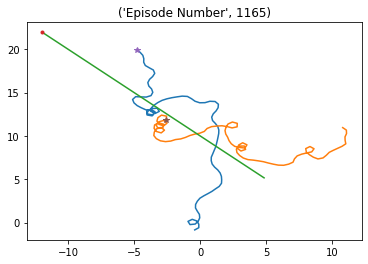

Episode * 1166 * Avg Reward is ==> 3555.7988672258334 : Ag1 Reward ==> 1965.9418922266948 : Ag2 Reward ==> 1996.8660346732495 


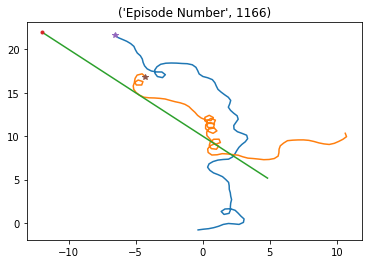

Episode * 1167 * Avg Reward is ==> 3543.874087286127 : Ag1 Reward ==> 1540.280747144097 : Ag2 Reward ==> 1691.3470087543058 


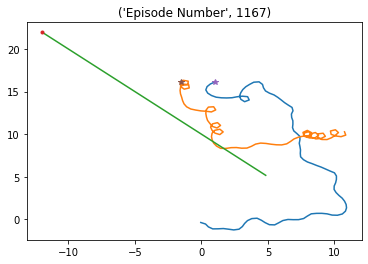

Episode * 1168 * Avg Reward is ==> 3544.209700115543 : Ag1 Reward ==> 1544.2386311386592 : Ag2 Reward ==> 1784.7644614289493 


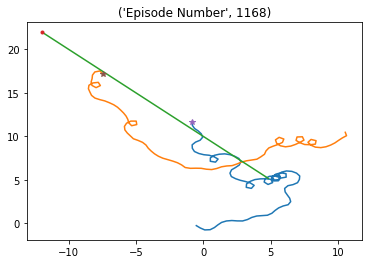

Episode * 1169 * Avg Reward is ==> 3548.3416936664144 : Ag1 Reward ==> 1851.5589375921427 : Ag2 Reward ==> 1924.562236899927 


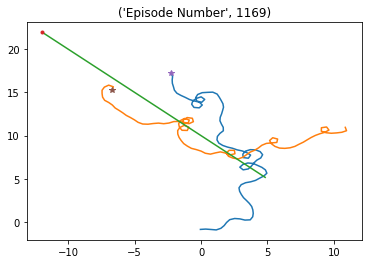

Episode * 1170 * Avg Reward is ==> 3554.5709072821833 : Ag1 Reward ==> 1879.131847681142 : Ag2 Reward ==> 1985.4691326083562 


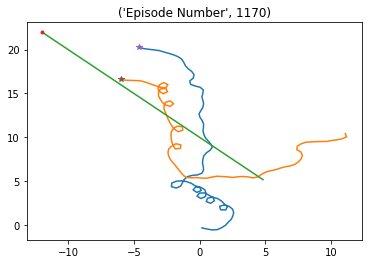

Episode * 1171 * Avg Reward is ==> 3544.5195233897916 : Ag1 Reward ==> 1624.040315601774 : Ag2 Reward ==> 1783.9759345540642 


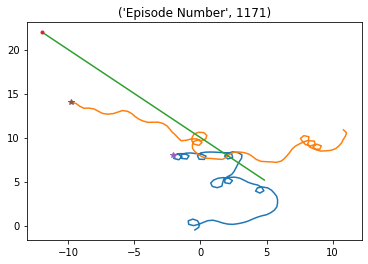

Episode * 1172 * Avg Reward is ==> 3550.6337953066554 : Ag1 Reward ==> 1740.3399288912735 : Ag2 Reward ==> 1813.9714956246585 


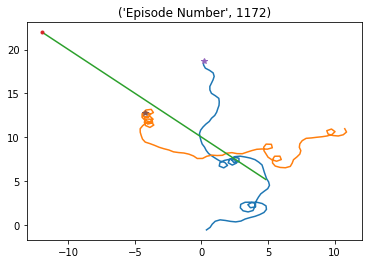

Episode * 1173 * Avg Reward is ==> 3541.2699230190847 : Ag1 Reward ==> 1675.3567644086834 : Ag2 Reward ==> 1798.5983427695057 


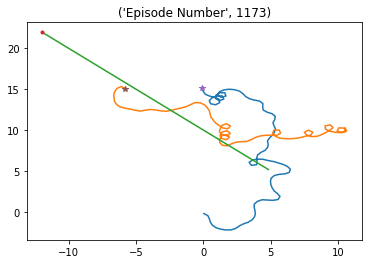

Episode * 1174 * Avg Reward is ==> 3546.1277054914476 : Ag1 Reward ==> 1886.1163760393674 : Ag2 Reward ==> 1923.2636182420424 


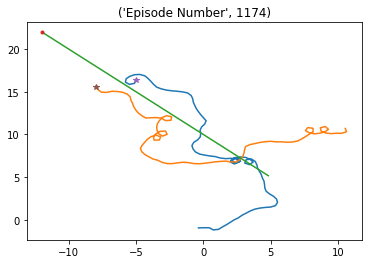

Episode * 1175 * Avg Reward is ==> 3546.065780418304 : Ag1 Reward ==> 1708.0020481270446 : Ag2 Reward ==> 1746.865730142839 


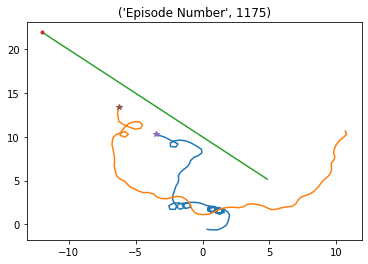

Episode * 1176 * Avg Reward is ==> 3551.3138266775177 : Ag1 Reward ==> 1773.2018776059517 : Ag2 Reward ==> 1926.7511395705696 


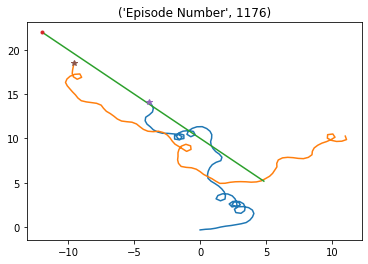

Episode * 1177 * Avg Reward is ==> 3553.86634511211 : Ag1 Reward ==> 1847.1519205175184 : Ag2 Reward ==> 1947.2616425194967 


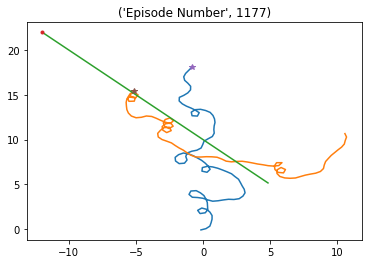

Episode * 1178 * Avg Reward is ==> 3551.0144707029804 : Ag1 Reward ==> 1517.154858021113 : Ag2 Reward ==> 1645.987209290018 


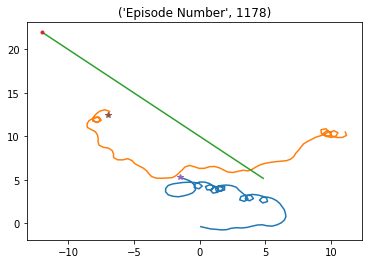

Episode * 1179 * Avg Reward is ==> 3560.5873568457596 : Ag1 Reward ==> 1705.168991349102 : Ag2 Reward ==> 1803.9943872419724 


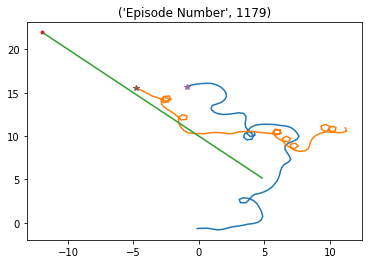

Episode * 1180 * Avg Reward is ==> 3544.7110661427987 : Ag1 Reward ==> 1574.0400196683356 : Ag2 Reward ==> 1638.436856350635 


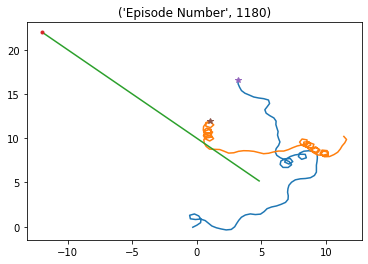

Episode * 1181 * Avg Reward is ==> 3540.5608878403305 : Ag1 Reward ==> 1462.530784078969 : Ag2 Reward ==> 1591.7998010855977 


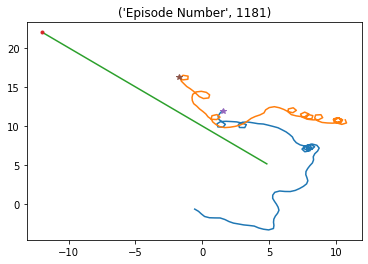

Episode * 1182 * Avg Reward is ==> 3530.177919618071 : Ag1 Reward ==> 1668.5600040898673 : Ag2 Reward ==> 1861.8734719761433 


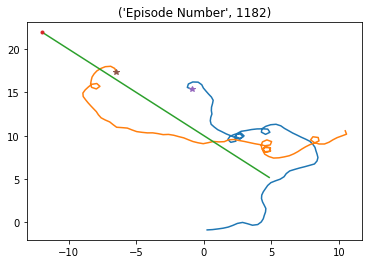

Episode * 1183 * Avg Reward is ==> 3528.090434776676 : Ag1 Reward ==> 1700.199220539212 : Ag2 Reward ==> 1692.5413583940804 


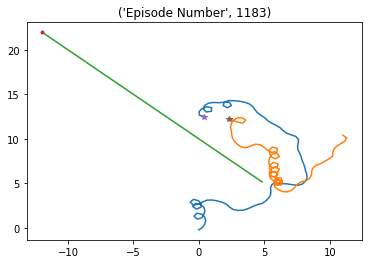

Episode * 1184 * Avg Reward is ==> 3536.721712449615 : Ag1 Reward ==> 1811.7699116909685 : Ag2 Reward ==> 1890.0025695373342 


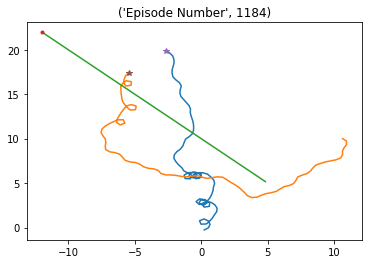

Episode * 1185 * Avg Reward is ==> 3549.404649891991 : Ag1 Reward ==> 1914.17698395946 : Ag2 Reward ==> 2028.2999439451194 


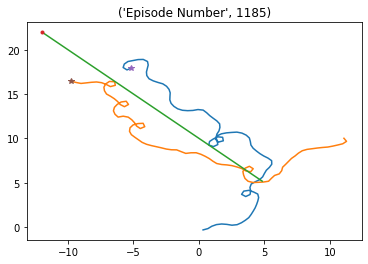

Episode * 1186 * Avg Reward is ==> 3530.439222090799 : Ag1 Reward ==> 1453.1332995444695 : Ag2 Reward ==> 1544.2737199080104 


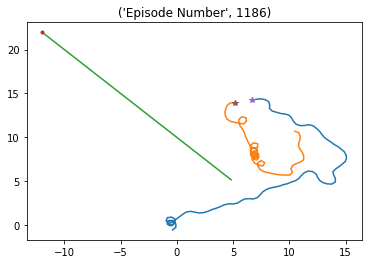

Episode * 1187 * Avg Reward is ==> 3538.0954638523936 : Ag1 Reward ==> 1903.8763184125519 : Ag2 Reward ==> 1886.440066609216 


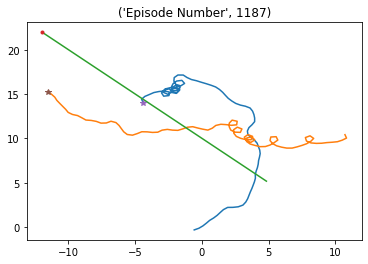

Episode * 1188 * Avg Reward is ==> 3532.3129401505007 : Ag1 Reward ==> 1806.3409955882867 : Ag2 Reward ==> 1837.1612834108878 


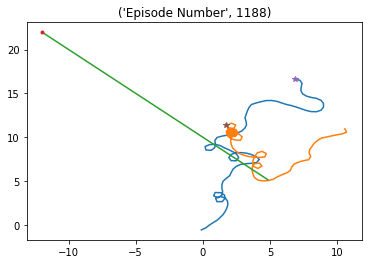

Episode * 1189 * Avg Reward is ==> 3524.0428436146162 : Ag1 Reward ==> 1746.2503717926504 : Ag2 Reward ==> 1750.4467387900493 


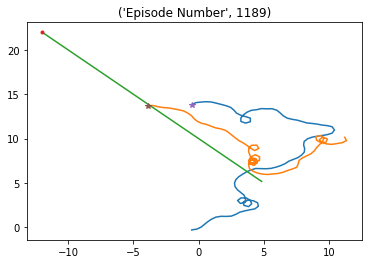

Episode * 1190 * Avg Reward is ==> 3551.538584127812 : Ag1 Reward ==> 1968.687709660085 : Ag2 Reward ==> 2041.4245258882574 


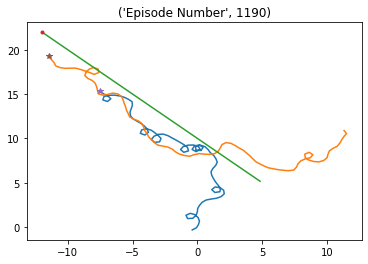

Episode * 1191 * Avg Reward is ==> 3570.8019732877706 : Ag1 Reward ==> 1779.9758059273308 : Ag2 Reward ==> 1937.288383890736 


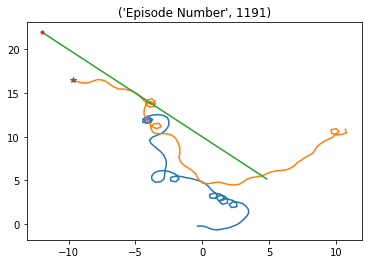

Episode * 1192 * Avg Reward is ==> 3559.130343467663 : Ag1 Reward ==> 1690.3904625792732 : Ag2 Reward ==> 1723.312010071589 


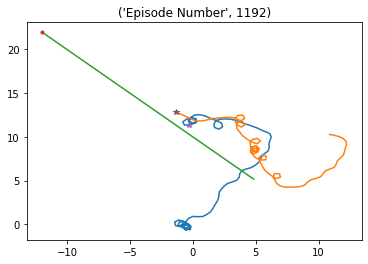

Episode * 1193 * Avg Reward is ==> 3550.7388424504447 : Ag1 Reward ==> 1815.3328713553997 : Ag2 Reward ==> 1733.9951794329613 


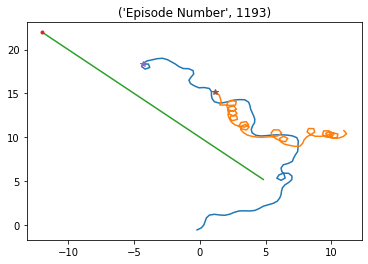

Episode * 1194 * Avg Reward is ==> 3552.9716547057665 : Ag1 Reward ==> 1732.0100961448286 : Ag2 Reward ==> 1751.4668758729995 


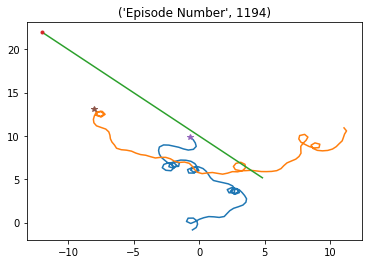

Episode * 1195 * Avg Reward is ==> 3553.8560177224413 : Ag1 Reward ==> 1891.2159617896784 : Ag2 Reward ==> 1900.7409329378183 


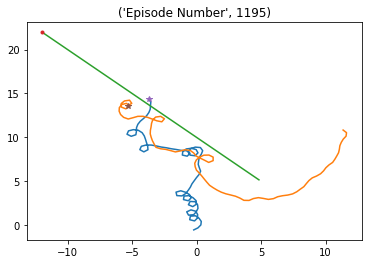

Episode * 1196 * Avg Reward is ==> 3578.7968627051364 : Ag1 Reward ==> 2153.0018604123134 : Ag2 Reward ==> 2161.0890071716694 


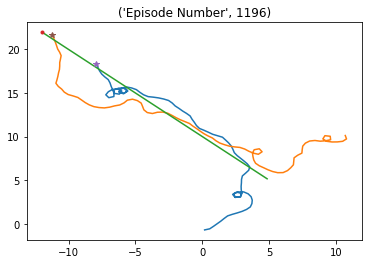

Episode * 1197 * Avg Reward is ==> 3584.7460486644195 : Ag1 Reward ==> 1792.8142385298136 : Ag2 Reward ==> 1882.913898854648 


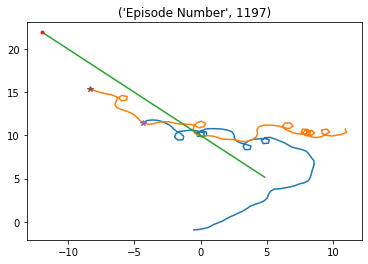

Episode * 1198 * Avg Reward is ==> 3589.25065278181 : Ag1 Reward ==> 1895.500884138202 : Ag2 Reward ==> 1850.982865884375 


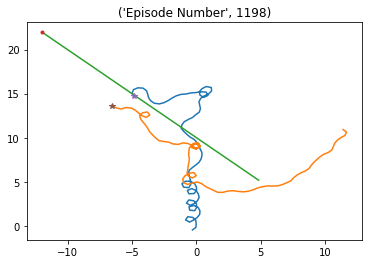

Episode * 1199 * Avg Reward is ==> 3594.874900310756 : Ag1 Reward ==> 1858.0666320154771 : Ag2 Reward ==> 2009.5031573585409 


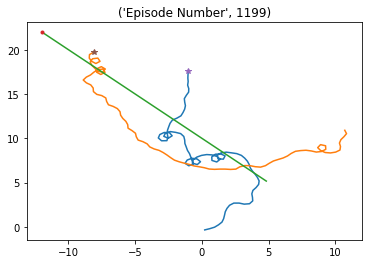

Episode * 1200 * Avg Reward is ==> 3597.4697850206067 : Ag1 Reward ==> 1898.2939141598727 : Ag2 Reward ==> 2074.7211133091837 


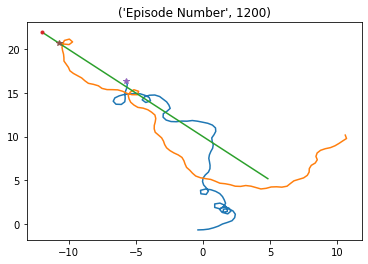

Episode * 1201 * Avg Reward is ==> 3605.9947569669166 : Ag1 Reward ==> 1586.525819830981 : Ag2 Reward ==> 1866.6664921891074 


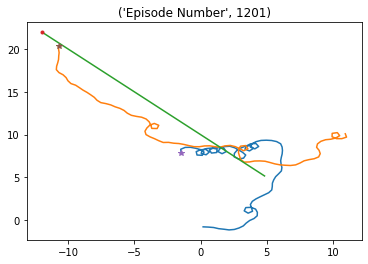

Episode * 1202 * Avg Reward is ==> 3619.500381222662 : Ag1 Reward ==> 1921.9861147947177 : Ag2 Reward ==> 2060.872804750801 


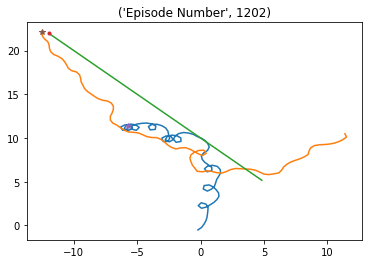

Episode * 1203 * Avg Reward is ==> 3619.2617019307427 : Ag1 Reward ==> 1916.4663247101098 : Ag2 Reward ==> 1848.530621384395 


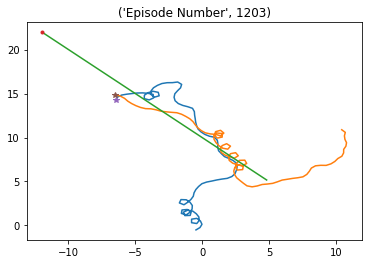

Episode * 1204 * Avg Reward is ==> 3617.4768432848346 : Ag1 Reward ==> 1660.299080857274 : Ag2 Reward ==> 1801.2102526909912 


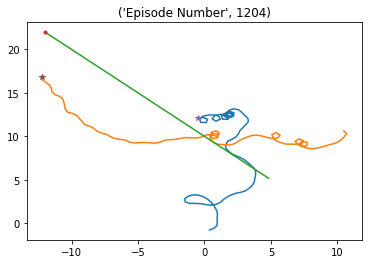

Episode * 1205 * Avg Reward is ==> 3617.171786737049 : Ag1 Reward ==> 1742.0800768602212 : Ag2 Reward ==> 1945.9882639919688 


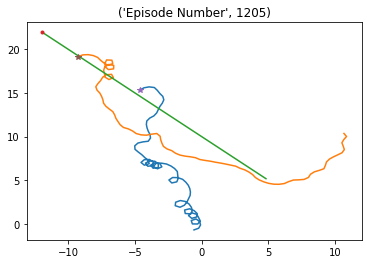

Episode * 1206 * Avg Reward is ==> 3599.85819457521 : Ag1 Reward ==> 1638.407715597744 : Ag2 Reward ==> 1631.8565248285906 


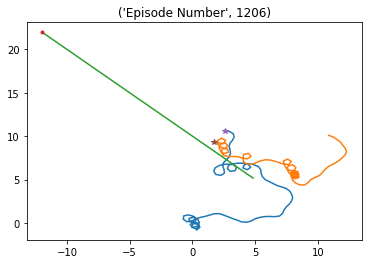

Episode * 1207 * Avg Reward is ==> 3607.3724951035256 : Ag1 Reward ==> 1768.5840503689853 : Ag2 Reward ==> 1763.6157266620833 


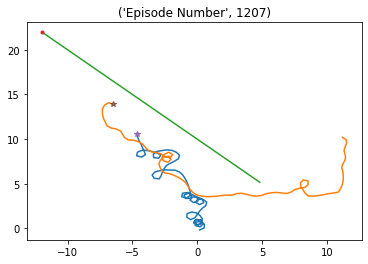

Episode * 1208 * Avg Reward is ==> 3610.1587331276414 : Ag1 Reward ==> 1630.2932899294985 : Ag2 Reward ==> 1810.1593236027272 


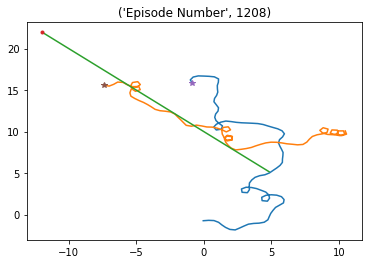

Episode * 1209 * Avg Reward is ==> 3606.6177292210787 : Ag1 Reward ==> 1816.6918258356698 : Ag2 Reward ==> 1817.7891923938894 


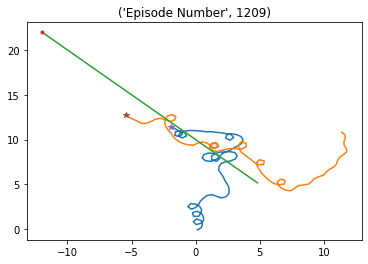

Episode * 1210 * Avg Reward is ==> 3594.8171135331722 : Ag1 Reward ==> 1691.2877294916318 : Ag2 Reward ==> 1701.288623281613 


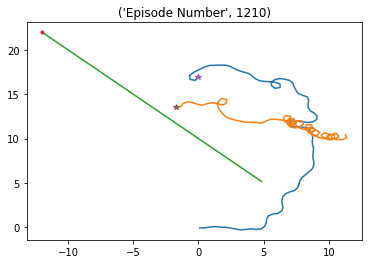

Episode * 1211 * Avg Reward is ==> 3595.5363496868713 : Ag1 Reward ==> 1652.9381923394621 : Ag2 Reward ==> 1783.8475039643151 


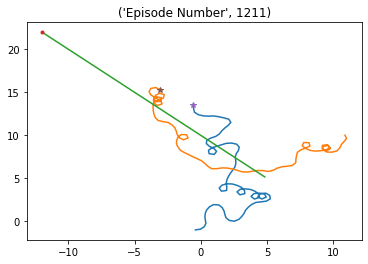

Episode * 1212 * Avg Reward is ==> 3603.6762334722093 : Ag1 Reward ==> 2002.2354466850372 : Ag2 Reward ==> 1877.6713292444647 


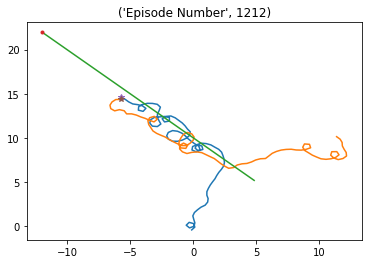

Episode * 1213 * Avg Reward is ==> 3616.3757479928295 : Ag1 Reward ==> 2012.6175002387743 : Ag2 Reward ==> 1969.3181877642014 


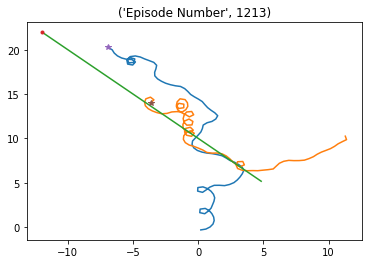

Episode * 1214 * Avg Reward is ==> 3613.0293511486643 : Ag1 Reward ==> 1772.9294872197577 : Ag2 Reward ==> 1902.5946332950275 


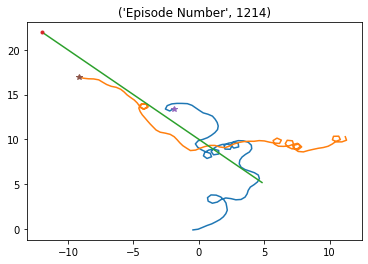

Episode * 1215 * Avg Reward is ==> 3614.387659642972 : Ag1 Reward ==> 1751.9162784334178 : Ag2 Reward ==> 1757.2838396088014 


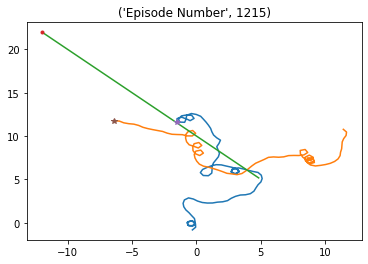

Episode * 1216 * Avg Reward is ==> 3603.129754368444 : Ag1 Reward ==> 1567.9772886583546 : Ag2 Reward ==> 1681.6595175370423 


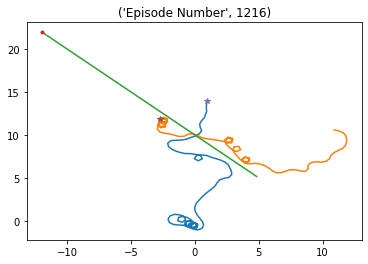

Episode * 1217 * Avg Reward is ==> 3592.8677159898616 : Ag1 Reward ==> 1654.4149607006455 : Ag2 Reward ==> 1729.5170671930484 


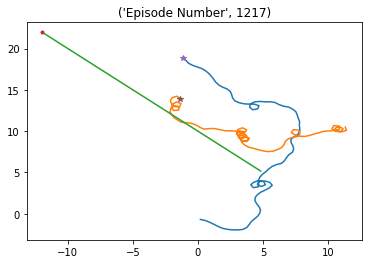

KeyboardInterrupt: ignored

In [ ]:

ep_reward_list = []
# To store average reward history of last few episodes
avg_reward_list = []

ag1_reward_list = []
ag2_reward_list = []

# Takes about 20 min to train
for ep in range(num_episodes):

    env = environment()
    prev_state = env.initial_obs()

    
    episodic_reward = 0
    ag1_reward = 0
    ag2_reward = 0
    
    xp1 = []
    yp1 = []
    xp2 = []
    yp2 = []
    xce = []
    yce = []

    
    #while True:
    for i in range(num_steps):
        
        tf_prev_state = tf.expand_dims(tf.convert_to_tensor(prev_state), 0)
        actions = []
        for j, model in enumerate(ac_models):
          action = policy(tf_prev_state[:,5*j:5*(j+1)], ou_noise, model)
          actions.append(float(action[0]))

        # Recieve state and reward from environment.
        #new_state, sys_state, ev_state = transition(prev_state, sys_state, actions, ev_state)
        new_state = env.step(actions)
        rewards = reward(new_state)

        buffer.record((prev_state, actions, rewards, new_state))
        
        episodic_reward += sum(rewards)
        ag1_reward += rewards[0]
        ag2_reward += rewards[1]

        buffer.learn(ac_models, cr_models, target_ac, target_cr)
        update_target(tau, ac_models, cr_models, target_ac, target_cr)

        prev_state = new_state
        xp1.append(env.p1_rx)
        yp1.append(env.p1_ry)
        xp2.append(env.p2_rx)
        yp2.append(env.p2_ry)
        
        xce.append(env.e_rx)
        yce.append(env.e_ry)
        
    xc1 = [env.e_rx]
    yc1 = [env.e_ry]

    ep_reward_list.append(episodic_reward)
    ag1_reward_list.append(ag1_reward)
    ag2_reward_list.append(ag2_reward)

    # Mean of last 40 episodes
    avg_reward = np.mean(ep_reward_list[-40:])
    print("Episode * {} * Avg Reward is ==> {} : Ag1 Reward ==> {} : Ag2 Reward ==> {} ".format(ep+1, avg_reward, ag1_reward, ag2_reward))
    avg_reward_list.append(avg_reward)
    plt.plot(xp1,yp1)
    plt.plot(xp2,yp2)
    plt.plot(xce,yce)
    plt.plot(xc1,yc1,'.') 
    plt.plot(xp1[-1],yp1[-1],'*')
    plt.plot(xp2[-1],yp2[-1],'*')
    title = 'Episode Number', ep+1
    plt.title(title)
    plt.show()

# Plotting graph
# Episodes versus Avg. Rewards
plt.plot(avg_reward_list)
plt.xlabel("Episode")
plt.ylabel("Avg. Epsiodic Reward")
plt.show()

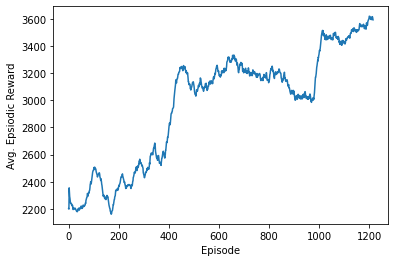

In [ ]:
import matplotlib.pyplot as plt
plt.xlabel("Episode")
plt.ylabel("Avg. Epsiodic Reward")
plt.plot(avg_reward_list)

Captured
Episode * 1 * Avg Reward is ==> 1121.141689242887 : Ag1 Reward ==> 578.6859983933707 : Ag2 Reward ==> 542.4556908495164 


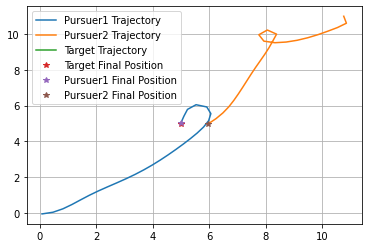

In [ ]:
ve = 0.0
dt = 0.4
rho = 0.3
te = 3*np.pi/4
def policy(state, noise_object, model):
    
    sampled_actions = tf.squeeze(model(state))
    noise = noise_object()

    # Adding noise to action
    sampled_actions = sampled_actions.numpy() + 0

    # We make sure action is within bounds
    legal_action = np.clip(sampled_actions, -1.0, 1.0)

    return [np.squeeze(legal_action)]


import random
class environment:
  def __init__(self):
    self.p1_rx = random.uniform(0.0, -1.0)
    self.p1_ry = random.uniform(0.0, -1.0)
    self.p2_rx = random.uniform(10.0, 11.0)
    self.p2_ry = random.uniform(10.0, 11.0)
    self.p1_vx = 1.0
    self.p1_vy = 0.0
    self.p2_vx = 1.0
    self.p2_vy = 0.0
    self.e_rx = +5.0
    self.e_ry = +5.0
    self.e_vx = ve*np.cos(te)
    self.e_vy = ve*np.sin(te)
    '''
    self.state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.e_rx,
                  self.e_ry]
    self.state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.e_rx,
                  self.e_ry]
    self.state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.p2_rx,
                   self.p1_ry]
    self.state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.p1_rx,
                   self.p1_ry]
    '''

  def initial_state(self):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                   self.p1_ry]
    state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                   self.p1_ry]
    return state_p1_e, state_p2_e
    

  def initial_obs(self):
    #state_p1_e, state_p2_e = self.initial_state()

    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, 0.0, d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, 0.0, d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs

  def state_step(self, actions):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    theta_v_p1 = thetap(state_p1_e)
    theta_v_p2 = thetap(state_p2_e)

    

    del_rx_p1 = self.p1_vx * dt
    del_ry_p1 = self.p1_vy * dt
    del_rx_p2 = self.p2_vx * dt
    del_ry_p2 = self.p2_vy * dt
    del_rx_e  = self.e_vx  * dt
    del_ry_e  = self.e_vy  * dt

    del_theta_v_p1 = (1.0/rho)*actions[0]*dt
    del_theta_v_p2 = (1.0/rho)*actions[1]*dt

    theta_v_p1 = theta_v_p1 + del_theta_v_p1
    theta_v_p2 = theta_v_p2 + del_theta_v_p2

    self.p1_rx = self.p1_rx + del_rx_p1
    self.p1_ry = self.p1_ry + del_ry_p1
    self.p1_vx = 1.0 * np.cos(theta_v_p1)
    self.p1_vy = 1.0 * np.sin(theta_v_p1)

    self.p2_rx = self.p2_rx + del_rx_p2
    self.p2_ry = self.p2_ry + del_ry_p2
    self.p2_vx = 1.0 * np.cos(theta_v_p2)
    self.p2_vy = 1.0 * np.sin(theta_v_p2)

    self.e_rx = self.e_rx + del_rx_e
    self.e_ry = self.e_ry + del_ry_e

    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]

    return state_p1_e, state_p2_e

  def step(self, actions):

    old_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    old_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    state_p1_e, state_p2_e = self.state_step(actions)

    '''
    obs_p1 = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt)]
    obs_p2 = [d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]

    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt),
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]
    '''
    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    new_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    new_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt), d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt), d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs
  
  

ep_reward_list = []
# To store average reward history of last few episodes
avg_reward_list = []

ag1_reward_list = []
ag2_reward_list = []

# Takes about 20 min to train
for ep in range(1):

    env = environment()
    prev_state = env.initial_obs()

    '''
    sys_state = [0.0,0.0,1.0,0.0]
    ev_state = [5.0,5.0]

    ag_state = []

    for i in sys_state:
      ag_state.append(i)
    for i in ev_state:
      ag_state.append(i)
    
    prev_state = [L(ag_state)/30.0, phi(ag_state)/np.pi, 0.0]

    for i in range(1,num_agents):
      sys_state.append(sys_state[0])
      sys_state.append(sys_state[1]+i)
      sys_state.append(sys_state[2])
      sys_state.append(sys_state[3])

      ag_state = []

      for j in sys_state[i*4:]:
        ag_state.append(j)
      for j in ev_state:
        ag_state.append(j)

      prev_state.append(L(ag_state)/30.0)
      prev_state.append(phi(ag_state)/np.pi)
      prev_state.append(0.0)
    
    prev_state = np.array(prev_state)
    '''
    episodic_reward = 0
    ag1_reward = 0
    ag2_reward = 0
    
    xp1 = []
    yp1 = []
    xp2 = []
    yp2 = []
    xce = []
    yce = []

    
    #while True:
    for i in range(300):
        
        tf_prev_state = tf.expand_dims(tf.convert_to_tensor(prev_state), 0)
        actions = []
        for j, model in enumerate(ac_models):
          action = policy(tf_prev_state[:,5*j:5*(j+1)], ou_noise, model)
          actions.append(float(action[0]))

        # Recieve state and reward from environment.
        #new_state, sys_state, ev_state = transition(prev_state, sys_state, actions, ev_state)
        new_state = env.step(actions)
        rewards = reward(new_state)

        #buffer.record((prev_state, actions, rewards, new_state))
        
        episodic_reward += sum(rewards)
        ag1_reward += rewards[0]
        ag2_reward += rewards[1]

        #buffer.learn(ac_models, cr_models, target_ac, target_cr)
        #update_target(tau, ac_models, cr_models, target_ac, target_cr)

        prev_state = new_state
        xp1.append(env.p1_rx)
        yp1.append(env.p1_ry)
        xp2.append(env.p2_rx)
        yp2.append(env.p2_ry)
        
        xce.append(env.e_rx)
        yce.append(env.e_ry)

        d_p1_e = L(env.p1_rx, env.p1_ry, env.e_rx, env.e_ry)
        d_p2_e = L(env.p2_rx, env.p2_ry, env.e_rx, env.e_ry)

        if d_p1_e < 0.2 or d_p2_e < 0.2:
          print("Captured")
          break
        
    xc1 = [env.e_rx]
    yc1 = [env.e_ry]

    ep_reward_list.append(episodic_reward)
    ag1_reward_list.append(ag1_reward)
    ag2_reward_list.append(ag2_reward)

    # Mean of last 40 episodes
    avg_reward = np.mean(ep_reward_list[-40:])
    print("Episode * {} * Avg Reward is ==> {} : Ag1 Reward ==> {} : Ag2 Reward ==> {} ".format(ep+1, avg_reward, ag1_reward, ag2_reward))
    avg_reward_list.append(avg_reward)
     
    

    plt.plot(xp1,yp1, label = 'Pursuer1 Trajectory')
    plt.plot(xp2,yp2, label = 'Pursuer2 Trajectory')
    plt.plot(xce,yce, label = 'Target Trajectory')
    plt.plot(xc1,yc1,'*', label = 'Target Final Position')

    plt.plot(xp1[-1],yp1[-1],'*', label = 'Pursuer1 Final Position')
    plt.plot(xp2[-1],yp2[-1],'*', label = 'Pursuer2 Final Position')

    plt.legend()
    plt.grid()
    plt.show()
    


# Plotting graph


Captured
Episode * 1 * Avg Reward is ==> 9868.302147501829 : Ag1 Reward ==> 5038.763869163584 : Ag2 Reward ==> 4829.538278338249 


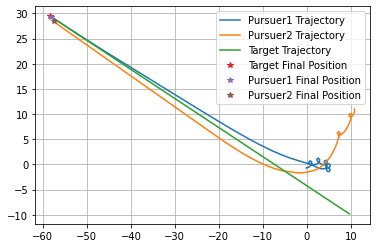

In [ ]:
ve = 0.9
dt = 0.4
rho = 0.3
te = 5*np.pi/6
def policy(state, noise_object, model):
    
    sampled_actions = tf.squeeze(model(state))
    noise = noise_object()

    # Adding noise to action
    sampled_actions = sampled_actions.numpy() + 0

    # We make sure action is within bounds
    legal_action = np.clip(sampled_actions, -1.0, 1.0)

    return [np.squeeze(legal_action)]


import random
class environment:
  def __init__(self):
    self.p1_rx = random.uniform(0.0, -1.0)
    self.p1_ry = random.uniform(0.0, -1.0)
    self.p2_rx = random.uniform(10.0, 11.0)
    self.p2_ry = random.uniform(10.0, 11.0)
    self.p1_vx = 1.0
    self.p1_vy = 0.0
    self.p2_vx = 1.0
    self.p2_vy = 0.0
    self.e_rx = 10.0
    self.e_ry = -10.0
    self.e_vx = ve*np.cos(te)
    self.e_vy = ve*np.sin(te)
    '''
    self.state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.e_rx,
                  self.e_ry]
    self.state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.e_rx,
                  self.e_ry]
    self.state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.p2_rx,
                   self.p1_ry]
    self.state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.p1_rx,
                   self.p1_ry]
    '''

  def initial_state(self):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                   self.p1_ry]
    state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                   self.p1_ry]
    return state_p1_e, state_p2_e
    

  def initial_obs(self):
    #state_p1_e, state_p2_e = self.initial_state()

    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, 0.0, d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, 0.0, d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs

  def state_step(self, actions):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    theta_v_p1 = thetap(state_p1_e)
    theta_v_p2 = thetap(state_p2_e)

    

    del_rx_p1 = self.p1_vx * dt
    del_ry_p1 = self.p1_vy * dt
    del_rx_p2 = self.p2_vx * dt
    del_ry_p2 = self.p2_vy * dt
    del_rx_e  = self.e_vx  * dt
    del_ry_e  = self.e_vy  * dt

    del_theta_v_p1 = (1.0/rho)*actions[0]*dt
    del_theta_v_p2 = (1.0/rho)*actions[1]*dt

    theta_v_p1 = theta_v_p1 + del_theta_v_p1
    theta_v_p2 = theta_v_p2 + del_theta_v_p2

    self.p1_rx = self.p1_rx + del_rx_p1
    self.p1_ry = self.p1_ry + del_ry_p1
    self.p1_vx = 1.0 * np.cos(theta_v_p1)
    self.p1_vy = 1.0 * np.sin(theta_v_p1)

    self.p2_rx = self.p2_rx + del_rx_p2
    self.p2_ry = self.p2_ry + del_ry_p2
    self.p2_vx = 1.0 * np.cos(theta_v_p2)
    self.p2_vy = 1.0 * np.sin(theta_v_p2)

    self.e_rx = self.e_rx + del_rx_e
    self.e_ry = self.e_ry + del_ry_e

    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]

    return state_p1_e, state_p2_e

  def step(self, actions):

    old_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    old_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    state_p1_e, state_p2_e = self.state_step(actions)

    '''
    obs_p1 = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt)]
    obs_p2 = [d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]

    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt),
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]
    '''
    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    new_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    new_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt), d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt), d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs
  
  

ep_reward_list = []
# To store average reward history of last few episodes
avg_reward_list = []

ag1_reward_list = []
ag2_reward_list = []

# Takes about 20 min to train
for ep in range(1):

    env = environment()
    prev_state = env.initial_obs()

    '''
    sys_state = [0.0,0.0,1.0,0.0]
    ev_state = [5.0,5.0]

    ag_state = []

    for i in sys_state:
      ag_state.append(i)
    for i in ev_state:
      ag_state.append(i)
    
    prev_state = [L(ag_state)/30.0, phi(ag_state)/np.pi, 0.0]

    for i in range(1,num_agents):
      sys_state.append(sys_state[0])
      sys_state.append(sys_state[1]+i)
      sys_state.append(sys_state[2])
      sys_state.append(sys_state[3])

      ag_state = []

      for j in sys_state[i*4:]:
        ag_state.append(j)
      for j in ev_state:
        ag_state.append(j)

      prev_state.append(L(ag_state)/30.0)
      prev_state.append(phi(ag_state)/np.pi)
      prev_state.append(0.0)
    
    prev_state = np.array(prev_state)
    '''
    episodic_reward = 0
    ag1_reward = 0
    ag2_reward = 0
    
    xp1 = []
    yp1 = []
    xp2 = []
    yp2 = []
    xce = []
    yce = []

    
    #while True:
    for i in range(300):
        
        tf_prev_state = tf.expand_dims(tf.convert_to_tensor(prev_state), 0)
        actions = []
        for j, model in enumerate(ac_models):
          action = policy(tf_prev_state[:,5*j:5*(j+1)], ou_noise, model)
          actions.append(float(action[0]))

        # Recieve state and reward from environment.
        #new_state, sys_state, ev_state = transition(prev_state, sys_state, actions, ev_state)
        new_state = env.step(actions)
        rewards = reward(new_state)

        #buffer.record((prev_state, actions, rewards, new_state))
        
        episodic_reward += sum(rewards)
        ag1_reward += rewards[0]
        ag2_reward += rewards[1]

        #buffer.learn(ac_models, cr_models, target_ac, target_cr)
        #update_target(tau, ac_models, cr_models, target_ac, target_cr)

        prev_state = new_state
        xp1.append(env.p1_rx)
        yp1.append(env.p1_ry)
        xp2.append(env.p2_rx)
        yp2.append(env.p2_ry)
        
        xce.append(env.e_rx)
        yce.append(env.e_ry)

        d_p1_e = L(env.p1_rx, env.p1_ry, env.e_rx, env.e_ry)
        d_p2_e = L(env.p2_rx, env.p2_ry, env.e_rx, env.e_ry)

        if d_p1_e < 0.2 or d_p2_e < 0.2:
          print("Captured")
          break
        
    xc1 = [env.e_rx]
    yc1 = [env.e_ry]

    ep_reward_list.append(episodic_reward)
    ag1_reward_list.append(ag1_reward)
    ag2_reward_list.append(ag2_reward)

    # Mean of last 40 episodes
    avg_reward = np.mean(ep_reward_list[-40:])
    print("Episode * {} * Avg Reward is ==> {} : Ag1 Reward ==> {} : Ag2 Reward ==> {} ".format(ep+1, avg_reward, ag1_reward, ag2_reward))
    avg_reward_list.append(avg_reward)
    plt.plot(xp1,yp1, label = 'Pursuer1 Trajectory')
    plt.plot(xp2,yp2, label = 'Pursuer2 Trajectory')
    plt.plot(xce,yce, label = 'Target Trajectory')
    plt.plot(xc1,yc1,'*', label = 'Target Final Position')

    plt.plot(xp1[-1],yp1[-1],'*', label = 'Pursuer1 Final Position')
    plt.plot(xp2[-1],yp2[-1],'*', label = 'Pursuer2 Final Position')

    plt.legend()
    plt.grid()
    plt.show()
# Plotting graph


captured
Episode * 1 * Avg Reward is ==> 3509.1080722897186 : Ag1 Reward ==> 1622.709045066251 : Ag2 Reward ==> 1886.3990272234682 


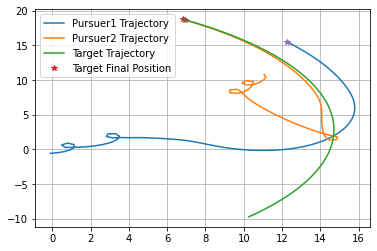

In [ ]:
ve = 0.9
dt = 0.4
rho = 0.3
te = np.pi/4
rho_e = 2.0
def policy(state, noise_object, model):
    
    sampled_actions = tf.squeeze(model(state))
    noise = noise_object()

    # Adding noise to action
    sampled_actions = sampled_actions.numpy() + 0

    # We make sure action is within bounds
    legal_action = np.clip(sampled_actions, -1.0, 1.0)

    return [np.squeeze(legal_action)]

import random
class environment:
  def __init__(self):
    self.p1_rx = random.uniform(0.0, -1.0)
    self.p1_ry = random.uniform(0.0, -1.0)
    self.p2_rx = random.uniform(10.0, 11.0)
    self.p2_ry = random.uniform(10.0, 11.0)
    self.p1_vx = 1.0
    self.p1_vy = 0.0
    self.p2_vx = 1.0
    self.p2_vy = 0.0
    self.e_rx = 10.0
    self.e_ry = -10.0
    self.e_vx = ve*np.cos(te)
    self.e_vy = ve*np.sin(te)
    '''
    self.state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.e_rx,
                  self.e_ry]
    self.state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.e_rx,
                  self.e_ry]
    self.state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_ry, self.p2_rx,
                   self.p1_ry]
    self.state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_ry, self.p1_rx,
                   self.p1_ry]
    '''

  def initial_state(self):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    state_p1_p2 = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                   self.p1_ry]
    state_p2_p1 = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                   self.p1_ry]
    return state_p1_e, state_p2_e
    

  def initial_obs(self):
    #state_p1_e, state_p2_e = self.initial_state()

    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, 0.0, d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, 0.0, d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs

  def state_step(self, actions, theta_v_e):
    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]
    theta_v_p1 = thetap(state_p1_e)
    theta_v_p2 = thetap(state_p2_e)

    

    del_rx_p1 = self.p1_vx * dt
    del_ry_p1 = self.p1_vy * dt
    del_rx_p2 = self.p2_vx * dt
    del_ry_p2 = self.p2_vy * dt
    del_rx_e  = self.e_vx  * dt
    del_ry_e  = self.e_vy  * dt

    del_theta_v_p1 = (1.0/rho)*actions[0]*dt
    del_theta_v_p2 = (1.0/rho)*actions[1]*dt
    del_theta_v_e  = (ve/rho_e)*0.1*dt

    theta_v_p1 = theta_v_p1 + del_theta_v_p1
    theta_v_p2 = theta_v_p2 + del_theta_v_p2
    theta_v_e  = theta_v_e  + del_theta_v_e

    self.p1_rx = self.p1_rx + del_rx_p1
    self.p1_ry = self.p1_ry + del_ry_p1
    self.p1_vx = 1.0 * np.cos(theta_v_p1)
    self.p1_vy = 1.0 * np.sin(theta_v_p1)

    self.p2_rx = self.p2_rx + del_rx_p2
    self.p2_ry = self.p2_ry + del_ry_p2
    self.p2_vx = 1.0 * np.cos(theta_v_p2)
    self.p2_vy = 1.0 * np.sin(theta_v_p2)

    self.e_rx = self.e_rx + del_rx_e
    self.e_ry = self.e_ry + del_ry_e
    self.e_vx = ve * np.cos(theta_v_e)
    self.e_vy = ve * np.sin(theta_v_e)

    state_p1_e = [self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry]
    state_p2_e = [self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry]

    return state_p1_e, state_p2_e, theta_v_e

  def step(self, actions, theta_v_e):

    old_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    old_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    state_p1_e, state_p2_e, theta_v_e = self.state_step(actions, theta_v_e)

    '''
    obs_p1 = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt)]
    obs_p2 = [d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]

    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt),
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt)]
    '''
    d_p1_e = L(self.p1_rx, self.p1_ry, self.e_rx, self.e_ry)
    d_p2_e = L(self.p2_rx, self.p2_ry, self.e_rx, self.e_ry)
    d_p1_p2 = L(self.p1_rx, self.p1_ry, self.p2_rx, self.p2_ry)
    d_p2_p1 = L(self.p2_rx, self.p2_ry, self.p1_rx, self.p1_ry)
    
    phi_p1_e  = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    phi_p1_p2 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.p2_rx,
                  self.p2_ry)
    phi_p2_e  = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    phi_p2_p1 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p1  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p1_rx,
                  self.p1_ry)
    phi_e_p2  = phi(self.e_rx, self.e_ry, self.e_vx, self.e_vy, self.p2_rx,
                  self.p2_ry)
    
    new_phi_p1 = phi(self.p1_rx, self.p1_ry, self.p1_vx, self.p1_vy, self.e_rx,
                  self.e_ry)
    new_phi_p2 = phi(self.p2_rx, self.p2_ry, self.p2_vx, self.p2_vy, self.e_rx,
                  self.e_ry)
    
    obs = [d_p1_e/30.0, phi_p1_e/np.pi, (new_phi_p1-old_phi_p1)/(dt), d_p1_p2/30.0, phi_p1_p2/np.pi,
           d_p2_e/30.0, phi_p2_e/np.pi, (new_phi_p2-old_phi_p2)/(dt), d_p2_p1/30.0, phi_p2_p1/np.pi]
           #d_e_p1/30.0, phi_e_p1/np.pi, d_e_p2/30.0,  phi_e_p2/np.pi]

    return obs, theta_v_e
  


ep_reward_list = []
# To store average reward history of last few episodes
avg_reward_list = []

ag1_reward_list = []
ag2_reward_list = []

# Takes about 20 min to train
for ep in range(1):

    env = environment()
    prev_state = env.initial_obs()

    '''
    sys_state = [0.0,0.0,1.0,0.0]
    ev_state = [5.0,5.0]

    ag_state = []

    for i in sys_state:
      ag_state.append(i)
    for i in ev_state:
      ag_state.append(i)
    
    prev_state = [L(ag_state)/30.0, phi(ag_state)/np.pi, 0.0]

    for i in range(1,num_agents):
      sys_state.append(sys_state[0])
      sys_state.append(sys_state[1]+i)
      sys_state.append(sys_state[2])
      sys_state.append(sys_state[3])

      ag_state = []

      for j in sys_state[i*4:]:
        ag_state.append(j)
      for j in ev_state:
        ag_state.append(j)

      prev_state.append(L(ag_state)/30.0)
      prev_state.append(phi(ag_state)/np.pi)
      prev_state.append(0.0)
    
    prev_state = np.array(prev_state)
    '''

    state_e_p1 = [env.e_rx, env.e_ry, env.e_vx, env.e_vy,
                  env.p1_rx, env.p1_ry]

    theta_v_e  = thetap(state_e_p1)


    episodic_reward = 0
    ag1_reward = 0
    ag2_reward = 0
    
    xp1 = []
    yp1 = []
    xp2 = []
    yp2 = []
    xce = []
    yce = []

    
    #while True:
    for i in range(400):
        
        tf_prev_state = tf.expand_dims(tf.convert_to_tensor(prev_state), 0)
        actions = []
        for j, model in enumerate(ac_models):
          action = policy(tf_prev_state[:,5*j:5*(j+1)], ou_noise, model)
          actions.append(float(action[0]))

        # Recieve state and reward from environment.
        #new_state, sys_state, ev_state = transition(prev_state, sys_state, actions, ev_state)
        new_state, theta_v_e = env.step(actions, theta_v_e)
        rewards = reward(new_state)

        #buffer.record((prev_state, actions, rewards, new_state))
        
        episodic_reward += sum(rewards)
        ag1_reward += rewards[0]
        ag2_reward += rewards[1]

        #buffer.learn(ac_models, cr_models, target_ac, target_cr)
        #update_target(tau, ac_models, cr_models, target_ac, target_cr)

        prev_state = new_state
        xp1.append(env.p1_rx)
        yp1.append(env.p1_ry)
        xp2.append(env.p2_rx)
        yp2.append(env.p2_ry)
        
        xce.append(env.e_rx)
        yce.append(env.e_ry)

        d_p1_e = L(env.p1_rx, env.p1_ry, env.e_rx, env.e_ry)
        d_p2_e = L(env.p2_rx, env.p2_ry, env.e_rx, env.e_ry)

        if d_p1_e < 0.2 or d_p2_e < 0.2:
          print('captured')
          break
        
    xc1 = [env.e_rx]
    yc1 = [env.e_ry]

    ep_reward_list.append(episodic_reward)
    ag1_reward_list.append(ag1_reward)
    ag2_reward_list.append(ag2_reward)

    # Mean of last 40 episodes
    avg_reward = np.mean(ep_reward_list[-40:])
    print("Episode * {} * Avg Reward is ==> {} : Ag1 Reward ==> {} : Ag2 Reward ==> {} ".format(ep+1, avg_reward, ag1_reward, ag2_reward))
    avg_reward_list.append(avg_reward)
    plt.plot(xp1,yp1, label = 'Pursuer1 Trajectory')
    plt.plot(xp2,yp2, label = 'Pursuer2 Trajectory')
    plt.plot(xce,yce, label = 'Target Trajectory')
    plt.plot(xc1,yc1,'*', label = 'Target Final Position')

    plt.plot(xp1[-1],yp1[-1],'*')
    plt.plot(xp2[-1],yp2[-1],'*')

    plt.legend()
    plt.grid()
    plt.show()
# Plotting graph
